In [4]:
import numpy as np
import matplotlib.pyplot as plt
import nibabel as nib
from os import walk
import time
import os

os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"   # see issue #152
os.environ["CUDA_VISIBLE_DEVICES"]="1"

def dataread(path):
    d = []
    f = []
    
    for (dir_path, dir_names, file_names) in walk(path):
        # gets rid of any pesky leftover .ipynb_checkpoints files
        if not dir_names == []:
            if not dir_names[0].startswith("."):
                f.extend(file_names)
                d.extend(dir_names)
    return d
def reduce_data():
    name = ["HGG/","LGG/"]

    output_num = np.array([])

    for i in range(len(name)):
        path = "Brats_2018_data_split/Validation/" + name[i]

        d = dataread(path)

        output_size = len(d)
        print(output_size)

        for x in range(output_size):

            print("Data item:", x)

            data_Seg = nib.load(path + d[x] + "/" + d[x] + "_whseg.nii.gz")
            input_1 = data_Seg.get_fdata()

            data_Plot = nib.load(path + d[x] + "/" + d[x] + "_whimg_n.nii.gz")
            input_2 = data_Plot.get_fdata()

            num = 0
            for j in range(input_1.shape[2]):
                (unique, counts) = np.unique(input_1[:,:,j], return_counts=True)

                if len(counts) > 1:
                    num = num + 1

            reduced_segment = np.empty((240,240,num))
            reduced_output = np.empty((4,240,240,num))

            tumours_found = 0

            for i in range(input_1.shape[2]):
                (unique, counts) = np.unique(input_1[:,:,i], return_counts=True)
                if len(counts) > 1:

                    output_num = np.append(output_num,i)

                   # reduced_segment[:,:,tumours_found] = input_1[:,:,i]
                    #reduced_output[:,:,:,tumours_found] = input_2[:,:,:,i]
                    tumours_found += 1
    return output_num



x = reduce_data()
np.save("validation_slice_num.npy",x)
print(x)

21
Data item: 0
Data item: 1
Data item: 2
Data item: 3
Data item: 4
Data item: 5
Data item: 6
Data item: 7
Data item: 8
Data item: 9
Data item: 10
Data item: 11
Data item: 12
Data item: 13
Data item: 14
Data item: 15
Data item: 16
Data item: 17
Data item: 18
Data item: 19
Data item: 20
7
Data item: 0
Data item: 1
Data item: 2
Data item: 3
Data item: 4
Data item: 5
Data item: 6
[ 61.  62.  63. ... 132. 133. 134.]


Brats_2018_data_split/ValidationHGG


  0%|          | 0/115 [00:00<?, ?it/s]

(1832,) (1832,)


<Figure size 640x480 with 0 Axes>

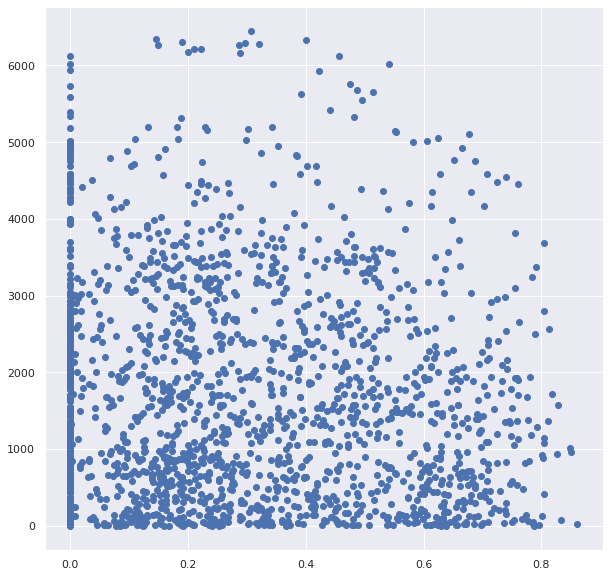

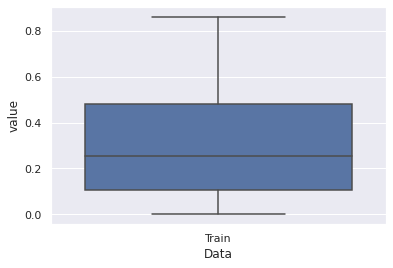

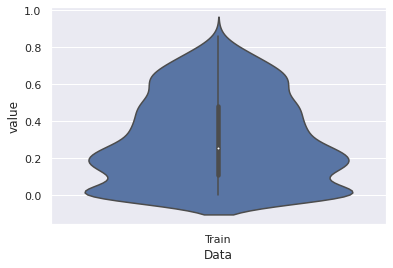

(1832,) (1832,)


<Figure size 640x480 with 0 Axes>

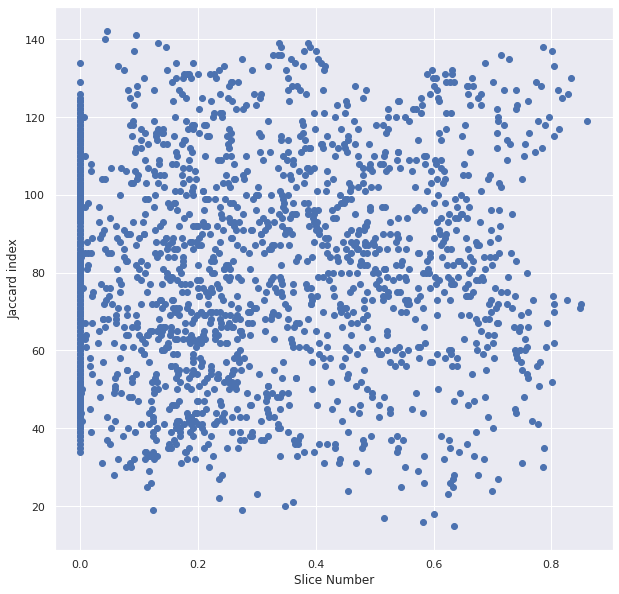

In [13]:
from matplotlib.pyplot import figure

%run Code_UNet/Test_RANO_2.py

figure(figsize=(8, 6), dpi=80)
figure(figsize=(10,10))

print(np.array(jaccard).shape,np.array(x).shape)
plt.scatter(np.array(jaccard),np.array(x))
plt.xlabel("Slice Number")
plt.ylabel("Jaccard index")
plt.show()

Brats_2018_data_split/ValidationHGG


  0%|          | 0/115 [00:00<?, ?it/s]

[0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
prediction [-1.7519054 -1.8611354 -2.9875305 -2.2210362 -0.9382785 -1.766106
 -3.6664076 -3.2584205]


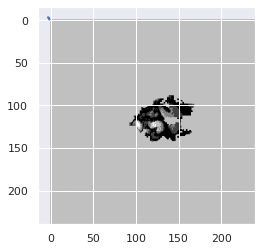

prediction [2.882535   2.9780304  0.990911   4.0486383  3.314885   4.205345
 0.26622316 2.857495  ]


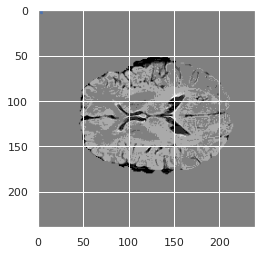

prediction [ 0.08837734  0.7559792   0.08864376  1.0638738   2.4193106   0.19912519
 -1.8836101  -0.9013251 ]


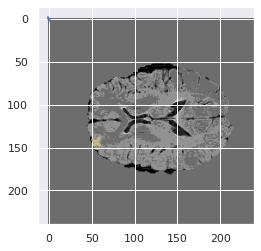

prediction [ 1.0946981   0.1349259  -0.44955334  0.71310747  2.512584    0.17098863
 -1.6113149  -1.523481  ]


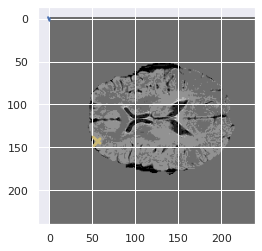

prediction [ 1.686309    2.0436134  -0.28065708  1.932295    3.498746    1.0280422
 -1.9858758  -0.514786  ]


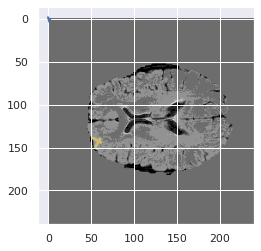

prediction [ 6.807832   2.4497404  3.7523592  4.3911066  8.465779   3.1140158
  3.1171143 -0.8252525]


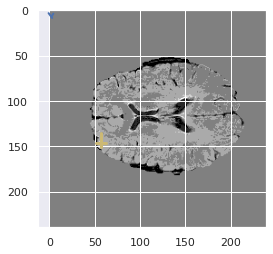

prediction [ 3.5637891   0.24550688  0.5312631   1.629303    4.602086   -0.14648512
  0.29903913 -2.0445285 ]


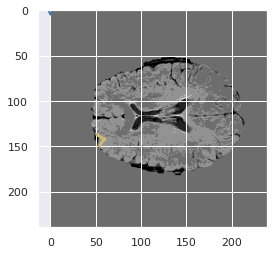

prediction [ 1.6892363  -0.5731931  -0.07110649  0.25891966  3.0881045  -1.1814162
 -0.6638937  -1.9594871 ]


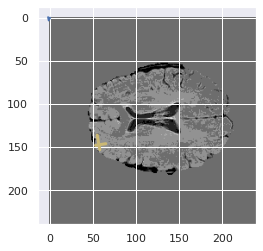

prediction [4.3968134 5.112922  3.4672306 5.8608136 7.6757565 3.5924406 1.099118
 1.6481594]


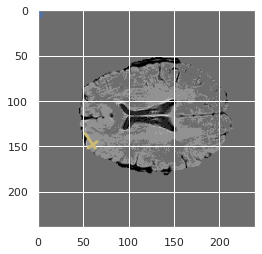

prediction [ 6.6376657  6.5411334  4.9043407  8.252294  10.21115    6.4079914
  1.9510949  4.627228 ]


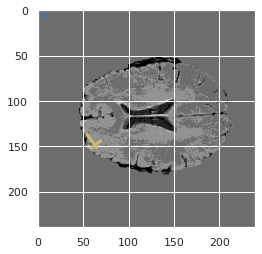

prediction [ 1.1801444   1.1241261   0.8871608   2.3605692   5.1316586   2.3160725
 -3.442945   -0.23142406]


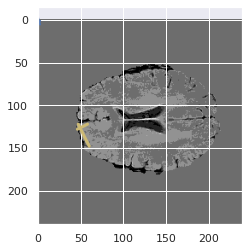

prediction [ 0.59713674  1.6732568   1.2891268   4.26313     5.3592787   4.623665
 -4.134887    0.21199644]


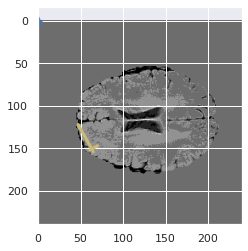

prediction [ 2.273866   2.8313794  3.86991    2.1815155  7.04475    3.8394806
 -1.1078814  1.0432659]


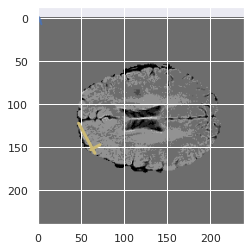

prediction [ 2.7982762  3.7800956  1.8329152  2.9019213  5.2158923  3.2249181
 -1.5478925  2.0509531]


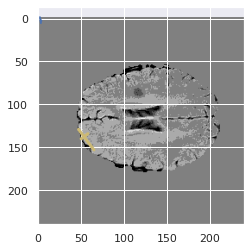

prediction [25.347387 21.579838 21.308353 21.013662 25.155941 21.986036 17.639215
 22.300413]


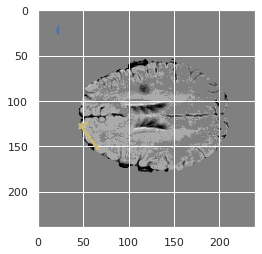

prediction [32.500286 27.40363  29.09566  27.411226 32.950462 29.471924 24.490269
 29.944803]


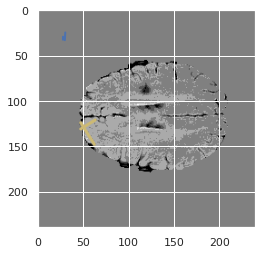

[0.0, 0, 0.0, 0.4964622641509434, 0.5153623188405797, 0.4746957078795644, 0.38530655391120505, 0.42365815528921313, 0.5002724795640326, 0.507985257985258, 0.4670846394984326, 0.4601139601139601, 0.5398230088495575, 0.5145579671784013, 0.4811181951937224, 0.483663631494376]
prediction [44.44382  37.60007  43.10742  41.79025  46.807312 44.682003 38.287872
 42.015682]


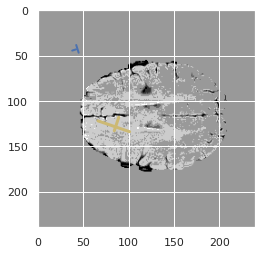

prediction [16.029709 15.460387 11.171241 17.685148 11.813787 17.27806  11.884382
 17.301191]


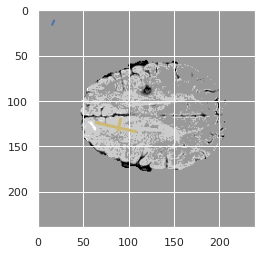

prediction [85.78883  34.983902 97.03582  88.05077  94.5211   65.341576 91.802025
 67.60761 ]


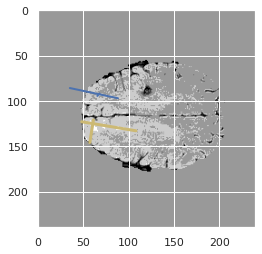

prediction [129.11836   55.854015 134.39067  115.9044   141.01642   81.23191
 125.65826   88.370445]


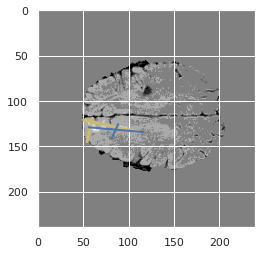

prediction [127.124825  53.580902 131.84567  109.64686  140.31702   79.319336
 121.12347   85.38815 ]


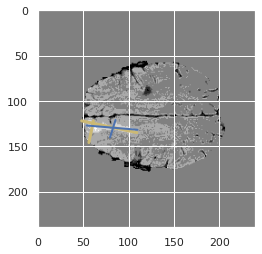

prediction [123.527565  52.853306 129.64369  107.6984   136.01964   79.750206
 119.85701   84.86617 ]


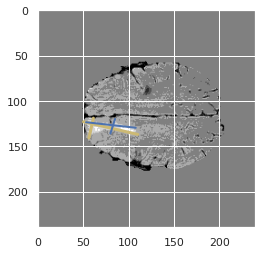

prediction [120.00664   53.655426 127.43408  103.02623  132.89748   76.19384
 117.29813   82.80506 ]


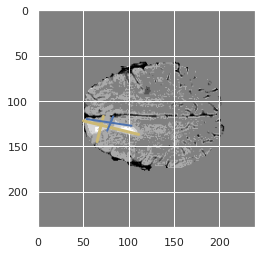

prediction [121.82336  54.22267 129.15433 104.63755 134.66139  78.03645 117.81618
  83.90849]


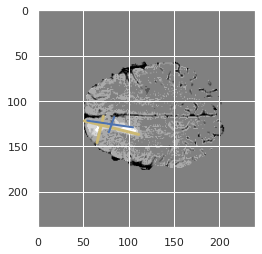

prediction [122.53163   52.65599  131.57892  105.46554  136.23586   78.67374
 117.820854  85.54047 ]


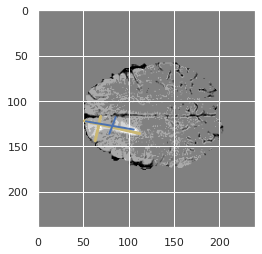

prediction [123.75761   50.518627 127.4587   106.50982  137.46394   78.337845
 117.8656    84.83458 ]


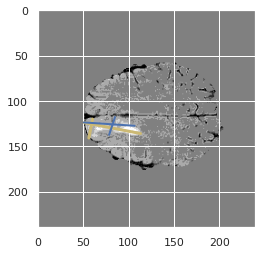

prediction [121.769844  48.340908 125.98897  107.73945  138.34506   79.57816
 115.10495   84.49681 ]


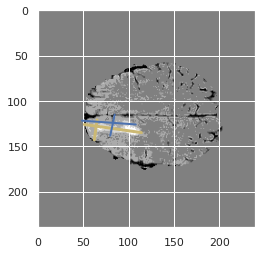

prediction [120.73209   47.255775 125.84825  107.621284 137.91637   80.02862
 113.0506    83.522675]


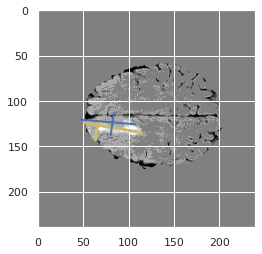

prediction [118.22223   48.51018  127.164795 110.962524 136.81972   84.52367
 113.80761   88.29822 ]


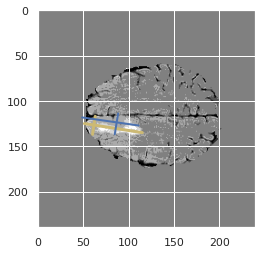

prediction [118.86765   50.558533 126.85239  110.89167  137.28894   84.89378
 112.81778   89.29081 ]


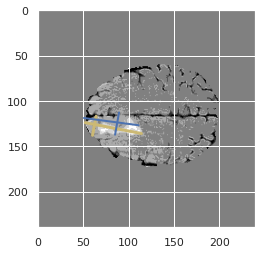

prediction [119.78754   50.295918 125.71319  114.78733  136.41644   85.56184
 114.48962   89.72845 ]


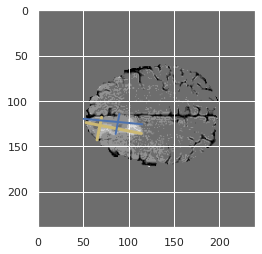

prediction [120.74588   52.575333 126.005394 116.02745  133.9466    84.492744
 116.1595    91.70565 ]


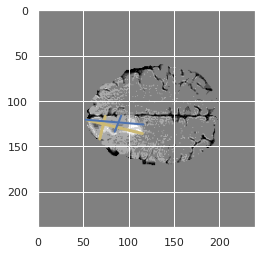

[0.5258573761567773, 0.6406429391504018, 0.23954877239548772, 0.20982658959537573, 0.125, 0.14867156585641605, 0.11491442542787286, 0.19162995594713655, 0.17017828200972449, 0.23112391930835735, 0.25033557046979865, 0.27816411682892905, 0.24771341463414634, 0.017796610169491526, 0.051961823966065745, 0.01933404940923738]
prediction [121.21649   60.29509  126.88942  115.23179  135.97949   86.67394
 117.016205  94.888626]


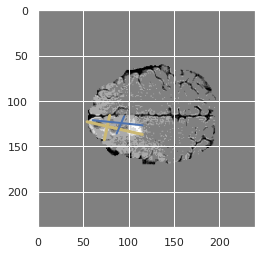

prediction [123.6541    63.77377  127.70958  116.9723   139.8006    90.29436
 118.42009   96.326515]


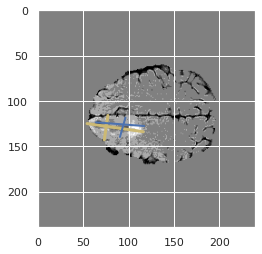

prediction [122.79067   70.37845  128.42032  115.925095 130.26237   90.8113
 123.06197   97.40222 ]


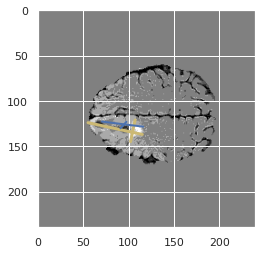

prediction [122.15013  75.20067 128.5438  112.83141 131.23303  90.2437  122.77442
 100.76013]


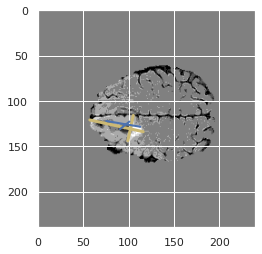

prediction [123.8477    79.243484 125.72374  110.543785 129.81067   90.13459
 122.01509  100.47488 ]


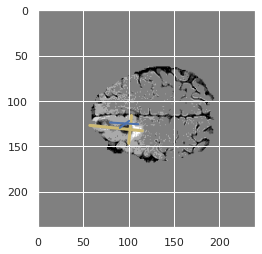

prediction [125.61135   79.81839  122.74187  109.12613  131.14906   89.017815
 119.20645   99.64775 ]


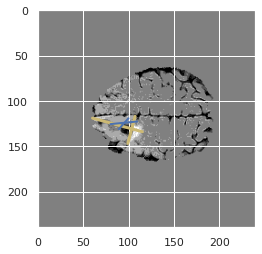

prediction [127.13766   82.60093  125.48036  111.06463  130.60034   90.226974
 122.581635  99.686646]


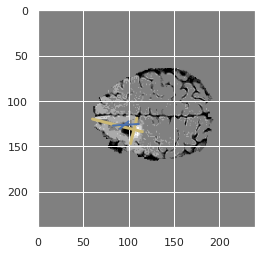

prediction [125.258934  82.73999  127.06085  111.68295  132.31313   92.99482
 120.48582   97.09616 ]


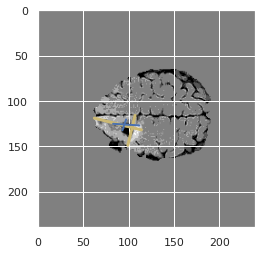

prediction [121.92058   84.27153  127.46242  113.403046 128.77846   95.23913
 118.347885  97.67022 ]


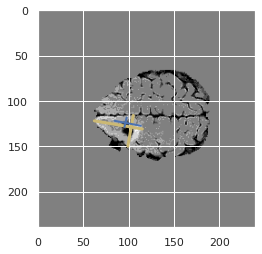

prediction [121.57529   82.33655  124.718285 111.34012  129.17073   94.30595
 115.388084  95.85997 ]


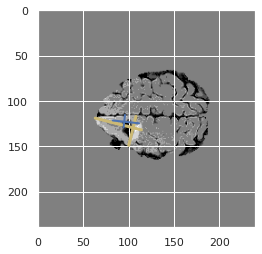

prediction [126.72247  80.66612 130.7213  110.77578 133.10333  92.41257 121.14868
  97.79788]


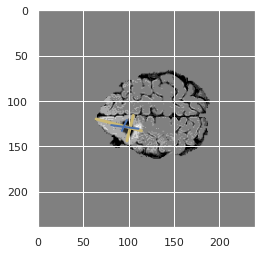

prediction [123.49535  77.7077  128.71754 106.85121 130.58374  88.26302 117.5826
  93.55363]


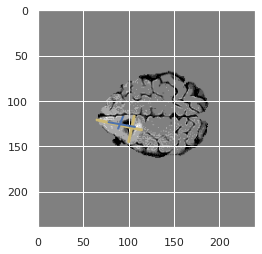

prediction [126.78667   78.999054 128.5221   108.590645 131.47995   93.0878
 120.44256   98.07079 ]


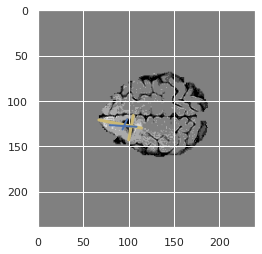

prediction [130.20885   77.13616  126.1864   100.20277  128.46085   89.10656
 126.930336 100.96897 ]


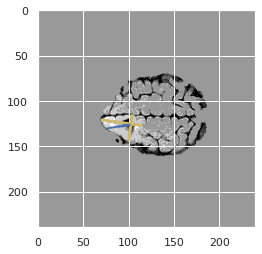

prediction [129.0869    80.94696  125.56066   99.304535 126.92219   90.21103
 127.25216  103.48422 ]


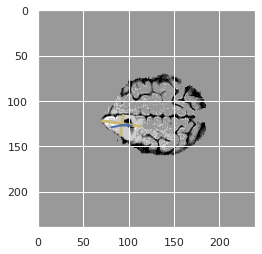

prediction [129.46304   84.476395 126.591805  97.74423  128.49194   90.67856
 126.140656 105.210625]


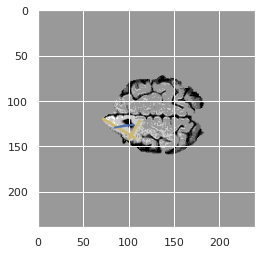

[0.13434452871072589, 0.008383233532934131, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0, 0.0, 0.0, 0.0, 0.0, 0.0]
prediction [131.38065   90.530594 117.8396    94.85838  126.47513   92.66825
 124.89262  100.96233 ]


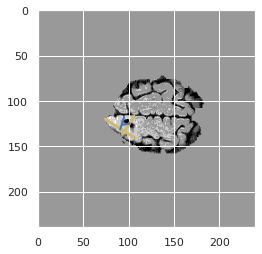

prediction [114.7349    83.0604   104.411934  90.365036 112.880226  87.38455
 107.513016  87.73564 ]


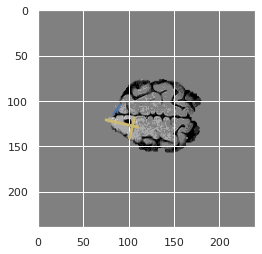

prediction [34.164986 22.693111 31.382431 25.41845  34.369934 26.546715 30.332672
 24.814863]


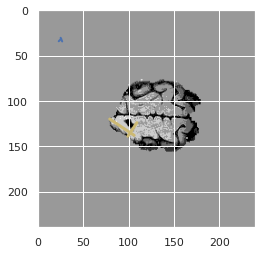

prediction [ 8.935927   5.6301208 10.090104   6.2688236 10.845518   8.321064
  6.521374   6.303432 ]


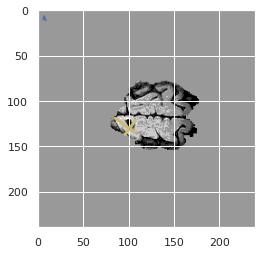

prediction [5.8327637 3.717393  6.8451753 3.3752697 7.085865  5.6893935 4.124848
 3.8223822]


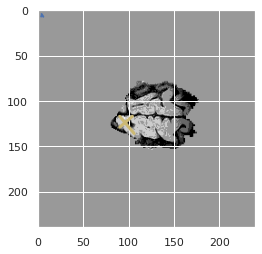

prediction [3.5541031 2.4542406 3.7720697 1.3838358 4.0107403 3.0562491 2.137135
 2.0321522]


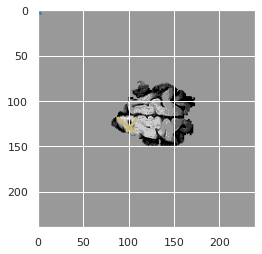

prediction [9.835679  5.5823917 7.6891084 4.508137  8.872524  6.235409  6.981882
 6.0555873]


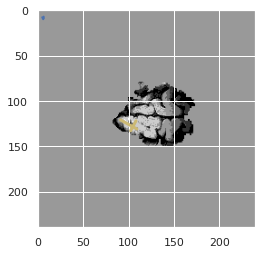

prediction [ 3.2585535  1.0757561  1.4842004 -1.440015   2.6484406  1.2770367
  1.5504951  0.8268236]


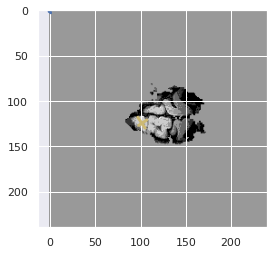

prediction [42.03672  35.37132  37.378338 33.15257  38.849037 33.867245 37.23563
 37.386425]


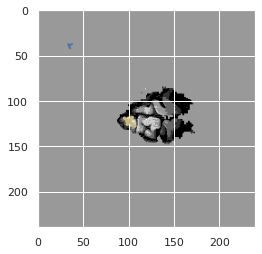

prediction [7.097338  3.875536  5.118586  3.4434834 8.143956  5.2599564 2.96328
 3.7917008]


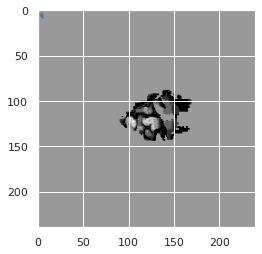

prediction [-1.9250828 -1.0940632 -2.2749867 -1.9225408 -1.2963756 -0.3870804
 -2.8290513 -1.2921758]


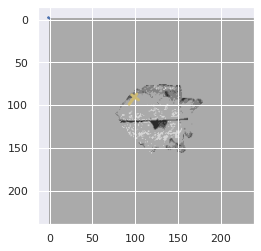

prediction [20.656956 25.638218 19.556128 30.823498 22.636019 28.517359 19.465826
 28.232998]


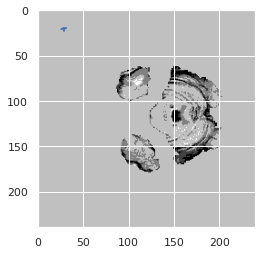

prediction [ 82.10111  100.319565  77.1375   112.16249   74.76788   98.64047
  86.24175  113.96294 ]


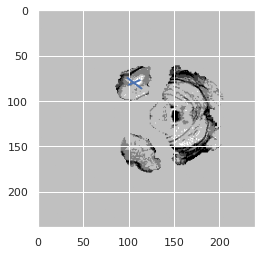

prediction [ 87.36937  104.74129   77.09827  116.1435    74.76274  103.22013
  91.738    119.452095]


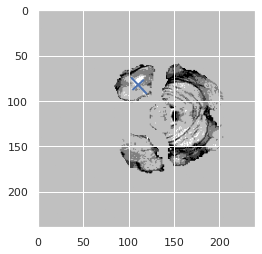

prediction [ 87.07364  101.41235   79.939026 113.60713   80.3441   100.44126
  89.75034  115.41991 ]


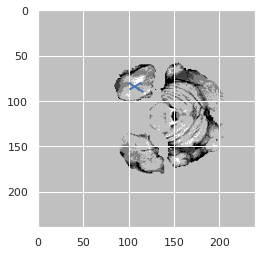

prediction [145.14587 152.42284 145.21619 182.84508 145.3155  167.87807 148.97052
 171.70656]


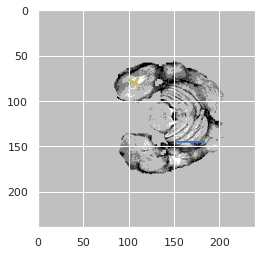

[0.08484848484848485, 0.09734513274336283, 0.0811965811965812, 0.36752136752136755, 0.2560646900269542, 0.10812883435582822, 0.22753036437246962, 0.41451831750339213, 0.41635220125786165, 0.40963855421686746, 0.35790543975597355, 0.33554169914263443, 0.09116161616161617, 0.14650689577210038, 0.1317365269461078, 0.04283003523990241]
prediction [ 79.43903   92.94326   80.53965  114.6925    79.754265  99.78231
  81.25357  110.27262 ]


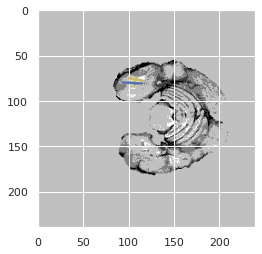

prediction [ 86.50325   97.343895  80.17012  120.17038   82.03503  101.988045
  85.76942  117.17151 ]


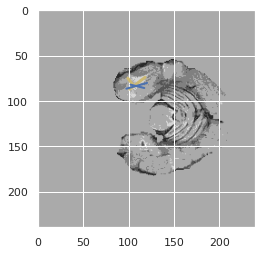

prediction [ 90.07512  97.41914  82.19656 120.00234  84.85298 100.82779  90.26436
 117.12035]


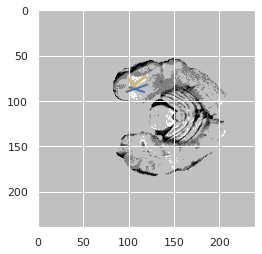

prediction [ 89.13733   90.74397   83.1031   119.02047   84.1987    98.776436
  92.01403  110.818115]


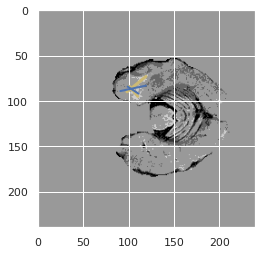

prediction [ 87.41763   86.54822   81.935394 117.501564  83.660446  97.73111
  90.59198  108.28613 ]


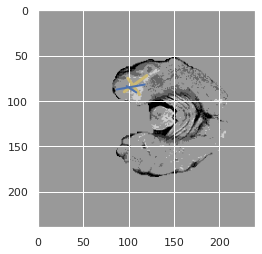

prediction [ 84.94404   83.75295   80.24366  117.38944   82.45637   95.81626
  86.998436 105.15751 ]


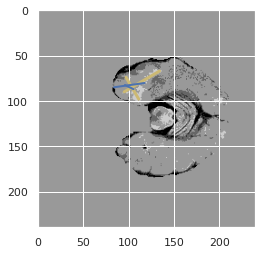

prediction [ 82.06533   86.70051   71.62747  126.31828   85.35733  102.46621
  76.85763  112.495346]


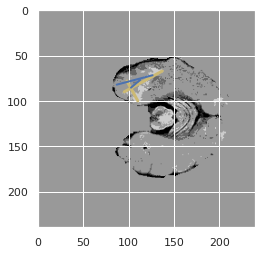

prediction [ 82.50804   88.96065   67.45599  132.33191   89.63303  107.34541
  72.4691   112.536606]


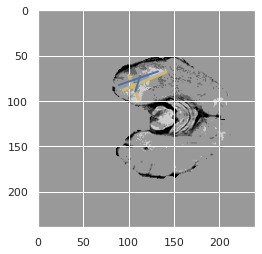

prediction [ 77.02885  90.16927  65.75    132.25922  85.80383 110.4311   68.68354
 113.14402]


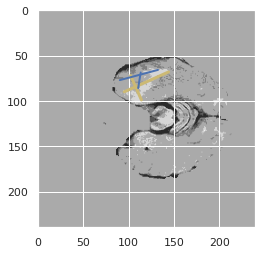

prediction [ 74.805595  92.17496   70.41779  144.59375   84.96095  116.825165
  71.35257  114.46301 ]


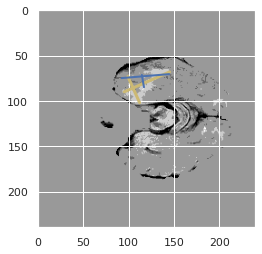

prediction [ 79.57162  106.880165  68.58624  150.40315   72.13033  117.5915
  87.6177   124.92754 ]


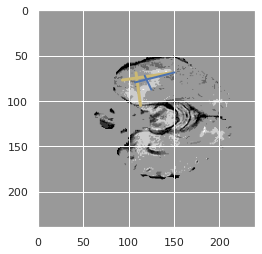

prediction [ 82.588356 111.23868   72.90744  152.2728    73.58335  120.32494
  92.43305  131.27078 ]


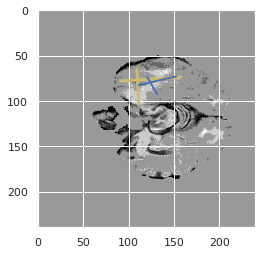

prediction [116.48169  129.88438   99.738106 176.62373   89.63977  136.79872
 120.63126  160.66542 ]


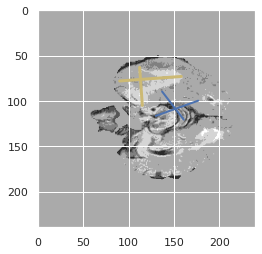

prediction [109.95278 109.86797 103.31558 178.7811   92.9449  134.38736 121.61112
 149.25063]


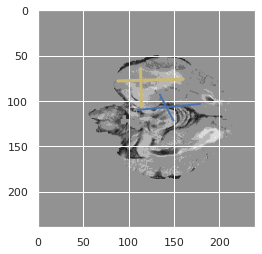

prediction [ 96.759674  95.071625 100.25056  169.18053  100.93452  128.4231
 105.58439  136.27017 ]


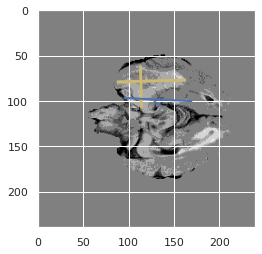

prediction [110.360466 112.50642   99.66059  179.84186  106.547066 144.14107
 111.88583  147.06937 ]


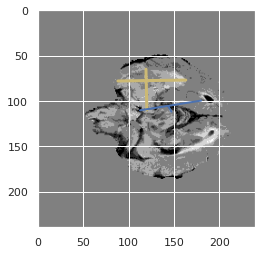

[0.09529925507320833, 0.04642409033877039, 0.07878384376387039, 0.03720383786959076, 0.11020104244229337, 0.11750902527075813, 0.17800811176205497, 0.1853999209382, 0.4188978268699724, 0.4798107983387171, 0.29262480638627425, 0.29129720853858787, 0.17042147245876899, 0.1999563652230828, 0.30751148626990066, 0.32936296926512815]
prediction [104.11768  117.585335  93.0026   177.73643   95.74942  151.68964
 103.35275  154.48076 ]


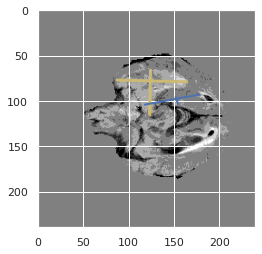

prediction [104.52244  107.608894  99.547134 170.37819  100.43313  140.03528
 103.501656 142.77255 ]


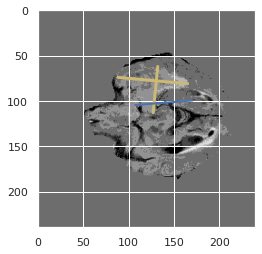

prediction [ 95.05834  101.56224   89.77932  155.72218   98.710526 129.16895
  91.70382  133.74982 ]


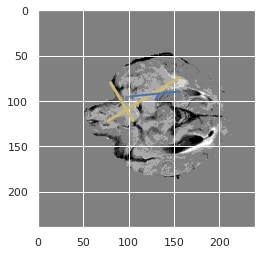

prediction [ 99.87158 101.49467  95.14482 165.86412 100.81615 127.84124  97.85371
 141.55399]


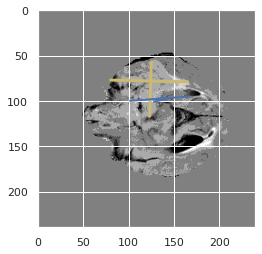

prediction [100.68694   95.503265  98.57462  164.16443  107.38184  119.91524
  92.9169   133.88327 ]


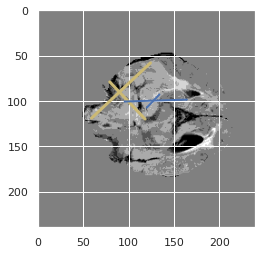

prediction [108.048225  87.39624   98.23294  169.3289    98.41505  112.531624
 110.03783  130.71027 ]


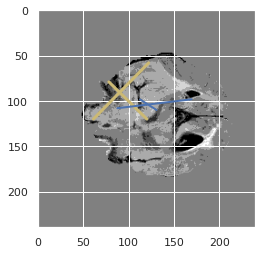

prediction [106.5539   82.34661 102.69924 168.95001  98.12451 108.89595 113.44611
 129.28522]


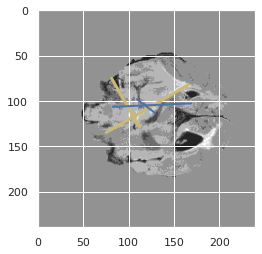

prediction [103.138306  86.348175 110.52974  174.91368   96.60476  117.003235
 116.04719  131.03479 ]


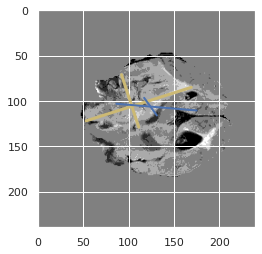

prediction [107.45015   77.84803  102.13626  170.01508   88.320625 114.61882
 128.8696   126.570175]


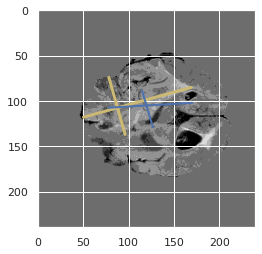

prediction [115.262146  76.62182   98.5573   166.7846    83.1675   119.292336
 135.03549  125.79383 ]


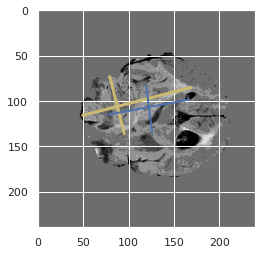

prediction [116.11144   87.665375  94.49996  161.90166   92.578415 119.2439
 124.57486  123.616486]


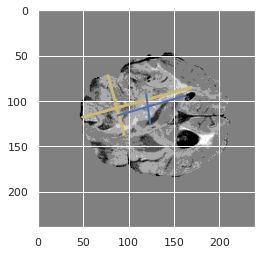

prediction [115.63525  90.12334  87.40155 157.62634  82.68884 119.69941 120.98125
 125.29024]


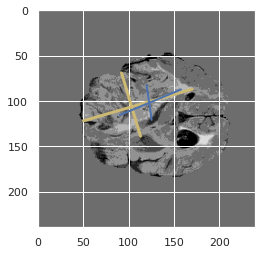

prediction [111.83166   91.295074  90.09231  161.23883   91.34604  124.89897
 113.815254 126.00107 ]


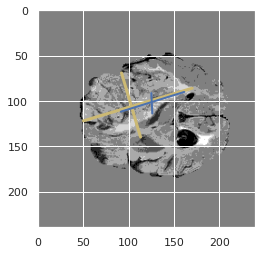

prediction [109.71395   94.6878    90.93324  167.64684   90.88491  128.10071
 113.906555 136.47195 ]


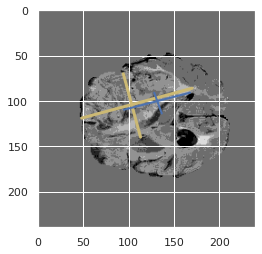

prediction [108.33356   91.79333   90.096695 164.85957   80.90444  131.65213
 119.14206  136.91205 ]


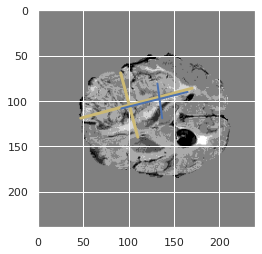

prediction [115.43893   93.33582   91.86564  176.058     82.834625 140.2316
 119.36729  150.51572 ]


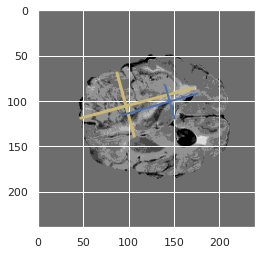

[0.18152385063673646, 0.01620207306027976, 0.24001593466786178, 0.1989820416786709, 0.08376863899705575, 0.07014542343883662, 0.12599234145885868, 0.1434722858451672, 0.13002606105733433, 0.18544366899302095, 0.25770409082717605, 0.17980725103258374, 0.15393033011125296, 0.393048606147248, 0.26129414985853794, 0.4706047294139639]
prediction [113.95041  95.00151 103.70264 180.81221  95.46186 141.6175  115.73933
 150.34212]


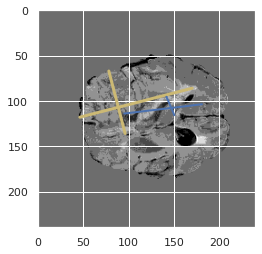

prediction [103.2469    92.76174   98.36702  168.74907   99.467285 126.71428
 101.05092  135.48318 ]


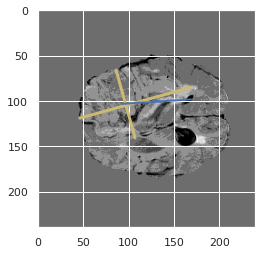

prediction [100.202286  94.918495 105.93407  169.79446  118.41595  127.78289
  86.28758  139.57617 ]


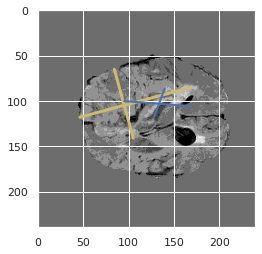

prediction [ 97.49666   96.651764 109.12024  174.60196  115.36814  135.96548
  89.04435  141.35574 ]


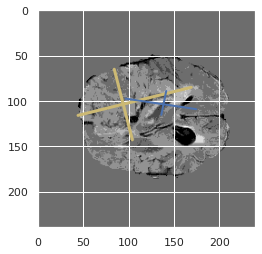

prediction [ 96.743004 106.29209  111.48457  176.45149  108.43025  143.93369
  97.0901   152.72862 ]


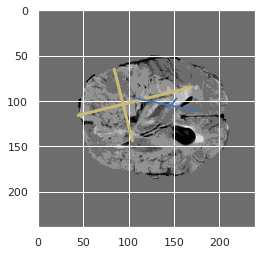

prediction [ 92.18201  104.71245  114.199684 170.8732   105.278465 134.55147
  98.63535  149.3876  ]


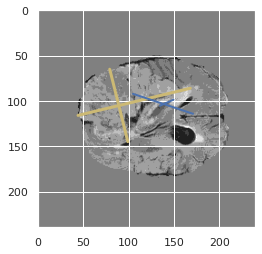

prediction [ 83.15239 111.20905 111.18581 170.23286 101.88473 142.2058   83.96815
 155.46452]


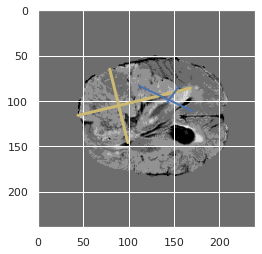

prediction [ 81.04965  104.77436  105.275    170.73553   98.14894  145.65129
  74.066216 150.14851 ]


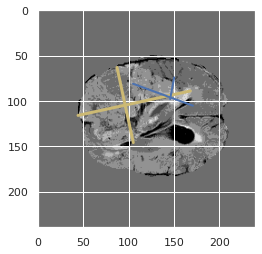

prediction [ 88.98098  105.05248  113.57495  169.22972  104.4122   143.82498
  83.523285 148.33817 ]


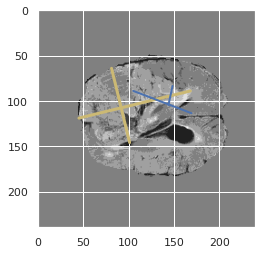

prediction [ 87.951355 103.6408   112.65045  170.51581  108.80673  142.1021
  78.95145  148.5123  ]


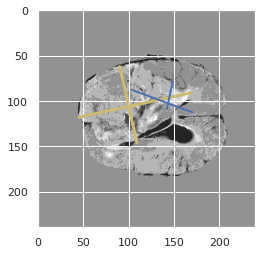

prediction [ 97.39339  94.07155 115.00876 172.30528 116.66802 131.12361  80.54571
 138.90399]


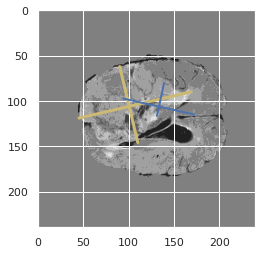

prediction [103.797455  88.94879  109.89775  169.73265  111.43489  126.5538
  87.48261  132.09247 ]


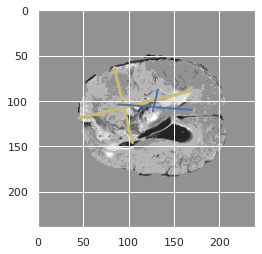

prediction [114.51777   84.5497   110.91308  176.26694  114.427376 126.32934
  94.96166  129.97224 ]


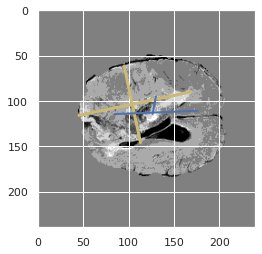

prediction [111.420906  67.96888  112.46225  175.62706  127.89529  123.25221
  84.211266 109.61286 ]


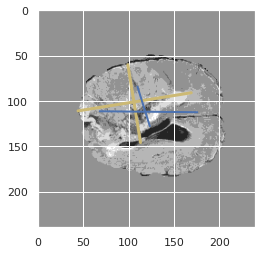

prediction [114.83627   63.950535 101.9937   167.98213  112.854416 120.46203
  86.49571  110.179825]


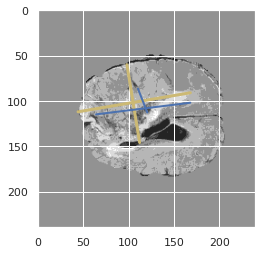

prediction [116.0169    59.013676 101.38125  165.65709  124.4315   116.13438
  78.66528  103.9286  ]


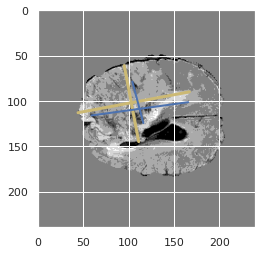

[0.4563089029188398, 0.36159460976979224, 0.2378066378066378, 0.18304263565891474, 0.22855711422845693, 0.13914543793768394, 0.13586723768736617, 0.020434641582873826, 0.0479498861047836, 0.061017349226956216, 0.205829649982081, 0.16346273099342676, 0.04081905781584583, 0.13546706363974692, 0.04941531497548095, 0.06839719818706222]
prediction [116.74995   65.32235  104.22291  163.20369  129.60918  115.92542
  79.557625 108.90203 ]


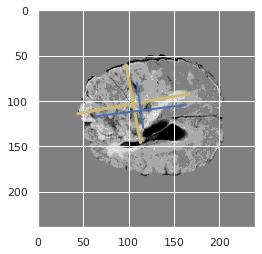

prediction [117.843506  69.76903  102.29713  157.0403   128.20763  113.18766
  83.327156 113.11922 ]


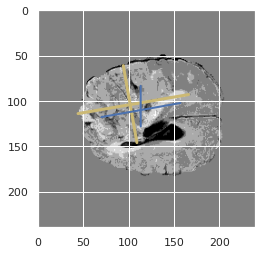

prediction [122.2915    70.09525   97.14572  154.8589   124.72041  103.12987
  92.04501  110.887955]


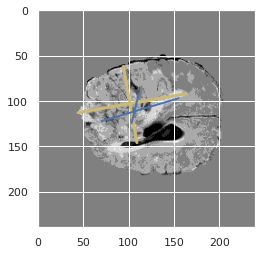

prediction [127.14587   69.53016   93.66727  148.03761  127.16147   95.50674
  96.30865  107.117516]


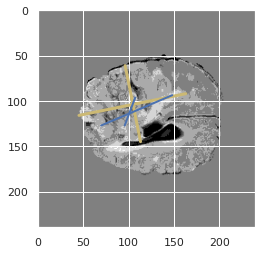

prediction [124.70326   69.36629   92.01474  143.58719  132.26053   88.711075
  87.19011  105.739815]


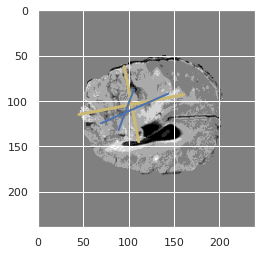

prediction [125.58481  70.28884  86.3435  142.58675 125.89157  90.16567  92.08744
 110.97963]


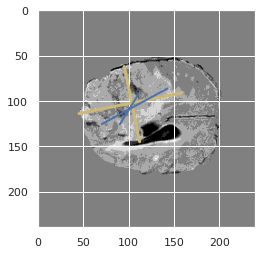

prediction [124.01496   56.533894  89.46606  146.74393  118.57508   80.54236
  98.32988   95.47453 ]


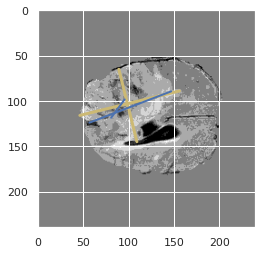

prediction [124.67126  61.34202  81.46539 139.86586 111.20568  81.80713 103.3335
  98.62252]


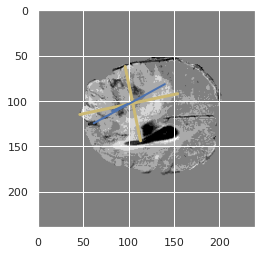

prediction [127.23654  64.25657  84.81404 134.31395 111.09165  82.76818 106.36294
 101.07924]


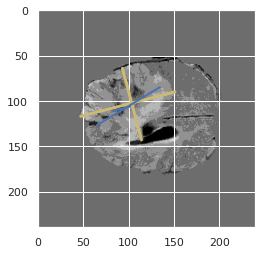

prediction [130.22417   71.907425  88.50046  126.73067  112.251305  83.971565
 107.1356    97.937935]


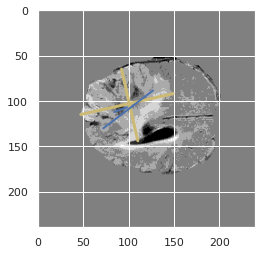

prediction [133.09996   70.984215  89.14784  116.2864   103.059395  72.92554
 122.333534  92.32976 ]


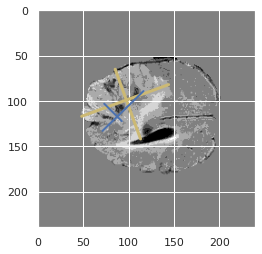

prediction [131.2468    70.9647    88.87654  119.42773  103.872406  77.59208
 119.03868   91.42103 ]


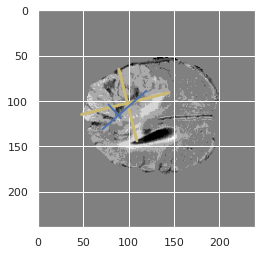

prediction [134.2441   80.95195 101.44569 126.42835 119.28005  93.08872 115.79076
 105.3398 ]


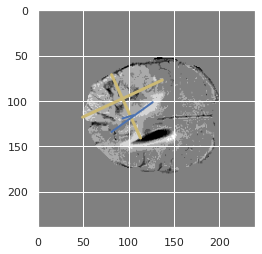

prediction [127.00039   82.43111  101.69435  125.78467  106.677666  95.44027
 117.41519  106.06465 ]


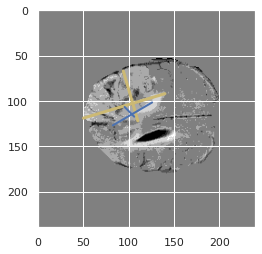

prediction [122.06572   85.84378  109.46     127.78974  115.17214   95.48614
 111.476295 101.88581 ]


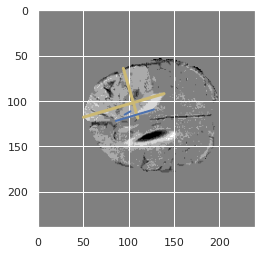

prediction [120.496635  84.55567  116.26471  133.2188   110.007164  99.812
 118.31698  109.88431 ]


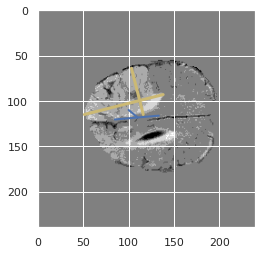

[0.05093194625054183, 0.11830154405086285, 0.2971483345315121, 0.3388349514563107, 0.4209714726291442, 0.1672268907563025, 0.11298342541436464, 0.2599171107164002, 0.369281045751634, 0.4867980661956118, 0.5539940828402367, 0.41914569031273835, 0.6167076167076168, 0.03312191684284708, 0.10881226053639846, 0.2895174708818636]
prediction [119.57086   77.753586 112.696365 131.2631   111.89733  100.34448
 111.22474  106.18595 ]


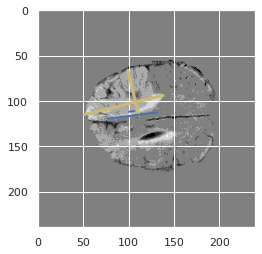

prediction [117.16509   68.71375   99.871315 124.57016  101.25694   95.64088
 109.6097    98.7982  ]


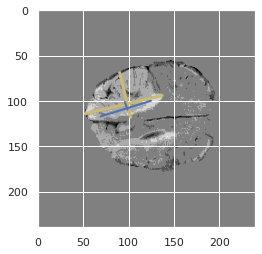

prediction [115.38381  67.08069  98.13351 127.44807  92.59363  96.18713 111.61414
 101.56162]


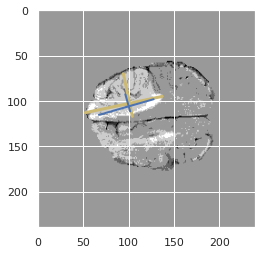

prediction [108.6022    57.369774  87.035515 126.0142    85.13645   91.46931
 102.7716   100.114235]


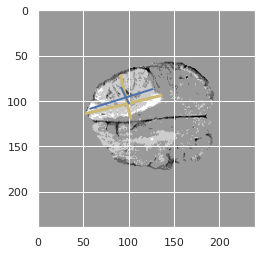

prediction [110.12053   56.64791   81.62295  126.98752   81.718765  93.08555
 100.97171  103.046555]


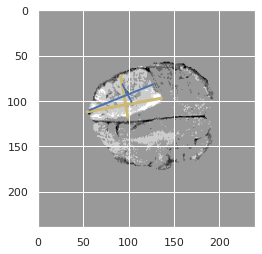

prediction [105.88264   65.472725  86.26635  129.44664   87.406235  98.95928
  94.060905 107.70452 ]


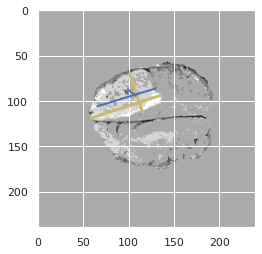

prediction [100.3054    66.3419    90.66861  129.41429   88.82667   99.15233
  92.46378  109.327866]


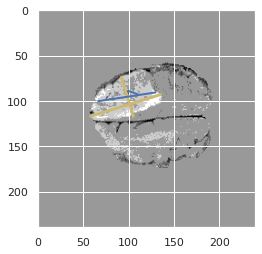

prediction [100.57672  71.86543  88.32764 125.9836   83.91564 100.17617  97.78029
 112.2732 ]


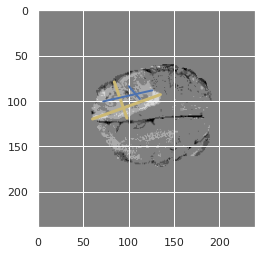

prediction [104.26127   70.96859   84.14993  122.69368   81.26114   97.403175
 100.33135  111.672325]


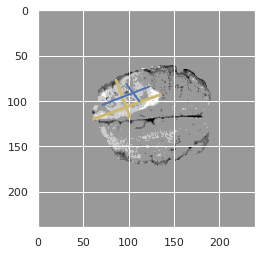

prediction [107.99699   80.4205    82.281456 119.70474   82.37832   95.892525
 104.70272  113.54048 ]


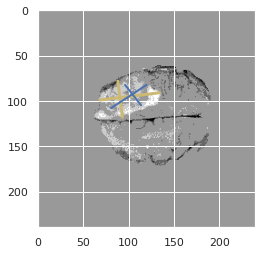

prediction [106.97666  80.93478  78.6916  121.28008  77.20885  96.46493 106.5762
 113.63724]


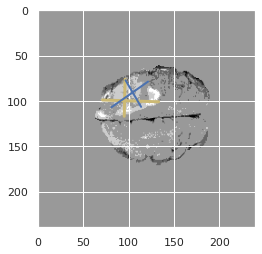

prediction [105.77494   80.60647   73.926445 118.75728   81.97553   90.52809
  99.055405 107.77727 ]


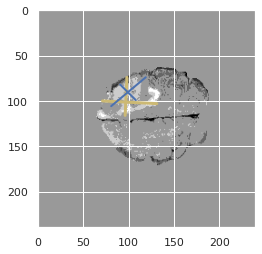

prediction [107.719734  83.08537   75.77095  118.51747   83.462944  90.916626
  98.483986 108.565216]


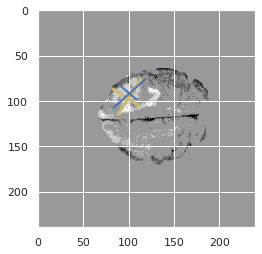

prediction [ 91.828094  85.73596   85.91138  114.14467   91.24177   92.37793
  90.40197  100.265625]


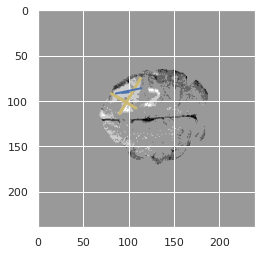

prediction [ 92.55265   86.276665  90.1682   113.09352   96.65112   94.32315
  90.712265  98.569565]


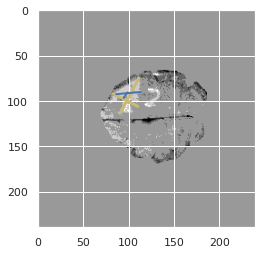

prediction [ 91.18777   88.87693   96.978546 118.034134 103.304596 100.80509
  89.56084  103.14128 ]


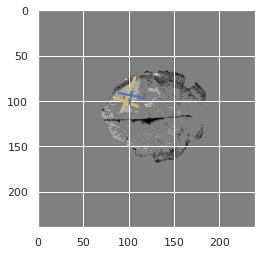

[0.2605111294311624, 0.20783645655877342, 0.0, 0, 0, 0, 0, 0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.002886002886002886, 0.18352941176470589]
prediction [ 93.99459   95.89779  105.48976  117.96981  110.67372  106.65578
  92.220856 112.94184 ]


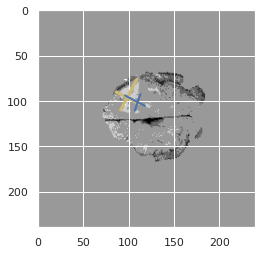

prediction [ 93.52336   98.35513  109.02472  116.49017  111.60097  108.5035
  93.41576  114.988754]


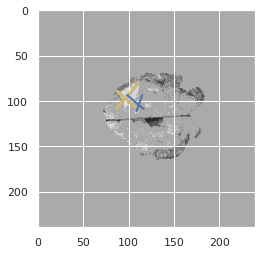

prediction [41.386547 44.574432 45.335194 49.70953  44.961277 48.43221  44.09451
 52.270576]


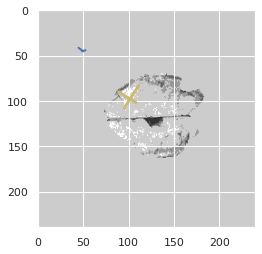

prediction [-1.2331709   0.3777608  -0.34383872 -1.0489403   0.06674728  0.41677803
 -1.3392158  -0.11668254]


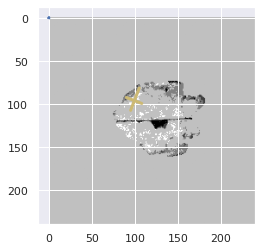

prediction [-1.6203026  -0.45270014 -1.442729   -1.7767389  -0.7312347  -0.1417338
 -2.3390172  -0.91507214]


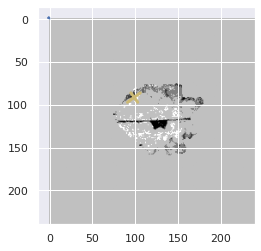

prediction [-1.3901902  -1.4032288  -1.262518   -2.1630633   0.05121348 -0.36739898
 -1.9946823  -1.5742878 ]


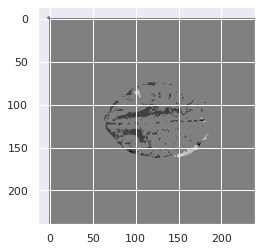

prediction [-0.16147272 -0.05820442 -0.8648952  -1.264102   -0.0626426  -0.8324842
  0.08692777  0.58411217]


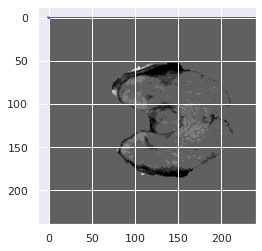

prediction [2.36687   2.0881922 3.1997042 2.3540733 3.2889354 2.8213732 3.8452363
 3.0531013]


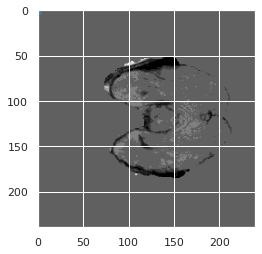

prediction [12.563349 12.870952 16.972807 17.65939  17.887438 16.15486  15.558467
 13.531805]


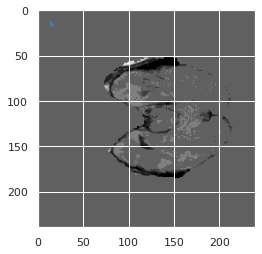

prediction [21.505884 25.480286 24.99425  26.033035 22.850824 27.58576  24.200327
 27.402178]


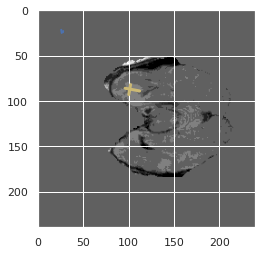

prediction [37.62267  39.21536  38.76471  40.995377 40.963337 37.310066 37.982536
 44.094543]


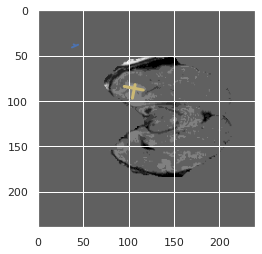

prediction [68.60295  73.263596 62.451855 79.83369  69.82486  72.19345  66.18337
 81.418144]


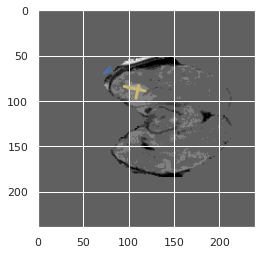

prediction [71.641785 76.99238  65.75531  85.593025 72.683105 78.47655  69.40019
 85.54522 ]


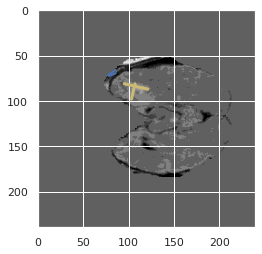

prediction [32.429985 35.381294 33.100697 35.972378 36.09293  35.18659  32.870327
 37.48674 ]


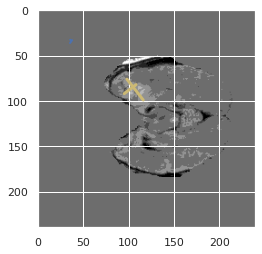

prediction [79.47981  82.42263  75.564354 96.94045  81.74351  83.706635 77.464226
 89.19352 ]


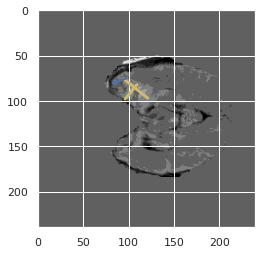

prediction [ 91.5425    99.719345  82.04161  113.63637   87.83751  101.43715
  88.77277  110.77404 ]


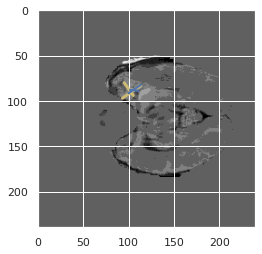

[0.001584786053882726, 0.4614019520851819, 0.15809128630705394, 0.1684931506849315, 0.3391674550614948, 0.216, 0.13252449836677554, 0.18081830180378355, 0.12217741935483871, 0.08802685565087653, 0.09446925455170045, 0.27307162534435264, 0.20454545454545456, 0.20690418234122593, 0.4493474207582349, 0.40625665035113856]
prediction [ 94.099724 103.89745   90.80582  123.85499  100.809616 115.85406
  83.94648  126.907265]


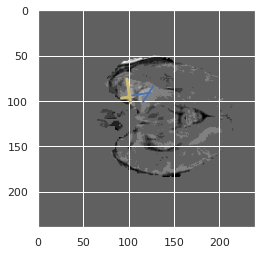

prediction [ 92.064575  97.02218   90.4626   127.365395  99.95666  117.270805
  77.68407  124.32182 ]


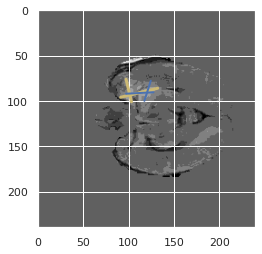

prediction [107.14104  104.08238   99.69375  150.91797  118.19723  133.42648
  84.077065 131.49333 ]


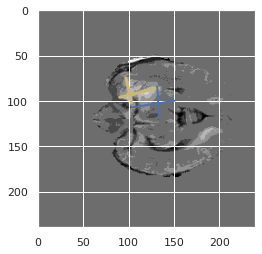

prediction [110.182625 103.29047  100.29137  148.47417  113.77859  130.19502
  89.569984 129.69395 ]


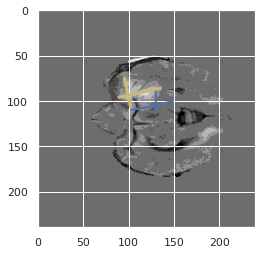

prediction [104.72798   98.78594   99.83926  148.57654  109.26111  127.61278
  89.963196 126.90142 ]


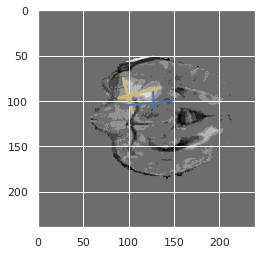

prediction [110.25699   93.11337   99.37903  149.4635   105.36067  120.74468
  96.215225 123.760315]


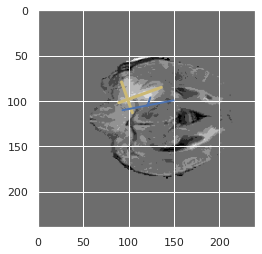

prediction [109.017426  89.940414  99.38217  138.87811  105.1219   104.315186
  98.76542  113.03664 ]


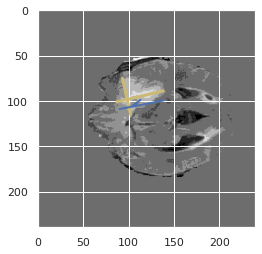

prediction [111.417656  90.94235   97.38071  142.07298  110.12461  101.54169
  99.33975  110.25182 ]


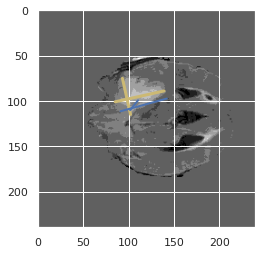

prediction [116.44409   94.2848    99.82039  146.79922  110.409225 106.61164
 103.8383   114.95447 ]


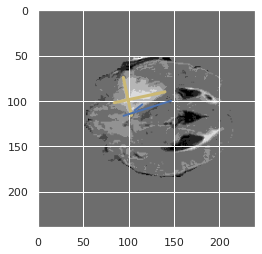

prediction [116.91956   92.56229   99.95115  146.28264  109.2338   105.059906
 105.948105 113.62209 ]


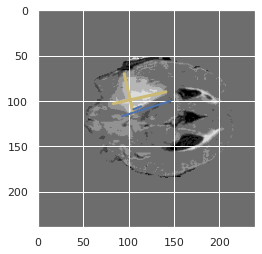

prediction [116.261955  91.0904   102.99664  148.65706  111.37627  106.61978
 106.069695 113.65041 ]


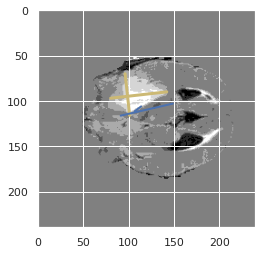

prediction [111.752106  87.73028  103.45922  148.53256  115.69686  103.80716
 100.63527  109.23968 ]


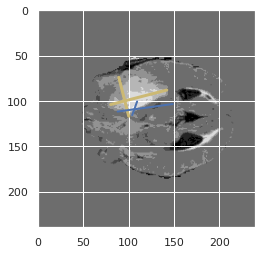

prediction [108.94628   84.80065   99.37241  146.20447  114.98503  102.459694
  98.84547  107.26381 ]


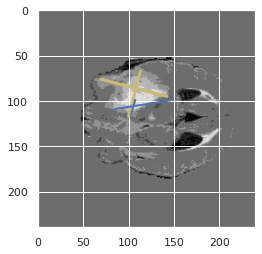

prediction [105.2695    79.72273   97.99973  146.17624  112.27866   95.83692
  96.45026  102.114136]


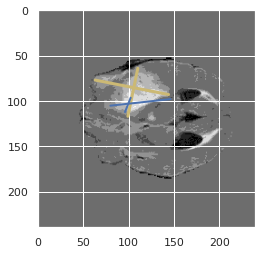

prediction [ 90.42717  74.17666 104.19241 137.2601  119.66037  92.39027  82.388
 102.80171]


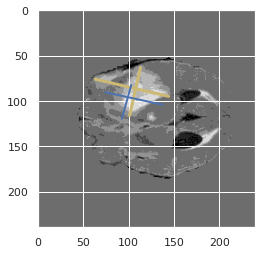

prediction [ 88.916405  69.6457   108.07013  138.64806  109.87196   96.456795
  85.24621  107.81325 ]


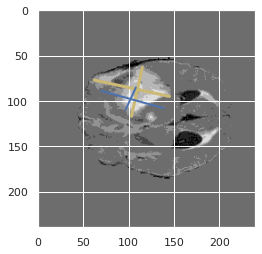

[0.5041597337770383, 0.4791245171969836, 0.20459254143646408, 0.16142522582803615, 0.07777013076393668, 0.16389585947302385, 0.25798487887671656, 0.2926010678871091, 0.2709307587871474, 0.21232777374909353, 0.23766555086595836, 0.15780590717299578, 0.10375494071146245, 0.04341677273370103, 0.019418741040010425, 0.02188069809846314]
prediction [ 85.55856   69.69295  107.523224 139.88316  109.688995 100.46811
  77.63672  108.330284]


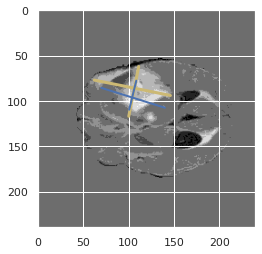

prediction [ 82.22532   73.842575 106.83074  150.14978  110.82533  107.29929
  74.71691  111.92623 ]


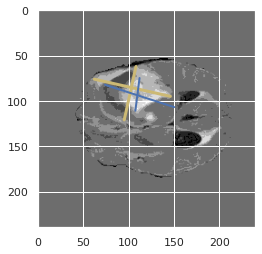

prediction [ 83.9718   71.46677  99.83899 146.00484  97.70897 104.48542  82.64912
 109.56902]


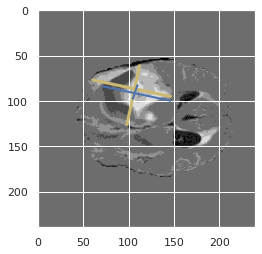

prediction [ 84.37629   71.17085   98.89306  143.52695   96.00066  103.918236
  83.60012  108.72741 ]


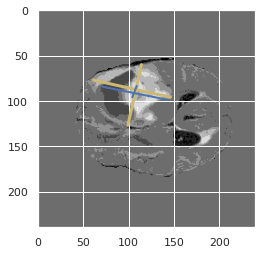

prediction [ 83.39653  71.72088  96.78373 137.7447   90.87946 102.45935  84.73204
 106.4596 ]


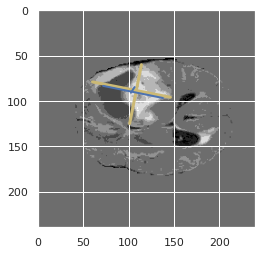

prediction [ 81.57591   68.881096  95.44277  136.8674    94.69629  104.20278
  78.6828   102.01332 ]


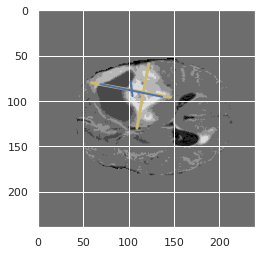

prediction [ 77.25094  65.22555  95.36756 136.39905  99.28019 108.6516   72.00279
  98.9553 ]


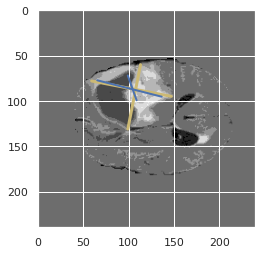

prediction [ 79.40531  65.24118  91.52881 137.97243 101.31958 113.41504  69.51791
  97.60382]


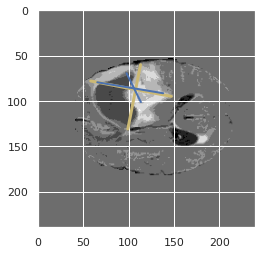

prediction [ 80.87715   64.02453   83.48755  133.32957   98.42846  108.90644
  69.866554  93.57505 ]


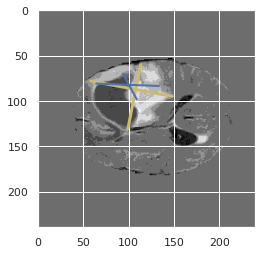

prediction [ 81.85422   63.05117   80.02216  130.94968   94.252014 105.02206
  72.06635   92.057106]


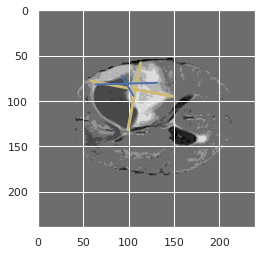

prediction [ 84.29053   66.26459   83.7614   132.78415   98.44905  105.634605
  73.15397   94.68401 ]


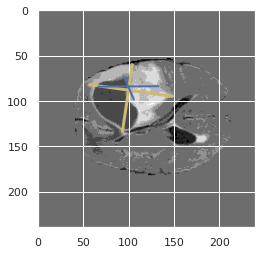

prediction [ 85.05676   65.400856  83.56623  132.8628    94.34499  104.868126
  77.47215   95.31915 ]


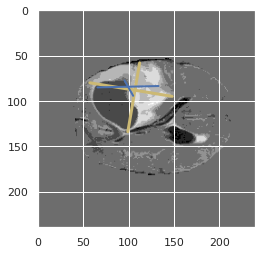

prediction [ 84.9939    65.2541    82.452484 130.5308    90.0987   103.453964
  78.92538   94.67474 ]


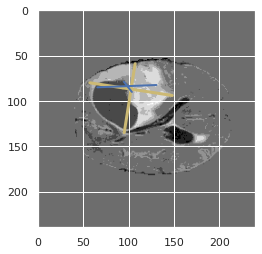

prediction [ 86.888794  64.48745   81.485214 127.6556    87.46057   98.3584
  83.06081   92.30857 ]


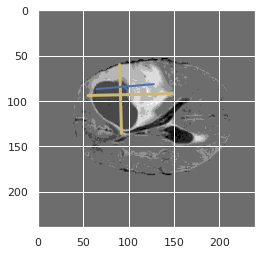

prediction [ 85.969925  63.607162  80.418526 129.9561    83.33953   98.54103
  85.67806   92.649086]


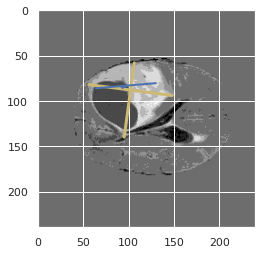

prediction [ 82.26405  66.04549  83.20067 133.76764  84.2857  102.48384  81.61718
  97.2239 ]


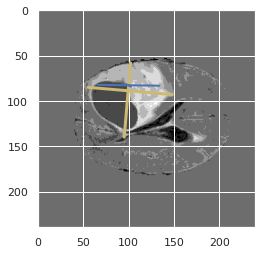

[0.00486906171864719, 0.07012811867835468, 0.06607236497115888, 0.1473932334997227, 0.22648479681727762, 0.24430055308242277, 0.24812440321920612, 0.22734946539110862, 0.22508960573476702, 0.23524355300859598, 0.22883260902142963, 0.20545622688039458, 0.14021721510779706, 0.1000669344042838, 0.10845070422535211, 0.07504048947273709]
prediction [ 84.44343   65.02005   80.78253  132.4926    83.16138   98.363945
  83.379555  95.27283 ]


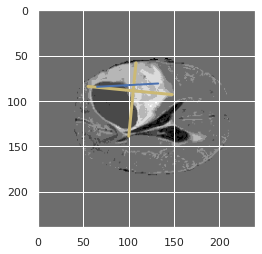

prediction [ 91.7405    58.617645  76.61563  123.143684  81.56533   88.35546
  90.17156   86.21876 ]


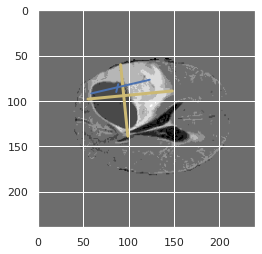

prediction [ 94.24933   60.363228  71.70064  130.4548    81.37983   88.60384
  88.101555  90.031395]


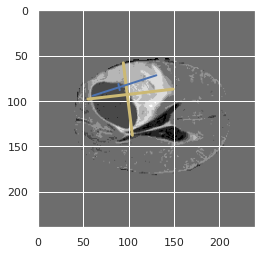

prediction [ 88.234955  60.791195  75.94479  135.52109   91.449455  97.64933
  76.55018  100.94277 ]


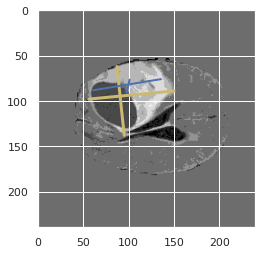

prediction [ 88.04394   58.943287  77.608215 138.2169    95.07583   96.00006
  74.317726  99.833496]


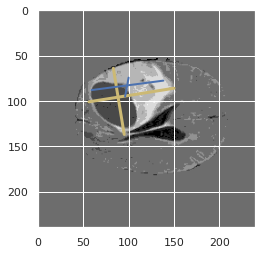

prediction [ 90.234566  58.445072  75.42072  138.89557   97.11499   94.70635
  72.95916  101.171036]


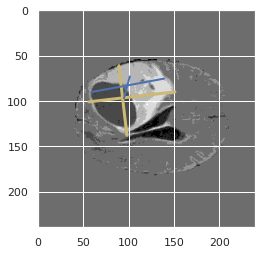

prediction [ 90.194145  59.10401   76.12184  139.29735   97.57182   94.87421
  72.8429   102.91036 ]


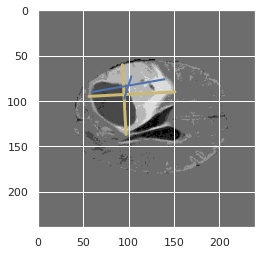

prediction [ 88.9126    61.331078  77.29919  140.75943   97.08456   96.70096
  75.01947  105.128105]


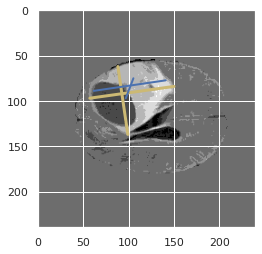

prediction [ 89.71193  63.57962  76.99653 141.83429  96.89495  98.08316  75.06918
 105.97564]


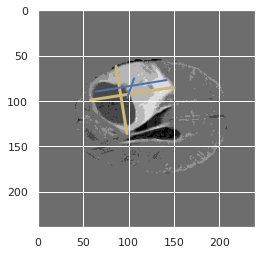

prediction [ 87.72965   63.705826  80.8346   141.50783   97.08307   97.602486
  74.79985  106.10034 ]


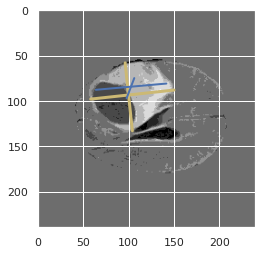

prediction [ 86.67021   64.496574  85.39     136.90509   97.6217    96.387695
  75.81292  106.638695]


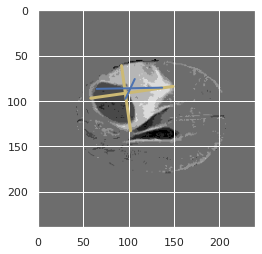

prediction [ 87.35764  64.59826  83.48578 134.51012  97.02516  94.73894  76.4328
 107.20108]


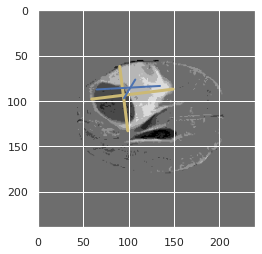

prediction [ 88.23405   63.577755  81.15278  135.31204   93.75084   93.982666
  80.11052  105.83674 ]


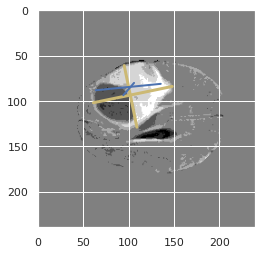

prediction [ 88.2827    64.875     80.566086 137.34644   92.33515   94.893234
  82.36074  108.08868 ]


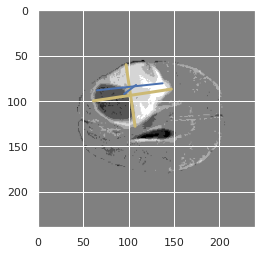

prediction [ 86.65001   71.22684   83.0985   136.33545   93.08457   96.17606
  81.985115 113.2808  ]


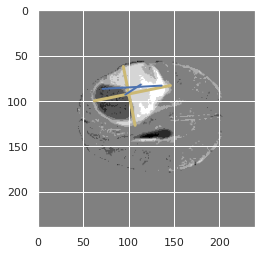

prediction [ 85.303795  73.110245  81.27463  133.37161   90.31392   93.42196
  83.43278  113.81352 ]


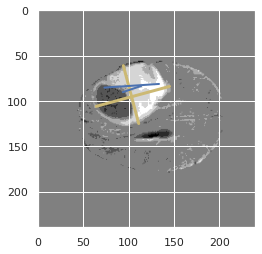

[0.06024551463644948, 0.08969347870808475, 0.08393128941074146, 0.12601626016260162, 0.22568187303886073, 0.10951569724993916, 0.14849961528597075, 0.16255482456140352, 0.12921348314606743, 0.19232, 0.12330198537095088, 0.051952580195258016, 0.22803592346739554, 0.24409127954360227, 0.2571795970852979, 0.23033443240697127]
prediction [ 83.50697   73.62198   83.198265 133.92804   88.46775   92.56974
  84.73537  114.88308 ]


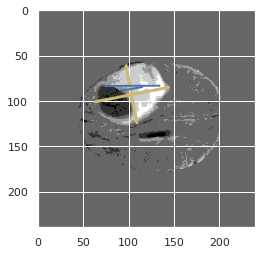

prediction [ 82.83119   75.66004   87.61308  135.31754   90.93467   94.564514
  85.50292  114.96018 ]


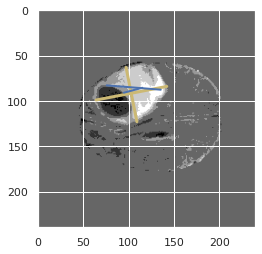

prediction [ 84.874596  79.06408   88.316086 134.5882    92.21896   96.41226
  86.75725  118.15515 ]


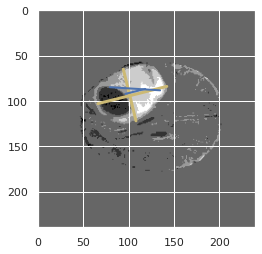

prediction [ 84.224754  79.95186   88.91365  135.86508   94.269905  98.48676
  84.70211  119.46978 ]


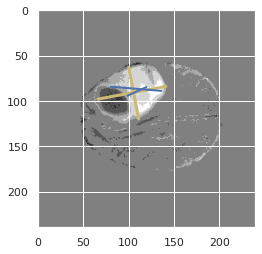

prediction [ 87.41476   80.77179   91.27756  135.98166  100.55752   96.74729
  82.74239  115.440186]


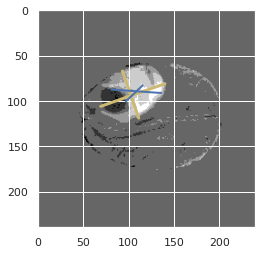

prediction [ 91.56091  78.97079  92.39818 135.80469  98.65374  93.4006   89.95271
 111.38585]


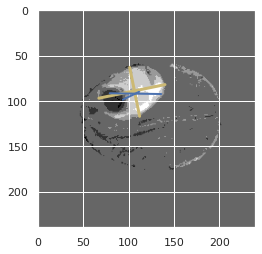

prediction [ 96.09662   79.13373   91.393616 136.84734  103.51367   91.42992
  90.90378  107.94531 ]


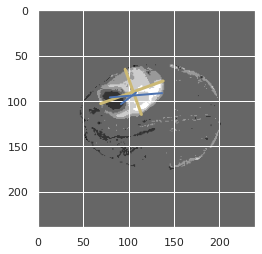

prediction [ 92.21737   78.17977   90.415825 136.50093  101.22862   91.38006
  92.237755 108.47057 ]


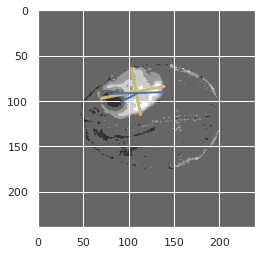

prediction [ 93.5688   77.25659  89.37085 136.30193  99.38381  92.62709  95.19789
 110.5446 ]


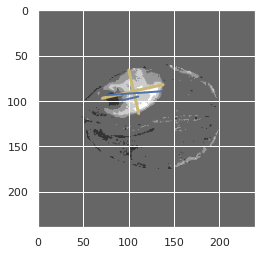

prediction [ 96.75561   75.216965  89.254944 134.9512   104.02399   90.91115
  91.92388  105.29813 ]


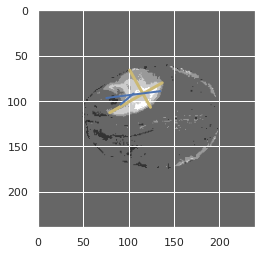

prediction [ 96.79062   79.07757   90.445625 129.9677   102.632996  85.44333
  92.657715 102.28843 ]


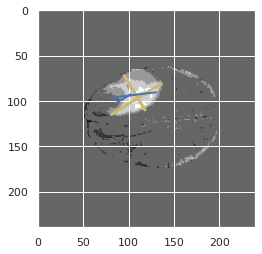

prediction [ 97.104     81.62147   87.83222  131.11053   99.079475  86.61312
  92.88875  106.00979 ]


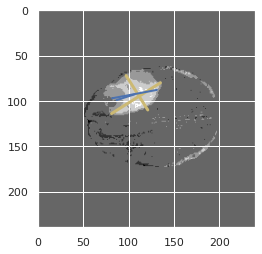

prediction [ 90.36279   80.23284   87.34022  128.4589   100.7599    91.17433
  86.46633  110.361435]


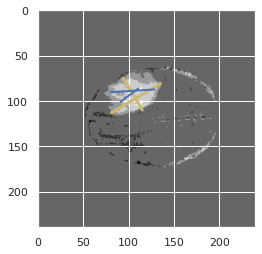

prediction [ 92.44187   82.363304  84.48875  126.739685 102.40399   95.60702
  86.27474  115.702705]


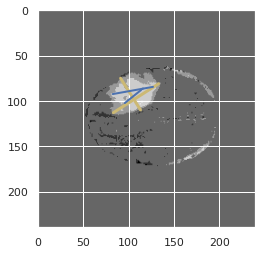

prediction [ 93.42577   82.0215    82.45427  124.94964  102.59995   96.34439
  85.69623  115.555534]


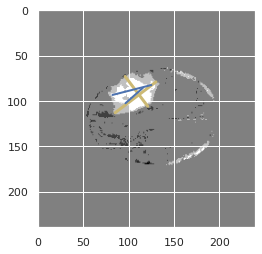

prediction [ 93.54592  85.39745  86.37509 120.87436 102.95041  99.05256  84.07633
 119.52069]


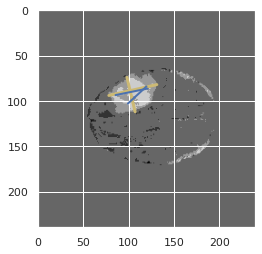

[0.3399685699319015, 0.47555555555555556, 0.21100917431192662, 0.4957841483979764, 0.2840909090909091, 0.06, 0, 0, 0, 0, 0.16783216783216784, 0.5347432024169184, 0.5971370143149284, 0.6201834862385321, 0.6050847457627119, 0.5340751043115438]
prediction [ 88.754005  78.45799   92.02244  120.97747   99.87092  100.502014
  83.84899  116.11263 ]


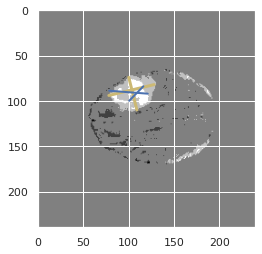

prediction [ 84.9342    80.689804  94.91047  120.35997   98.488846 104.77153
  80.71927  117.554985]


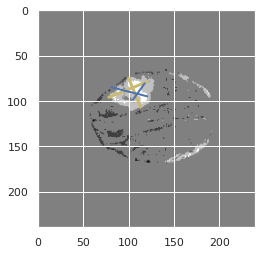

prediction [ 87.029594  91.90655   87.3497   113.74808   92.587875  99.828316
  82.258446 117.789566]


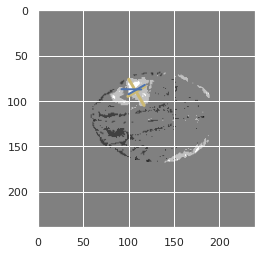

prediction [ 94.61651  103.19884   82.12369  111.53415   88.979744  98.98346
  93.669426 122.277916]


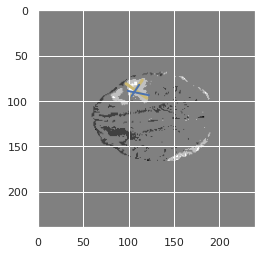

prediction [ 93.0002   100.297935  83.17145  106.51494   89.1778    96.30573
  90.88244  109.05756 ]


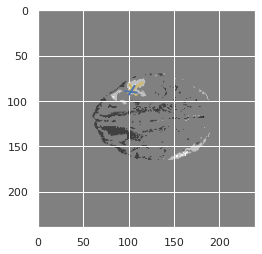

prediction [ 82.3095    92.14846   86.42628   99.759995  91.64057   93.31678
  78.81682  101.62183 ]


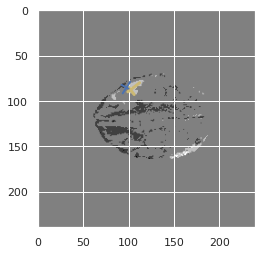

prediction [-0.47397527 -1.2614422  -1.1550215  -1.8859783   0.6445037  -0.44969377
 -1.5637234  -1.6356914 ]


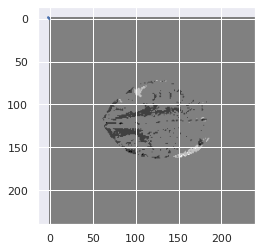

prediction [ 0.21434851  1.3122199   0.98798513 -0.39115798  0.7186126   0.8814002
 -0.6651689   0.66633725]


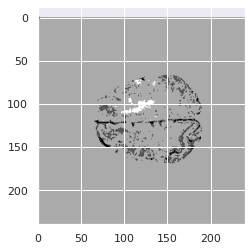

prediction [ 2.0174153   4.693534   -1.6771276   0.88497984  0.12101112  2.0251935
  1.1488154   4.1165323 ]


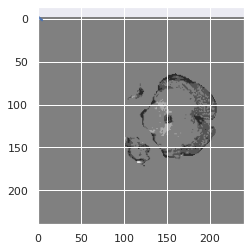

prediction [ 1.1591856  2.283646  -1.9632021 -1.1063536 -1.4447465  0.5341977
  0.9924564  1.6446748]


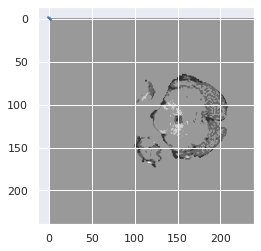

prediction [ 93.19432  105.6418    83.03773  113.02805   88.362404 106.77321
  90.09462  112.42799 ]


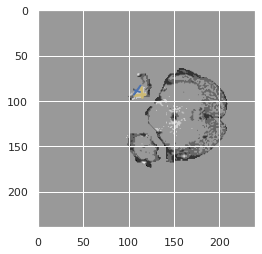

prediction [ 93.05072   99.0435    80.56798  116.06149   82.305275 106.49096
  92.16721  114.21307 ]


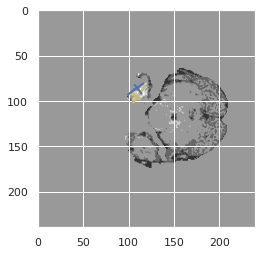

prediction [ 97.97658   97.73866   77.79672  114.35534   79.35933  101.25528
  96.69694  113.860634]


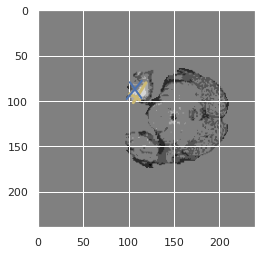

prediction [100.11867  100.30851   80.32212  122.23617   82.030426 105.181145
  99.26231  115.03714 ]


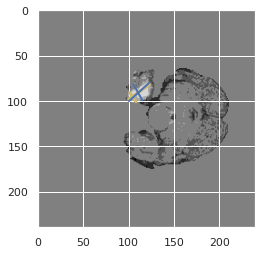

prediction [ 99.47992   97.34647   78.21885  121.81719   84.642044 106.45658
  94.22951  114.78706 ]


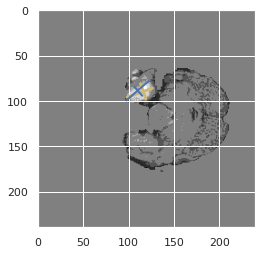

prediction [ 98.36527   95.53375   80.21725  126.28346   83.62649  108.530594
  94.16587  114.01693 ]


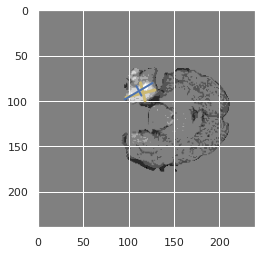

[0.45153061224489793, 0.05729632945389436, 0.20212765957446807, 0.11294642857142857, 0.17727897388914338, 0.48720173535791755, 0.675625233296006, 0.672493100275989, 0.6608799048751486, 0.698220640569395, 0.7058416070191642, 0.8037383177570093, 0.6979836029248837, 0.7376294591484465, 0.6181197267979108, 0.4295641187618446]
prediction [ 97.39369   94.68345   81.393616 127.81914   84.52506  107.32263
  91.87373  114.91511 ]


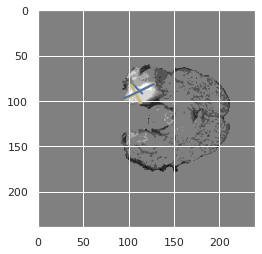

prediction [ 92.36257   95.04167   84.24009  128.81999   87.28228  108.65709
  86.358215 117.80909 ]


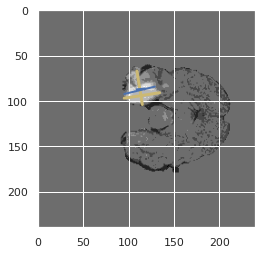

prediction [ 88.45181   96.79185   89.40315  132.3344    92.471695 109.56611
  82.74532  120.84147 ]


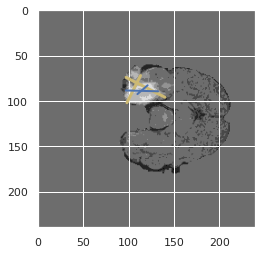

prediction [ 92.000854  95.942955  90.51982  143.74301   93.00691  108.47335
  87.175415 119.20811 ]


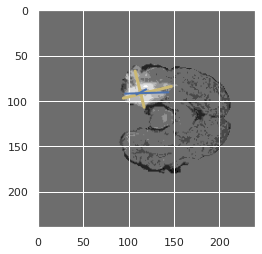

prediction [ 93.63321  94.1912   94.90603 145.29915  95.4274  112.9331   87.90143
 125.41154]


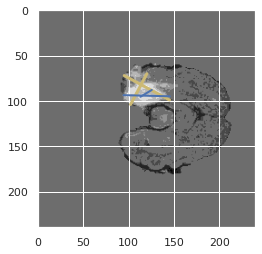

prediction [ 90.55338  89.80657  98.13294 150.70988 100.01598 117.36535  81.71493
 123.27381]


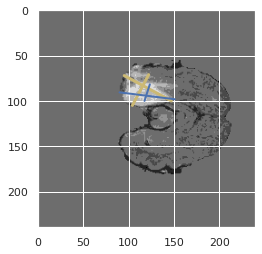

prediction [ 87.1404   89.67582  98.22896 154.95801 104.21345 120.14892  71.9455
 122.30535]


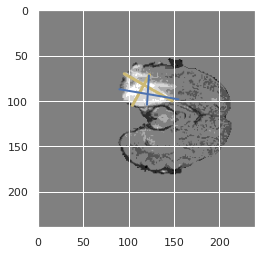

prediction [ 85.66966   85.439255  99.6825   162.67258  106.78121  119.43059
  67.89724  117.66203 ]


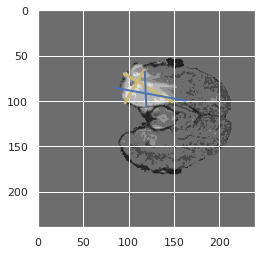

prediction [ 86.06619   83.9765    96.63866  163.1791   111.17174  119.338844
  62.455086 114.88178 ]


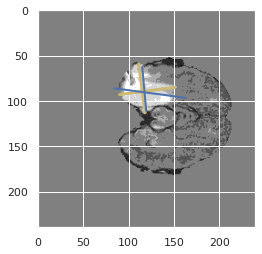

prediction [ 87.08869   87.909325  93.227394 161.83992  115.294914 119.52274
  60.757526 115.895035]


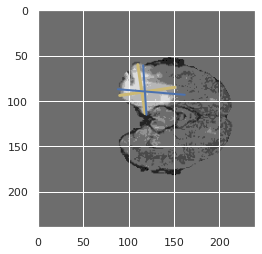

prediction [ 86.47351   87.90354   93.44526  159.51752  118.184875 116.77257
  57.812508 113.964775]


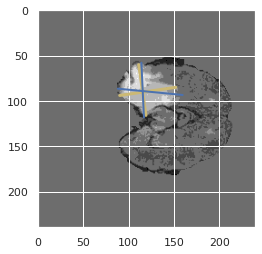

prediction [ 88.10138   86.9195    96.52764  164.48859  119.18792  118.80037
  61.027447 114.87326 ]


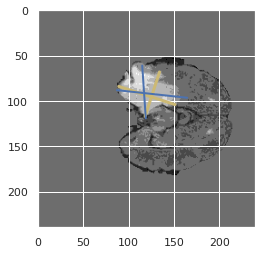

prediction [ 88.46922   91.35316   99.33785  168.7836   120.17049  120.902626
  64.99431  119.59167 ]


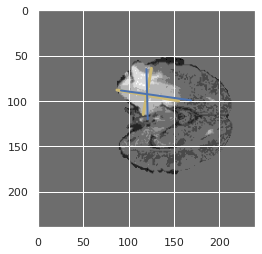

prediction [ 90.781815  88.09303   99.95107  167.87738  118.34291  119.10529
  68.45083  116.30005 ]


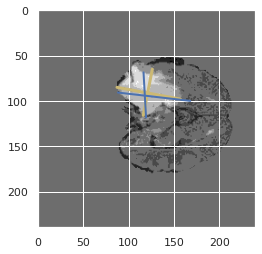

prediction [ 96.121826  89.612015 101.08738  167.9855   118.581085 121.258286
  72.88314  120.126625]


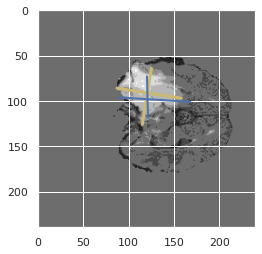

prediction [ 98.93195   90.71518  102.35771  165.05302  112.13794  113.33227
  82.160164 117.11628 ]


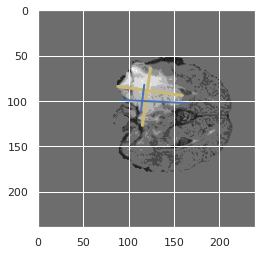

[0.6317489616982003, 0.553328726099977, 0.25489420605101837, 0.17113123915976103, 0.254069355980184, 0.48738091258565935, 0.4765250718620249, 0.39397234736678577, 0.4194640753828033, 0.5208993946382243, 0.4839852398523985, 0.30945863746958635, 0.1584313725490196, 0.08464348102270923, 0.2423559703894432, 0.1679949992186279]
prediction [ 95.191765  90.66456   97.533295 156.65237  118.43025  108.7284
  76.03415  116.88676 ]


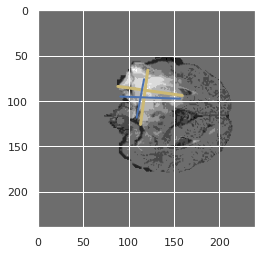

prediction [ 98.82033  90.61747  97.52185 159.04305 115.11869 107.41553  79.32008
 112.82864]


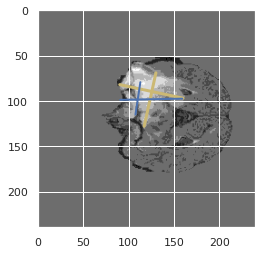

prediction [106.18748   87.88311   95.175735 158.17015  106.81662  106.300545
  87.282745 113.321976]


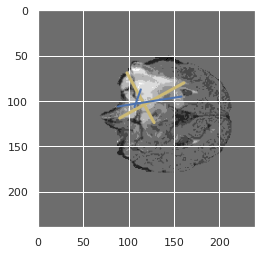

prediction [112.02987   81.66443   88.45604  159.12144   94.41356  104.34295
  96.89043  116.180115]


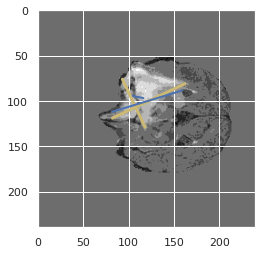

prediction [111.67297   79.03288   86.47756  158.82118   87.933975 102.57842
 102.33582  114.95101 ]


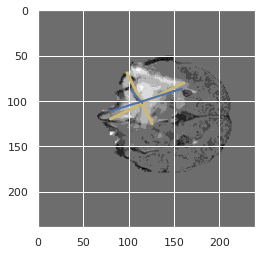

prediction [116.24147  77.73142  79.60778 160.07262  81.86905 102.00409 110.48354
 117.45375]


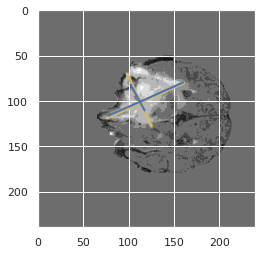

prediction [116.53929   82.303085  75.44662  164.3884    81.62162  105.297104
 108.64198  126.82606 ]


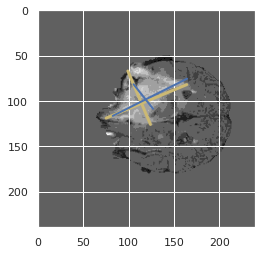

prediction [114.46023   88.403534  75.80759  168.71678   82.81764  112.547134
 106.39807  134.87909 ]


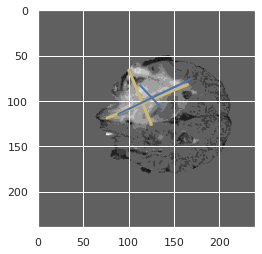

prediction [112.14764   88.751495  74.09856  169.50185   80.74037  111.19003
 108.179756 135.17381 ]


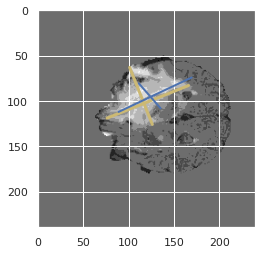

prediction [111.05356  84.67647  72.77469 167.4458   77.29568 109.18046 112.42245
 133.29193]


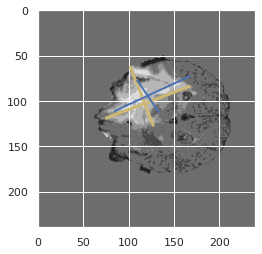

prediction [111.25598  81.9181   75.47769 166.83398  82.34167 111.71143 112.65015
 134.6187 ]


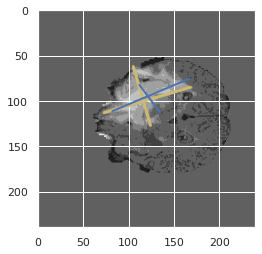

prediction [107.94634  77.70802  77.40487 162.43819  90.00538 106.80999 106.3025
 130.70549]


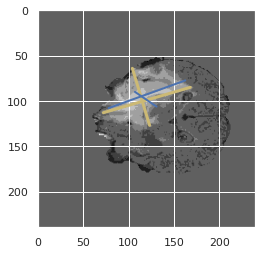

prediction [106.94012   75.64102   80.3036   161.86557   95.40058  107.14352
 101.433205 126.732155]


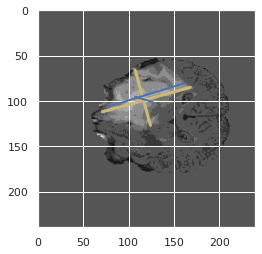

prediction [106.593445  74.56704   84.16332  160.12216  104.064445 106.04198
  93.680244 123.01234 ]


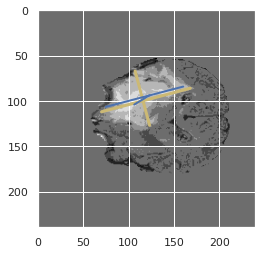

prediction [105.836655  71.00075   86.99109  159.07611  109.16692  107.507484
  89.21332  118.91502 ]


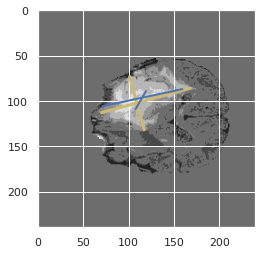

prediction [107.747086  67.525986  85.703384 154.9325   105.84289  105.90739
  90.479225 116.73386 ]


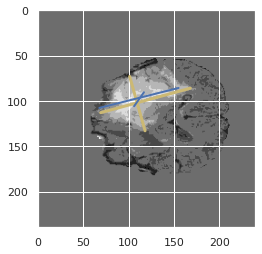

[0.03170616857636164, 0.25203117227657107, 0.3861066235864297, 0.4918778427550357, 0.5126720901126408, 0.6007085020242915, 0.6545483923089352, 0.6465261514441842, 0.5884182464454977, 0.5682852807283764, 0.5961364322366435, 0.6923574083050573, 0.6580319322254806, 0.563183577317853, 0.5434051144010767, 0.6513249651324965]
prediction [108.51024   69.03243   82.78259  152.48164   98.88778  104.4935
  95.163704 119.86663 ]


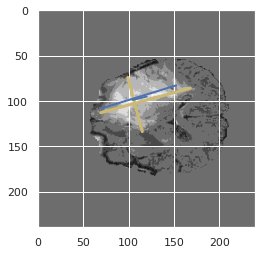

prediction [111.9659   70.10112  79.73352 153.03442  92.10215 104.08887 103.73429
 122.46808]


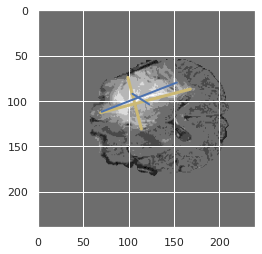

prediction [117.28866   66.95193   70.77469  152.79639   84.956894  98.04953
 105.76597  113.04315 ]


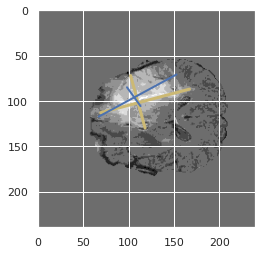

prediction [119.69169   69.31782   76.65505  157.52193   79.74788  100.826775
 109.56594  112.67744 ]


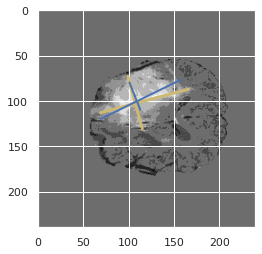

prediction [117.6526    69.524895  84.00237  155.11084   76.27976  102.122444
 111.521164 111.29017 ]


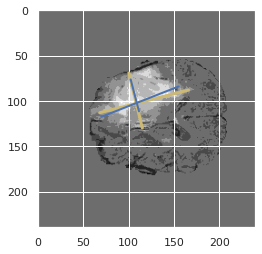

prediction [118.11231   70.21944   85.53147  156.81294   73.348175 105.91808
 112.19651  113.63901 ]


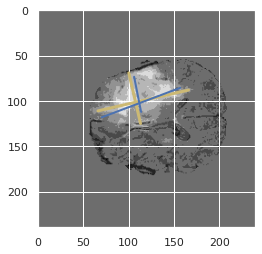

prediction [118.20643   73.094925  84.430214 156.28197   69.48677  106.57748
 115.39994  117.49632 ]


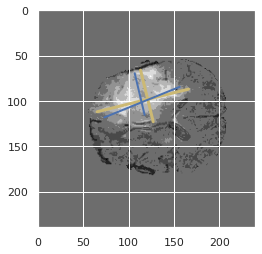

prediction [117.50374   77.993004  85.63794  154.88301   65.09285  108.42358
 119.17119  121.475685]


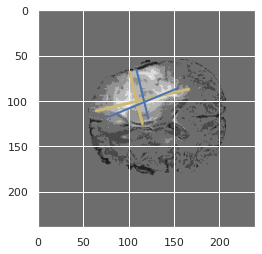

prediction [117.70108   76.61397   84.446335 153.67297   56.347046 111.67133
 126.05125  123.76764 ]


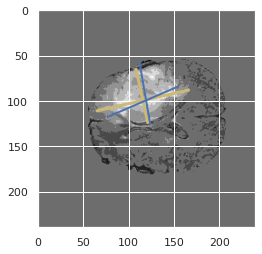

prediction [114.03167   79.91198   82.85081  153.03986   55.804356 111.51311
 123.45449  125.951935]


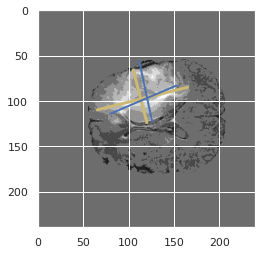

prediction [110.37893   82.07211   79.84437  151.94997   57.324085 111.67106
 120.49156  130.50969 ]


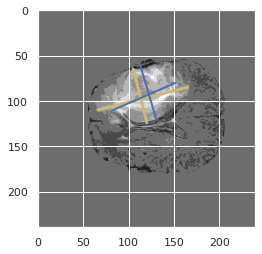

prediction [107.31339   81.34082   83.330315 153.33835   62.79673  114.416855
 116.71158  132.5214  ]


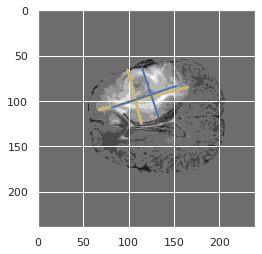

prediction [106.61877   79.523186  85.91538  153.80571   64.50863  114.8189
 114.80472  129.30255 ]


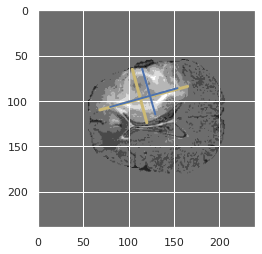

prediction [106.91079   80.75689   84.910706 154.3443    68.946335 113.89083
 110.21933  127.996216]


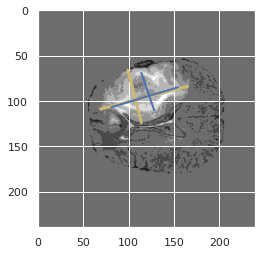

prediction [108.609924  79.26656   85.1287   156.7401    72.27335  113.87964
 109.90966  127.34719 ]


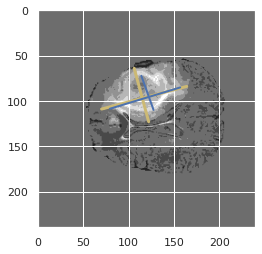

prediction [110.474785  79.71243   83.58048  159.52725   70.88785  114.83161
 113.5475   127.27702 ]


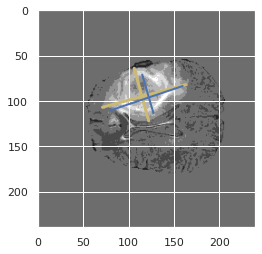

[0.7243311641359363, 0.7529700169715255, 0.7715500579822188, 0.7082418678906406, 0.7289989680082559, 0.5739743058433485, 0.4555579353180553, 0.3043863535666814, 0.19194257930076405, 0.08468818247998058, 0.08956366420005103, 0.12364980102330869, 0.11297666476949346, 0.12020232073787564, 0.23617021276595745, 0.240975935828877]
prediction [108.32393   80.22545   82.68372  160.4481    68.84684  115.15189
 114.593346 128.4746  ]


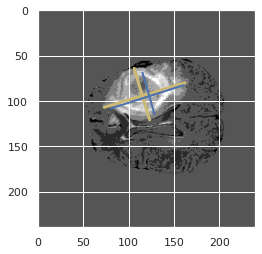

prediction [108.622665  80.124405  83.12731  160.98468   70.15538  112.74432
 115.23722  126.45272 ]


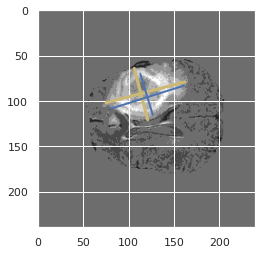

prediction [107.840126  81.77307   83.61271  159.96906   70.01433  111.80802
 116.018    128.05449 ]


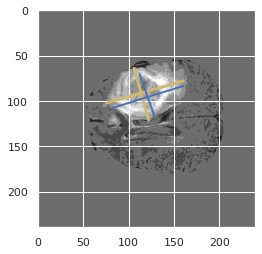

prediction [108.49309   83.61661   84.34906  156.47911   71.6301   109.42923
 114.793945 126.72524 ]


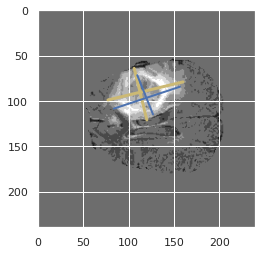

prediction [110.61694   84.02929   85.383354 155.23746   72.58289  108.05494
 115.82551  127.2077  ]


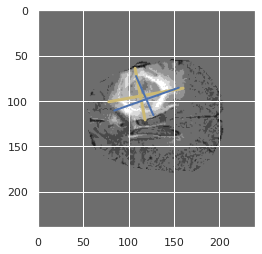

prediction [106.62158  83.23503  84.99758 155.26158  74.05589 110.96274 109.10887
 122.23442]


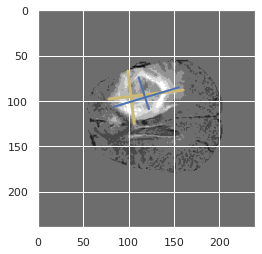

prediction [103.20185   81.55158   87.357994 154.19789   77.03829  112.37367
 104.677086 120.071915]


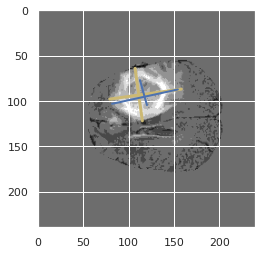

prediction [102.651665  84.013214  87.48919  152.27354   82.2324   112.76723
 100.61433  121.03844 ]


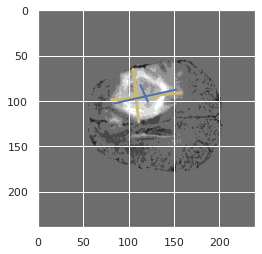

prediction [100.92567   85.7486    88.690735 151.52184   85.68184  114.05546
  96.84962  122.349686]


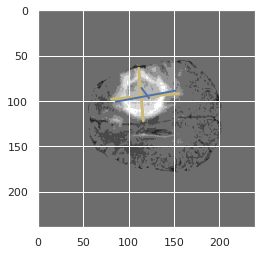

prediction [100.22703   90.01275   90.844864 151.52422   90.61364  117.024765
  93.400826 122.680466]


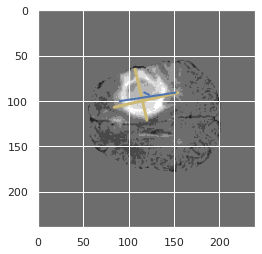

prediction [ 97.3826    91.453064  94.75295  152.76822   93.78085  116.14454
  90.402985 121.25361 ]


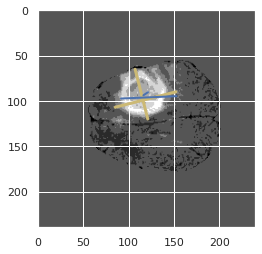

prediction [ 95.70574  91.80988  94.96453 152.1197   95.32475 115.25484  87.77364
 120.00134]


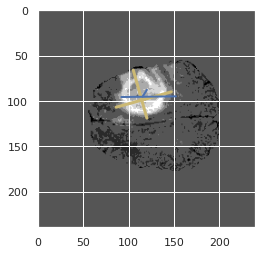

prediction [ 95.63523   93.45787   93.80441  151.7314    92.82465  114.319214
  87.68102  119.269226]


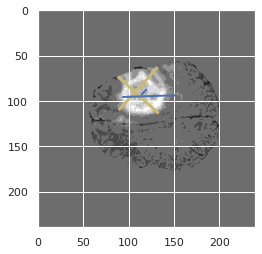

prediction [ 93.73802   97.78528   96.677574 149.01671   92.9932   113.41361
  86.38312  121.31472 ]


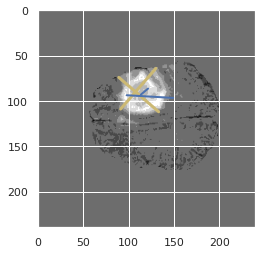

prediction [ 94.17858   98.957405  97.939125 147.2023    98.58116  111.59971
  82.73918  121.836136]


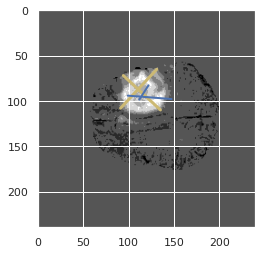

prediction [ 98.76092   99.12789   94.31461  146.04381   98.849846 110.19377
  82.43222  121.8467  ]


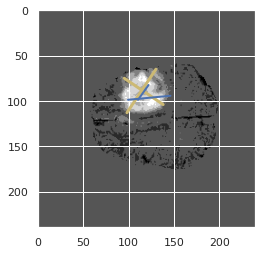

[0.19585561497326204, 0.1299126637554585, 0.1112787627310449, 0.15384615384615385, 0.05118733509234828, 0.04556166535742341, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
prediction [103.288315  98.050224  92.44454  144.75414   96.93667  111.00279
  85.71889  122.35275 ]


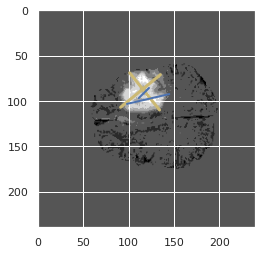

prediction [103.87957   97.35571   90.76699  139.6707    93.49288  109.763596
  87.97077  121.6753  ]


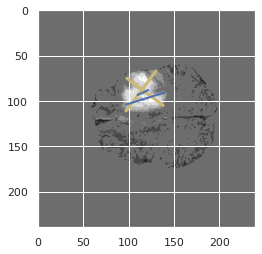

prediction [102.65737   95.099724  86.7051   135.86919   94.0392   106.91551
  84.9383   122.76906 ]


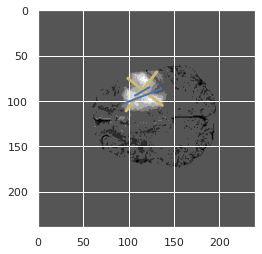

prediction [ 97.855354  92.69115   87.38544  129.96147   96.3445   107.2157
  80.9392   122.912125]


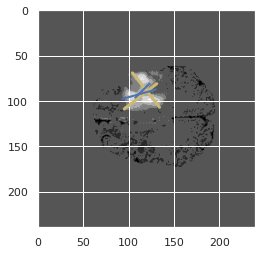

prediction [ 89.19064   91.9642    84.10664  121.10549   84.820404 104.564644
  80.80757  120.93592 ]


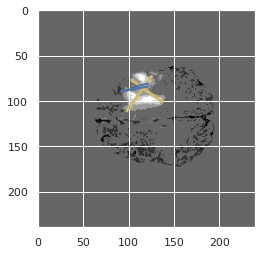

prediction [ 93.17034   92.55785   77.162506 120.59151   78.38901  102.14537
  85.2746   120.997925]


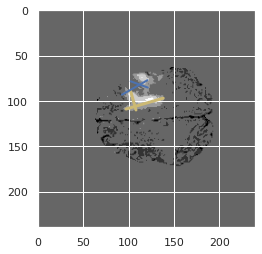

prediction [ 91.36538   95.44196   76.00414  117.948166  85.58521   99.71945
  81.16068  120.67727 ]


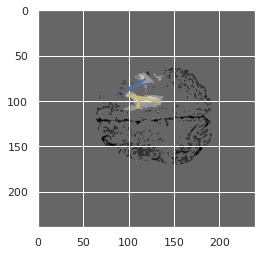

prediction [34.568176 42.036766 30.752825 42.991016 34.544197 40.71509  30.692722
 44.664845]


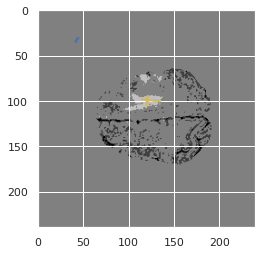

prediction [46.47167  46.847622 32.57541  45.424683 38.957733 47.419193 37.335426
 47.550274]


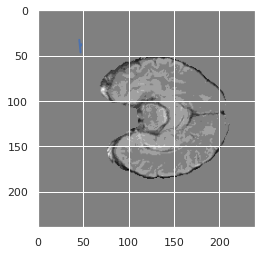

prediction [37.064762 63.672737 31.06011  55.182655 41.05179  51.04848  30.409546
 56.90054 ]


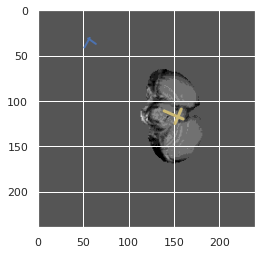

prediction [20.281767 38.46517  11.646658 27.68385  20.699778 26.59781  15.799035
 31.316338]


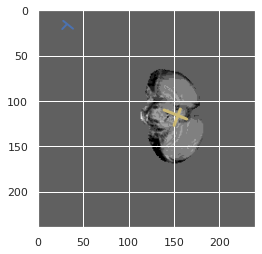

prediction [41.511784 61.162537 23.678059 49.66709  39.13215  45.944748 34.560234
 54.243343]


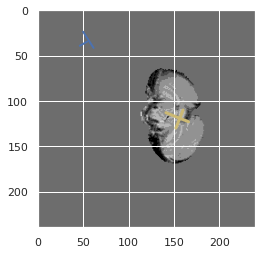

prediction [ 65.77812 103.13822  52.85537  94.51751  64.77744  83.0989   63.28999
  94.39419]


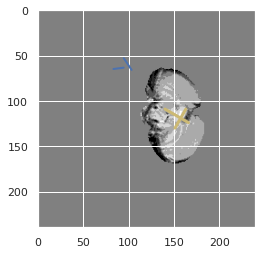

prediction [ 75.32353 115.63887  67.97068 108.59391  78.9788   93.4938   75.72731
 108.50501]


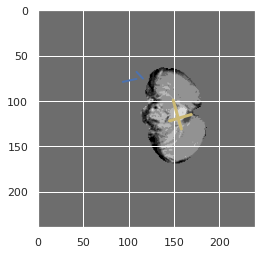

prediction [ 71.81868  109.51765   76.65492  120.35068   82.31877   99.287025
  72.145615 112.68004 ]


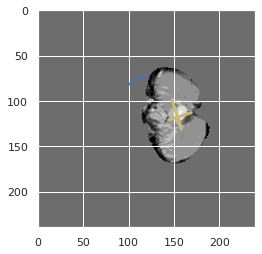

prediction [ 64.63593  107.33158   76.90622  115.67304   79.06655   95.635765
  68.6597   114.44138 ]


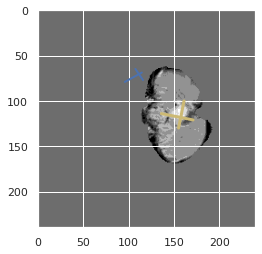

[0.0, 0.0007692307692307692, 0.002793296089385475, 0.0, 0.03288672350791717, 0.05948215535339398, 0.01989389920424403, 0.07959814528593509, 0.016740088105726872, 0.0, 0.0165016501650165, 0.10887350534927627, 0.1397738951695786, 0.07258064516129033, 0.030671602326811213, 0.10456140350877192]
prediction [ 66.95999  112.577095  86.65191  127.482376  85.2907   104.97632
  70.94274  123.97896 ]


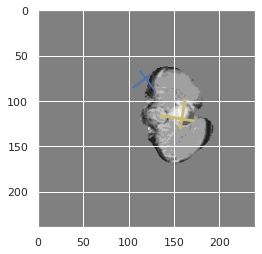

prediction [ 85.95901  111.10217   95.072556 143.54826   93.19215  114.07318
  88.04414  131.42998 ]


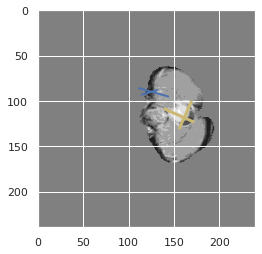

prediction [ 85.418236 104.98299  101.98164  140.8957   103.644806 108.95436
  88.161674 128.169   ]


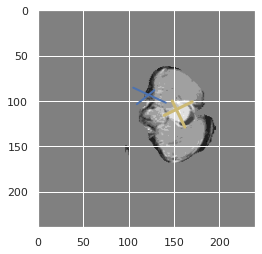

prediction [ 88.168205 103.06215   96.77681  139.42392  104.45735  113.355965
  92.693855 126.36005 ]


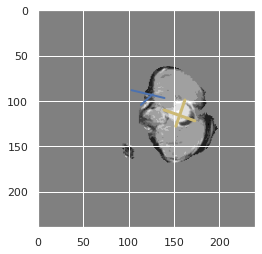

prediction [ 99.765434 102.38829  100.622406 147.32817  107.07392  121.880264
  95.892235 125.33917 ]


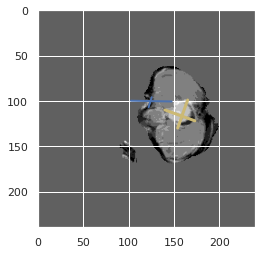

prediction [104.08241 107.58355 102.1298  151.59698 107.76844 124.92995  98.62153
 127.78227]


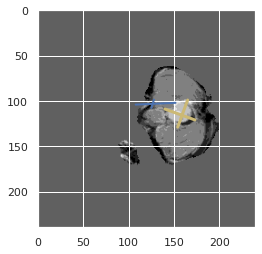

prediction [100.107086 106.732895 102.26042  144.5628   106.0447   122.566734
  94.25301  122.43247 ]


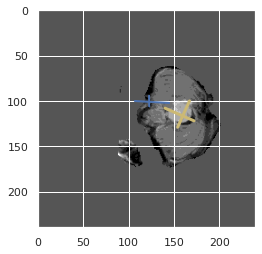

prediction [109.628624 115.57346  106.02239  154.23677  109.86043  132.24232
 101.004364 132.81856 ]


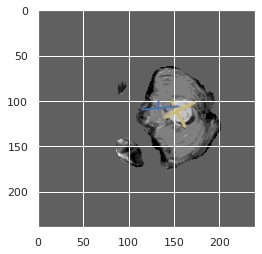

prediction [109.22814  120.16854  102.30633  152.24074  105.6573   137.99048
 101.403175 139.3395  ]


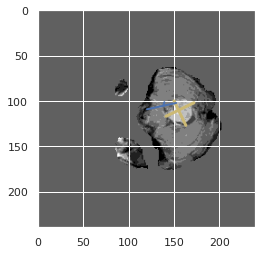

prediction [104.08642 114.95661  95.94276 148.51906  99.84177 132.28252  96.79745
 138.66023]


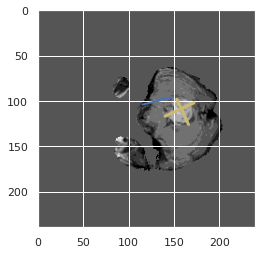

prediction [110.596275 130.14511   93.38902  156.17792   96.749825 140.73366
  97.709854 153.42285 ]


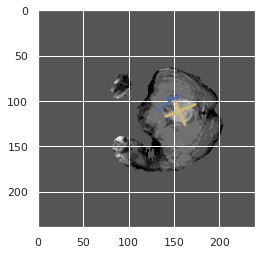

prediction [111.610016 135.18199   87.89448  152.0656    86.13607  137.03468
  97.98326  158.09286 ]


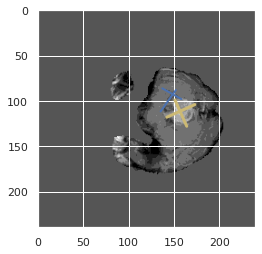

prediction [133.6693  133.77391  77.24342 149.09966  86.69208 135.22575 113.81819
 153.18481]


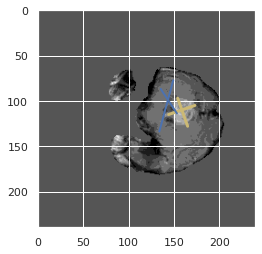

prediction [128.25098 130.27286  73.5682  146.6848   82.66991 133.27896 108.86427
 150.21603]


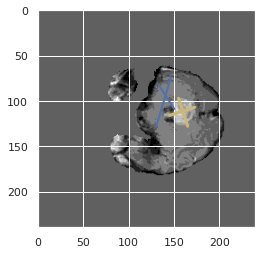

prediction [124.6453  128.51688  73.27775 144.26154  79.36943 131.14746 107.91747
 148.67001]


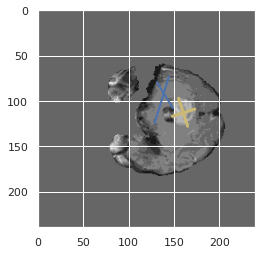

prediction [123.39439  133.31244   79.05606  146.61949   82.623566 137.45369
 112.35577  152.73315 ]


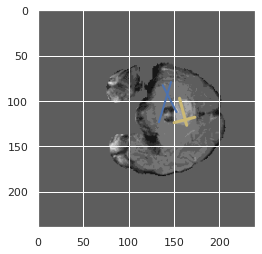

[0.08187134502923976, 0.270979020979021, 0.14131501472031405, 0.008683068017366137, 0.03936039360393604, 0.15317286652078774, 0.0, 0.0, 0.0, 0, 0.0, 0, 0, 0.0, 0.0, 0.35361216730038025]
prediction [116.63929  134.68575   80.3077   144.29095   84.80956  138.16792
 107.504524 153.87656 ]


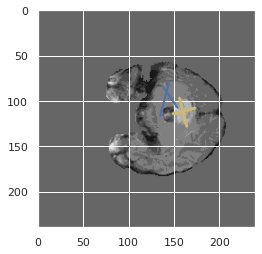

prediction [116.98622 137.00664  92.94955 156.42903  93.54586 146.17404 109.80925
 161.36903]


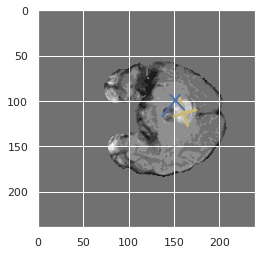

prediction [114.07706  137.72627   95.389275 153.70428   93.96582  141.64668
 106.3678   161.01697 ]


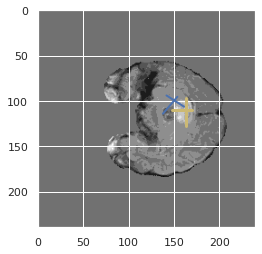

prediction [110.41433 135.58907 102.85217 144.08853 107.83706 134.14775 100.78266
 147.44792]


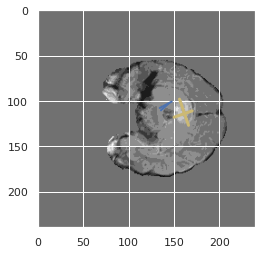

prediction [122.47656  129.78746  115.4046   154.78949  117.847885 139.40967
 121.304436 144.89893 ]


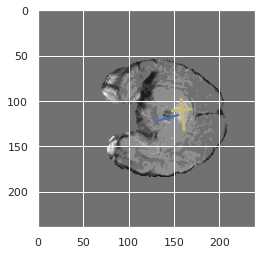

prediction [121.95031 148.57347 122.73171 164.3904  123.58909 149.49622 128.22925
 159.44012]


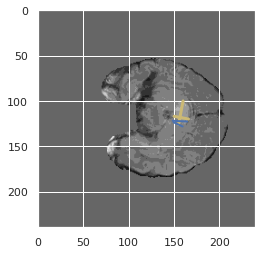

prediction [107.802605 120.43104  100.84604  142.623    102.96889  126.08472
 111.952194 133.40569 ]


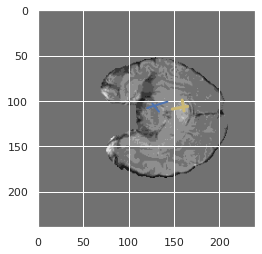

prediction [105.640625 126.03834   94.87867  131.35501  102.62644  116.993805
 103.19154  127.73244 ]


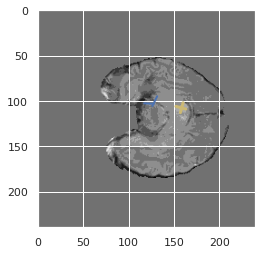

prediction [65.81534  90.4065   59.04671  77.707436 60.736145 75.52573  63.06237
 82.105   ]


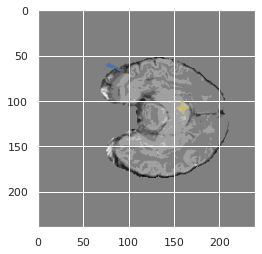

prediction [-2.8451262 -1.9541035 -5.2206354 -9.540074  -7.594497  -9.158822
 -3.8308182 -6.9979486]


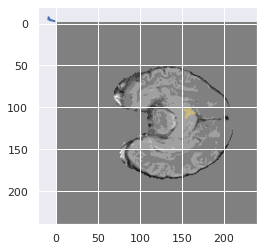

prediction [10.96026    8.933472  -1.8879992  4.4370975  3.4220119  7.6322994
  2.7390566  5.1971836]


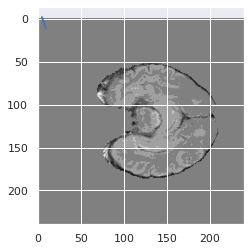

prediction [ 1.3848857   0.18537916  1.5655396  -1.5600559   1.3711622  -0.77305925
  1.945256   -1.0679669 ]


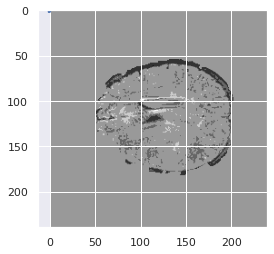

prediction [1.7132349  2.1523623  0.04607174 0.99712145 1.0035446  2.0427544
 0.15058467 1.6404293 ]


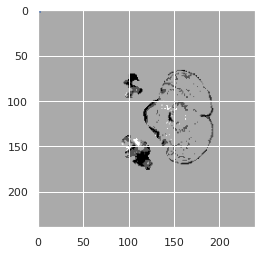

prediction [149.34544 107.23191 147.71832 113.85484 154.4674  114.75481 145.33481
 117.39022]


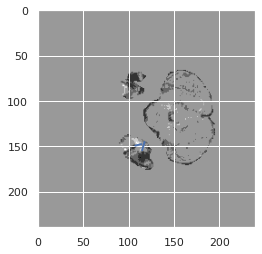

prediction [148.45062  110.78678  151.1949   115.594444 155.56125  112.86947
 146.72066  121.2104  ]


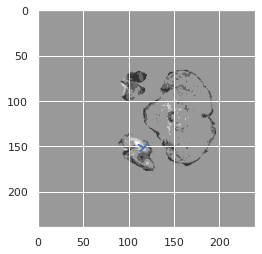

prediction [153.69138 103.68305 152.18204 117.69536 161.18254 110.0524  148.87128
 118.01254]


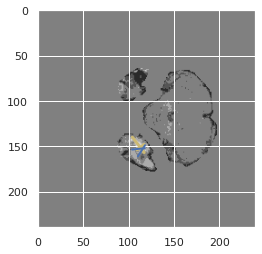

[0.164969450101833, 0.059534081104400345, 0.2659486329743165, 0.3670012547051443, 0.6654191616766467, 0.6881972988843218, 0.6308012486992716, 0.5938560457224504, 0.5757097791798107, 0.5470257813625234, 0.5567697984672154, 0.6901966763226102, 0.7004020518508249, 0.6524414715719064, 0.6925869049281027, 0.7450101243853052]
prediction [164.22902  110.792305 151.12921  115.932945 169.81046  113.69327
 151.83218  124.710976]


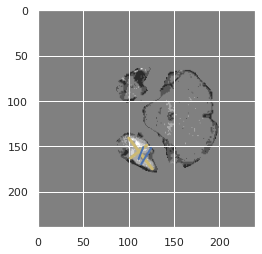

prediction [161.23976  111.89365  156.32886  119.16837  167.56892  109.933014
 150.22296  127.789986]


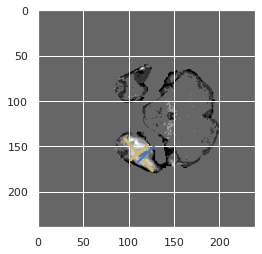

prediction [156.32889   98.28867  153.45355  128.68896  164.57545  109.95162
 145.68108  122.650894]


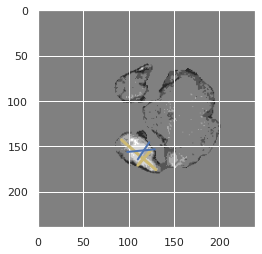

prediction [154.3239   98.50316 157.20766 141.43922 165.06111 111.55361 144.59218
 125.14645]


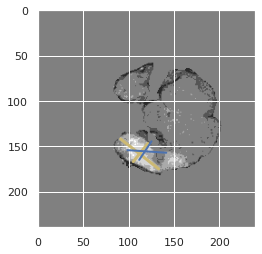

prediction [151.29732  91.26384 166.52502 151.54211 175.91902 112.15801 138.40279
 128.19867]


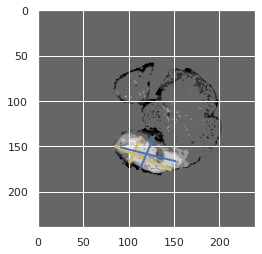

prediction [153.61877  90.22361 159.20209 166.17516 177.78868 123.57724 135.56783
 134.40356]


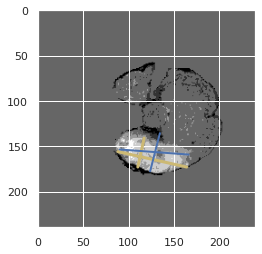

prediction [154.28506  87.63611 160.30688 172.14041 185.03696 128.4185  130.42346
 134.79689]


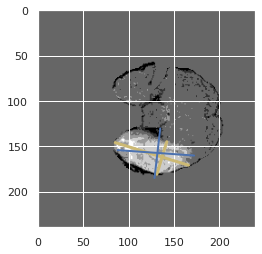

prediction [153.34927  85.86605 160.11113 172.58241 189.29568 128.33734 126.14306
 132.82307]


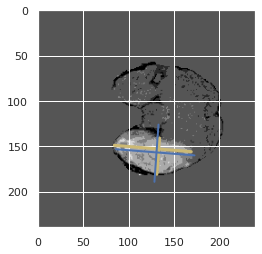

prediction [152.97006   82.786934 159.17908  173.62254  192.70848  127.529625
 122.261444 128.63976 ]


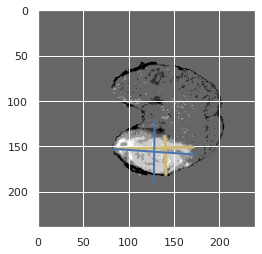

prediction [150.75996  81.45518 156.97726 174.17241 196.38396 127.84318 116.1713
 125.59155]


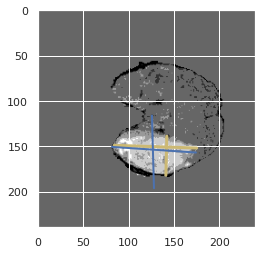

prediction [152.40178  81.15036 156.4135  177.05333 200.68811 130.30952 114.45721
 124.0387 ]


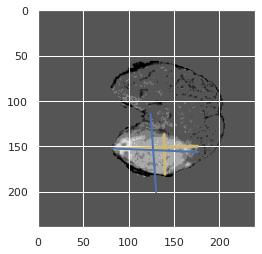

prediction [157.2641   78.02134 152.57768 184.93594 187.16266 135.48201 125.80876
 126.57135]


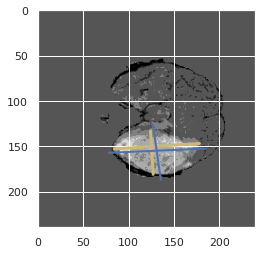

prediction [158.48932  78.37794 155.26132 190.8975  190.78935 139.98615 128.86934
 129.44234]


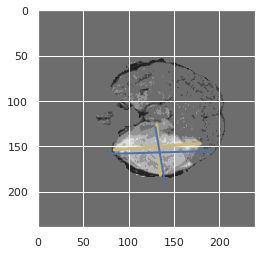

prediction [157.09483  78.61884 157.20049 192.82758 189.36023 139.91624 131.70624
 128.70645]


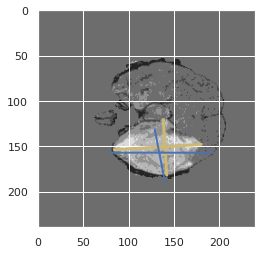

prediction [155.82426  79.46351 156.0753  191.30156 187.3456  139.0418  131.53465
 129.22708]


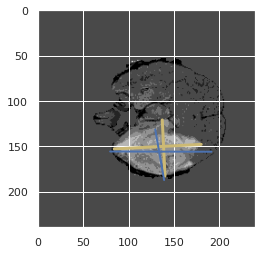

prediction [153.75342  81.61717 155.39116 188.7309  186.97775 136.62056 129.20674
 128.151  ]


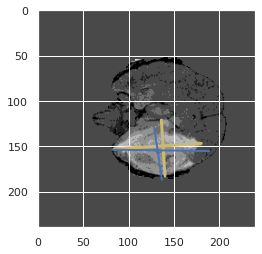

[0.7463920414740087, 0.7930033386558282, 0.6932033182942803, 0.7478451224517718, 0.8047666619095191, 0.8480993487808571, 0.8501906941266208, 0.8272042534337616, 0.8023390124169795, 0.7238705829730133, 0.6525807425294295, 0.6591526778577138, 0.6714872887806363, 0.6815276695245518, 0.7586994727592267, 0.6873779513580686]
prediction [149.61647   84.084656 159.48122  185.1525   190.09796  128.73604
 123.89991  126.17988 ]


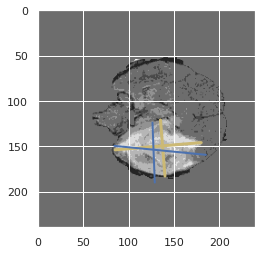

prediction [149.13776   83.357796 157.46521  182.18958  186.83258  123.144424
 122.02762  125.186035]


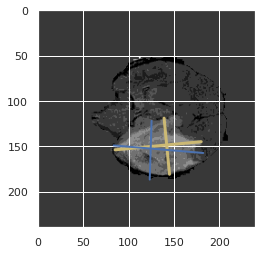

prediction [139.53638   79.09148  159.39081  179.89708  177.47568  120.150696
 127.1252   126.391754]


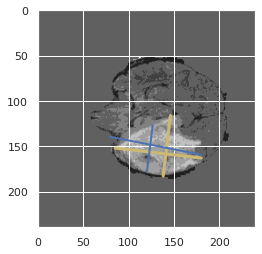

prediction [146.92332  81.8324  162.28867 184.98308 184.76302 123.93188 120.5428
 123.51614]


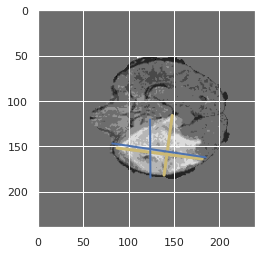

prediction [152.36035  83.89173 158.85094 184.70294 184.31194 128.78755 118.63878
 122.26506]


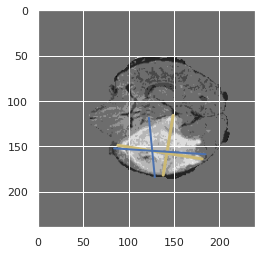

prediction [153.4072    86.489044 157.47414  185.27592  181.98518  131.22615
 120.21456  124.69461 ]


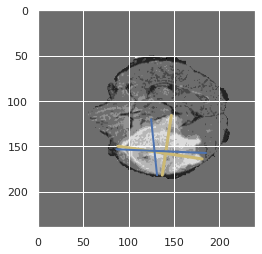

prediction [154.20169   87.88151  155.89452  184.55896  180.82918  130.70055
 120.524124 126.22224 ]


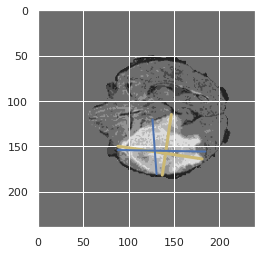

prediction [153.53508  89.93788 157.34322 184.1826  182.54227 128.7387  119.95515
 127.00438]


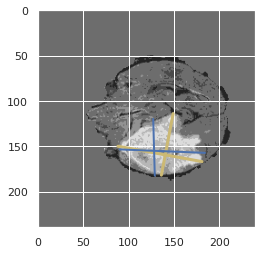

prediction [156.74081   89.785095 157.23164  186.8401   182.37596  130.12804
 120.330925 125.53028 ]


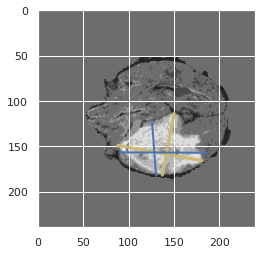

prediction [155.19727  89.63839 156.55978 184.27924 177.18723 127.91325 124.56427
 126.20644]


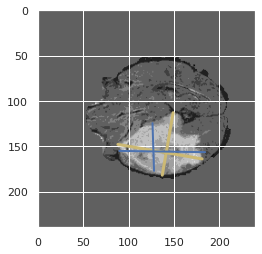

prediction [156.03725   89.647575 153.24564  183.397    173.20996  129.00189
 126.6051   127.360855]


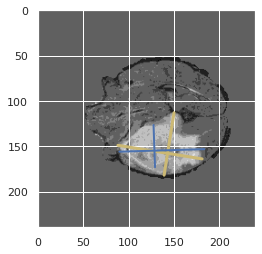

prediction [153.53336   90.19586  152.11969  181.23193  172.2562   125.72123
 126.590485 128.30305 ]


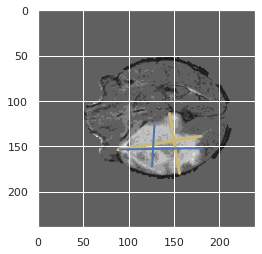

prediction [152.49481  88.13442 150.02007 177.04262 174.01674 121.993   123.68789
 124.68235]


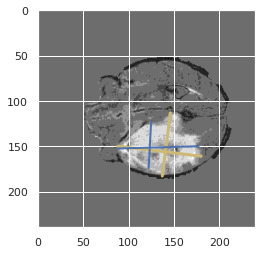

prediction [151.87761   87.06898  149.8947   174.31638  174.62674  120.32291
 123.486336 123.36838 ]


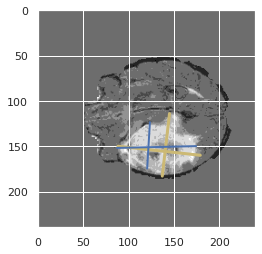

prediction [153.62169   88.11961  151.20457  175.01305  175.1145   123.048515
 124.718094 125.4382  ]


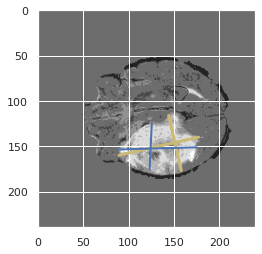

prediction [160.1027   91.58559 150.56537 174.48267 176.1579  127.61025 128.76329
 128.82758]


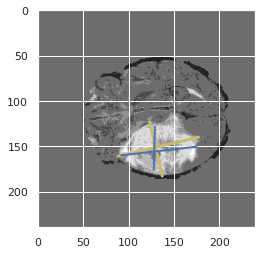

[0.6223477070499658, 0.640669014084507, 0.7044854881266491, 0.7103260869565218, 0.6293505561535702, 0.6771755162241888, 0.6713441654357459, 0.6556541438550123, 0.6103650463400795, 0.6383226557949913, 0.6247528667457493, 0.6998375304630382, 0.6332315743567379, 0.5842748443624626, 0.6324350570526827, 0.6345135210482297]
prediction [157.15858   91.633156 156.76839  178.74568  173.81715  130.49765
 131.3142   131.4865  ]


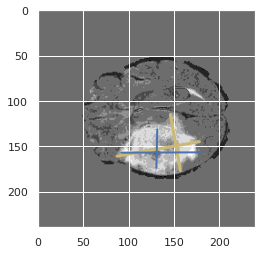

prediction [154.9615   89.40218 157.93172 177.45229 173.25095 128.41774 131.50237
 128.13463]


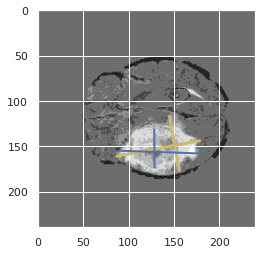

prediction [153.90149   86.96108  154.42416  175.37613  173.91211  126.66915
 127.12545  125.016685]


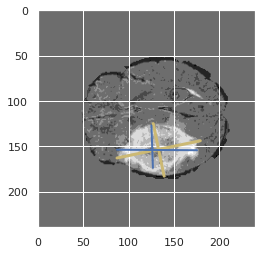

prediction [153.67128   89.345345 154.57645  177.76865  174.25339  128.34099
 129.0127   127.82478 ]


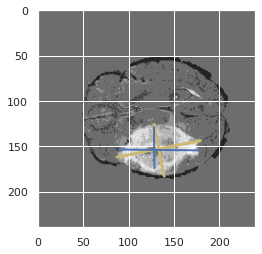

prediction [155.50644  87.20765 152.94408 177.12793 171.00233 128.27054 131.72145
 126.69211]


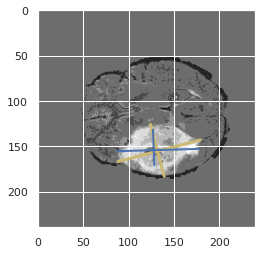

prediction [157.3194   85.97355 154.03497 177.86797 173.76678 130.36238 133.32335
 126.6202 ]


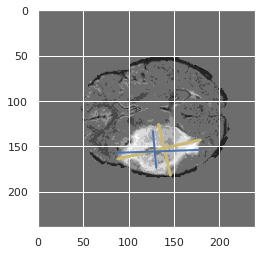

prediction [159.06691   84.730255 152.12515  177.82735  173.22934  131.60915
 133.2936   125.19724 ]


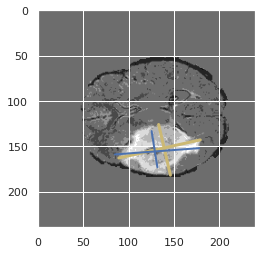

prediction [158.22577   86.35658  152.30328  177.59415  171.9209   131.93398
 133.53105  126.057014]


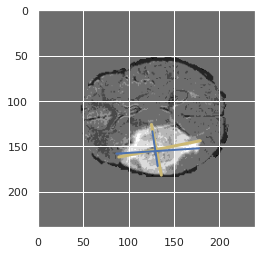

prediction [157.96693  87.27429 150.09811 174.12227 170.18927 128.44855 132.85873
 124.49993]


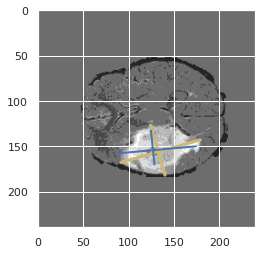

prediction [157.25159  88.86671 148.31299 172.74673 170.14557 126.97197 130.8193
 123.79809]


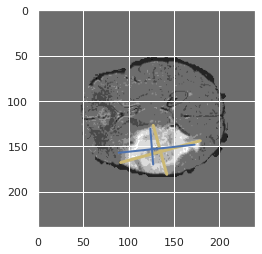

prediction [158.93495  92.55414 147.99333 169.88423 171.80063 126.00767 131.01646
 124.34232]


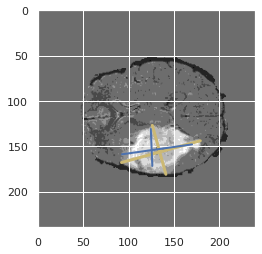

prediction [160.35344  94.05205 146.09802 168.94678 174.8779  127.77672 127.96764
 124.10931]


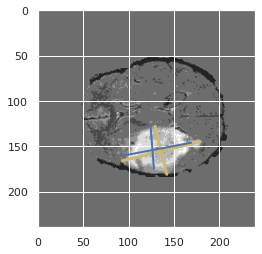

prediction [160.31256  94.84357 145.58627 165.07683 171.66313 127.71564 130.09776
 124.49256]


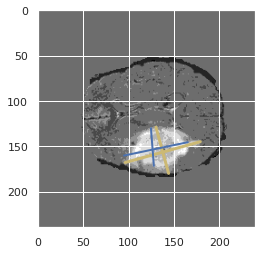

prediction [155.74208   91.676636 149.41737  163.63713  169.558    130.88452
 133.05545  127.75451 ]


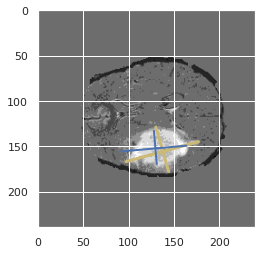

prediction [153.90729  89.25562 151.08937 163.19125 171.82658 130.2754  132.90782
 126.98635]


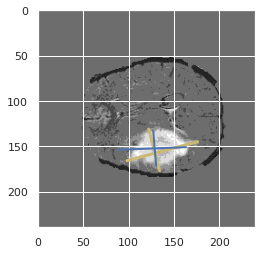

prediction [159.46567  93.83057 150.60075 165.11096 172.78983 131.41066 139.46579
 127.7576 ]


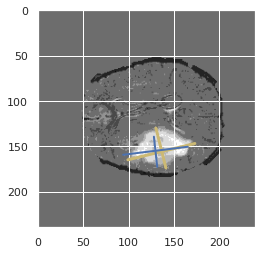

[0.488939492517892, 0.08611875737318128, 0.17058823529411765, 0.0923581809657759, 0.12703412073490813, 0.12320916905444126, 0.26866666666666666, 0.43270189431704886, 0.2779874213836478, 0.0735009671179884, 0.01838235294117647, 0, 0.0, 0.0, 0, 0.0]
prediction [159.48251  95.01954 149.17007 167.72977 166.18282 128.02924 144.57494
 124.69054]


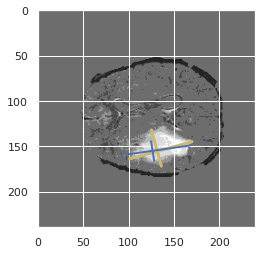

prediction [156.73582  99.06207 151.19104 170.93231 154.39093 130.81877 151.06012
 133.98567]


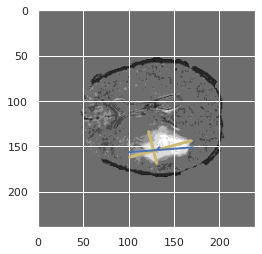

prediction [158.44684 107.81725 149.81032 171.4408  150.75073 135.36713 156.46126
 141.68105]


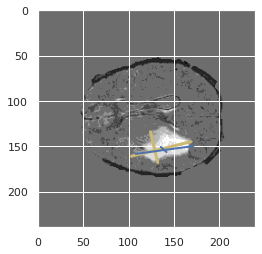

prediction [163.19954 112.74627 150.58252 170.09677 154.31372 137.79745 155.05559
 143.33537]


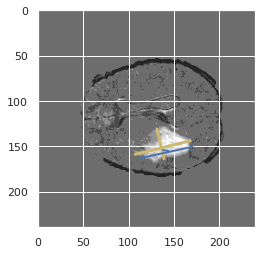

prediction [164.74573 115.71834 146.91069 167.68443 156.20792 136.4142  150.92241
 142.73605]


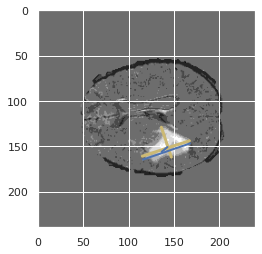

prediction [166.03175 118.5921  143.74066 164.54181 152.8528  136.40193 152.14078
 143.8495 ]


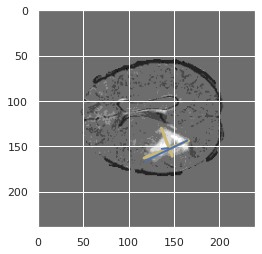

prediction [162.37473  121.654465 139.79558  159.51172  146.28438  136.97183
 152.21854  144.9725  ]


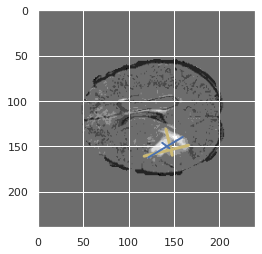

prediction [160.33536 125.11953 137.91766 156.027   141.39554 138.24507 154.53354
 143.56583]


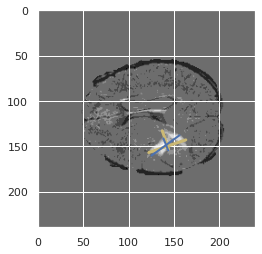

prediction [153.71446 129.1558  138.58813 149.75438 141.1404  137.94708 151.1951
 140.86398]


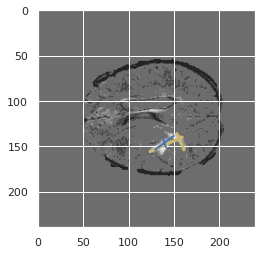

prediction [154.24081 132.65404 148.31097 143.683   154.01988 139.21104 149.50351
 142.90323]


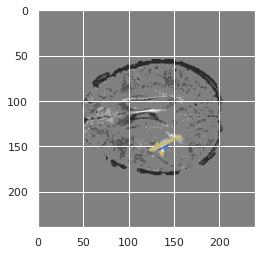

prediction [149.03383 133.48618 139.02684 132.91718 150.4294  131.67288 140.76416
 132.18921]


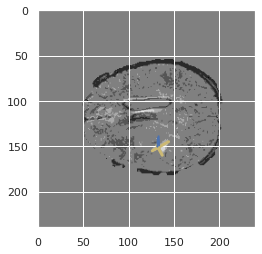

prediction [ 0.7088376   0.42140013  1.1908679  -2.2064521   0.8449407  -0.8852899
  2.03851    -1.0261731 ]


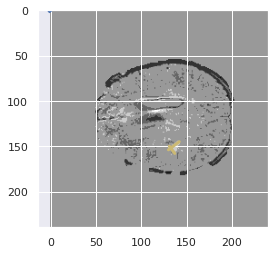

prediction [114.47005  106.559975 106.52502  132.99664  110.631195 120.64529
 105.0856   120.85471 ]


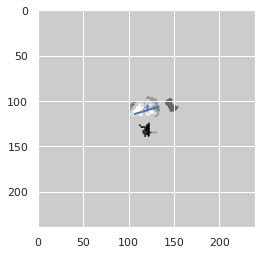

prediction [ 0.82552314  2.6416688   0.48025766  5.6453223   2.6146584   3.7267401
 -1.9740701   3.0888157 ]


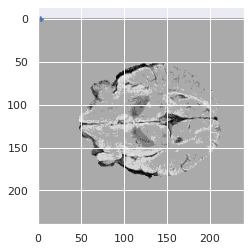

prediction [2.402483   4.473525   1.2241352  4.764684   2.275471   4.384582
 0.40523607 5.3233275 ]


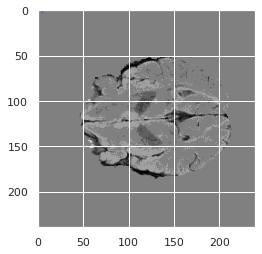

prediction [ 2.9284194   4.962937    0.24059856  4.673038    2.8499813   4.565364
 -0.48638412  5.838419  ]


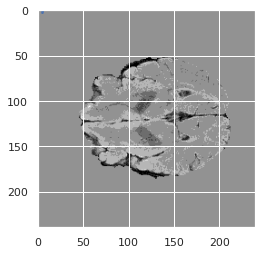

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.08798283261802575, 0.12734864300626306, 0.06314432989690721, 0.2601330913490623, 0.5533437013996889, 0.5451310255580718, 0.4245047124447009, 0.507876370887338, 0.5205721349108247]
prediction [4.662787  6.3224387 1.8128543 7.9641185 5.4943757 7.7248125 0.4623637
 8.148865 ]


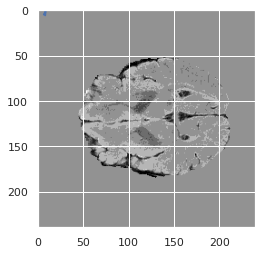

prediction [ 6.8166323 10.780324   2.9623213 12.150492   7.045881  11.479505
  2.652143  12.626499 ]


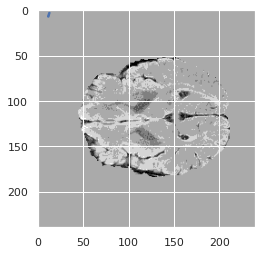

prediction [ 4.4316163 10.355008   6.7729087 12.286806   9.436067  11.577509
  2.1360676 13.362938 ]


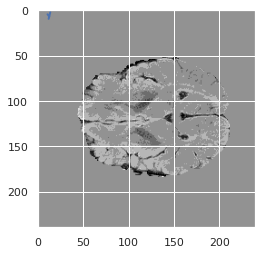

prediction [12.627954 18.319275 14.331363 20.136003 17.233438 20.36532  10.063655
 23.303738]


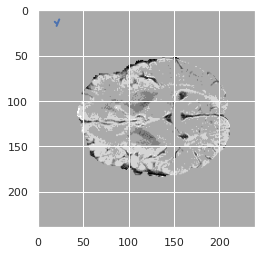

prediction [ 5.7445865  9.64682    7.909119  10.7177725  9.604601  12.459351
  4.7720733 14.310369 ]


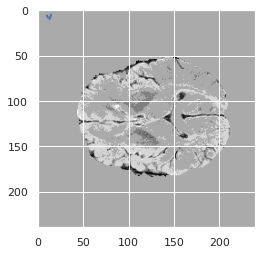

prediction [ 5.8125114  9.266295   7.1142573 11.131922   9.391591  12.6310835
  4.8399963 14.266663 ]


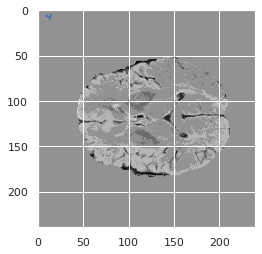

prediction [25.979746 24.72548  33.23094  18.992254 34.54618  35.922268 20.577845
 29.88873 ]


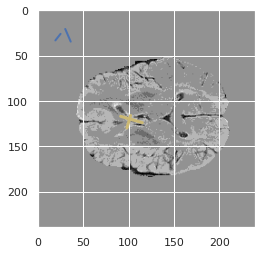

prediction [124.94545  103.6491   122.280754 110.435936 128.70883  104.95415
 116.42864  113.82432 ]


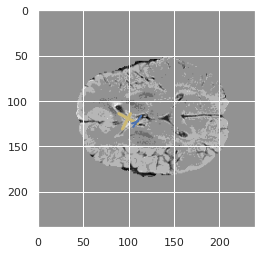

prediction [125.867455  94.68458  121.43112  101.101456 125.996895 102.67132
 118.58506  104.70205 ]


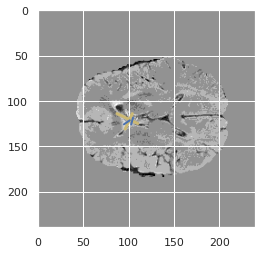

prediction [111.988594  87.50636  111.653244 101.00283  115.21578  100.855644
 111.89349   99.35622 ]


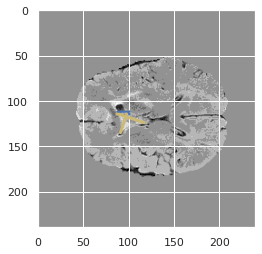

prediction [104.94527   72.297    103.923874 112.25355  115.2086   104.48823
  98.052574  92.437225]


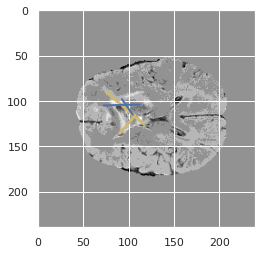

prediction [ 98.57019   55.938496  96.66515  121.95692  122.01806   93.57661
  77.37536   81.96975 ]


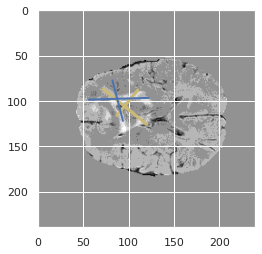

prediction [101.64246   61.421127 103.20409  128.8283   114.99029   94.4874
  86.9007    92.68841 ]


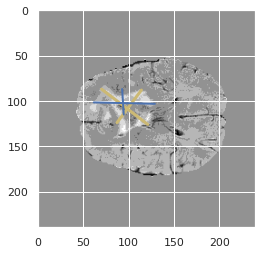

prediction [ 99.93856  57.53363 105.42047 128.1761  123.53675  96.97281  77.27405
  90.06146]


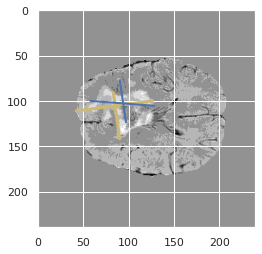

prediction [104.95067   61.05736  109.07341  126.071335 134.52376   96.78755
  78.46245   89.2259  ]


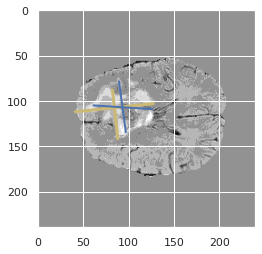

prediction [112.041954  62.78136  105.675446 118.19044  140.37794   88.68979
  76.788155  89.157326]


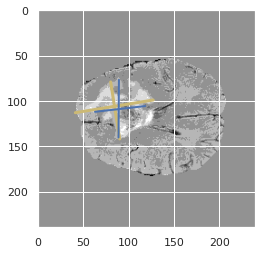

[0.37224982256919803, 0.40604575163398693, 0.26599432713520327, 0.2741254523522316, 0.3793890449438202, 0.35074755112562295, 0.21984788120246287, 0.3140794223826715, 0.336741214057508, 0.3278614796492017, 0.26854280944431197, 0.14488973203699312, 0.05826217980914113, 0.11733668341708543, 0.21930930173934962, 0.41359447004608296]
prediction [110.89524   63.238914 101.52578  117.52359  135.49547   85.58538
  75.840866  89.42942 ]


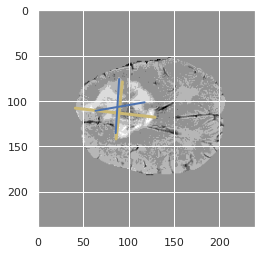

prediction [114.459305  62.719322 100.60508  114.61695  138.41135   86.02353
  73.02677   90.39403 ]


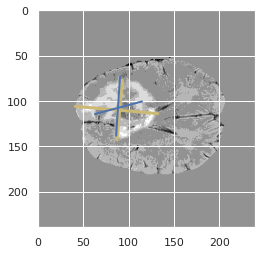

prediction [117.709145  61.56633  104.043846 114.78962  135.17685   87.47054
  78.633705  95.69431 ]


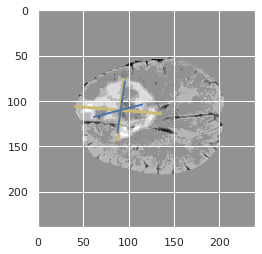

prediction [119.63408   59.244064 100.62729  116.26569  131.9938    90.374374
  80.82361   99.05113 ]


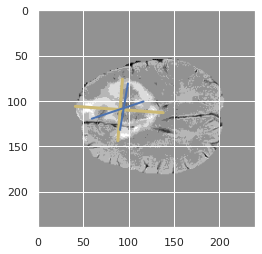

prediction [116.5409    57.477158  99.6      118.06036  128.04344   95.39041
  79.20401  102.717514]


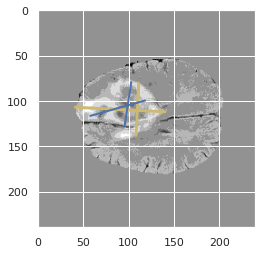

prediction [120.64022   53.791912  97.06522  119.7102   123.74192   96.9476
  87.391815 104.23625 ]


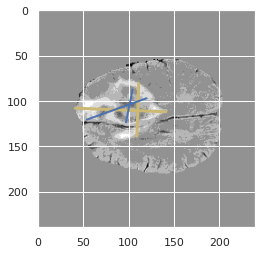

prediction [121.45192  59.70228  93.7656  118.8611  119.82315  92.55336  90.22816
 103.60109]


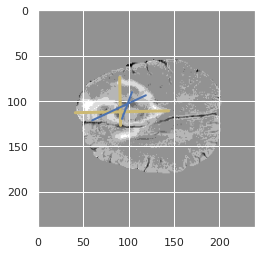

prediction [116.77179   49.02394   91.13816  120.22838  118.24526   87.31271
  92.134575  92.73905 ]


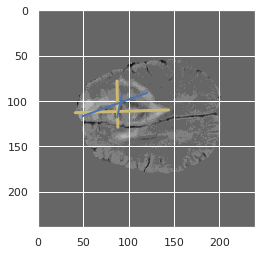

prediction [116.432274  51.612415  89.82265  122.93166  116.50915   88.373344
  93.15316   90.272575]


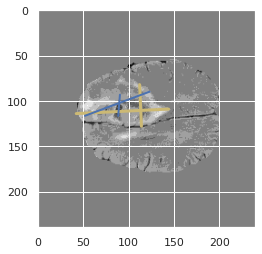

prediction [120.35596   59.30289   88.86097  123.056076 121.17769   86.14218
  91.936386  92.979614]


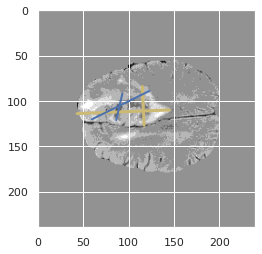

prediction [121.82591   56.701855  89.76967  119.29364  119.27951   87.51139
  95.36637   93.589264]


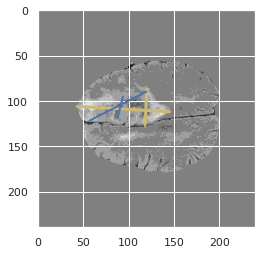

prediction [124.84782   59.282482  96.13134  120.394585 118.15017   92.002716
 103.32444   98.197845]


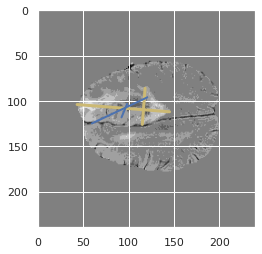

prediction [127.22003   56.84285   95.783005 120.51971  111.10394   95.996216
 106.89594   96.43276 ]


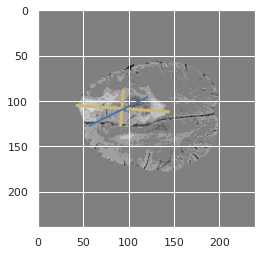

prediction [129.24254   54.824753  93.46497  122.38639  101.57353   95.572
 108.18455   98.31382 ]


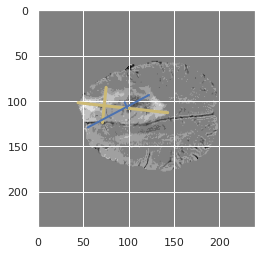

prediction [127.85491   53.574303  86.63003  116.753845  93.54632   92.402824
 108.051895  97.25711 ]


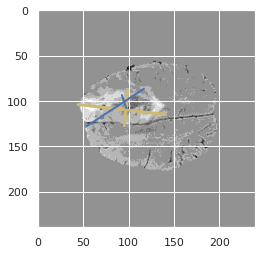

prediction [128.0154   59.95589  84.9493  121.87277  85.9039   91.60827 114.35487
 104.39816]


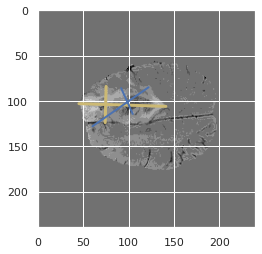

[0.44068176721237945, 0.36763106373721993, 0.3795525494276795, 0.2099476439790576, 0.15115623237450648, 0.3124324324324324, 0.12302385743029606, 0.16951650943396226, 0.08137808137808138, 0.1762942779291553, 0.12461059190031153, 0.28122245077872465, 0.5265280794291033, 0.5266477451907915, 0.40154938670109747, 0.43657718120805367]
prediction [127.76925   63.537598  87.38271  124.92841   82.42003   92.95593
 117.49415  104.30168 ]


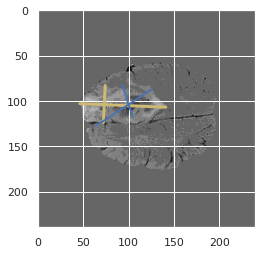

prediction [131.7398    71.50221   85.87849  124.96994   76.52762   97.833916
 122.70821  107.18142 ]


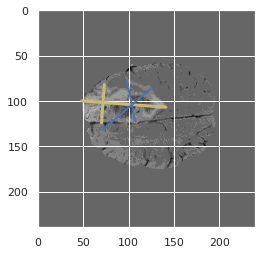

prediction [128.15851   72.77542   83.9381   123.614876  79.869644  98.04139
 116.2806   105.75227 ]


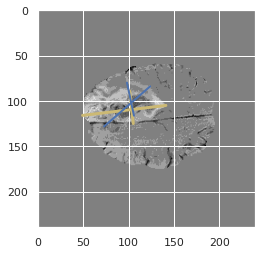

prediction [120.43204   71.77543   83.795815 121.62989   86.4308    96.05064
 105.860405  98.18242 ]


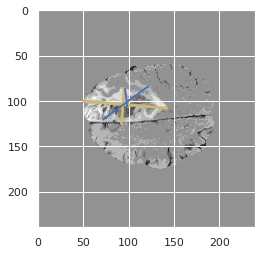

prediction [111.72413   74.30877   86.85998  122.373634  91.5178    96.625916
 100.02555  102.35388 ]


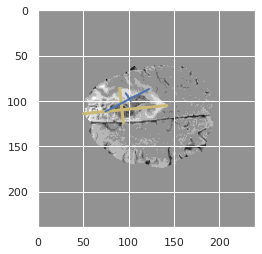

prediction [112.73665   75.52037   88.97259  122.24685   84.268936  95.81281
 106.48401  105.062775]


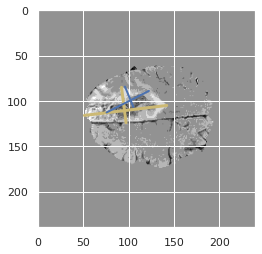

prediction [104.66281   73.81593   92.55071  123.6289    91.2433    98.114975
  98.26733  104.499016]


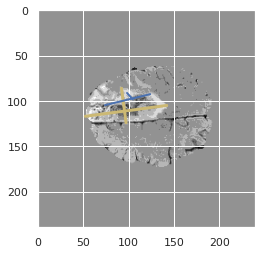

prediction [102.0467    68.37232   98.57848  126.25887   90.97921  101.83729
 100.71181  104.918785]


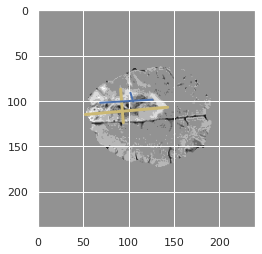

prediction [ 97.28695   74.24104   99.91918  134.25522   96.50489  111.295265
  94.79066  114.99216 ]


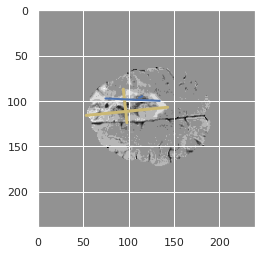

prediction [ 98.73163   73.51414  100.123375 139.50555  101.49614  114.35575
  91.90187  115.15043 ]


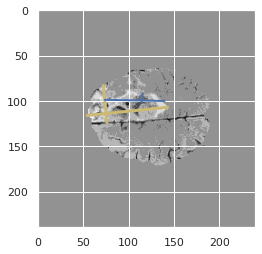

prediction [ 99.471344  76.78138  101.42034  141.22424   99.41335  118.43694
  94.35782  120.07294 ]


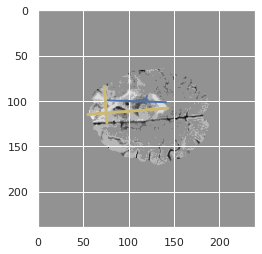

prediction [109.22325   76.87694   96.26349  138.6522    90.26653  120.921585
 105.48835  122.37112 ]


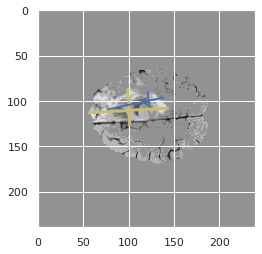

prediction [114.56521   79.50402   91.94942  136.34924   81.289566 117.93255
 114.42156  122.218956]


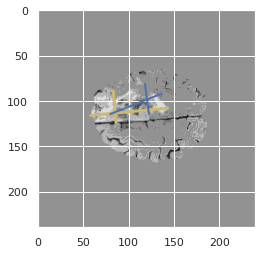

prediction [111.67145  76.68428  90.31978 130.35388  78.14757 113.95315 112.95919
 118.08076]


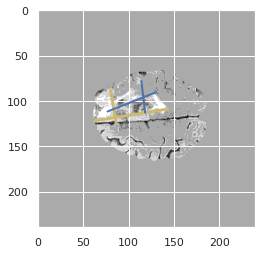

prediction [117.37855   80.62343   90.12403  130.94897   85.1032   114.46014
 114.330185 118.08311 ]


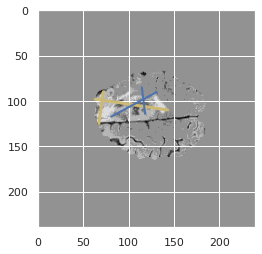

prediction [121.663284  81.27491   90.53148  126.67143   82.733894 111.7494
 121.01938  118.345985]


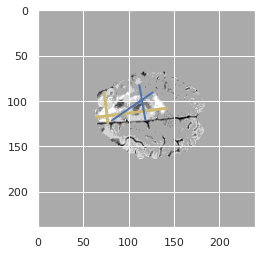

[0.3345674856950522, 0.34332129963898916, 0.2638494318181818, 0.25864502470007056, 0.20979270907791278, 0.21621621621621623, 0.2343929528916124, 0.2222222222222222, 0.22202001819836215, 0.345049504950495, 0.268630849220104, 0.15722120658135283, 0.10329985652797705, 0.14947368421052631, 0.11025641025641025, 0.13194444444444445]
prediction [118.94567   89.921394  93.86302  128.0744    88.063324 110.52427
 115.96154  116.08478 ]


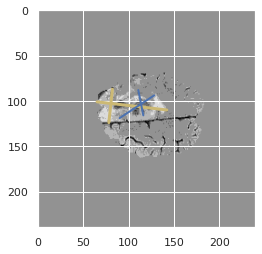

prediction [122.63929   90.30348   93.24081  124.27974   88.171364 102.43864
 118.709045 110.88743 ]


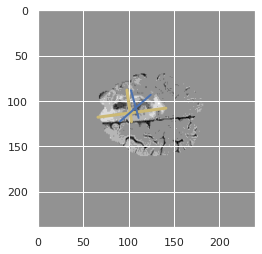

prediction [125.8988    93.90227   94.09443  120.8032    86.8631   100.6561
 123.49177  111.056694]


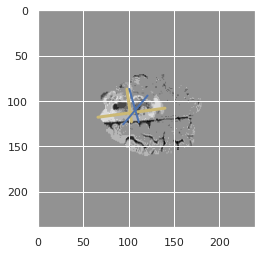

prediction [128.88127   97.37721   93.29384  119.52893   84.40169  101.29819
 127.464386 115.024994]


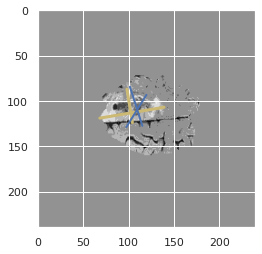

prediction [132.00333  97.85164  86.05477 114.87066  77.34201 100.37723 129.9134
 113.06982]


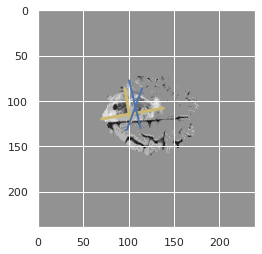

prediction [133.26607   97.84096   83.832596 113.14409   76.57563  101.944176
 129.18523  114.417465]


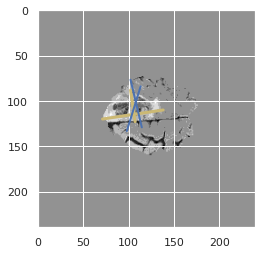

prediction [129.43634   94.57114   84.040565 109.47942   78.90316   98.936844
 123.03773  111.20892 ]


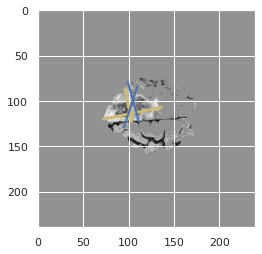

prediction [125.155876  95.86181   87.371544 109.67977   77.362625  97.61809
 122.29736  111.90254 ]


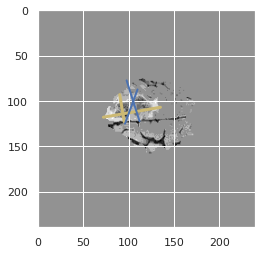

prediction [117.23245   90.89291   83.4873   110.03144   74.5946    95.80406
 113.374405 110.23446 ]


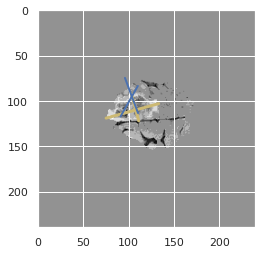

prediction [115.93846   89.54256   84.06289  115.84605   81.40691  100.400894
 111.22295  112.01385 ]


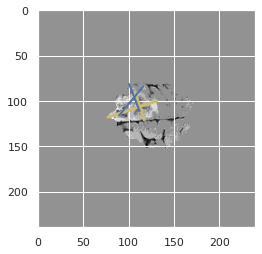

prediction [108.86082   88.29118   88.53587  121.628815  85.775314 102.839485
 101.90767  111.18139 ]


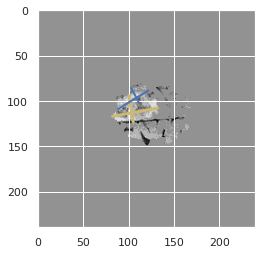

prediction [113.28302  92.60929  99.01532 127.02527  99.10205 109.03188 103.72412
 116.00012]


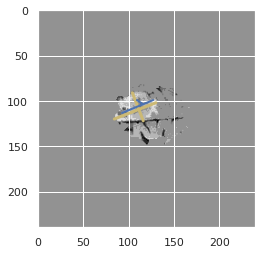

prediction [113.302246  97.59354  103.3905   128.35504  102.97547  115.932045
 104.12043  121.831436]


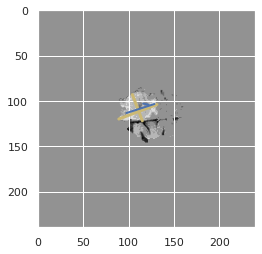

prediction [112.103065  97.92118  105.393074 129.9906   102.33425  113.984
 105.0027   118.93109 ]


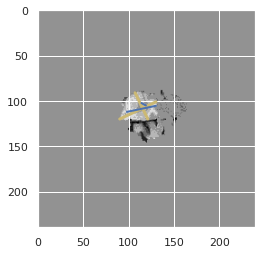

prediction [114.03536  100.66346  106.13063  131.13252  105.97051  117.963234
 108.77803  123.56647 ]


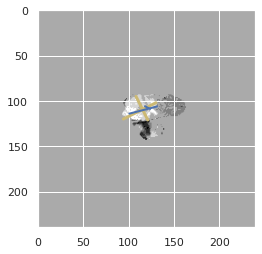

prediction [112.35628  99.57599 103.86241 129.46823 108.87587 114.82043 103.23441
 120.15791]


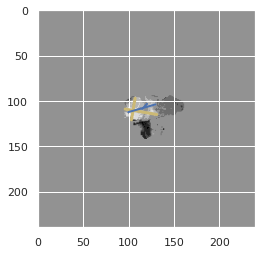

[0.18911917098445596, 0, 0.0, 0.0, 0.0, 0.0, 0.1611785095320624, 0.3533980582524272, 0.1827956989247312, 0.5511171293161814, 0.34290401968826906, 0.18172268907563024, 0.30218068535825543, 0.2328042328042328, 0.6772700983227299, 0.6252916472235185]
prediction [113.13734   92.975555 101.36003  130.60857  105.48753  111.35403
 101.54296  113.693306]


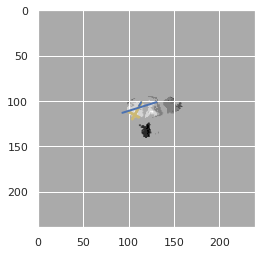

prediction [-1.0849375  -0.23257118 -2.604661   -1.3114151  -1.1336689  -1.1746509
 -2.4315796  -1.2993745 ]


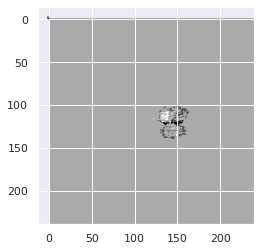

prediction [ 8.314202 10.498499  8.61516  11.113614  7.545308 10.963686 10.816774
 10.702145]


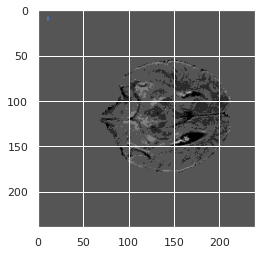

prediction [26.59476  27.845913 26.528984 33.04972  28.339363 30.967823 25.997904
 29.932348]


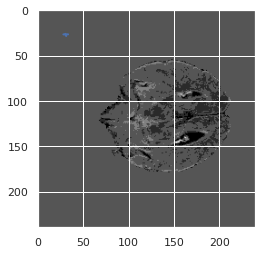

prediction [15.7789955 15.618498  11.201613  17.976646  12.578471  14.91082
 16.066704  16.666155 ]


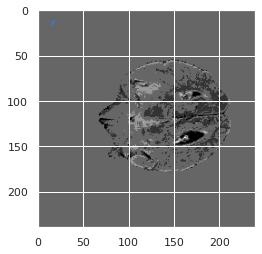

prediction [ 84.226845  96.659904  74.66862  115.151825  79.1671   105.60257
  78.70613  109.801476]


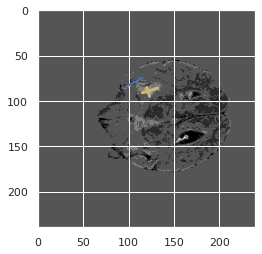

prediction [ 85.75549  97.58684  79.10263 125.02312  90.76772 110.70041  72.72842
 112.74919]


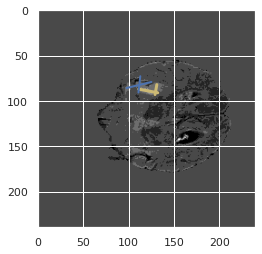

prediction [ 91.76979  102.47044   83.51315  134.57024   92.661896 114.75771
  80.07712  119.12423 ]


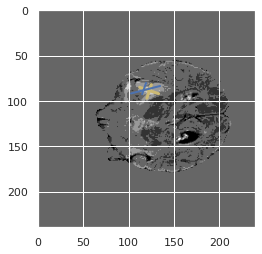

prediction [ 97.424614 102.75991   83.60022  135.92123   88.91214  114.87174
  89.62975  123.05623 ]


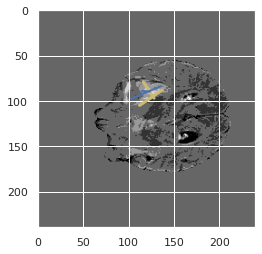

prediction [104.18179   94.05262   87.28615  141.14075   78.2177   115.12836
 106.468155 123.886635]


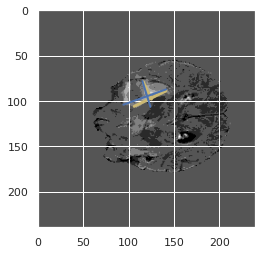

prediction [105.47162   92.68078   88.009026 137.42744   90.76949  111.199486
  97.914276 119.7569  ]


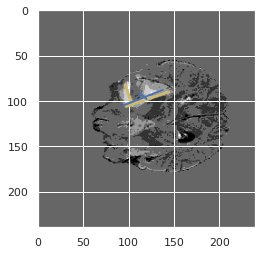

prediction [105.83031  93.62111  90.27754 138.50998  96.35375 106.65858  95.58494
 117.1522 ]


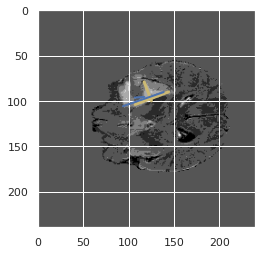

prediction [102.50613   89.24331   92.145325 142.39293   91.659164 106.724365
  93.40237  115.30559 ]


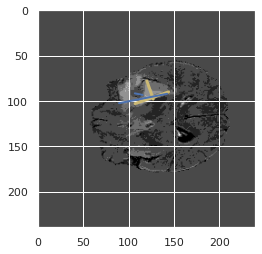

prediction [100.484795  88.11096   92.83387  140.84955   91.00253  107.186295
  92.50363  114.6916  ]


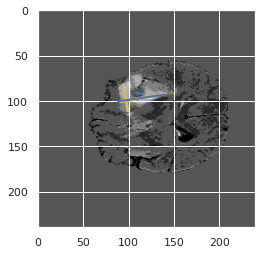

prediction [107.171234  88.57882   90.56223  138.4258    82.646095 103.95581
 102.81766  115.50615 ]


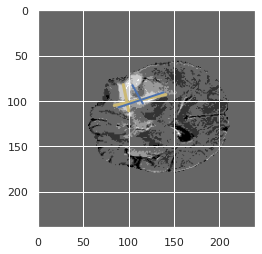

prediction [105.9337    85.103386  87.40932  138.33856   82.6389    98.24698
 104.869225 114.90783 ]


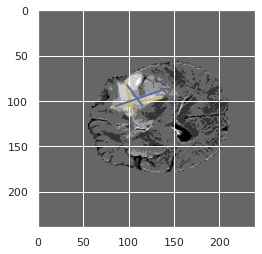

[0.5815602836879432, 0.6657608695652174, 0.6516021042563367, 0.7406429942418427, 0.6142350557244174, 0.5744324970131421, 0.5393415830025683, 0.4647246244879381, 0.3965899025686448, 0.25734505683036674, 0.3479285293540153, 0.3494740660137831, 0.23188153310104528, 0.39624282483910245, 0.42908592008231866, 0.39715500327011116]
prediction [107.03854   83.10303   84.032936 135.97392   84.54978   91.40153
 105.00208  114.47808 ]


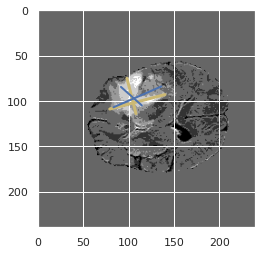

prediction [109.33055   79.94028   87.64754  138.38339   83.15988   92.661285
 113.57606  117.42875 ]


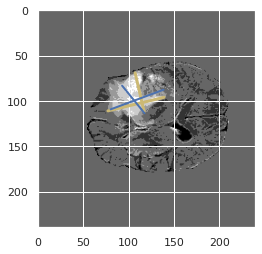

prediction [112.54447   74.48203   85.133934 143.39261   76.16938   97.07068
 122.207565 123.37131 ]


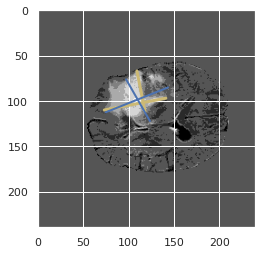

prediction [113.73314   71.71364   85.873924 141.885     75.91742   99.30296
 121.8941   126.70492 ]


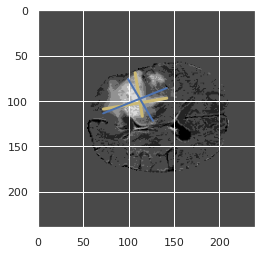

prediction [111.35559   71.93028   88.181946 141.59561   86.38068  102.76257
 115.6418   129.5816  ]


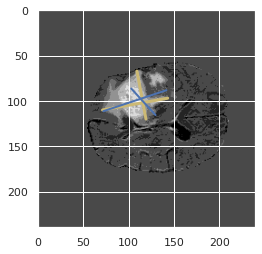

prediction [108.25381   71.55575   88.9683   143.8556    84.78163  106.10359
 114.737816 131.00432 ]


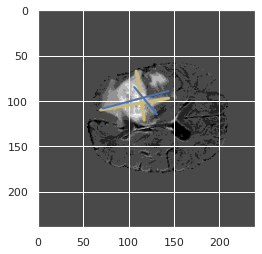

prediction [107.02109   71.02702   85.676575 142.17772   84.14559  104.81649
 111.79001  126.672714]


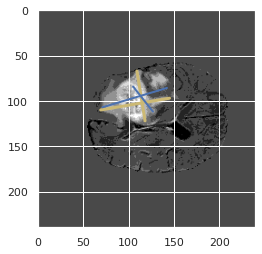

prediction [105.61512   68.63159   82.141426 140.14946   84.791046 101.583
 107.77384  121.09848 ]


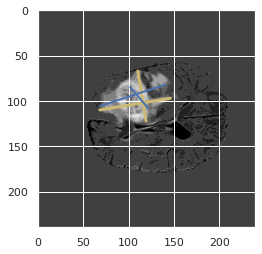

prediction [106.77726   67.837814  82.62801  143.21553   87.11003  103.428444
 106.71811  117.331375]


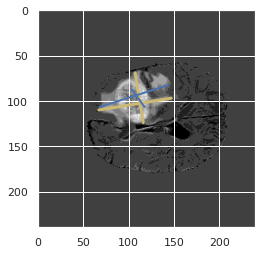

prediction [108.39417   67.34323   80.75227  145.08      89.569496 106.65518
 102.69706  113.449135]


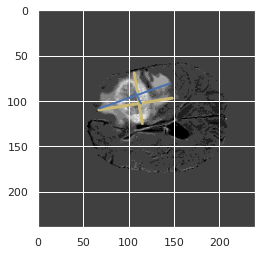

prediction [111.952675  65.86198   77.804115 146.48903   85.694954 108.20879
 106.326546 111.770996]


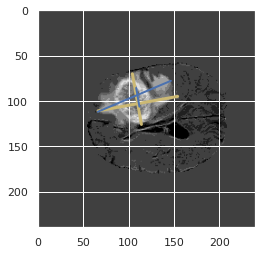

prediction [115.609665  64.00665   76.78358  148.90263   86.9875   104.9321
 107.13458  111.18885 ]


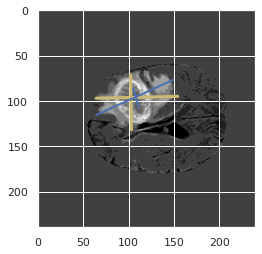

prediction [118.41829   64.116104  80.49197  150.22845   94.4277   104.28347
 107.45193  109.91885 ]


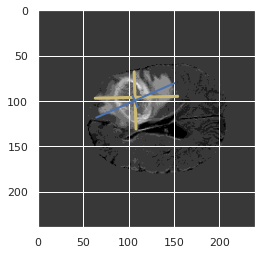

prediction [120.68662   63.42288   82.6492   152.93567   90.23849  103.409706
 114.88394  109.694595]


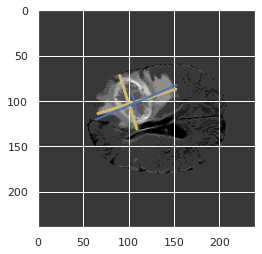

prediction [120.2969    61.78823   82.736725 154.7198    90.113    102.4202
 116.60709  108.822685]


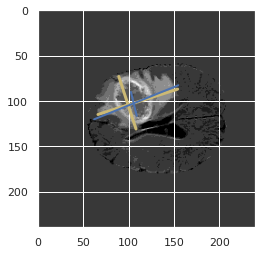

prediction [119.658455  63.011276  82.96194  155.93275   90.8609   102.634766
 115.96931  109.15707 ]


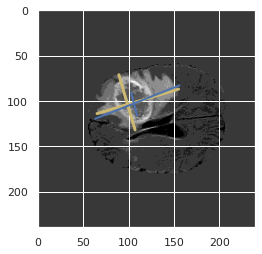

[0.3975782038345106, 0.34440883791533144, 0.3615575807787904, 0.2939510081653058, 0.300033411293017, 0.48323823109843084, 0.4716636197440585, 0.6155268022181146, 0.750733137829912, 0.6963119477525932, 0.596045197740113, 0.4810396250532595, 0.20918262301832408, 0.15426695842450766, 0.07529722589167767, 0.09724729241877256]
prediction [119.3672    62.335987  82.957596 157.81387   90.14364  102.54636
 115.04615  107.169754]


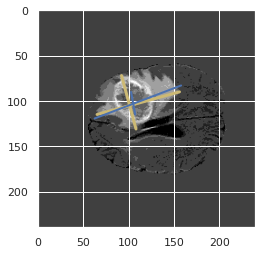

prediction [118.54479   63.26044   83.52933  157.61436   92.223785 100.07469
 112.606895 106.89684 ]


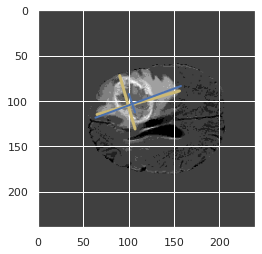

prediction [119.29042   61.37709   82.668846 157.97888   91.655525 100.28848
 113.64254  106.87123 ]


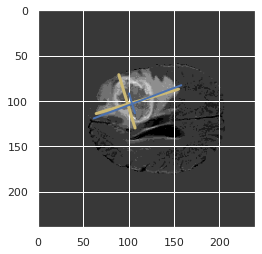

prediction [118.72844   60.195644  80.944084 157.95074   92.99133  100.66343
 110.64566  106.24805 ]


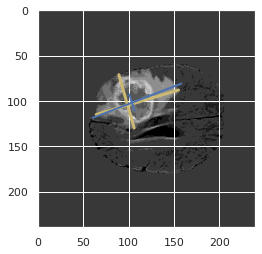

prediction [120.07771   59.99906   79.58075  157.00592   93.081024  99.52434
 110.82166  105.83067 ]


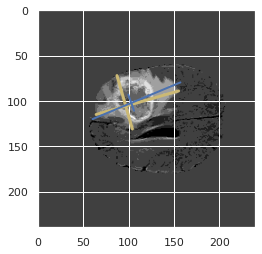

prediction [120.607544  59.566654  80.98073  156.08936   88.48747  100.47556
 115.84037  109.14327 ]


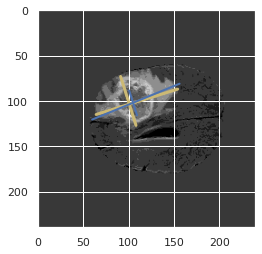

prediction [118.09748   59.572857  78.883606 155.76321   86.78401  103.26995
 113.054344 110.24287 ]


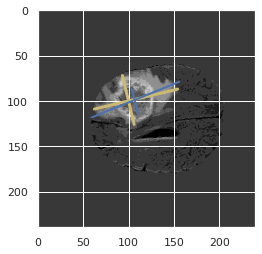

prediction [118.24946   59.687683  77.06164  154.61179   81.74653  104.29981
 117.34084  111.171   ]


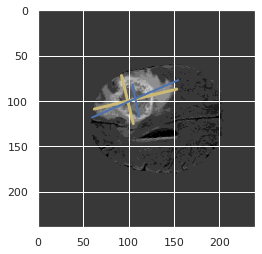

prediction [116.50655   59.232727  77.62487  152.39874   76.694214 102.1459
 120.48335  113.09101 ]


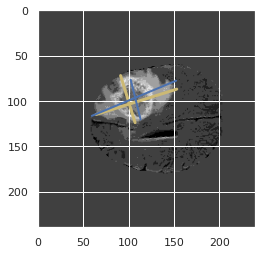

prediction [113.6111    59.588078  77.55356  148.19518   78.37841   99.873
 116.85583  111.15211 ]


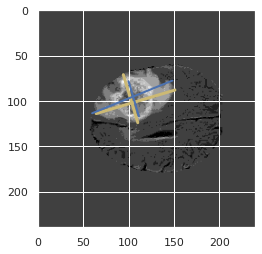

prediction [111.60762   60.649097  78.83865  144.60918   80.70256  100.521935
 112.48688  111.62527 ]


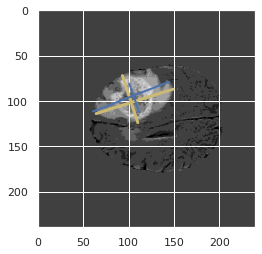

prediction [111.95947   64.65309   80.110535 143.29936   87.398415  98.26071
 110.648834 111.91308 ]


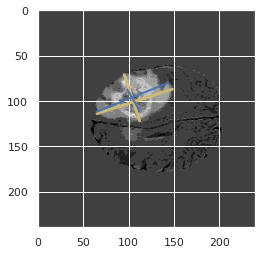

prediction [110.89661  68.92066  80.6238  141.73712  96.45775  95.7728  105.27216
 108.30364]


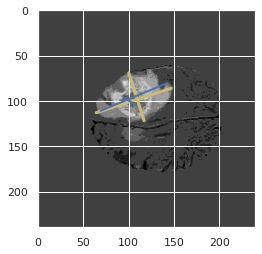

prediction [109.88884   70.512596  81.08874  140.80534   98.55419   97.63188
 103.72255  109.493645]


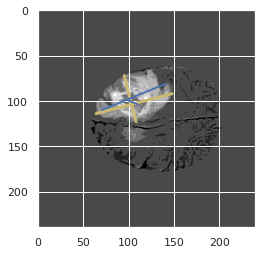

prediction [110.73245   72.51299   81.020706 135.64163  103.975266  94.917854
  99.53973  107.43503 ]


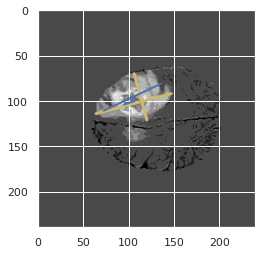

prediction [110.61263  70.55344  87.79538 134.17316 107.99532  94.03608  96.32857
 106.54291]


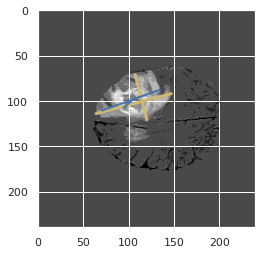

[0.06095017381228274, 0.16799065420560746, 0.2864532816036211, 0.44064602960969046, 0.39224263633712453, 0.1382089552238806, 0.6567460317460317, 0.7141289437585734, 0.5946729957805907, 0.6036106750392465, 0.6095959595959596, 0.7261831591886908, 0.5878265703168427, 0.2438172825138202, 0.5369955156950673, 0.45871559633027525]
prediction [113.17497   73.48967   95.32277  131.0508   109.69472   98.070564
 100.17509  113.308075]


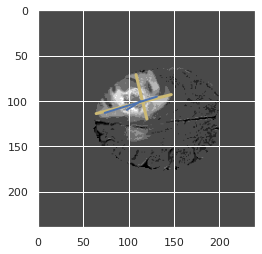

prediction [118.07898   73.91392   97.95317  134.47293  117.33771  100.515465
  99.57699  114.94016 ]


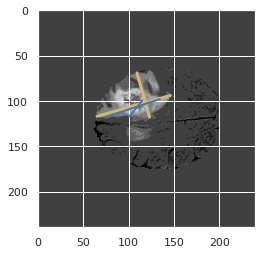

prediction [118.59164   70.35025   96.37819  137.61871  115.86905  100.70316
  97.080315 113.4093  ]


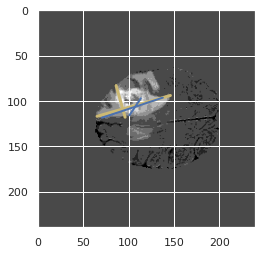

prediction [115.278275  72.77221  103.1614   139.05222  124.45423  102.52768
  92.17244  115.15187 ]


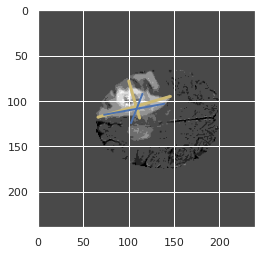

prediction [116.564064  70.39906  103.061554 142.83858  118.27983  105.05468
  95.49924  115.54196 ]


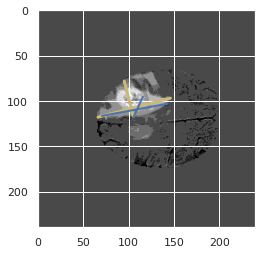

prediction [117.788765  70.769005  99.03415  143.97041  101.36329  110.09426
 105.09766  120.01074 ]


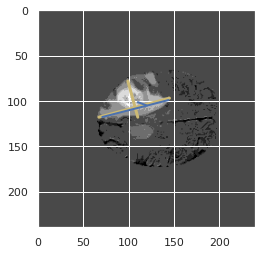

prediction [119.714745  71.59387   93.92268  141.0732    85.3333   108.56389
 116.964294 122.63353 ]


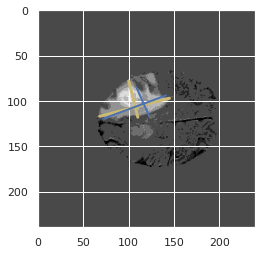

prediction [122.283615  73.23539   92.964645 141.19783   79.10192  107.46628
 119.7317   120.881676]


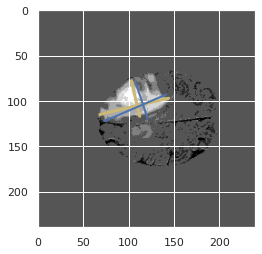

prediction [127.44016   74.24703   87.51214  136.92635   74.63961  105.53267
 118.145164 117.72866 ]


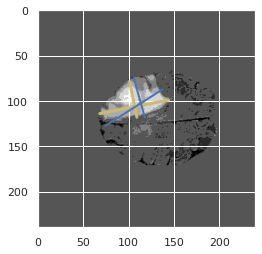

prediction [126.65215   72.88668   89.695015 137.36145   72.50505  106.67912
 119.294975 117.64181 ]


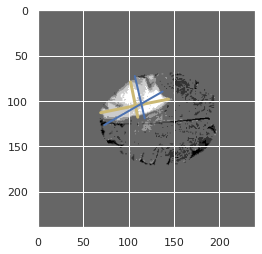

prediction [126.07449   74.27853   92.181305 140.62027   72.09539  109.2622
 123.07308  120.530106]


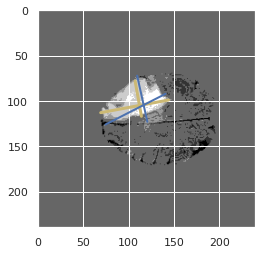

prediction [122.1689    77.837654  95.2659   140.38457   76.488106 110.40361
 117.54677  121.46452 ]


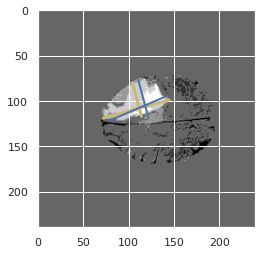

prediction [119.8243    79.0803    95.56783  139.28577   77.72129  111.63472
 111.822105 119.34264 ]


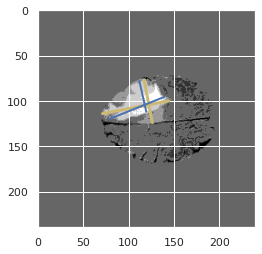

prediction [117.38163  82.81938 102.17451 138.5782   94.51885 116.12991 100.53566
 119.3557 ]


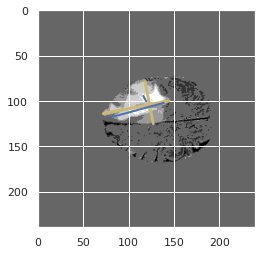

prediction [113.95138   82.44026  106.270676 137.23729   92.52244  112.70881
 102.137825 115.00243 ]


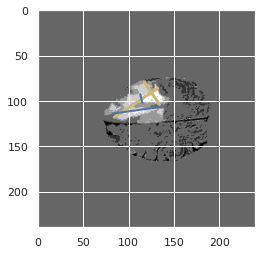

prediction [110.362114  83.46056  109.24747  136.6169    98.99697  112.62281
  97.20044  114.303795]


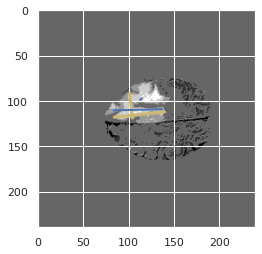

[0.0012763241863433313, 0.018617021276595744, 0.14766201804757997, 0.32550335570469796, 0.011764705882352941, 0.14647887323943662, 0.3605263157894737, 0.128, 0.21616871704745166, 0.14046121593291405, 0.17657992565055763, 0.11060606060606061, 0.0, 0.008113590263691683, 0.014, 0.0]
prediction [109.890785  86.19724  105.759544 137.12474  103.177795 110.5795
  96.403786 111.5713  ]


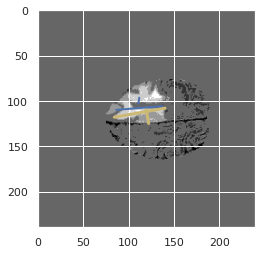

prediction [109.051     88.58936  106.57739  137.00421  103.402534 112.10261
  96.4482   111.705444]


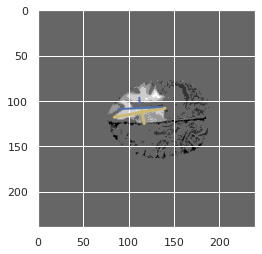

prediction [106.92074   91.92791  103.49842  133.44121   94.909164 111.18892
 101.59721  110.88917 ]


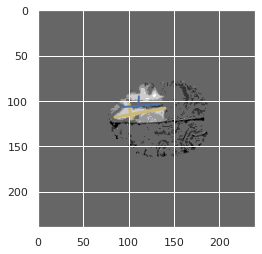

prediction [111.11595   97.81095  108.7816   139.14249  101.51746  113.00698
 104.29245  113.075874]


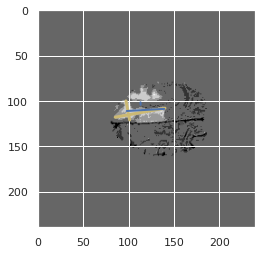

prediction [113.22838   97.61403  108.22341  136.27673  104.55945  114.417946
 103.08601  116.866875]


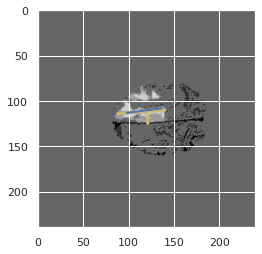

prediction [112.52323   92.76833  113.19923  132.46677  110.56688  106.24567
 102.000175 116.98165 ]


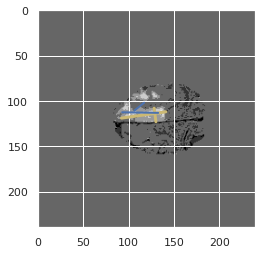

prediction [116.93831   98.52442  110.53125  138.8985   113.78793  116.86429
 105.41166  120.292534]


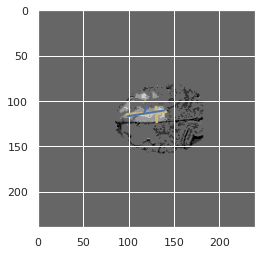

prediction [119.20847 102.06101 108.13214 139.52573 112.04819 121.08365 107.03933
 121.7167 ]


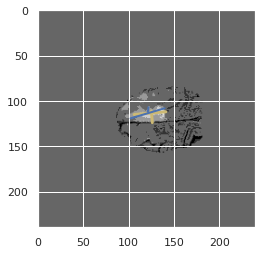

prediction [121.37608  101.071075 106.19126  137.37564  112.02064  118.11349
 107.54434  119.28655 ]


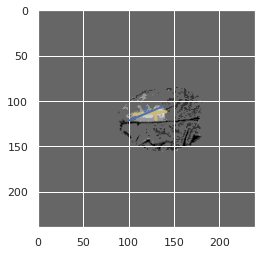

prediction [123.26246  101.68488  105.360725 136.8293   109.68953  117.93183
 110.75184  120.78011 ]


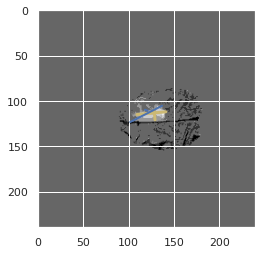

prediction [122.07064  103.510345 104.243866 136.63121  107.72414  118.08844
 109.81945  120.71648 ]


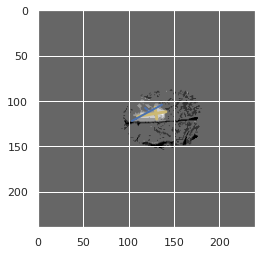

prediction [121.43433  101.08611  102.348694 132.56859  106.0091   116.84073
 108.41704  117.12024 ]


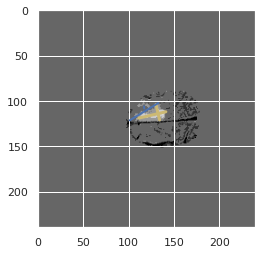

prediction [119.738106  96.304855 100.141365 130.25252  104.07094  113.6295
 107.08084  112.48392 ]


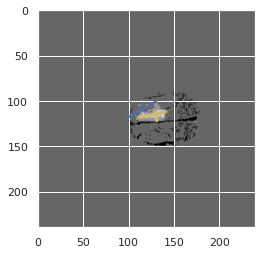

prediction [116.61954  105.03892  104.62287  135.78409  110.830734 118.178154
 106.17736  117.084   ]


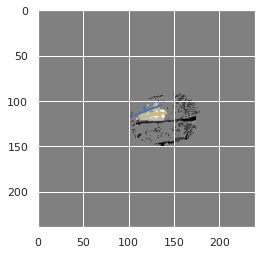

prediction [112.79813 102.98382 105.12237 126.48748 112.29703 111.31302 103.27456
 110.07737]


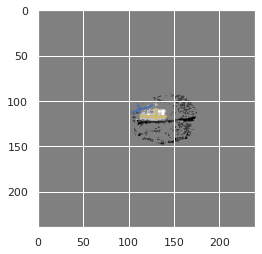

prediction [87.78749  88.86448  80.165215 96.56071  82.08411  86.13043  82.46201
 91.96139 ]


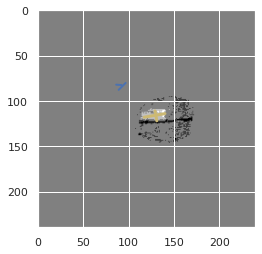

[0.0, 0, 0, 0.0, 0, 0, 0.0, 0.5251641137855579, 0.49198717948717946, 0.3102652825836217, 0.2553418803418803, 0.5393939393939394, 0.4498106060606061, 0.25084745762711863, 0.17864271457085829, 0.3413919413919414]
prediction [44.59831  46.538357 37.522064 48.63405  41.171173 46.3019   40.616154
 47.73637 ]


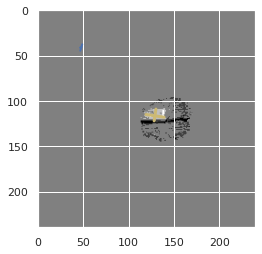

prediction [-1.2280608 -1.3748364 -2.9913473 -2.065839  -1.1812055 -1.6516352
 -3.212689  -2.6623864]


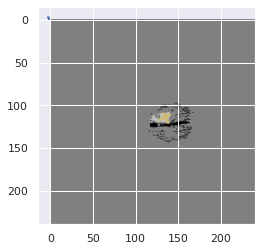

prediction [-1.8529966 -1.6228896 -3.4306278 -2.7590663 -2.0368576 -2.4940577
 -3.0569656 -2.5884886]


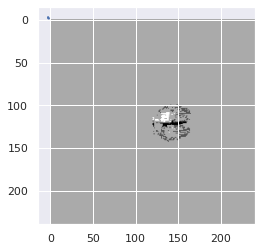

prediction [3.4893253  7.136778   2.0207138  2.405381   0.52062184 6.398113
 5.1484065  6.3023214 ]


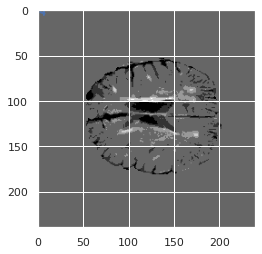

prediction [ 1.4136891   1.61157    -1.1816747  -0.13077854  0.88212997  1.331113
 -0.34575233  1.1430918 ]


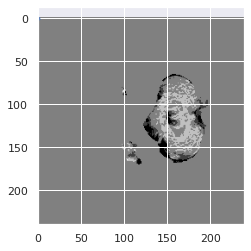

prediction [ 1.9418046  -0.45962036 -0.96452343 -1.0864362   0.05750534  0.04987939
  1.3718199  -0.03284561]


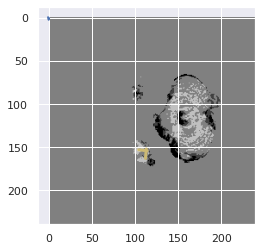

prediction [138.91335  102.312454 137.968    101.21256  147.53656   99.483604
 133.73923  109.79827 ]


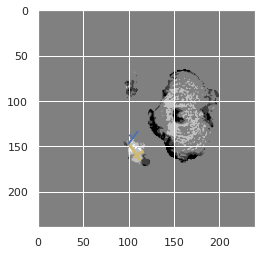

prediction [161.85555 109.41733 145.62552 105.08082 165.82956 105.77756 147.21045
 117.20675]


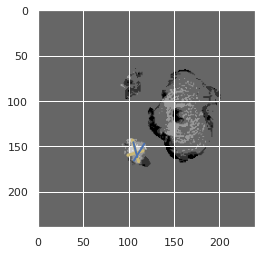

prediction [162.06647 107.78672 147.6395  103.612   167.47978 102.18932 149.70753
 117.98573]


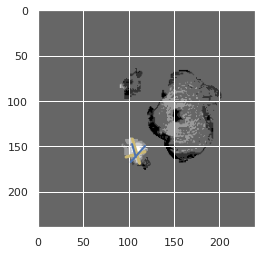

prediction [154.83897  100.42708  133.21986   97.57375  157.49443   96.25869
 138.33719  110.001144]


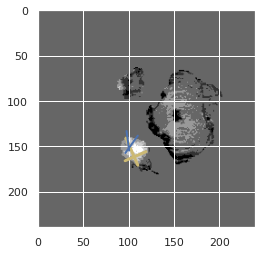

prediction [152.2567    99.78748  138.19875  102.275444 158.13322   95.229866
 139.24782  113.336174]


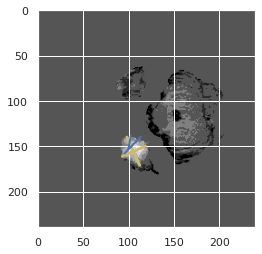

prediction [159.10645 104.98602 135.33954 101.46627 157.51369  92.70746 147.47728
 119.88952]


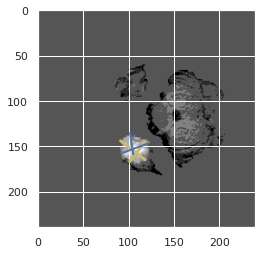

prediction [160.74008  103.848206 141.71748  110.55144  164.77194   91.60583
 150.61734  125.091446]


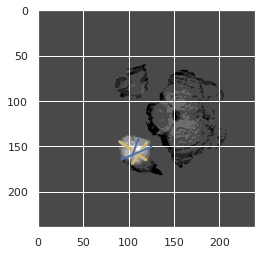

prediction [156.26115   95.19614  141.35278  111.83488  164.86717   89.669235
 142.82294  119.971634]


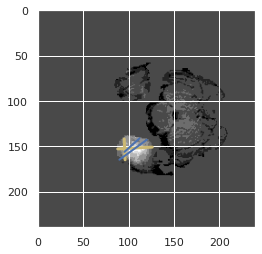

prediction [154.45706   94.51721  143.41031  113.93848  160.44397   95.096344
 144.72527  122.09935 ]


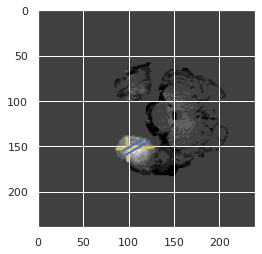

prediction [149.01617   89.25363  154.80028  122.144066 162.49304   96.97222
 147.02997  121.7324  ]


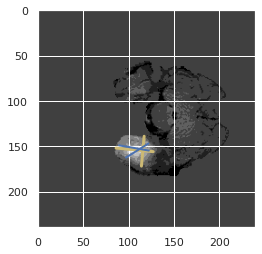

[0.7068062827225131, 0.62046783625731, 0.7191873589164786, 0.7776055792328554, 0.5231235784685367, 0.6294076163610719, 0.7403718459495352, 0.6801204819277108, 0.6085017835909632, 0.6075842696629213, 0.5946462715105163, 0.739956568946797, 0.667704280155642, 0.7734215885947047, 0.8327603143418467, 0.6190994126604307]
prediction [148.98007  85.05371 164.28795 126.18065 171.4497   96.72132 142.70207
 121.40928]


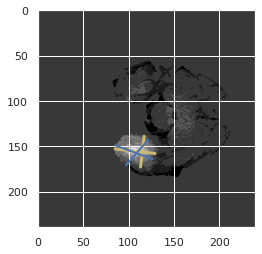

prediction [152.29228   85.05429  161.8635   130.90831  177.19533  103.38416
 136.39932  121.344124]


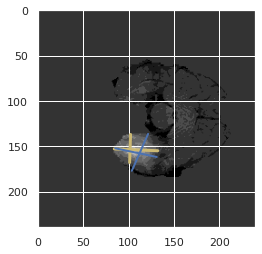

prediction [153.03035   84.05075  160.28984  134.95303  177.36176  107.128624
 135.64433  122.7586  ]


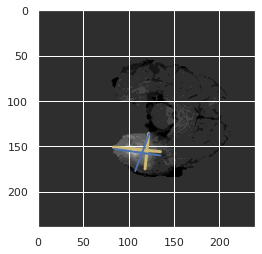

prediction [152.28738   80.942894 158.06602  139.9276   173.32683  110.40528
 137.15779  118.04218 ]


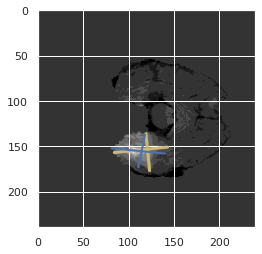

prediction [153.07747   84.70701  155.94658  140.3923   168.04483  110.51209
 142.60222  121.677376]


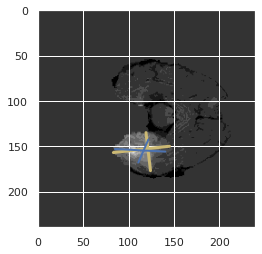

prediction [154.91353  84.59583 157.7768  143.10056 172.94089 116.98529 142.36127
 124.36364]


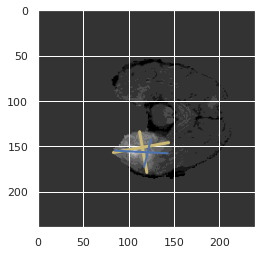

prediction [156.80803   81.81949  160.77551  147.10455  178.74872  121.746895
 142.39369  125.52505 ]


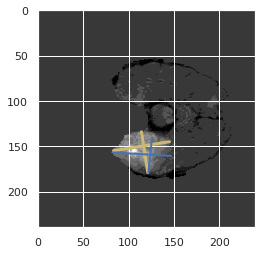

prediction [161.15208   82.55842  160.52081  149.01442  180.39291  122.880516
 143.05562  124.53032 ]


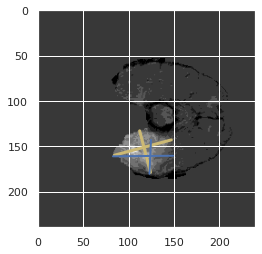

prediction [164.87      82.162155 159.42009  149.7823   178.34575  125.62038
 145.95064  123.00406 ]


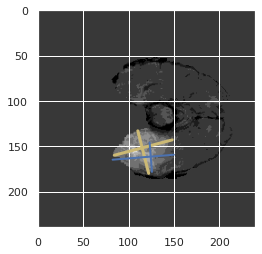

prediction [165.60222   80.25228  159.06328  149.98389  178.84737  125.20573
 145.86565  121.784615]


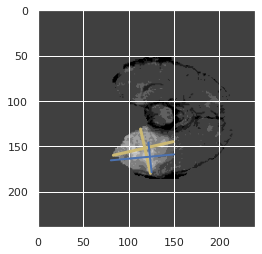

prediction [160.22972  80.15596 155.80244 148.78528 175.15994 124.29503 141.61876
 122.31014]


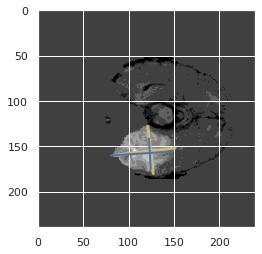

prediction [159.40512   82.373276 155.73466  150.0093   179.8701   122.757034
 138.44565  122.7966  ]


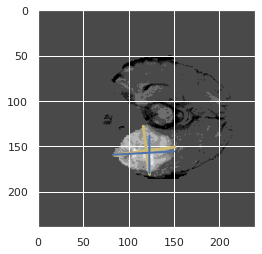

prediction [156.21034  82.74148 156.62392 148.87749 178.50146 119.98879 138.31137
 124.08025]


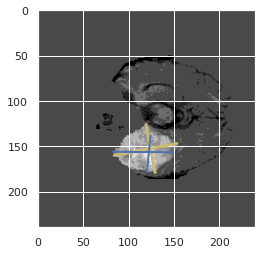

prediction [152.42456   80.68962  155.73625  150.20396  180.66861  116.543884
 134.0051   122.415764]


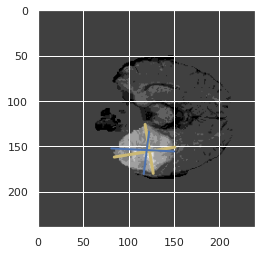

prediction [150.92093   81.922264 154.21841  151.27092  180.49104  118.13137
 130.30733  122.65298 ]


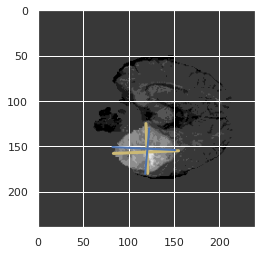

prediction [137.6184   84.34429 155.51624 150.64034 172.04196 114.92116 131.50252
 126.69029]


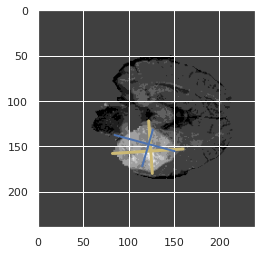

[0.6289691170073946, 0.5405040504050405, 0.5850355749368832, 0.49499650919245985, 0.5204359673024523, 0.5213539300318037, 0.584070796460177, 0.4702430846605197, 0.47975408098367606, 0.6462715105162524, 0.7596673596673597, 0.7328009828009828, 0.6941580756013745, 0.5135775862068965, 0.5776991886831704, 0.5382151029748283]
prediction [134.40262  82.96765 156.78293 151.93288 171.67068 111.59557 132.07439
 124.87605]


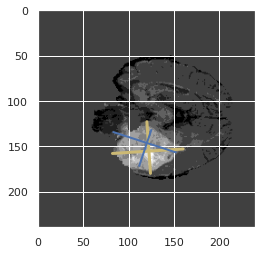

prediction [137.72774   83.645676 155.42345  149.89256  168.45674  109.357
 135.24321  125.73898 ]


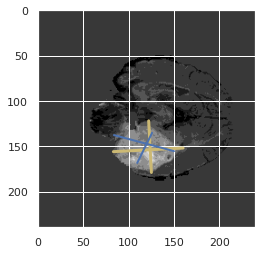

prediction [133.58475  84.62435 155.92674 153.36076 168.20166 109.19522 135.01964
 125.45844]


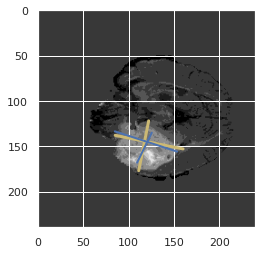

prediction [135.67175   85.984856 155.79814  154.03947  166.41415  110.69146
 139.29492  126.392166]


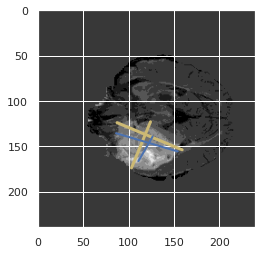

prediction [139.85692   83.5586   154.03871  153.97276  166.72345  108.459435
 136.39883  124.08363 ]


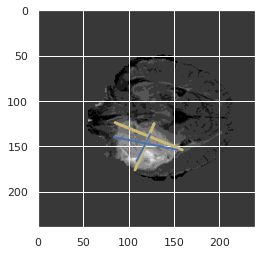

prediction [137.5356   84.32637 153.03203 153.91626 166.20245 108.98505 135.96774
 127.39917]


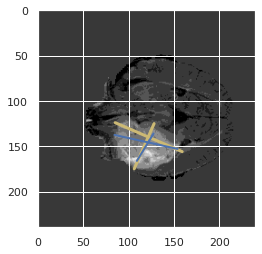

prediction [141.93471  82.28004 150.77136 156.06358 169.37563 105.79149 132.60124
 122.70831]


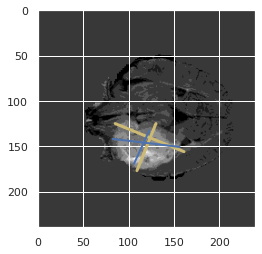

prediction [144.7836   81.49537 147.15564 157.58647 166.00806 105.57198 134.84154
 123.07824]


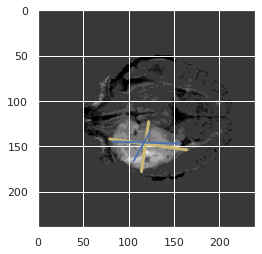

prediction [142.03423   80.780136 145.91553  158.62653  163.41835  103.830124
 133.63452  119.27941 ]


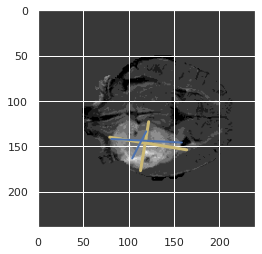

prediction [142.17818  77.82678 145.57076 160.07324 166.93724 100.19847 127.36181
 113.2473 ]


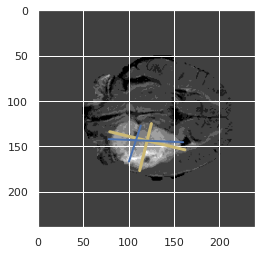

prediction [140.08595  77.07666 143.9437  161.11313 170.75652  99.93184 122.10267
 111.37043]


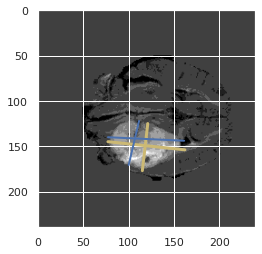

prediction [137.56609   77.00633  143.75764  157.1672   170.71004   96.409065
 117.57374  108.35273 ]


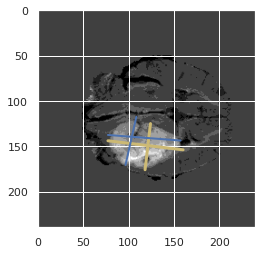

prediction [141.27759   78.092354 142.81909  154.28331  168.49974   95.58768
 120.54417  107.96102 ]


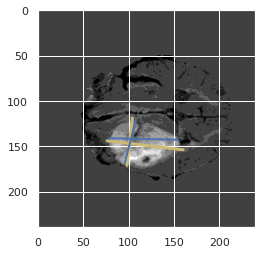

prediction [146.64137   80.19303  138.21756  149.73595  167.29758   95.074554
 122.569885 106.79107 ]


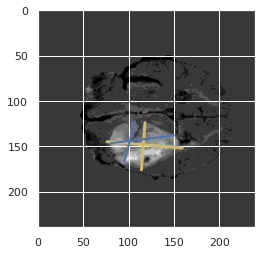

prediction [145.374     79.442024 138.79991  149.2406   171.1972   100.44894
 117.232864 107.76617 ]


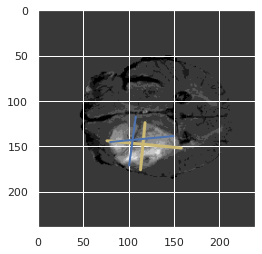

prediction [147.97032   79.18505  136.3483   145.75055  169.28595  102.579475
 121.57548  110.98341 ]


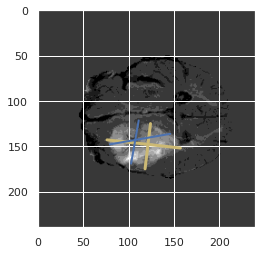

[0.5736064792758456, 0.6339031339031339, 0.6303232426885582, 0.552327221438646, 0.224616292798111, 0.14001862775535548, 0.17418944691671964, 0.10415200562983815, 0.1300399564111878, 0.047344586249485385, 0.0739817123857024, 0.0955, 0.06694560669456066, 0.020122484689413824, 0.03640256959314775, 0.0]
prediction [149.36952  77.7211  136.08229 146.63364 169.72305 101.35098 124.10839
 108.60977]


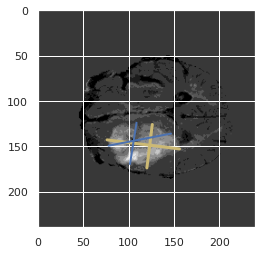

prediction [148.28159   80.56813  137.66145  151.04335  175.34048  102.354904
 124.01759  109.15925 ]


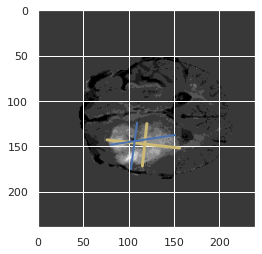

prediction [147.16603   80.4502   137.8674   149.94989  171.62851   99.62962
 127.034706 108.377335]


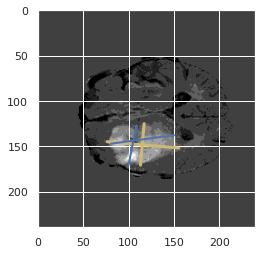

prediction [145.95256  82.15398 139.61713 149.14311 167.02333  98.61354 132.49278
 111.35958]


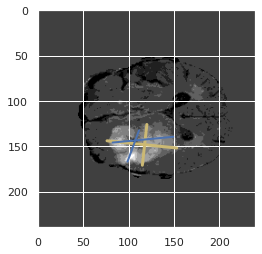

prediction [145.83083   82.85305  140.84991  150.33986  154.79268  103.11295
 146.52513  113.716156]


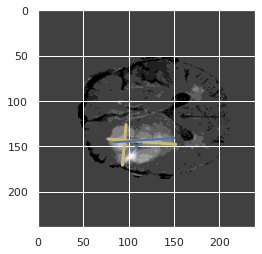

prediction [142.00018   95.2712   138.95233  149.86476  148.97855  107.955986
 143.50148  122.067924]


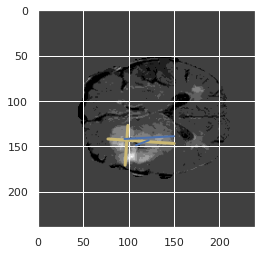

prediction [142.68465  89.86145 130.31389 139.32585 150.04497 103.29818 135.94032
 111.15287]


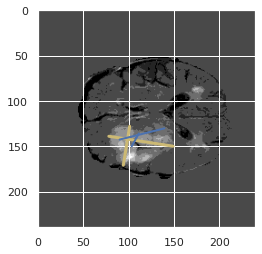

prediction [143.04967  98.88435 130.865   134.53226 145.58295 109.19942 134.50851
 114.86332]


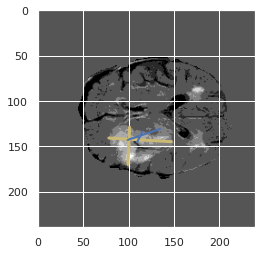

prediction [142.56282  103.89008  150.0393   137.32605  149.92973  119.253494
 140.58557  126.757225]


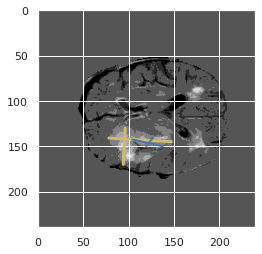

prediction [156.17361 115.27021 150.07608 142.47195 156.05762 124.47202 147.94138
 136.69211]


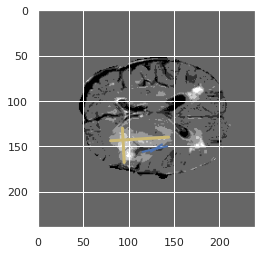

prediction [158.27704 113.25543 147.38657 145.54016 153.90845 123.51588 145.88261
 134.97922]


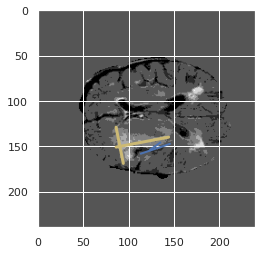

prediction [153.96451 118.30129 142.77322 148.36305 150.39478 120.46411 141.82558
 131.9931 ]


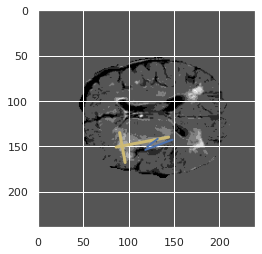

prediction [158.75793 135.11534 146.4308  150.25397 149.87701 133.07932 147.53812
 143.39062]


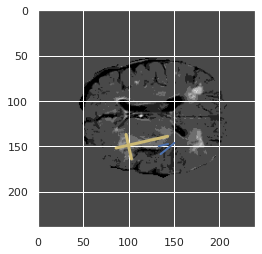

prediction [159.87422  126.236046 144.74423  150.64818  148.51265  133.91919
 148.62465  141.10637 ]


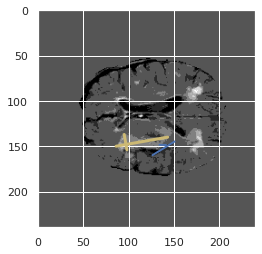

prediction [158.15358 134.65442 144.43787 151.34637 155.56686 137.00342 139.10257
 142.77408]


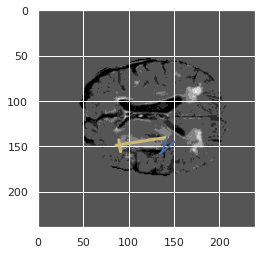

prediction [135.26859  126.67852  119.347374 136.46642  126.65959  128.33151
 123.75375  131.31683 ]


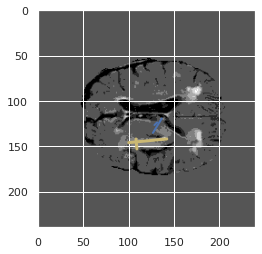

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0, 0, 0.0, 0.08704061895551257, 0.042440318302387266, 0.1432258064516129, 0.07789232531500573, 0.115]
prediction [119.92812 122.1577  103.77413 128.47742 115.84643 122.36018 107.43837
 122.17568]


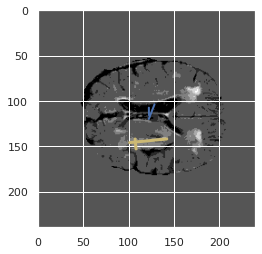

prediction [110.86331  117.635025  94.495285 126.55738  103.64998  120.14587
 100.98943  121.11197 ]


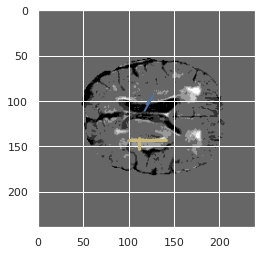

prediction [114.66546  119.64136   96.91968  129.53203  105.8924   123.59096
 106.8568   126.667595]


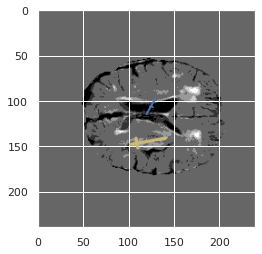

prediction [100.69367 115.7449   85.50632 121.69101  99.05746 114.26135  91.95609
 118.11552]


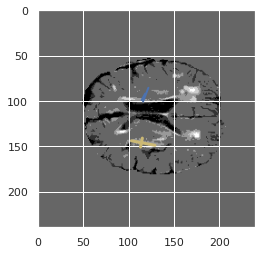

prediction [ 70.56383  115.12238   62.15046  111.57331   68.1454   108.24459
  64.373634 111.73434 ]


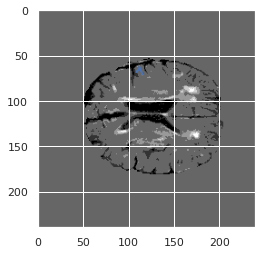

prediction [44.84118  73.983055 39.023518 73.15059  42.244698 71.139336 41.794502
 72.50172 ]


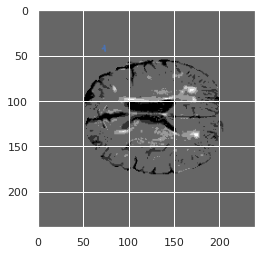

prediction [ 53.159157  99.961296  45.731956 100.38241   51.24164   97.53449
  51.074467  99.35105 ]


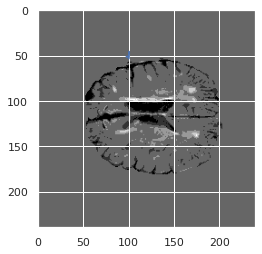

prediction [6.6369243 8.641863  3.2496545 6.768497  5.0284667 9.633837  4.7716317
 9.014553 ]


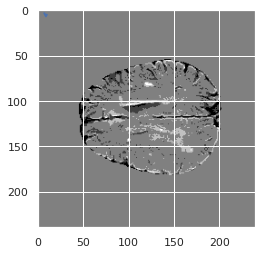

prediction [-1.2147235   0.15244237 -1.5808306  -1.6147788  -0.22823462  0.65747225
 -2.8295178   0.89842546]


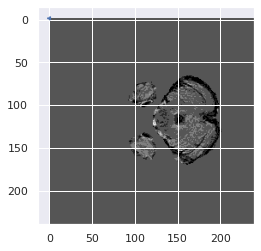

prediction [-0.6219288   1.0458723  -1.5765384  -1.6212732  -0.73654026  0.577268
 -1.862137    0.64767027]


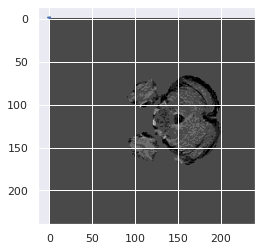

prediction [58.237705 53.13171  60.47463  60.229603 61.726048 62.81147  53.244915
 55.4067  ]


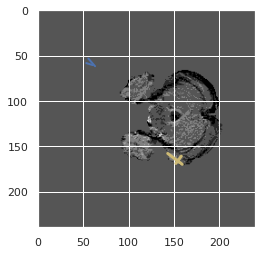

prediction [164.63234 132.18692 162.09517 149.25858 173.20619 147.5214  158.79552
 146.59741]


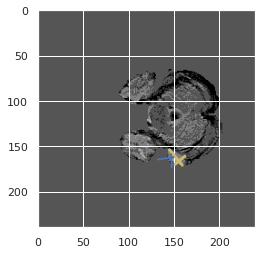

prediction [170.17314 134.5275  162.42166 149.3026  169.78032 145.41144 165.13034
 147.3561 ]


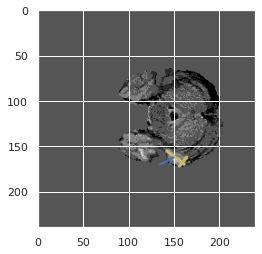

prediction [176.65558 133.60063 161.62535 150.16054 167.72195 146.96568 171.97955
 152.4075 ]


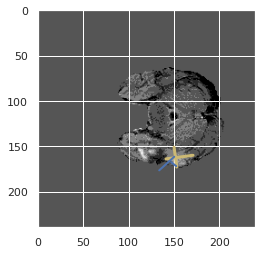

prediction [171.37112  125.438644 160.01555  148.34143  168.43861  141.12894
 166.49278  150.5459  ]


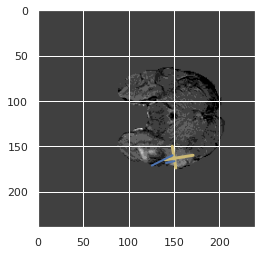

prediction [164.90942 120.58482 156.13483 151.95605 166.52083 138.99304 159.67804
 147.83595]


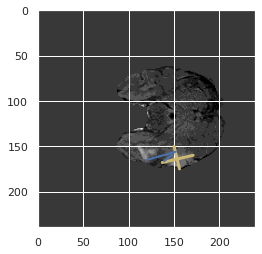

[0.1556390977443609, 0.36124298662063015, 0.5158488927485888, 0.6610505450941526, 0.784424778761062, 0.7546712802768166, 0.7251621713895527, 0.8035889070146819, 0.7620253164556962, 0.8122342165521753, 0.7886537330981775, 0.7097210939615489, 0.7097363612633777, 0.620607787274454, 0.7075802535743189, 0.7415730337078652]
prediction [162.51964 114.7807  155.37094 154.63103 166.58147 135.97223 156.74146
 142.27362]


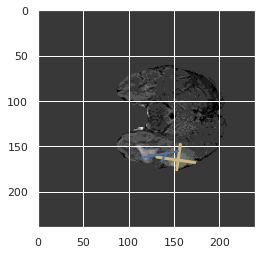

prediction [164.81364 110.71681 160.17076 166.88698 175.8282  141.2632  157.04236
 143.65573]


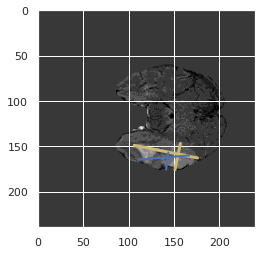

prediction [163.13185 106.64246 158.6863  171.51727 176.49031 145.1445  155.04124
 143.58482]


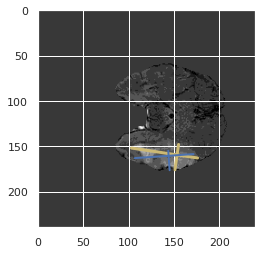

prediction [159.07166 100.53861 161.5476  170.8823  183.14253 141.1389  147.61885
 136.95442]


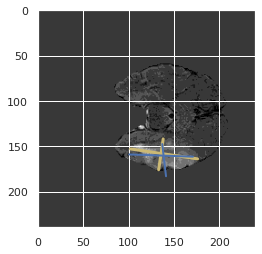

prediction [156.09271  98.5952  160.68478 171.08566 177.36455 136.2744  144.59134
 132.53896]


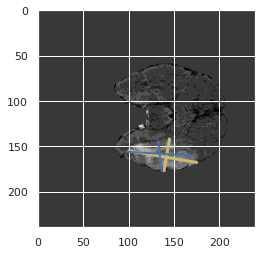

prediction [158.92496  99.10208 162.22101 172.00473 179.25996 139.67693 146.28058
 135.54692]


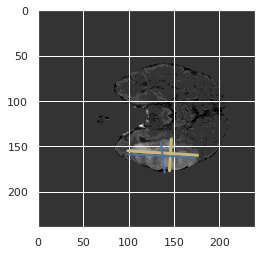

prediction [160.1761   99.04258 162.57704 173.3328  179.53453 142.00626 147.49182
 138.38922]


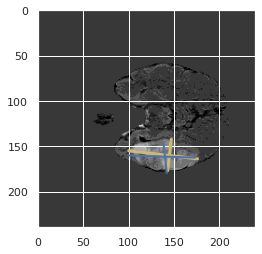

prediction [159.84138  99.66957 161.48262 174.27988 181.63672 142.01085 143.66183
 136.58206]


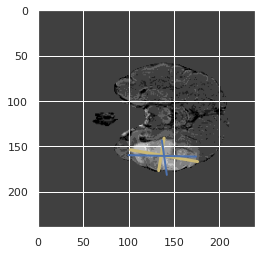

prediction [159.18398  99.13905 162.26768 173.14467 181.83122 139.42728 142.60735
 133.42242]


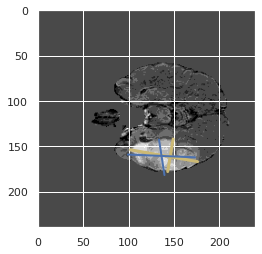

prediction [156.5525  100.37544 162.52486 171.58537 180.89925 137.85243 140.28513
 132.77623]


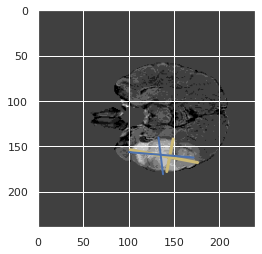

prediction [153.88907 100.00796 163.06055 171.44615 181.64249 137.3128  136.95815
 132.92067]


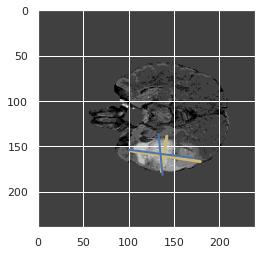

prediction [152.89723   99.664185 165.51039  174.4038   186.18115  140.02367
 134.26797  133.52567 ]


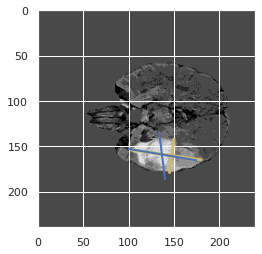

prediction [150.50279  99.44921 165.71194 174.22975 183.38666 137.81404 136.43987
 133.804  ]


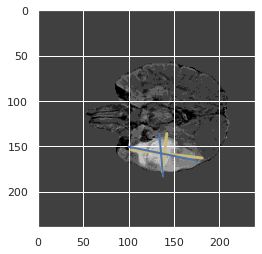

prediction [156.27766 100.74942 172.29692 177.58122 190.43259 140.22713 140.87263
 134.42612]


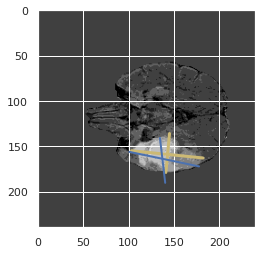

prediction [150.34694 101.78908 164.51862 174.94458 180.00679 138.82881 139.89395
 136.45627]


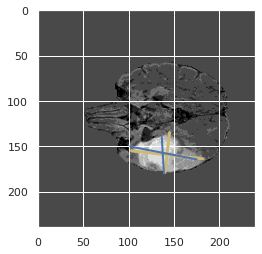

prediction [152.11041   99.886696 164.33762  177.46019  185.86569  140.1039
 133.4693   132.40004 ]


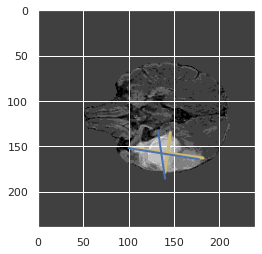

[0.7607785168760779, 0.8183213920163767, 0.828405357594137, 0.8109800144473874, 0.7821979114868225, 0.6275477365372237, 0.664504971897968, 0.631916777335104, 0.5972805933250928, 0.8041397153945666, 0.6868541216053833, 0.7279666897987509, 0.7140480152127406, 0.8008733624454148, 0.7860978520286396, 0.7849243306169965]
prediction [150.39778  99.45584 164.16641 178.91907 183.95937 141.50604 133.93114
 132.80786]


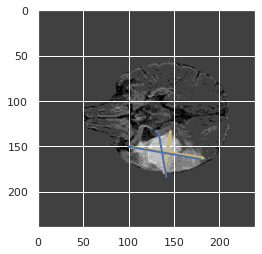

prediction [149.89177  104.464294 162.28433  181.10378  182.02042  143.39806
 134.91615  138.63086 ]


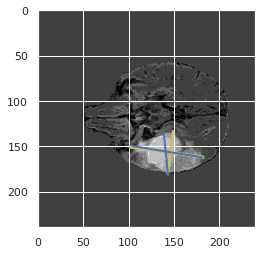

prediction [144.79385 106.05776 162.54955 180.11377 183.33202 144.58737 132.51456
 144.69699]


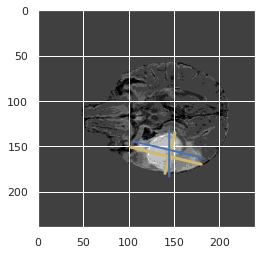

prediction [141.94742 107.72734 163.98236 179.38263 186.23956 140.9631  131.93376
 147.31345]


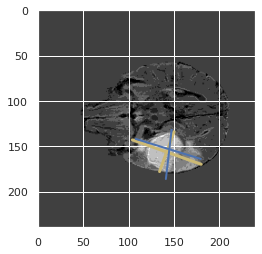

prediction [145.03244 111.4066  164.65799 180.80711 187.00478 145.83223 132.63557
 150.21037]


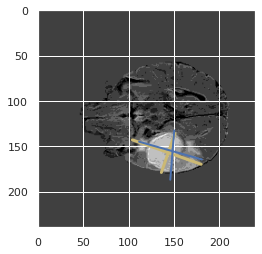

prediction [144.949   111.72218 164.95189 181.08469 189.54645 146.55933 130.33658
 151.87912]


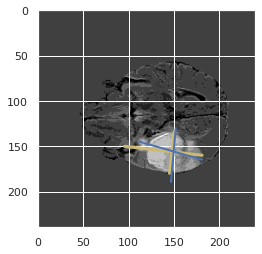

prediction [145.45573 109.65969 164.01932 182.62976 185.25412 144.10025 135.16597
 152.01518]


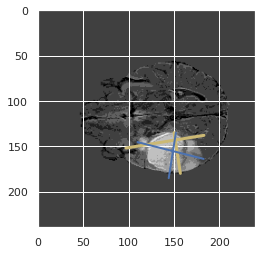

prediction [143.14104 111.07135 162.72458 179.88965 182.95555 142.29889 137.65472
 153.52948]


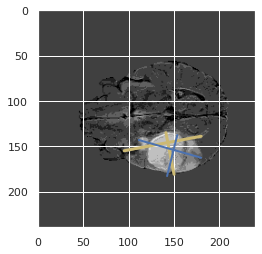

prediction [142.64078  112.977715 162.9696   178.871    178.79292  141.56717
 142.62622  155.7124  ]


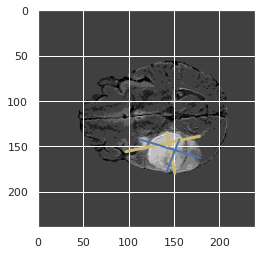

prediction [140.18008 110.89753 162.87743 179.95784 181.28209 143.7664  140.86328
 159.55988]


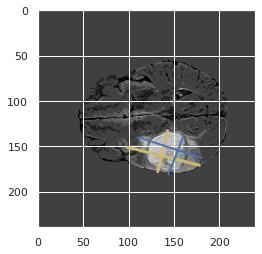

prediction [134.85327 110.48328 162.09465 176.28555 180.79526 139.83145 137.40881
 158.88556]


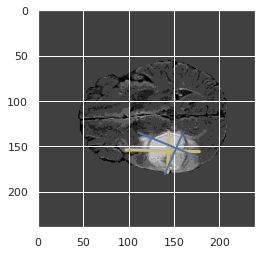

prediction [134.7825   111.629005 166.68373  177.3918   185.48915  141.7433
 137.13426  163.33432 ]


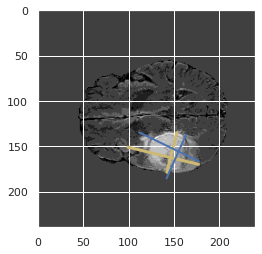

prediction [134.71591  112.581505 167.89175  175.62856  182.28098  141.25099
 137.17752  163.37015 ]


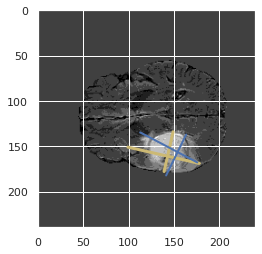

prediction [137.14952 112.88527 166.6475  175.65604 176.70496 139.94302 140.97997
 160.23608]


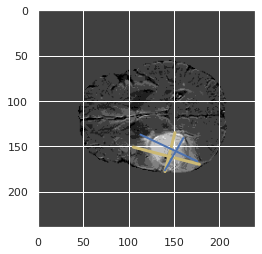

prediction [136.86485 114.0382  166.43741 173.65935 176.86902 141.35101 140.73239
 162.21027]


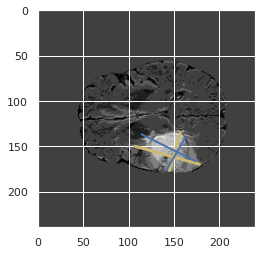

prediction [137.96309  113.693085 167.79189  173.36957  180.41948  144.6747
 139.21652  163.34302 ]


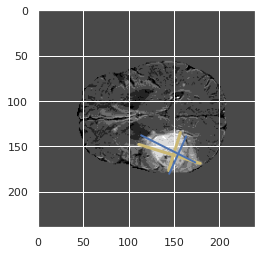

[0.7495554238292828, 0.6851132686084143, 0.6689564932940791, 0.6431778929188255, 0.6284440842787682, 0.40588760035682425, 0.36245954692556637, 0.28803051979017646, 0.18656330749354005, 0.12993703491700057, 0.11693290734824281, 0.05853314527503526, 0.045146726862302484, 0.19548872180451127, 0.0, 0.0]
prediction [142.43822 117.00027 167.87134 174.55267 182.34497 147.36287 140.67154
 163.56012]


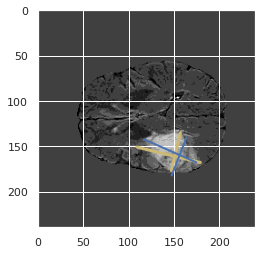

prediction [143.46362  117.225136 165.60086  170.61398  176.5629   145.7621
 142.95741  160.88712 ]


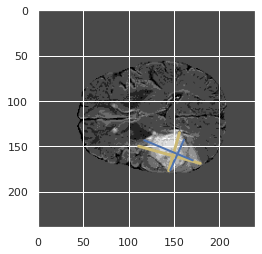

prediction [145.56529 119.36867 166.12646 170.94249 177.90521 147.73619 143.09537
 161.90991]


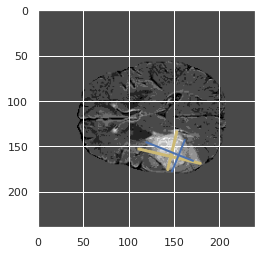

prediction [146.17323 119.31603 161.3491  168.36623 176.60764 145.37733 142.33565
 158.95949]


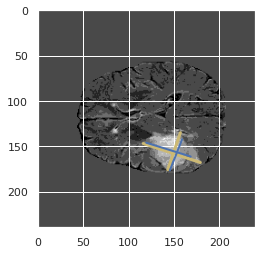

prediction [145.86055 124.54742 159.13005 167.9562  175.9293  147.30046 143.7083
 162.64844]


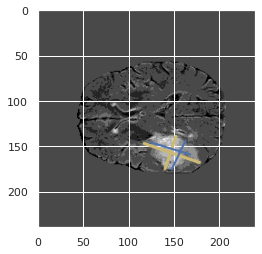

prediction [151.10431 131.561   157.06699 167.353   174.61916 148.91196 147.10393
 166.65   ]


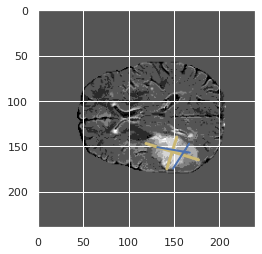

prediction [149.35437 134.13197 153.90938 165.61044 173.64087 146.23692 142.63469
 165.7676 ]


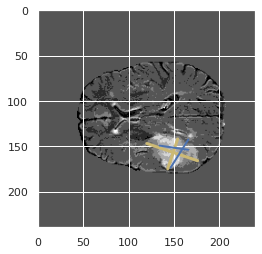

prediction [146.49382 135.00803 147.94684 162.79018 168.74205 143.89656 138.51982
 162.48885]


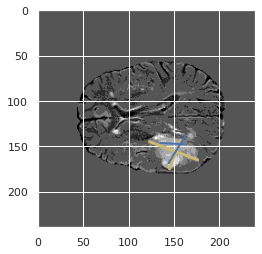

prediction [152.93542 137.30177 143.37997 159.8086  166.4761  142.46646 141.1133
 162.316  ]


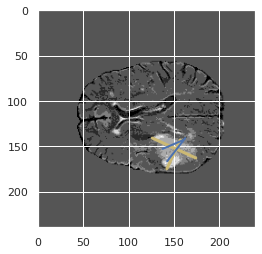

prediction [156.54337 139.85565 142.67928 156.8283  167.34021 140.59    140.46538
 161.63408]


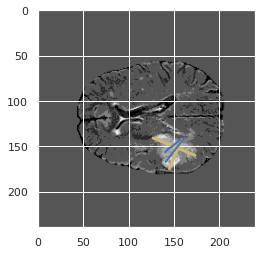

prediction [155.38187 138.91284 141.22575 152.68674 165.98204 138.67949 136.9358
 159.11292]


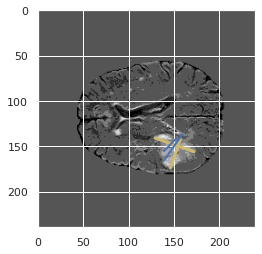

prediction [156.28975 138.85397 139.6396  150.81577 160.24693 136.92854 137.79631
 156.9906 ]


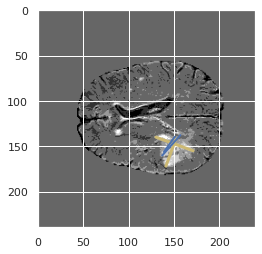

prediction [151.46317 136.52327 136.51904 146.14932 149.95084 136.92747 138.19518
 148.18877]


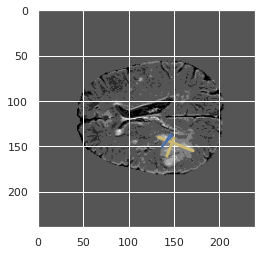

prediction [141.30418 130.67757 132.00491 162.90588 143.52765 153.74611 139.9834
 151.92299]


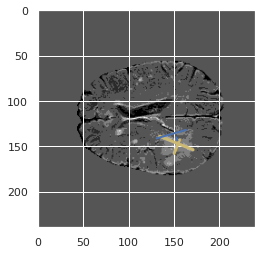

prediction [128.03835 144.83614 124.74249 166.91924 134.81772 162.02007 123.71195
 157.57176]


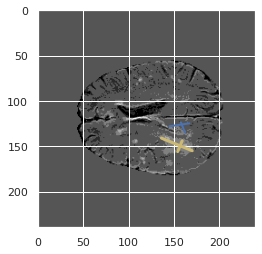

prediction [66.72823 85.82128 64.2626  96.74571 66.98849 93.45394 64.5818  89.45641]


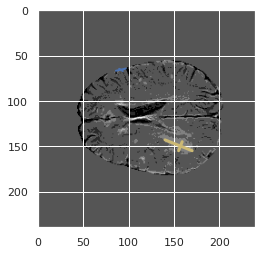

[0.0, 0.0, 0.0, 0.0, 0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.06839186691312385, 0.1083398285268901, 0.389873417721519, 0.4186851211072664, 0.2472761724301279]
prediction [16.718319 22.716171 13.250142 22.349012 17.03349  24.203524 16.194008
 22.685959]


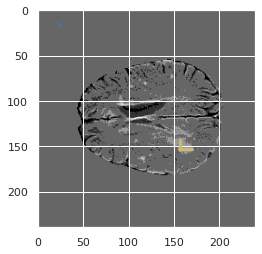

prediction [14.392896 20.034554 11.927227 20.3779   14.575337 22.285065 14.438823
 20.497044]


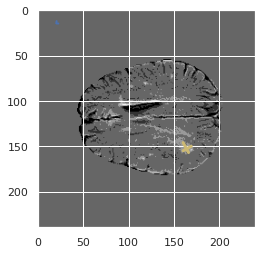

prediction [18.924883 23.763134 16.19409  23.933199 19.52054  25.384073 18.001032
 24.107061]


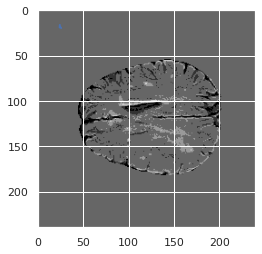

prediction [132.3737  149.66557 131.39658 159.23691 133.82272 156.83537 128.83669
 160.25858]


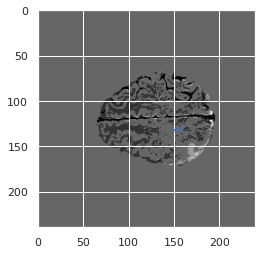

prediction [-1.04487     0.20144215  0.15216798 -1.0999615  -1.5977038   1.552232
 -2.0819983  -0.05038802]


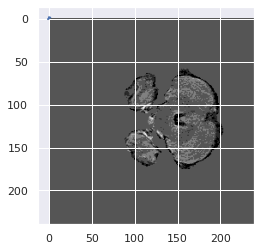

prediction [ 0.8103263   1.2370098   0.6142819  -0.59651434  0.30260244  1.8662025
 -1.1915815   0.944954  ]


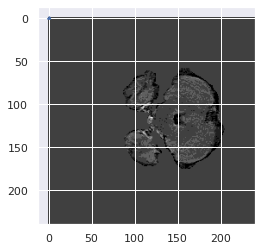

prediction [63.64259  78.469666 61.429245 81.00833  58.369934 78.725204 66.59688
 81.25435 ]


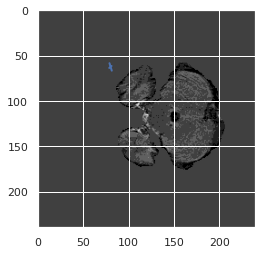

prediction [57.6563   66.46755  52.333378 65.968735 54.136753 64.05336  58.257328
 65.26145 ]


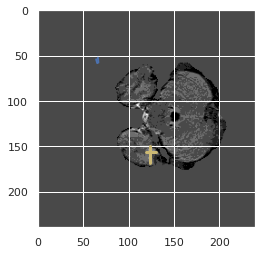

prediction [143.97086  110.48686  144.93787  123.97814  149.04211  110.64669
 144.09845  122.225075]


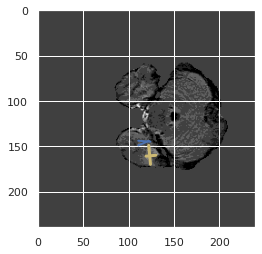

prediction [135.97984  110.52842  136.9949   120.832565 139.16989  108.938805
 134.55333  119.05545 ]


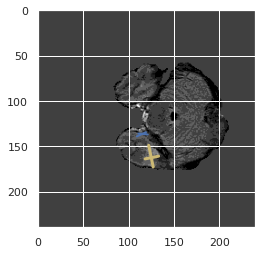

prediction [141.58524  110.90821  129.9713   119.641556 136.11528  116.465965
 135.59358  119.459656]


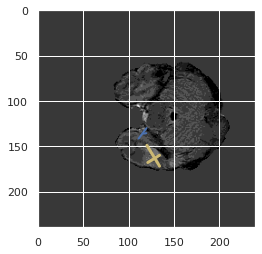

prediction [160.26273 123.31759 137.14763 147.69565 146.01349 134.18317 152.41536
 137.85844]


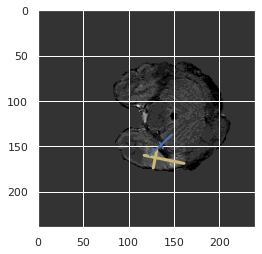

prediction [158.32698  120.472946 141.19162  152.01653  147.34625  133.15671
 153.16919  140.09688 ]


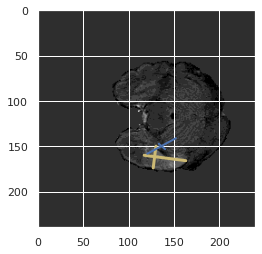

prediction [171.76701 132.65445 149.34703 158.6044  146.54765 142.76996 175.07544
 152.514  ]


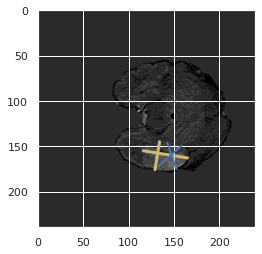

prediction [173.39185 132.64981 150.25656 158.78914 145.30095 144.81485 177.95328
 156.21283]


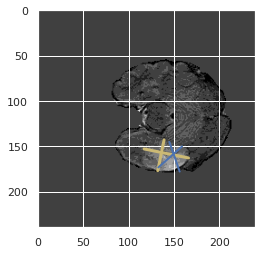

prediction [176.0452  133.4246  155.26773 174.18379 158.78636 157.83496 174.45786
 163.98093]


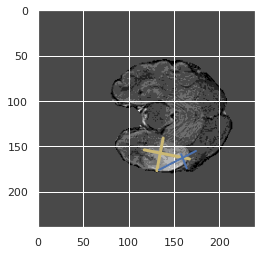

[0.2284136546184739, 0.2880382775119617, 0.2717034256217738, 0.15350877192982457, 0.2530647985989492, 0.1342376052385407, 0.26555609995100443, 0.2308085977482088, 0.0641925777331996, 0.2170675830469645, 0.31200897867564537, 0.20246593121349774, 0.11373390557939914, 0.33161157024793386, 0.36065573770491804, 0.19908466819221968]
prediction [172.16757 126.99601 149.99635 174.97375 156.84367 156.04022 167.36742
 157.80397]


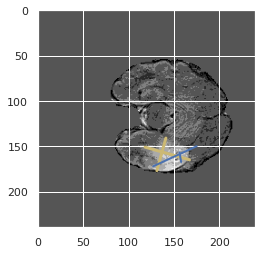

prediction [169.75754 122.23277 149.22585 171.94193 154.07803 151.84314 166.85213
 151.76518]


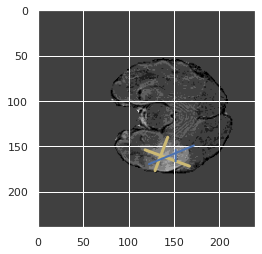

prediction [169.0162   121.690735 148.26059  168.70021  153.13551  148.1296
 165.37558  149.2397  ]


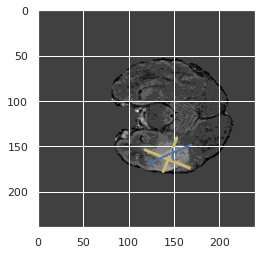

prediction [172.19582  123.130325 150.76123  166.62726  158.50034  144.74164
 164.56883  149.24051 ]


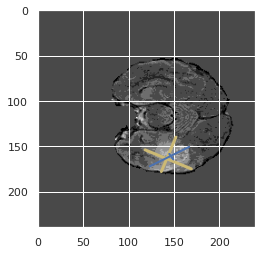

prediction [169.32317 121.43908 152.347   170.14142 156.33125 147.20297 166.57904
 152.55788]


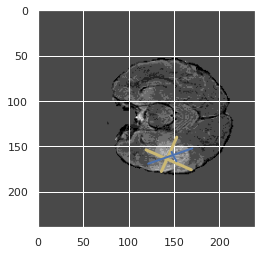

prediction [170.39226 119.78026 157.70055 171.97278 166.53783 147.7329  160.339
 150.31342]


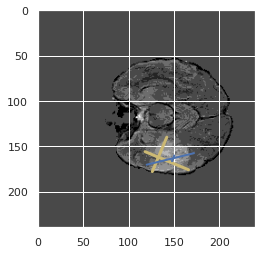

prediction [170.92368 123.72436 160.76334 172.30942 171.99039 147.6199  159.04701
 151.16806]


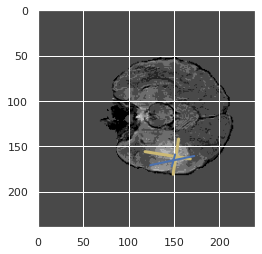

prediction [167.27997  121.358475 156.9579   164.70848  166.60123  139.70227
 154.04642  146.53516 ]


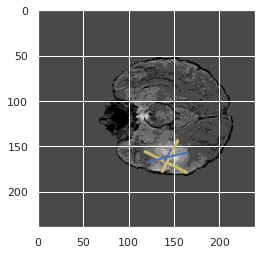

prediction [173.7608  127.06472 158.18456 170.50002 164.77441 144.1673  163.76442
 150.06732]


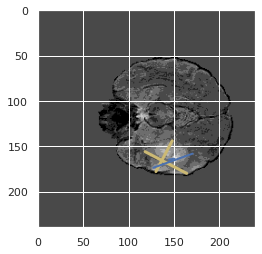

prediction [171.73601 127.79989 158.99286 169.27437 172.079   146.49869 160.2764
 152.73692]


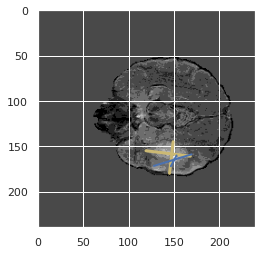

prediction [172.02452 125.63775 159.78073 170.19565 173.95862 146.8954  158.6143
 150.53873]


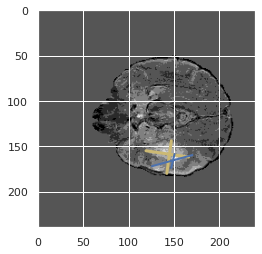

prediction [168.4182   124.604614 156.24959  160.92863  166.18176  140.38687
 154.74873  146.74547 ]


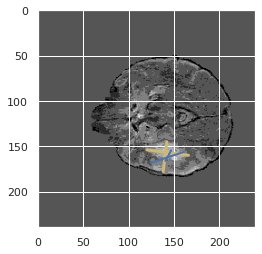

prediction [166.19022 127.45007 154.26973 153.07414 163.17963 137.55797 155.05756
 144.88004]


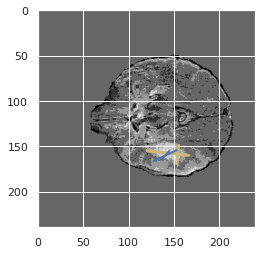

prediction [156.3212  128.14075 152.71953 151.30182 163.18225 139.24216 144.9987
 142.19296]


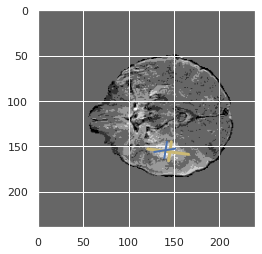

prediction [159.09453 131.07222 152.49074 157.2808  162.923   145.46463 148.58195
 146.72495]


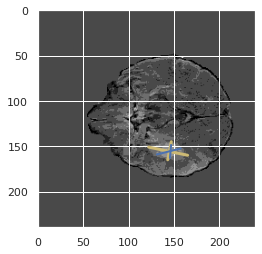

prediction [158.8034  135.65593 150.41115 158.81964 161.46191 146.6346  152.21318
 149.78056]


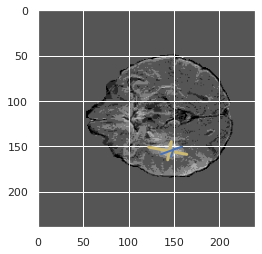

[0.41300813008130083, 0.47075208913649025, 0.01195219123505976, 0.0, 0.0, 0.0, 0.0, 0.04161073825503356, 0.32857142857142857, 0.23671497584541062, 0.20257695060844666, 0.08032128514056225, 0.2762669962917182, 0.4160045402951192, 0.402555910543131, 0.43448275862068964]
prediction [153.4999  132.25969 147.5601  158.14517 159.5628  146.15895 148.20578
 146.9178 ]


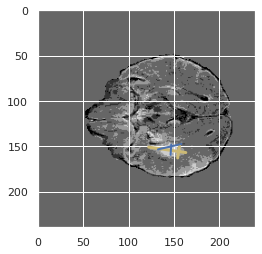

prediction [155.22377 134.71355 148.67215 161.06311 160.50945 151.3893  146.9899
 149.01712]


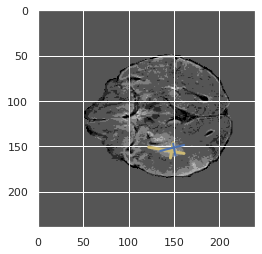

prediction [148.45512 128.51746 129.02425 135.96207 139.5684  134.2145  134.38705
 137.03012]


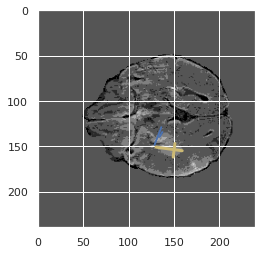

prediction [134.6397   116.89197  116.218185 120.87628  121.90875  121.097275
 125.46581  125.219955]


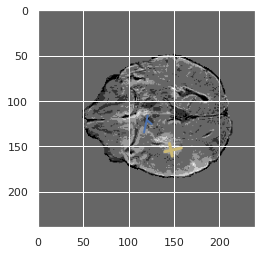

prediction [158.79095 151.91998 137.95784 152.6538  146.8593  150.95158 147.89305
 158.08263]


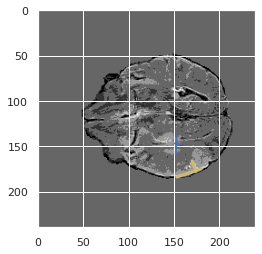

prediction [ 97.586914  98.6373    84.665634  96.10001   87.50542   95.8042
  91.58004  100.97616 ]


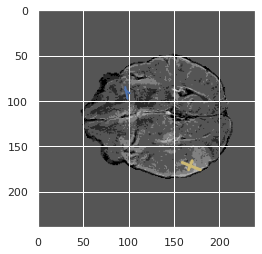

prediction [157.77122 135.04568 146.38377 161.1795  134.14577 148.82904 159.67305
 150.84851]


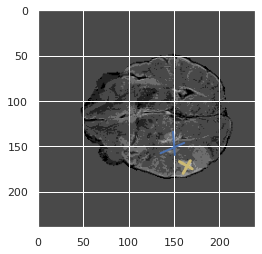

prediction [164.15349 139.77414 156.6084  168.17647 142.1203  154.48647 167.73668
 154.44579]


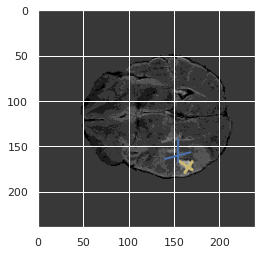

prediction [175.54294 150.6431  168.36705 183.54977 167.50089 162.88445 174.87904
 161.78542]


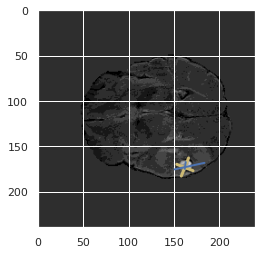

prediction [171.78925 142.05205 161.47217 179.03036 162.66364 156.35756 170.37468
 158.0496 ]


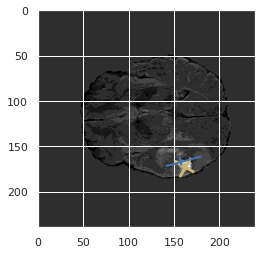

prediction [172.20102 137.19618 159.86581 178.71672 165.5417  152.67549 172.6935
 155.41362]


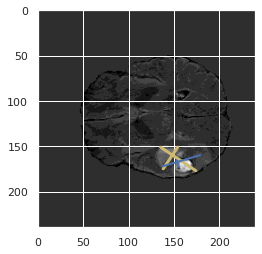

prediction [177.95804 136.69176 162.54619 178.43263 171.67738 151.4049  173.76631
 154.44841]


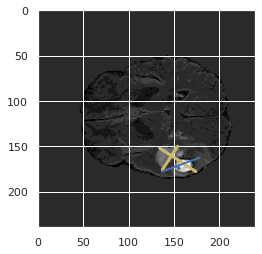

prediction [183.32355 140.02756 164.59308 178.84038 170.40154 152.57779 180.94623
 159.05481]


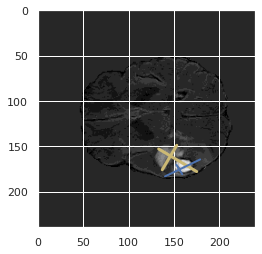

prediction [184.80666 142.78816 165.71388 178.5829  164.04637 152.1243  187.33371
 164.51149]


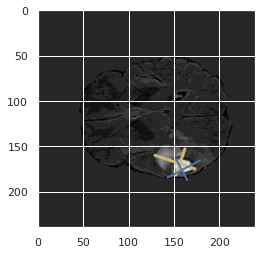

prediction [180.51562 142.52196 165.42296 177.14828 162.7378  151.50919 184.01373
 164.68114]


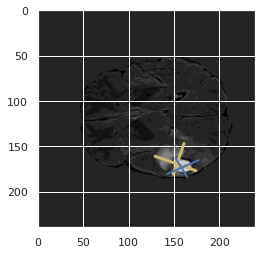

prediction [172.78703 141.7772  158.1056  176.35991 157.1543  150.5042  178.46555
 163.25677]


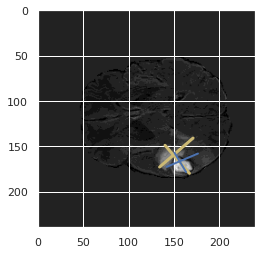

[0.4658077304261645, 0.3874323761964211, 0.4924812030075188, 0.4425879843583363, 0.4538653366583541, 0.30135979419331127, 0.0798848506657071, 0.2554794520547945, 0.6059379217273954, 0.6544269045984901, 0.6665595888210729, 0.7047713717693836, 0.6293408929836996, 0.6842105263157895, 0.6020445418035779, 0.6608187134502924]
prediction [168.37952 141.12021 155.91841 175.60649 151.09616 152.99094 179.7237
 167.76997]


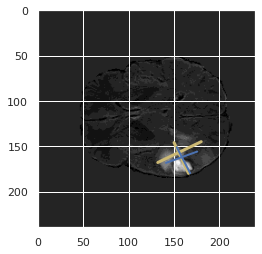

prediction [166.23657 143.14857 156.30235 176.42006 147.17154 155.25046 181.4586
 173.46457]


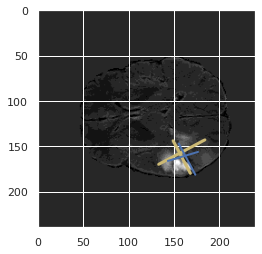

prediction [162.39636 139.60352 154.43073 179.82454 147.65553 158.57666 176.17714
 173.49632]


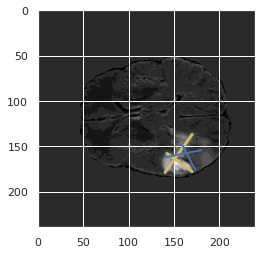

prediction [166.10027 137.78973 152.63817 181.22998 147.26546 162.67352 173.40535
 174.08977]


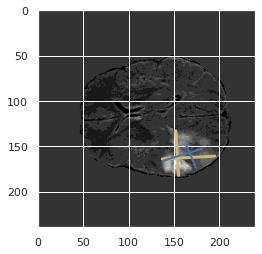

prediction [169.1289  140.2198  153.19461 186.37834 148.42389 165.81227 173.84883
 175.02136]


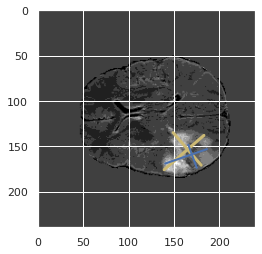

prediction [159.7393  139.37784 154.11208 188.2705  148.99474 164.89673 165.59178
 172.37868]


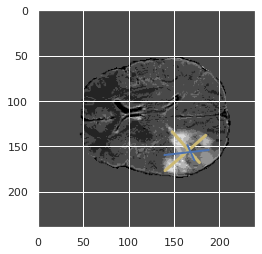

prediction [159.97183 137.54369 151.90988 189.19527 153.84889 161.04991 158.14578
 164.9133 ]


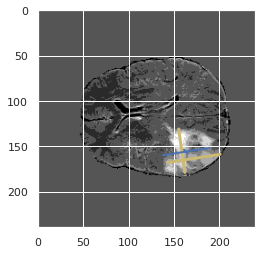

prediction [155.40863 142.36209 150.8747  192.43596 165.45958 162.96594 149.58243
 168.79092]


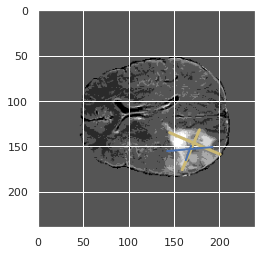

prediction [140.90715 143.94618 156.63504 196.6601  172.7989  168.33592 139.7246
 173.9722 ]


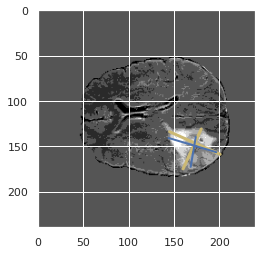

prediction [136.53314 142.94461 151.87091 196.23816 170.87051 169.16634 134.77145
 174.75716]


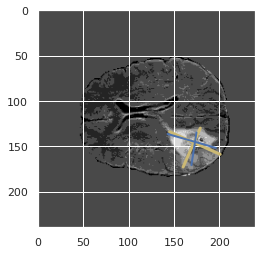

prediction [139.3079  144.00627 147.03217 195.36583 171.37054 168.72227 130.95769
 173.7262 ]


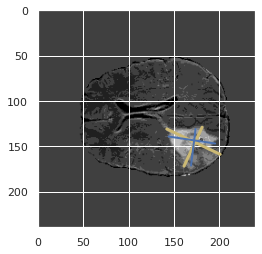

prediction [141.03607 143.8505  143.69077 195.7212  171.09537 172.33951 127.35338
 174.2791 ]


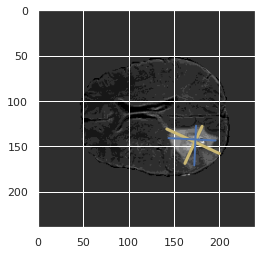

prediction [143.42845 143.64572 142.31937 197.05284 167.04509 173.58653 130.41443
 176.01846]


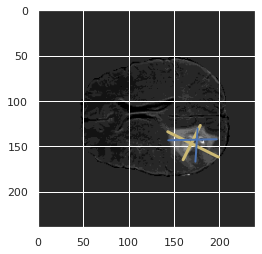

prediction [146.77411 145.02718 141.25014 200.19661 167.65411 177.96843 130.84343
 177.24384]


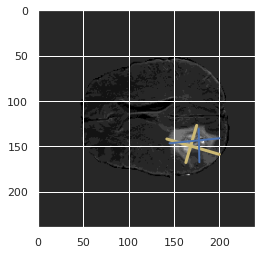

prediction [148.5948  146.02252 141.75082 200.49846 166.16536 177.78201 133.09833
 178.23311]


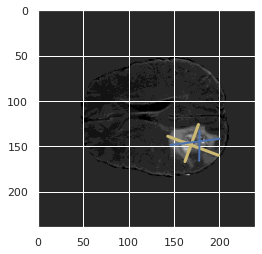

prediction [149.7539  145.959   140.52051 198.59827 165.58102 176.07565 132.28145
 176.8883 ]


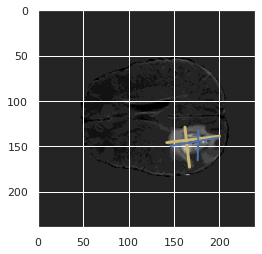

[0.5009283327144448, 0.2510094212651413, 0.07996207332490518, 0.17508628804518356, 0.46046046046046046, 0.6231543624161073, 0.6125860373647984, 0.496343085106383, 0.5582959641255605, 0.40556120718887756, 0.4047452896022331, 0.3182614791447599, 0.3040371561271883, 0.31099397590361444, 0.33829549683662075, 0.42829268292682926]
prediction [151.04556 146.86662 140.55812 198.49472 163.19472 175.01898 135.08414
 178.62546]


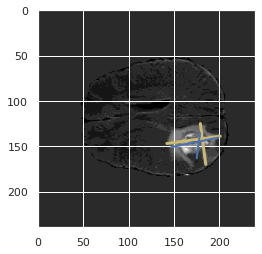

prediction [152.61452 149.45628 138.63933 196.13477 157.38028 172.85805 138.19304
 179.77667]


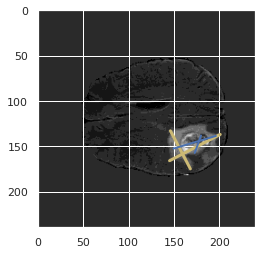

prediction [154.48044 149.82414 135.71516 194.39064 151.19217 170.66504 143.75601
 180.3806 ]


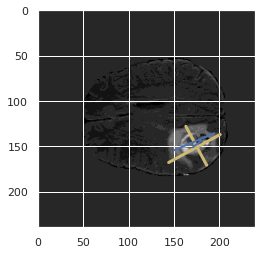

prediction [156.46808 147.40607 133.76785 197.16653 145.67671 168.82283 150.05733
 183.96738]


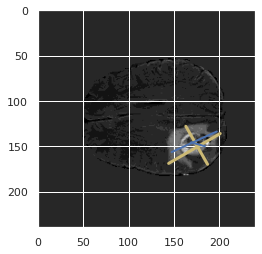

prediction [159.24559 143.76073 133.38022 196.6034  140.90727 166.75085 159.22585
 184.39139]


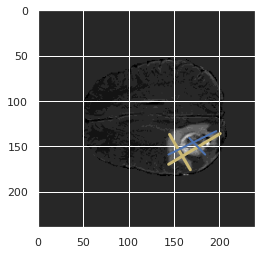

prediction [157.3309  141.14407 132.18846 195.54324 135.80818 162.97502 161.90477
 182.40486]


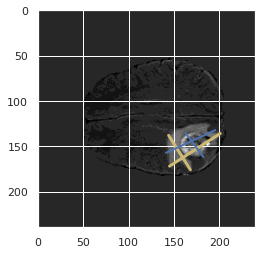

prediction [157.72188 142.24286 134.12167 195.62924 136.28445 163.5641  163.75989
 184.51909]


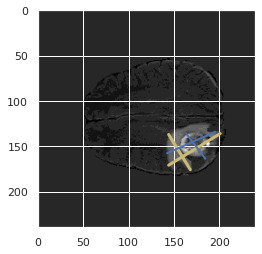

prediction [157.39064 144.07214 135.60963 194.88596 139.79889 164.49255 162.54659
 184.53003]


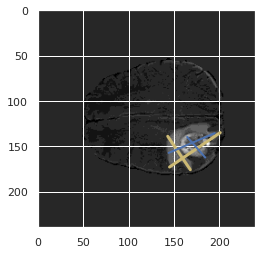

prediction [159.85165 144.90869 134.2073  195.02116 138.04114 162.08977 166.04903
 183.6713 ]


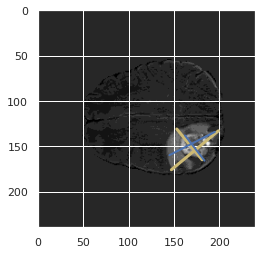

prediction [159.0246  147.50049 137.84743 194.34895 145.26901 162.08995 163.53294
 181.0001 ]


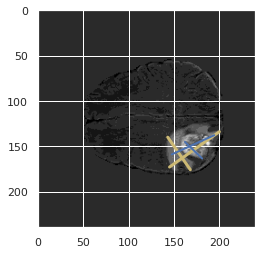

prediction [155.77153 146.40863 139.47015 193.1361  142.74522 160.10257 163.5248
 180.24928]


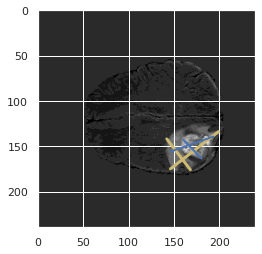

prediction [152.08963 145.03572 140.64815 190.62839 142.04861 156.84915 160.46924
 178.692  ]


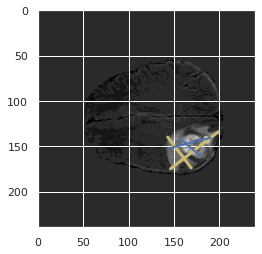

prediction [152.51991 145.6858  141.53625 188.16486 140.1675  152.80125 161.34233
 178.35878]


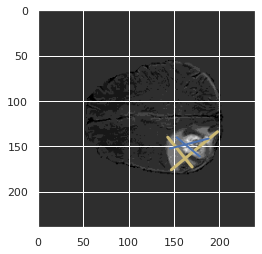

prediction [154.53046 147.57779 141.42319 187.02838 139.55077 152.65855 162.42375
 179.2828 ]


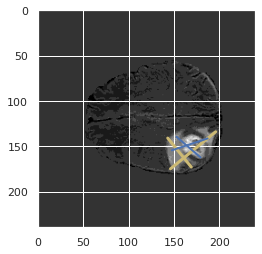

prediction [157.0091  146.56642 140.87508 184.98477 139.52208 152.61165 164.93933
 179.09416]


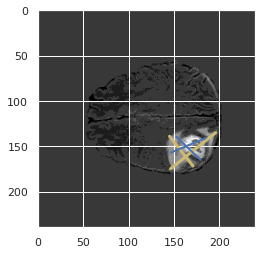

prediction [156.9602  146.50023 138.86026 182.59084 140.35843 151.68256 161.95181
 177.16425]


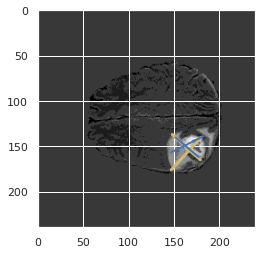

[0.5180722891566265, 0.3796680497925311, 0.21769662921348315, 0.12788104089219332, 0.16048387096774194, 0.25430597771023306, 0.1330891330891331, 0.19738751814223512, 0.13595706618962433, 0.28285714285714286, 0.18410041841004185, 0.0, 0.0, 0.0, 0, 0]
prediction [156.53711 144.73703 137.49889 182.52293 138.98314 152.92834 163.02213
 177.3523 ]


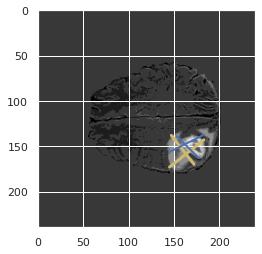

prediction [156.36618 142.91756 136.54689 181.77551 144.32063 155.40276 156.21758
 174.05731]


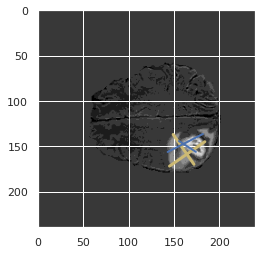

prediction [153.6378  138.90402 135.85295 179.3498  147.38947 155.49216 149.71469
 168.684  ]


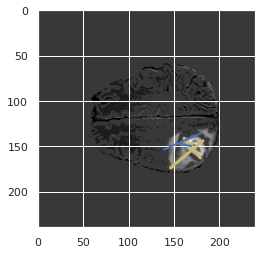

prediction [157.28123 139.58006 134.91862 181.77124 151.10979 160.78955 148.80484
 167.9512 ]


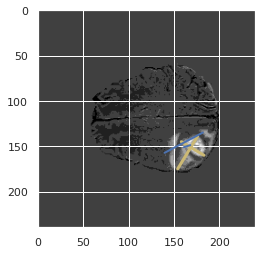

prediction [154.51033 140.99396 131.43762 176.60645 150.7957  162.64491 139.19745
 163.5012 ]


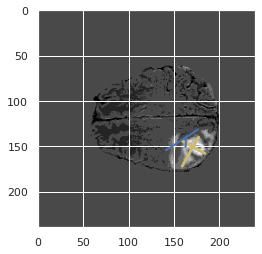

prediction [153.1674  153.92249 134.4303  181.40315 154.2122  166.6657  139.02882
 166.40851]


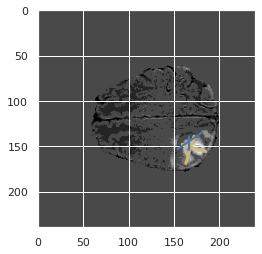

prediction [147.57768 157.31541 135.41702 182.03023 149.05135 166.96648 140.82253
 168.90663]


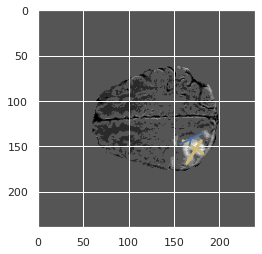

prediction [147.77693 158.75711 144.21025 183.54245 153.12428 167.31776 145.57857
 171.45607]


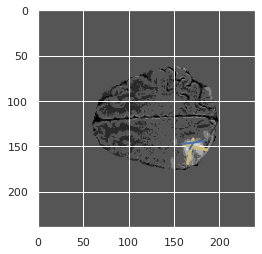

prediction [149.39203 153.41081 144.82558 173.74721 151.46738 162.12607 150.80046
 171.61026]


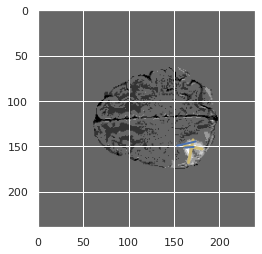

prediction [152.46855 159.45757 150.0284  179.32326 158.61282 166.66243 149.71957
 174.25679]


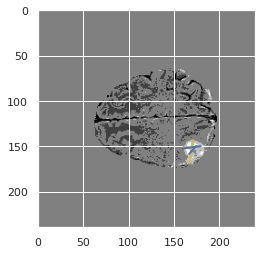

prediction [152.89748 162.85904 148.56728 172.84366 153.40813 166.96269 152.02039
 175.2595 ]


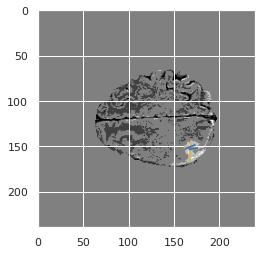

prediction [151.15044 166.57053 151.40224 178.04837 155.3793  175.0657  145.31752
 180.17464]


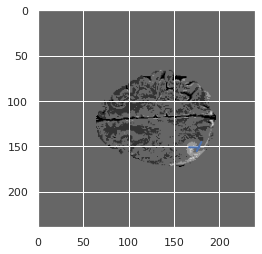

prediction [132.38982 160.2523  122.04379 167.4742  127.66022 162.65366 128.59674
 169.5229 ]


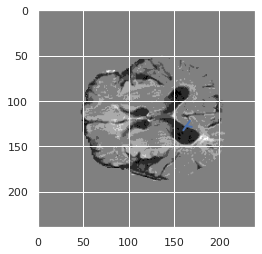

prediction [ 1.2396547   7.7869973  -4.2848086   2.60391     0.9398889   6.1858087
  0.04076235  7.293032  ]


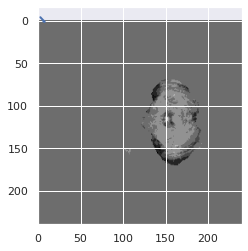

prediction [-0.1996878   2.8857648  -3.2230396   0.08098035 -1.2805507   3.1274445
 -1.179434    3.9436915 ]


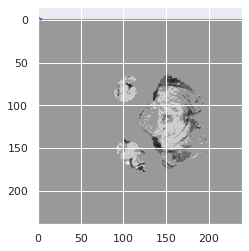

prediction [-2.3512712  1.7115806 -3.2062824 -1.0841843 -3.2532609  2.0698333
 -1.9190842  2.6571307]


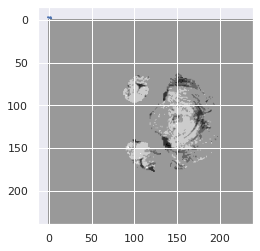

[0, 0, 0, 0.0, 0.0, 0.21325051759834368, 0.0, 0.007238883143743537, 0.0, 0.0, 0.09073543457497613, 0.1574074074074074, 0.25032010243277847, 0.30648330058939094, 0.3525264394829612, 0.3596673596673597]
prediction [-2.1458502   0.7864912  -2.53977    -2.5285404  -2.5511558   0.56741256
 -1.3385234   1.0823759 ]


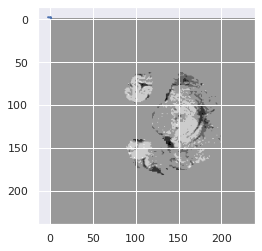

prediction [-1.5837023   0.43642846 -2.5787065  -2.7558732  -2.5554407  -0.5664888
 -0.51234114  0.27601165]


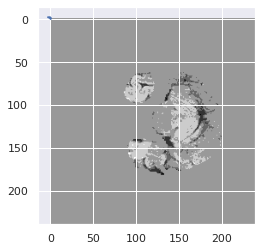

prediction [-4.1455984  1.0556667 -2.5413923 -1.1717682 -1.8272811  2.035422
 -5.829381   3.6168187]


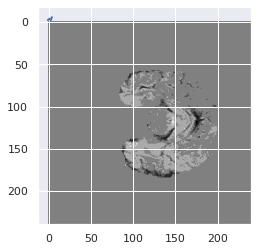

prediction [-1.6669686  3.23331   -0.8830466  1.5980344  4.7725234  8.177
 -4.9190674  5.6461473]


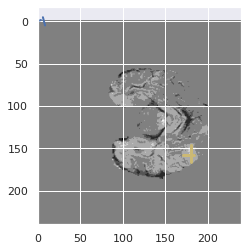

prediction [141.589   137.71947 142.03416 156.50107 149.12051 147.81317 133.56473
 146.73933]


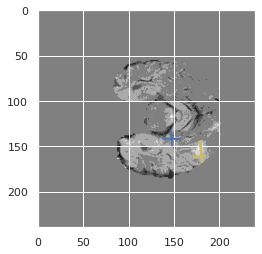

prediction [163.10004 173.58543 158.10086 194.8661  166.88629 178.38373 154.55125
 188.47525]


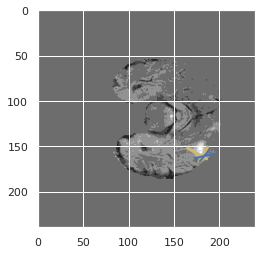

prediction [181.14334 174.33089 179.11554 200.00647 186.75908 186.50784 170.204
 193.92105]


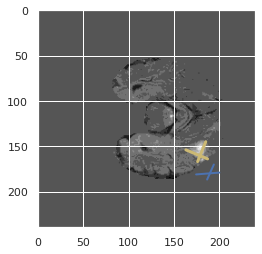

prediction [177.16734 172.41776 172.95662 203.23549 177.94421 189.4056  165.44673
 195.47488]


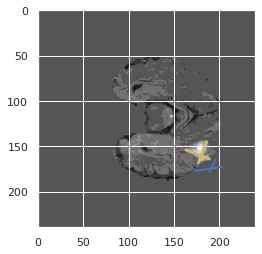

prediction [174.70233 168.42477 176.05048 202.39882 179.08508 187.17319 166.40118
 196.94878]


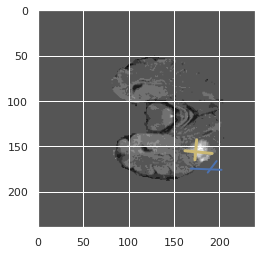

prediction [177.82675 168.07799 174.66557 203.10707 175.17935 191.68546 167.58177
 198.42963]


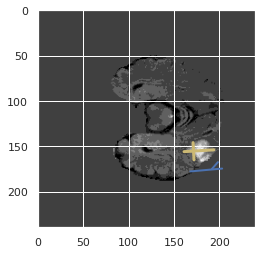

prediction [171.49602 159.38092 169.42715 198.39894 169.33498 185.69032 162.57182
 193.52638]


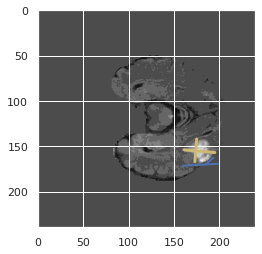

prediction [173.65543 155.12941 172.92914 198.71346 182.01549 185.90181 159.3934
 195.92732]


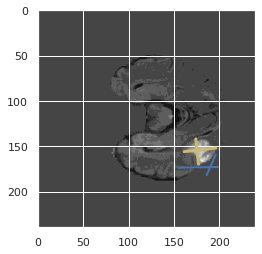

prediction [172.18398 146.50093 160.8142  192.89178 177.20152 177.29631 154.12717
 189.57967]


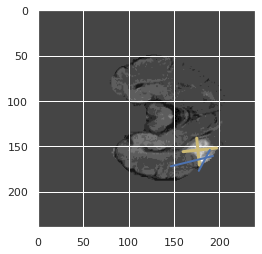

prediction [170.11684 142.65665 156.67465 186.98137 174.19284 172.4931  150.59187
 183.59708]


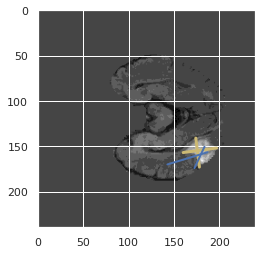

prediction [166.43762 137.9304  154.87996 187.468   173.39377 171.54295 146.51675
 177.85551]


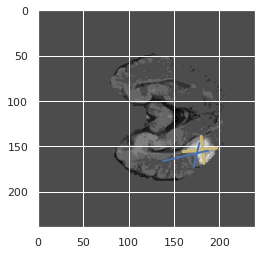

prediction [168.42226 137.9234  153.15729 187.03789 175.8444  171.4669  146.93956
 176.62079]


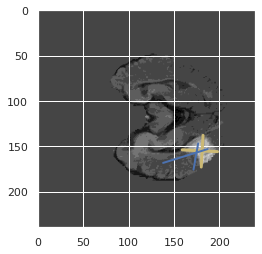

[0.2583554376657825, 0.16228070175438597, 0.1815365551425031, 0.1483790523690773, 0.37875, 0.3645833333333333, 0.40358744394618834, 0.3407910507391131, 0.4004914004914005, 0.3414408866995074, 0.33779869659666906, 0.3298145506419401, 0.39519566059666794, 0.36054421768707484, 0.32448673009514273, 0.2376599634369287]
prediction [173.38872 145.66026 155.15817 188.25117 180.79843 176.72253 154.58507
 186.75002]


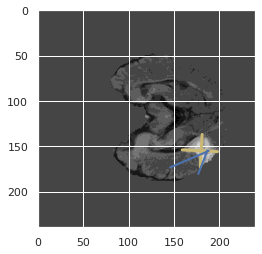

prediction [176.2013  143.86348 156.22589 181.45311 172.9828  170.2969  160.52336
 184.34485]


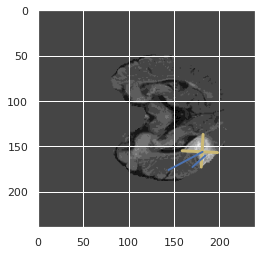

prediction [175.09436 146.12355 160.2886  187.17401 173.2123  179.92078 162.85434
 192.61441]


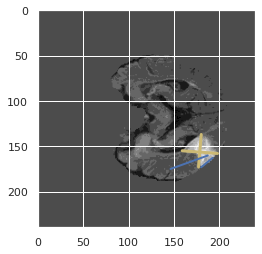

prediction [167.75136 138.57893 156.5021  184.94344 166.65048 175.60825 157.67004
 188.12206]


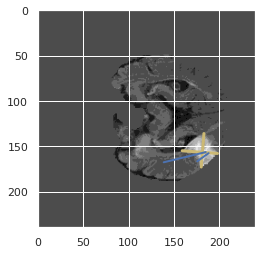

prediction [157.77046 144.44118 162.62622 190.2058  168.61226 182.45506 149.92703
 193.6673 ]


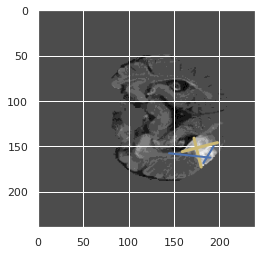

prediction [145.94778 130.0128  161.65974 187.59967 168.26945 173.51285 143.26096
 183.90096]


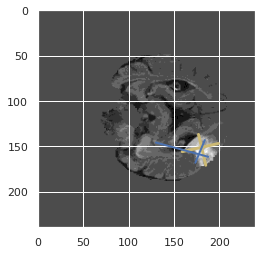

prediction [141.9405  128.04181 159.50874 197.19986 169.65065 170.26877 133.11458
 181.3864 ]


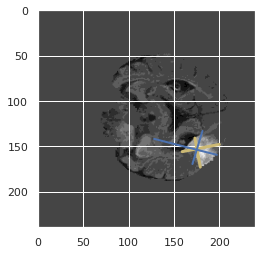

prediction [147.73605  123.854836 150.69482  191.66362  166.00497  162.33427
 136.81192  174.89436 ]


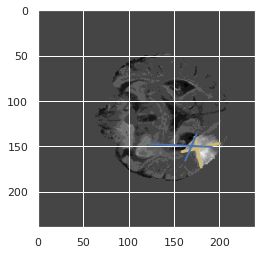

prediction [149.69302 115.06021 148.90947 197.13733 168.03104 161.6807  136.36603
 171.56027]


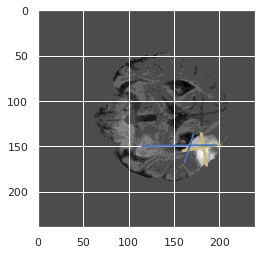

prediction [144.94641 114.82604 151.05446 198.01967 169.68262 165.13911 133.44496
 169.47084]


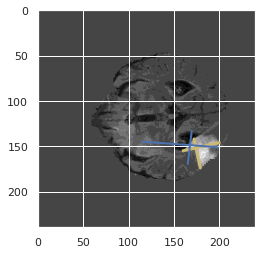

prediction [144.72919 119.61889 150.14459 200.43333 162.87704 168.77908 133.53653
 180.6329 ]


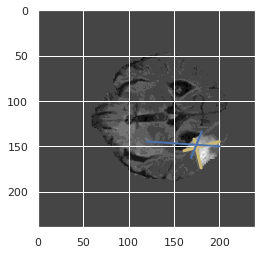

prediction [146.62613  118.404564 153.56056  197.02159  172.43642  163.75964
 130.70587  174.70782 ]


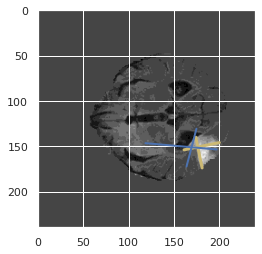

prediction [152.78337 124.20601 154.54712 198.9603  169.6424  169.75687 137.01663
 178.75882]


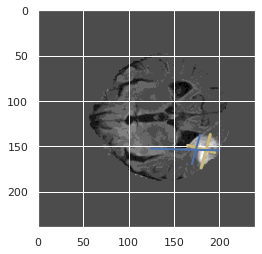

prediction [151.19241 126.73961 147.82431 197.51935 163.60081 169.0303  140.27058
 178.52417]


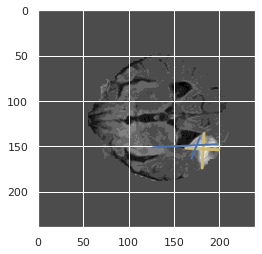

prediction [150.65672 132.38449 149.2623  195.82356 161.16841 172.36595 141.36119
 177.78186]


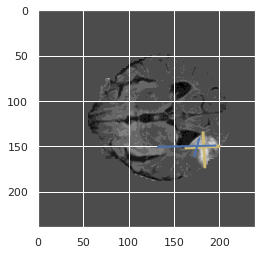

prediction [150.2324  139.80957 143.84056 193.36023 157.15912 175.42798 142.5895
 184.27515]


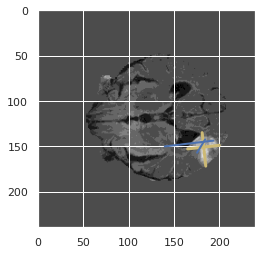

[0.25912137006701413, 0.4492424242424242, 0.3237939493049877, 0.0, 0.0, 0.11144578313253012, 0.0, 0.0, 0.0, 0, 0.0, 0.23423423423423423, 0.21238938053097345, 0.19047619047619047, 0.09416666666666666, 0.11476608187134503]
prediction [156.52599 151.89072 148.84262 195.8002  163.07027 184.31337 150.04845
 188.37926]


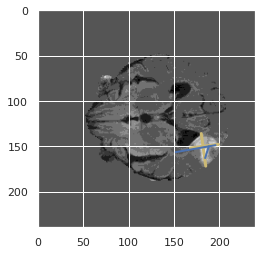

prediction [153.89943 157.5527  145.42197 197.73946 162.11076 190.63353 142.77365
 189.41006]


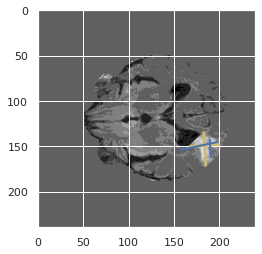

prediction [159.8856  162.61067 149.98415 205.1206  163.81883 196.5251  151.1645
 193.30458]


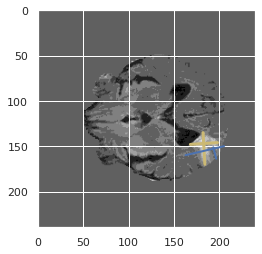

prediction [177.1082  172.97495 165.76353 213.62866 179.2172  202.30919 174.60107
 199.638  ]


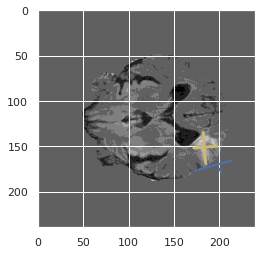

prediction [176.21855 175.46059 167.75406 204.95345 178.79231 195.46939 173.23071
 194.14801]


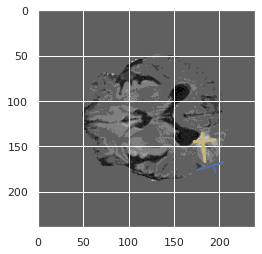

prediction [162.62541 171.87643 155.17174 192.71286 164.47443 184.72195 158.97473
 184.09929]


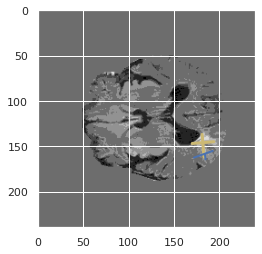

prediction [137.34521 160.8093  125.998   173.53505 138.00594 165.09698 131.83923
 166.6556 ]


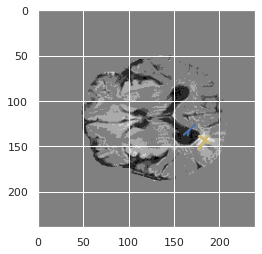

prediction [131.89206 157.34244 119.41848 165.40506 129.49295 158.27328 127.01245
 162.98692]


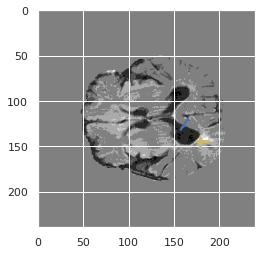

prediction [ 1.7357655  4.7307153  3.7094266  6.749815   7.44855    6.2892094
 -1.6532104  3.7195456]


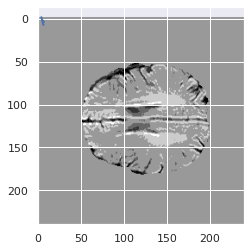

prediction [3.8089051 7.642381  4.4540915 7.150379  6.9895606 7.868477  2.7153091
 6.890853 ]


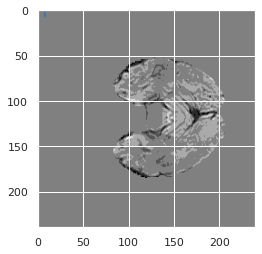

prediction [110.8242   111.5423   103.210396 119.05292  105.67805  114.06291
 107.6966   112.88214 ]


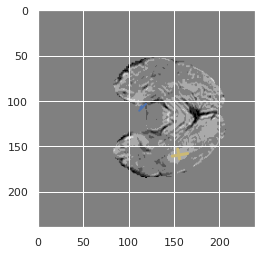

prediction [158.08304 151.2285  151.50287 163.13367 147.93047 154.28625 160.12585
 159.81653]


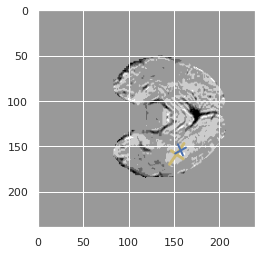

prediction [165.04713 148.19716 148.53212 166.20598 155.68063 156.13138 158.2728
 160.70953]


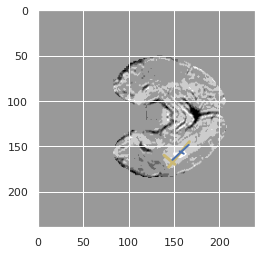

prediction [168.55554 148.5292  146.37816 162.55713 159.42593 155.69746 160.24428
 162.56355]


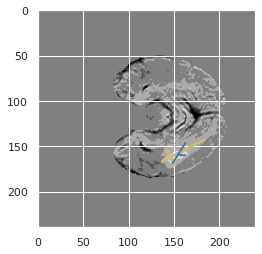

prediction [169.09973 148.25749 141.49548 166.93321 162.54446 154.34354 154.61937
 162.02364]


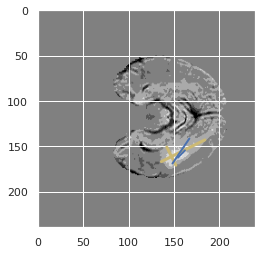

prediction [161.09239 139.97884 143.17651 174.3595  157.83981 149.64804 155.90582
 158.56967]


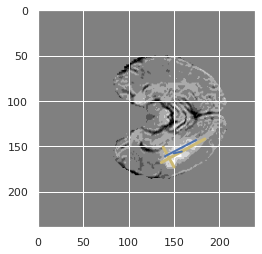

[0.17587939698492464, 0.21599264705882354, 0.20150862068965517, 0.14013671875, 0.18955223880597014, 0.3194174757281553, 0.24163227877120586, 0.2412726469288555, 0.20123293703214443, 0.28131680205215903, 0.35379061371841153, 0.3046492659053834, 0.17312252964426877, 0.1257359125315391, 0.09713024282560706, 0.15679124886052873]
prediction [160.62585 140.41304 144.03809 177.31546 155.40607 152.23518 160.33563
 161.55147]


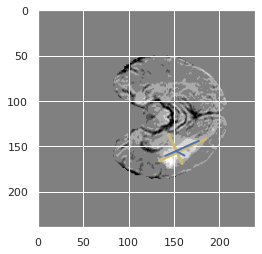

prediction [161.26125 137.23178 143.91832 180.6235  155.4514  153.60101 162.45964
 160.99805]


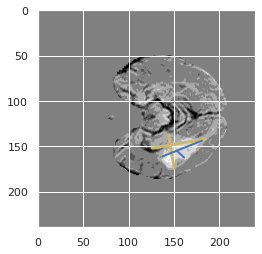

prediction [161.57683 136.79622 143.17313 181.43646 157.72266 151.82224 160.61633
 158.5887 ]


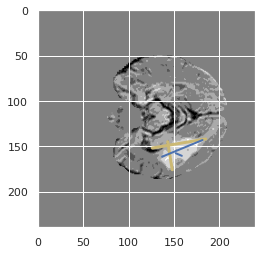

prediction [162.22725 135.44159 141.58838 182.02324 159.49434 151.99121 159.22638
 154.92172]


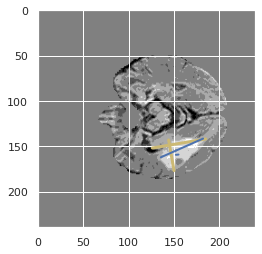

prediction [158.86221 133.58997 143.23282 182.01334 160.20906 151.87537 156.30455
 154.08426]


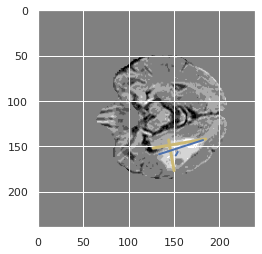

prediction [158.9184  132.83397 144.96562 185.44258 164.86617 154.3507  158.00603
 154.35654]


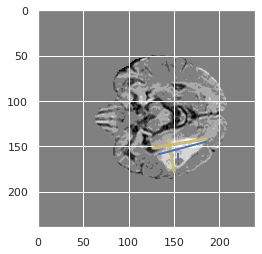

prediction [155.31892 129.172   143.233   182.15927 156.94283 152.9896  158.88431
 154.55046]


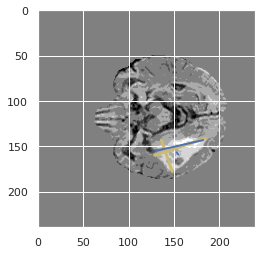

prediction [154.0904  128.37395 142.61563 182.54814 155.56198 154.53958 157.97902
 156.15057]


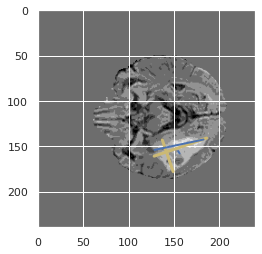

prediction [153.94434 125.05906 143.16339 179.76178 154.55847 151.7867  156.2851
 155.4538 ]


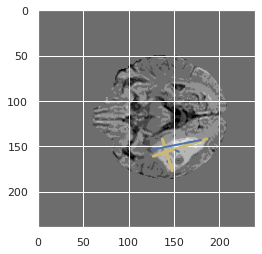

prediction [155.99617  124.356255 143.72266  181.11108  150.5364   153.14345
 160.2491   157.8524  ]


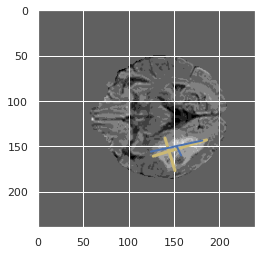

prediction [157.66223  125.164925 145.23871  182.02591  149.46051  154.41325
 163.5946   161.20668 ]


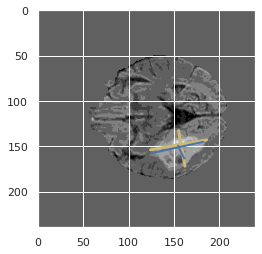

prediction [156.50504  127.185684 146.91177  182.59216  149.92789  154.70164
 162.19855  163.42271 ]


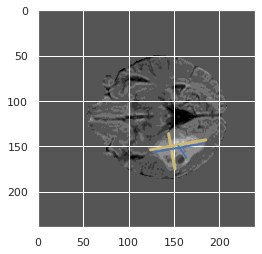

prediction [153.62813 126.2103  146.74213 182.25162 150.0539  153.7246  156.59103
 162.54301]


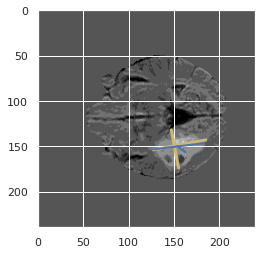

prediction [151.57869 125.36043 147.17593 181.43951 150.90143 154.2692  153.98633
 161.69775]


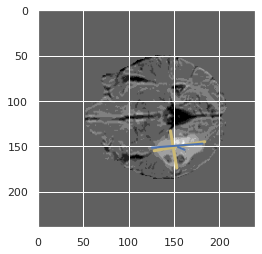

prediction [151.59691 125.88692 146.91011 181.60544 153.04617 154.50763 151.40408
 161.15556]


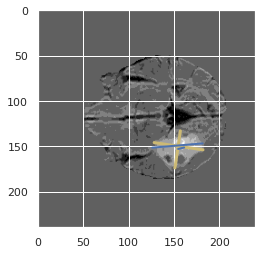

prediction [151.14543  126.875305 148.5323   182.14424  155.88829  154.89206
 149.96904  162.2062  ]


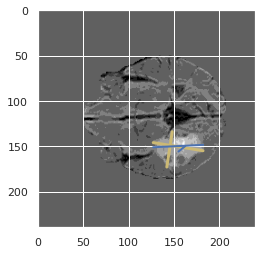

[0.17507002801120447, 0.17702008407286315, 0.07477937761263354, 0.06495547407019382, 0.16238381629305632, 0.27413333333333334, 0.328, 0.380143696930111, 0.3907815631262525, 0.3868402024584237, 0.4680210684725357, 0.6175359032501889, 0.5842607313195548, 0.5383973288814691, 0.5402193784277879, 0.36926605504587157]
prediction [151.7909  127.47231 147.9651  182.28284 156.52513 154.29247 150.56917
 161.77576]


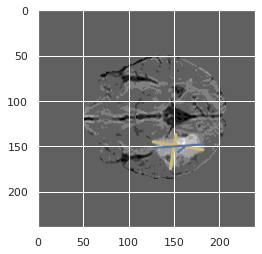

prediction [153.58401 131.10406 146.12035 180.2967  157.77522 151.56113 150.74289
 161.0051 ]


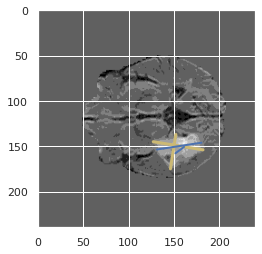

prediction [157.03087 135.81227 142.25644 179.43115 153.861   150.77882 151.4206
 162.79982]


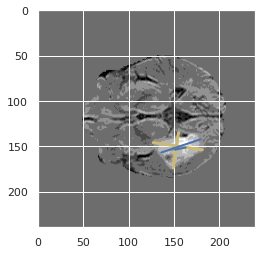

prediction [158.79771 138.31801 140.12958 177.77417 153.51953 148.95903 150.72444
 161.38916]


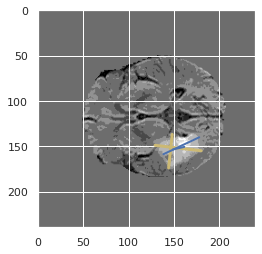

prediction [160.21642 140.86542 139.16052 175.31544 151.95406 148.58368 153.11949
 161.80154]


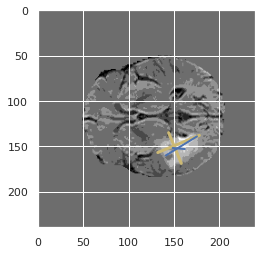

prediction [163.88593 144.45032 137.8761  171.35757 150.53638 146.83266 154.3895
 164.5912 ]


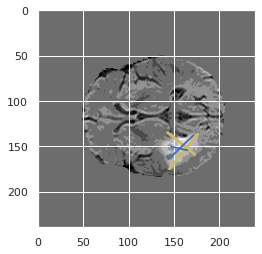

prediction [166.8372  145.66722 136.62248 170.84532 152.40942 144.5536  153.62721
 163.23145]


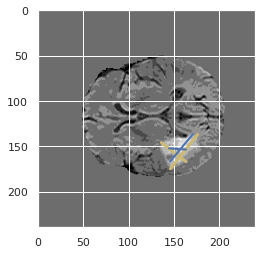

prediction [166.67413 147.88652 136.53893 170.1895  151.74863 143.36531 153.60442
 164.5616 ]


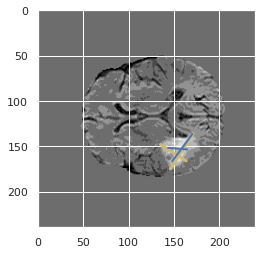

prediction [167.96397 149.9414  136.07887 170.90482 152.33438 143.96368 152.81818
 165.44156]


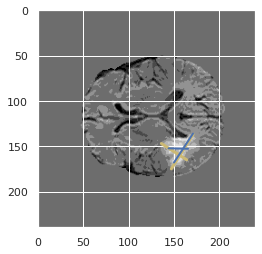

prediction [167.06934 151.34477 133.72777 168.52187 153.30872 142.69778 147.83382
 163.8181 ]


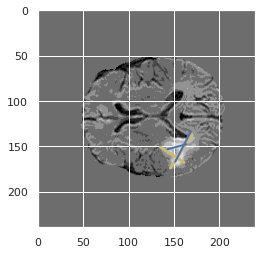

prediction [168.13562 155.38112 133.64177 164.11453 153.44656 142.75578 146.19125
 164.71925]


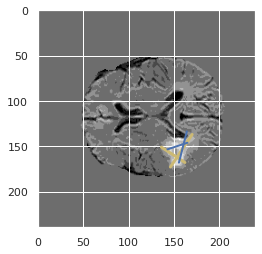

prediction [171.30876 157.8851  135.64616 159.88322 153.70981 142.32227 151.06633
 167.36847]


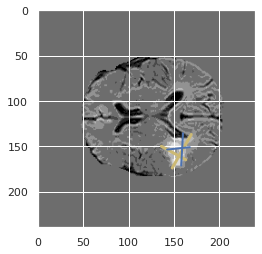

prediction [173.38503 158.75854 138.053   159.65962 153.342   143.54825 158.22278
 169.43674]


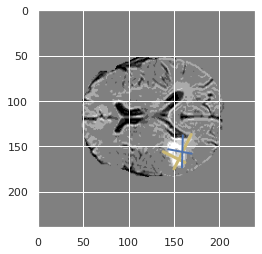

prediction [173.80075 157.83267 142.0972  160.1056  156.0586  144.01141 161.58041
 169.45709]


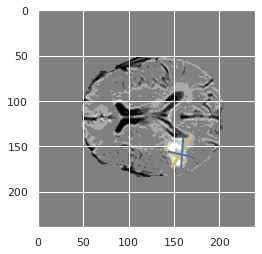

prediction [172.52881 156.49207 145.16226 159.113   158.59999 144.13231 161.66412
 169.2793 ]


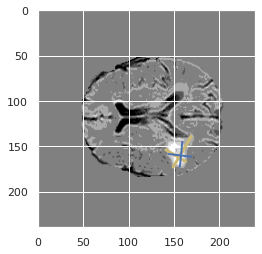

prediction [171.29546 155.18822 148.50714 159.87552 161.3874  145.89772 161.93137
 169.91531]


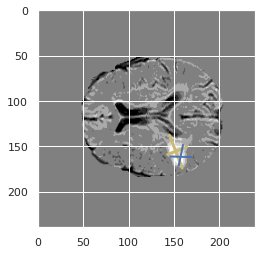

[0.3070683661645423, 0.31900138696255204, 0.2713864306784661, 0.16296296296296298, 0.1875, 0.16735537190082644, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.16913946587537093]
prediction [169.74251 154.73036 149.96497 161.14754 163.43973 147.26738 161.57468
 170.09636]


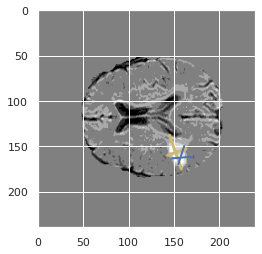

prediction [168.94858 154.51793 152.52838 161.21922 165.76259 148.1205  161.47818
 170.114  ]


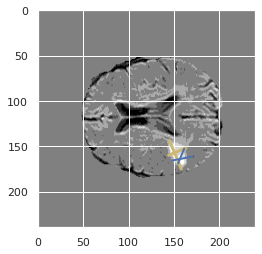

prediction [169.16583 153.9352  154.9343  162.83524 166.55692 149.22336 163.13506
 170.12738]


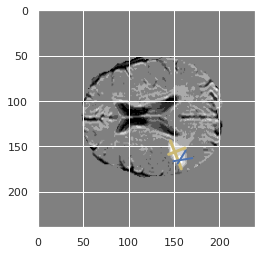

prediction [164.43817 151.4204  156.091   162.61978 165.2886  151.00342 161.26445
 170.31418]


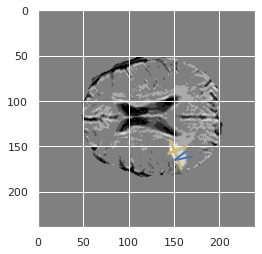

prediction [161.983   148.96387 154.78186 161.73883 161.4106  152.58607 161.28897
 167.66603]


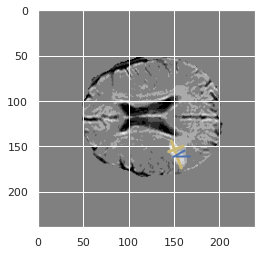

prediction [165.65047 154.67075 158.06836 165.1393  164.45721 159.2041  166.3092
 166.84912]


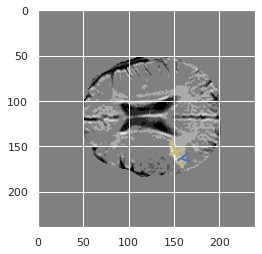

prediction [61.6956   67.583626 57.63771  73.97417  61.770977 68.92309  59.796898
 69.2715  ]


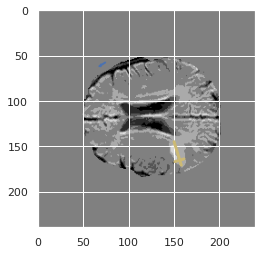

prediction [71.65707  78.24598  69.912834 87.362305 74.361015 82.327095 69.25375
 81.28307 ]


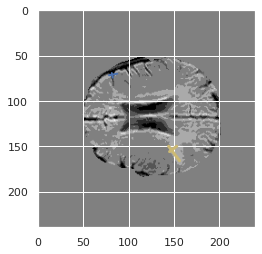

prediction [11.798333  14.99148   10.852439  18.563232  16.140724  16.652761
  7.3445926 13.953679 ]


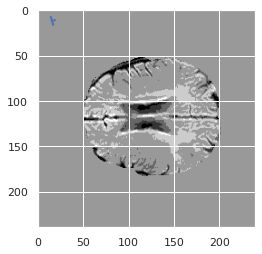

prediction [ 1.4376415  4.3796625  3.5368814  6.972575   7.8586235  5.2369924
 -1.6090299  3.0879774]


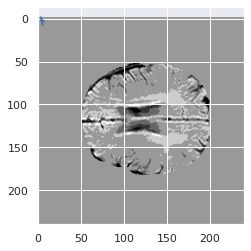

prediction [ 2.8239963   5.3918133   4.448941    8.520758    8.432344    7.342581
 -0.28206876  4.367039  ]


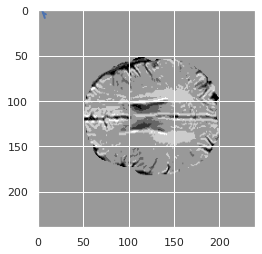

prediction [3.3452256 3.1179094 1.3245853 0.9358419 2.8461087 3.325541  0.7335559
 1.7815106]


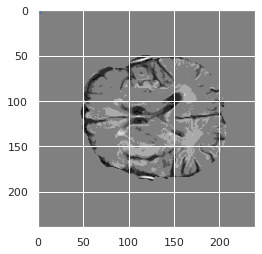

prediction [27.647827 30.899876 15.729437 30.405825 23.104519 30.176716 19.921202
 29.798426]


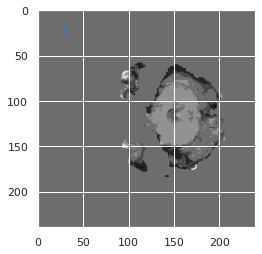

prediction [56.98711  57.313484 33.915043 56.018726 42.812134 54.890915 50.786255
 59.603203]


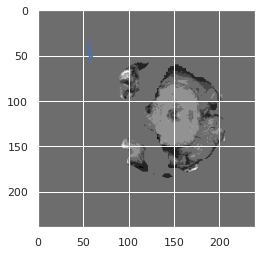

prediction [158.8161  105.66496 140.78616 117.87324 150.77882 106.07659 157.71715
 122.07273]


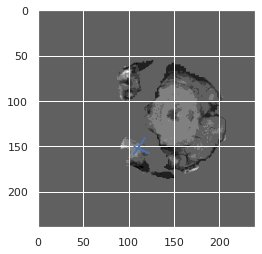

prediction [156.68968  103.67596  145.65227  111.66792  154.25934  104.19013
 155.51363  118.041954]


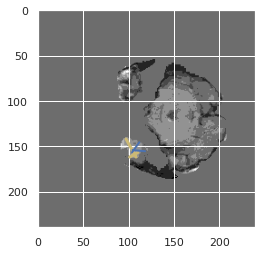

[0.23214285714285715, 0.16666666666666666, 0.19101123595505617, 0.44526315789473686, 0.5256, 0.6403123474865788, 0.6292741451709658, 0.6735921268452706, 0.5774104683195592, 0.2494331065759637, 0.175235646958012, 0.11468885672937772, 0.1218375499334221, 0.14449166394246485, 0.23869918699186993, 0.19278195488721805]
prediction [156.78978 100.29008 147.93637 106.59972 158.09698  99.32598 152.39035
 112.92258]


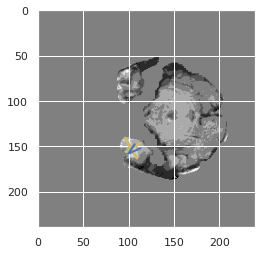

prediction [154.8172   101.21368  150.1989   109.82683  162.9914    99.35642
 148.41881  112.075035]


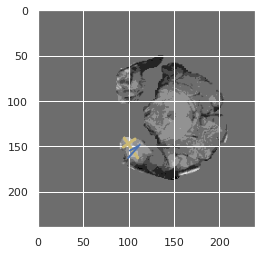

prediction [155.95558 102.82877 151.24982 113.13617 165.07803 102.02968 146.6495
 109.75273]


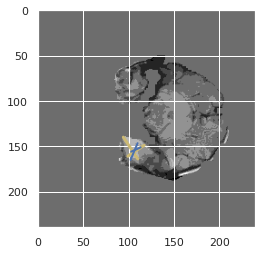

prediction [155.20111   95.037605 149.07101  120.627785 168.20547  102.898766
 137.74213  106.958786]


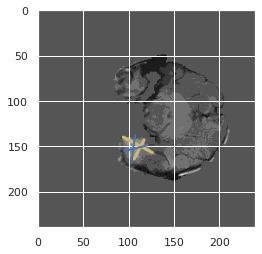

prediction [154.47412   90.9777   148.49304  127.00394  168.05727  101.25015
 135.18602  106.900185]


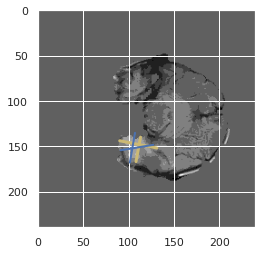

prediction [149.90216  89.48746 157.7169  136.14789 177.03276 101.27064 133.3774
 109.83092]


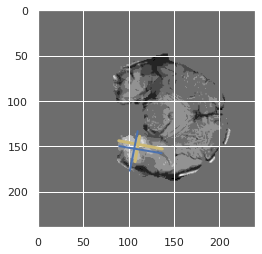

prediction [151.50465  91.64398 151.58243 136.32106 172.14563 103.27849 134.92824
 114.71898]


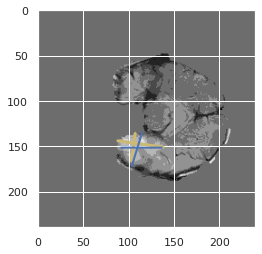

prediction [150.64723   91.42049  150.15552  137.75873  170.58023  103.119125
 136.55788  114.49355 ]


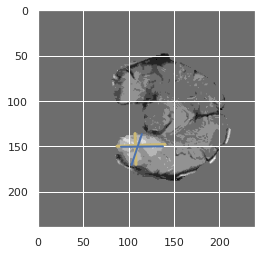

prediction [152.2833   90.64544 145.71732 140.67665 165.54047 104.16112 140.22153
 114.47023]


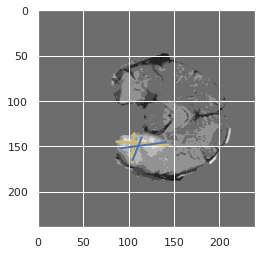

prediction [151.83327   91.487434 145.56987  142.7316   159.43018  108.54973
 146.31926  120.62077 ]


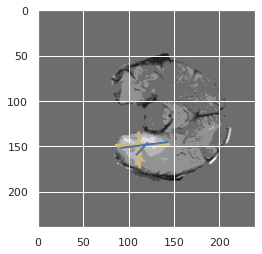

prediction [147.43616  89.80702 140.51561 143.96709 152.29672 108.29938 144.07402
 116.89063]


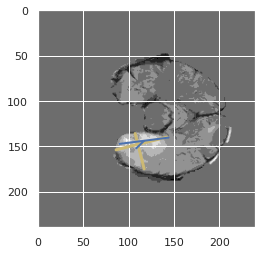

prediction [147.69339  87.91424 139.12016 146.4556  149.69536 109.35156 145.82857
 118.06597]


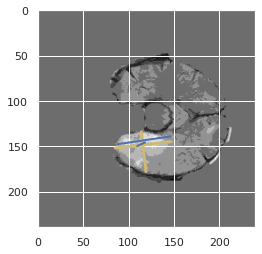

prediction [147.03165   86.378685 138.02695  148.05583  148.4563   116.77388
 145.79065  122.57239 ]


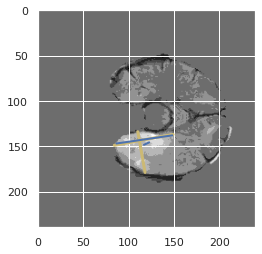

prediction [149.10515   84.233475 141.33502  148.086    150.44626  125.98696
 147.29448  127.172806]


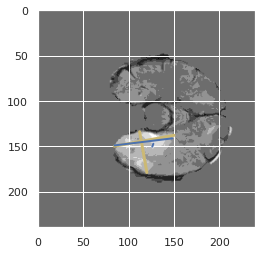

prediction [151.40593  82.60951 144.00897 150.14651 156.73276 129.87898 147.7283
 125.72495]


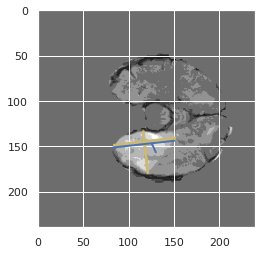

prediction [152.50949  82.18392 143.11191 156.91713 155.1699  129.11401 151.51135
 124.16309]


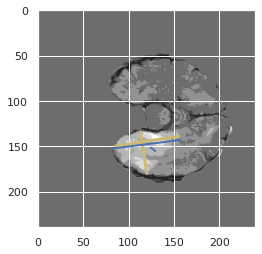

[0.2537313432835821, 0.20570440795159897, 0.16709807305148117, 0.12933930571108623, 0.15748685303072238, 0.20204865556978233, 0.1726474278544542, 0.20841784989858012, 0.18663990825688073, 0.1530197444831591, 0.2469719350073855, 0.4300916346438073, 0.5579687977974915, 0.6331360946745562, 0.6444238492431263, 0.6850638151086581]
prediction [153.51317  85.95522 143.9671  162.94746 151.4622  131.27412 159.62149
 129.9125 ]


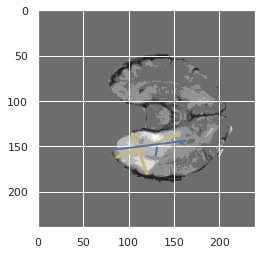

prediction [153.45409   86.203156 139.54184  165.62407  152.71118  135.26059
 155.03717  132.43622 ]


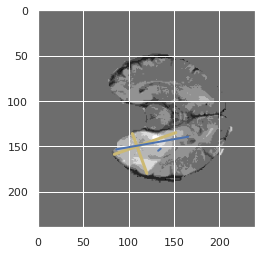

prediction [156.17645  89.9564  135.4526  171.1451  152.29556 138.96591 152.13914
 134.9596 ]


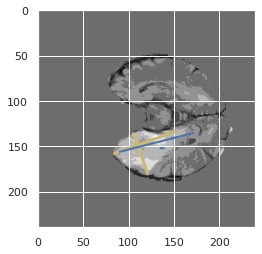

prediction [155.32816  89.25698 133.62288 171.28987 149.70428 135.48273 149.61061
 131.50322]


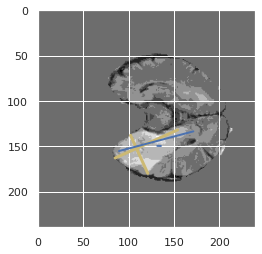

prediction [155.05484   86.738106 131.47061  172.70616  150.55656  132.93488
 149.07584  127.48655 ]


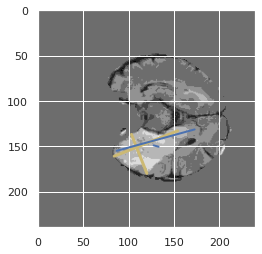

prediction [155.36887  84.07372 130.61374 171.27365 151.52878 133.14914 149.22404
 125.51339]


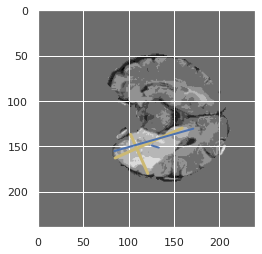

prediction [154.32254  83.09892 131.83911 170.29831 148.70213 130.83263 152.5238
 122.81985]


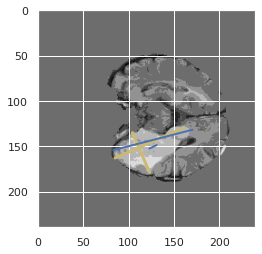

prediction [151.65508  83.46261 134.1931  172.03476 146.34955 129.3376  153.67223
 122.48598]


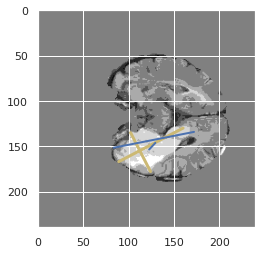

prediction [143.88919   83.59487  138.39958  172.35344  143.90779  123.843056
 150.24525  118.87846 ]


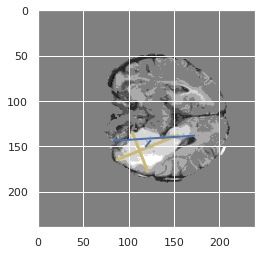

prediction [146.67233   83.37182  139.02202  170.71495  150.56306  120.501526
 145.78676  116.63678 ]


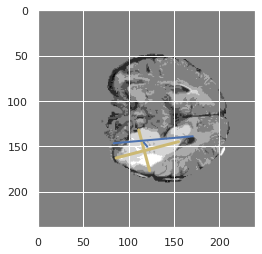

prediction [143.1884   84.20816 140.80713 168.65448 153.55461 117.11762 143.49765
 115.54009]


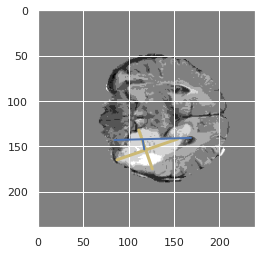

prediction [146.05974  85.51267 148.8024  168.11711 162.7182  113.79498 142.18633
 115.31359]


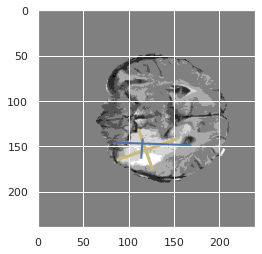

prediction [148.02501  85.61702 151.97557 164.75381 166.98032 116.56903 137.63899
 115.89278]


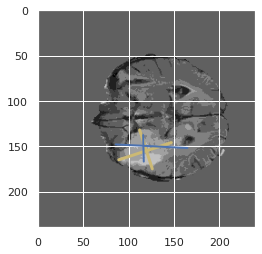

prediction [149.87137   87.578865 153.74316  162.63293  173.96947  116.936356
 132.85841  116.39944 ]


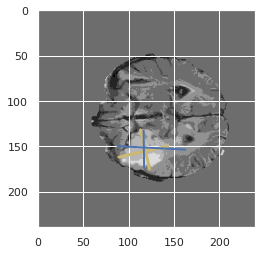

prediction [154.06697  89.46777 155.66794 157.4558  176.19084 117.98869 134.10657
 120.45345]


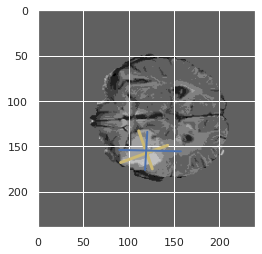

prediction [154.59766   91.70037  160.35178  151.8989   178.11467  116.09001
 135.95763  124.130844]


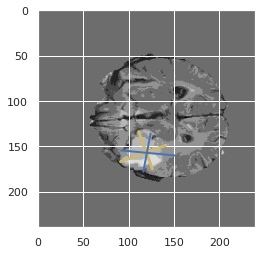

[0.6257336343115124, 0.5732133933033483, 0.35983041865394805, 0.3288318703578663, 0.41975308641975306, 0.401006711409396, 0.08754208754208755, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0, 0]
prediction [157.72063  92.79694 160.27728 146.38228 173.11624 113.40733 140.35808
 125.04138]


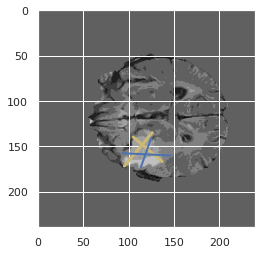

prediction [159.58997   92.209274 162.30171  143.03957  172.40843  111.04451
 145.6404   125.89065 ]


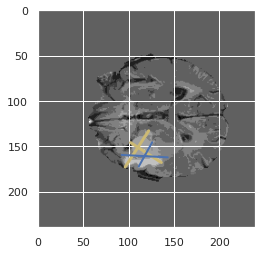

prediction [161.81738  96.7182  168.27744 138.95512 172.27242 108.89058 154.06621
 130.95682]


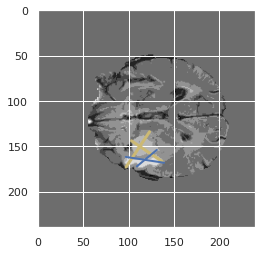

prediction [161.79817  96.46544 167.46523 138.78677 168.58377 108.70233 155.75775
 133.14532]


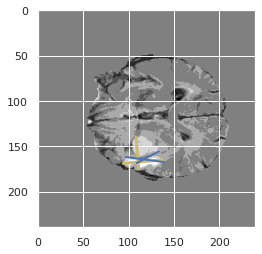

prediction [154.63525   93.577255 163.908    130.13292  162.03607  105.29381
 152.31667  126.87512 ]


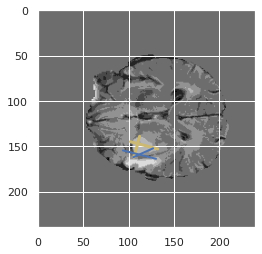

prediction [157.48563   98.60139  155.03658  120.388855 148.932    102.73089
 155.949    126.96676 ]


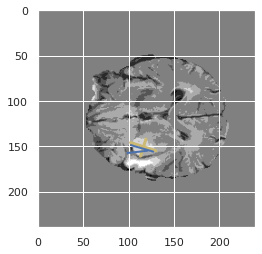

prediction [152.42331  98.51614 154.30057 115.83019 150.92442  99.381   151.9537
 121.10955]


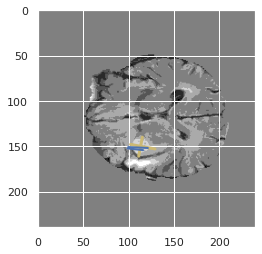

prediction [149.99889   98.971565 157.61258  119.42694  155.10823  101.74552
 149.25848  121.47957 ]


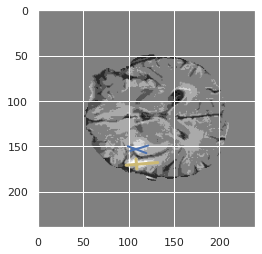

prediction [153.49554  103.12093  156.89087  113.25449  157.39214  101.212296
 153.82246  119.70664 ]


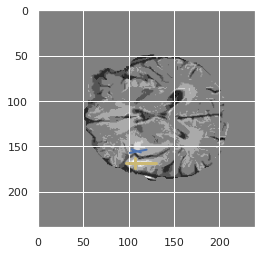

prediction [160.78589   99.61563  162.613    111.693474 165.11937  103.22486
 160.9462   114.183304]


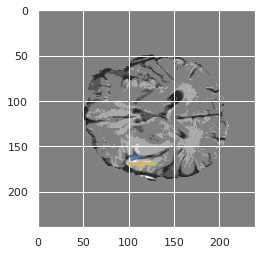

prediction [149.86957   99.62667  145.8794   113.062675 152.76558  108.19053
 148.06673  113.314415]


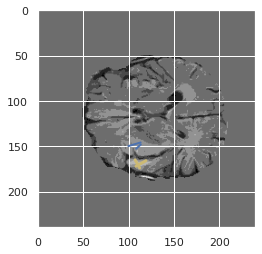

prediction [131.06897   89.41646  123.723755  94.8862   129.34552   92.64231
 125.46296   97.62163 ]


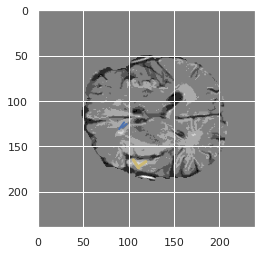

prediction [14.340144 13.694208 10.293915  8.098783 12.265341 10.64617  10.227506
 12.361423]


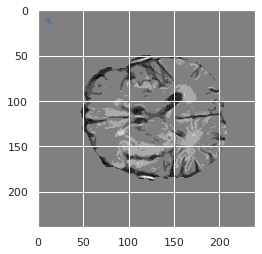

prediction [ 3.0403898   0.05621266 -0.05077052 -0.14479108  0.3279043  -0.46246967
  0.99959815  2.4565253 ]


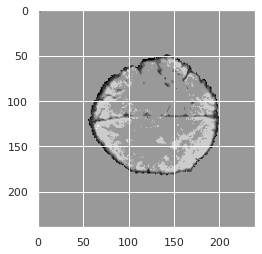

prediction [ 0.13070995  1.2751551  -1.8471881  -0.6165978  -1.3421427   0.15060592
 -0.26949096  0.8889966 ]


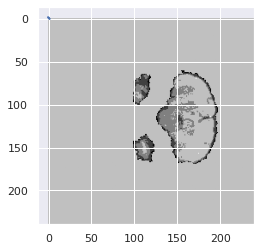

prediction [1.9806321  2.3497753  0.2486479  1.4867679  0.50985986 1.4676455
 1.6721406  2.1549072 ]


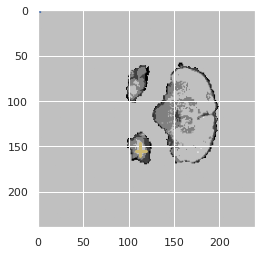

[0.0, 0.0, 0, 0.0, 0.0, 0, 0.0, 0.0, 0.0, 0.01383587786259542, 0.45142464812907657, 0.4981606376456162, 0.5367521367521367, 0.6186420629287911, 0.4723555184644273, 0.35419605077574046]
prediction [8.802376  8.36298   6.190243  5.8943963 6.5551915 7.01619   7.1047487
 8.944304 ]


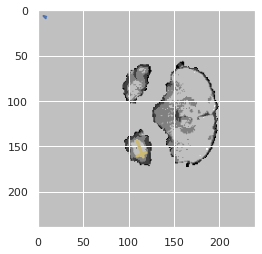

prediction [14.957798  19.0961    11.698464  18.463032  12.540992  17.336828
 14.2838545 20.128891 ]


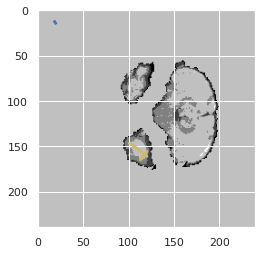

prediction [5.1227345 6.7240524 2.4381318 5.582121  3.3217173 6.1731668 4.217722
 6.64809  ]


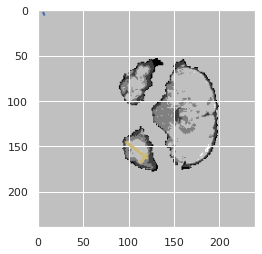

prediction [47.933914 33.72819  42.772835 32.67426  46.96485  30.807358 43.14294
 34.16639 ]


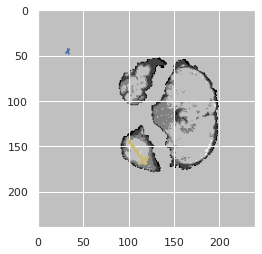

prediction [18.58217  15.534465 16.102745 13.131096 18.714361 12.370273 15.596144
 14.553778]


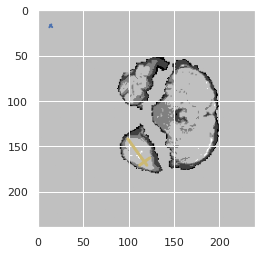

prediction [16.044481 10.211185 14.187543 10.603179 17.41764   9.951783 12.090325
 10.461771]


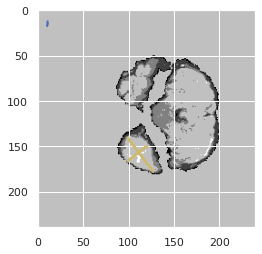

prediction [3.6147614 3.6101933 0.9761274 1.6645566 1.839165  2.8241491 2.320913
 3.5941951]


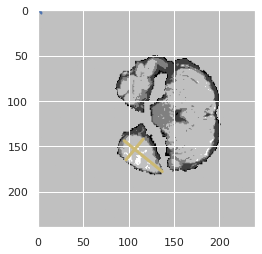

prediction [5.6679764 7.665208  4.1604714 2.7294002 5.474007  4.7204657 3.8302052
 5.573573 ]


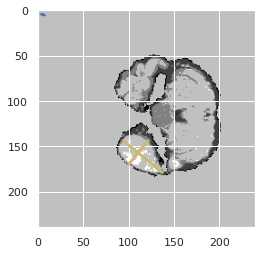

prediction [14.715501 15.328136 13.612915 12.173903 17.599552 15.604576 10.746147
 15.105813]


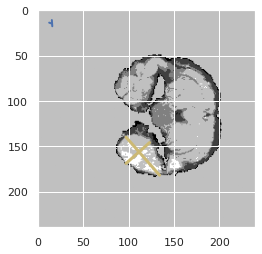

prediction [147.91989 104.41128 136.91963 128.30746 143.81586 116.19116 141.6808
 121.7906 ]


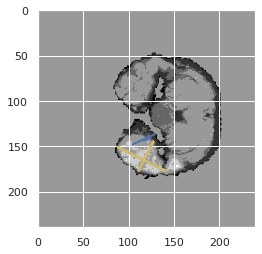

prediction [156.57964  95.36623 166.33884 135.0366  176.8751  111.71702 145.40857
 120.90913]


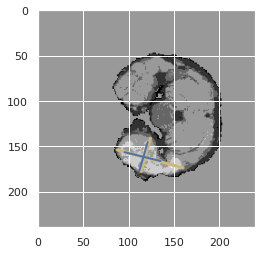

prediction [158.59299  94.31733 170.64053 138.43822 181.93713 113.95956 145.3568
 123.34908]


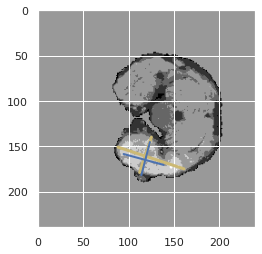

prediction [162.47028  90.506   166.23767 145.04034 183.04945 122.67488 145.0079
 126.64042]


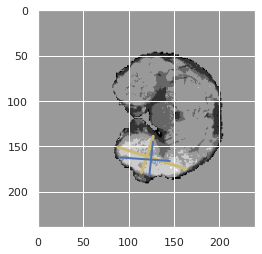

prediction [155.92688  88.06518 160.76802 149.27286 180.94371 124.5111  136.42384
 125.20972]


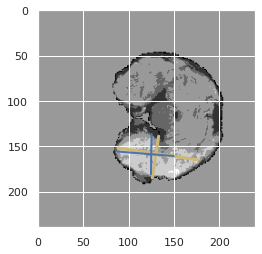

prediction [151.89911   87.10706  153.3501   147.91986  175.5397   120.252464
 129.85045  118.09928 ]


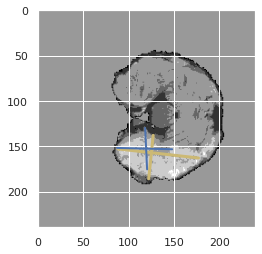

prediction [150.07999  88.1868  149.56133 151.30084 170.73027 122.23907 127.32715
 119.41436]


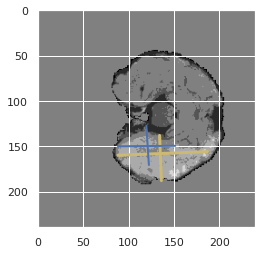

[0.38795180722891565, 0.48699174326219036, 0.5555725190839694, 0.6466796582221556, 0.583232077764277, 0.5735674424935348, 0.44813059505002634, 0.46057827028404025, 0.44057608015028177, 0.4586115660829029, 0.4598531059380057, 0.41834651696861447, 0.6194126665880411, 0.650132754042964, 0.6168773563983145, 0.6129236617041495]
prediction [147.59544  86.94116 143.94507 159.56326 169.68938 129.5943  126.30715
 120.79377]


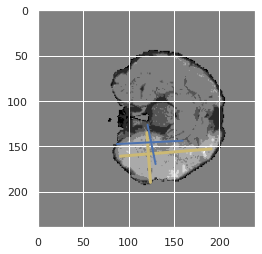

prediction [147.97656   86.469086 143.7306   170.52463  173.51045  137.76167
 126.847496 121.96653 ]


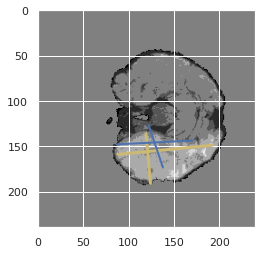

prediction [153.93018  90.07058 137.69572 174.43237 175.88602 145.62376 127.47767
 118.56654]


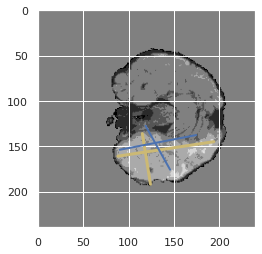

prediction [159.63158  87.42081 134.75131 180.18141 175.84842 143.43947 129.20454
 112.80551]


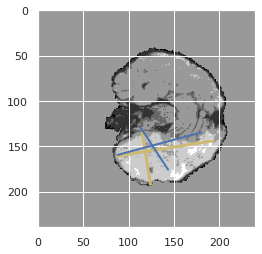

prediction [158.63905   84.68752  130.32285  180.10295  174.86563  140.70554
 126.799805 109.98208 ]


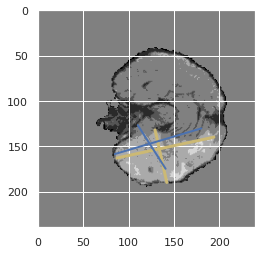

prediction [160.05518  89.4921  131.81027 179.13617 172.95392 143.88614 128.14095
 116.38884]


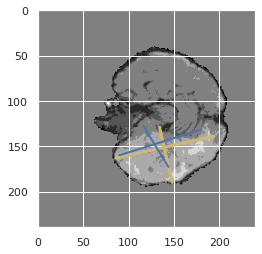

prediction [162.24551  92.90905 130.75537 179.08041 167.03421 141.6508  134.54012
 121.40312]


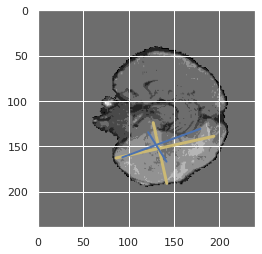

prediction [164.03868  94.49516 130.9775  170.32951 170.52747 135.61629 131.5222
 114.88673]


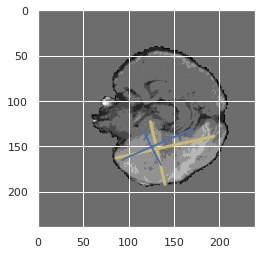

prediction [165.27895  95.86138 128.35486 174.14792 169.36436 134.96056 133.02507
 116.52202]


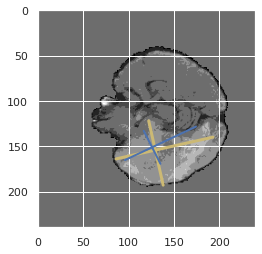

prediction [164.2665    96.36536  127.631714 173.66362  171.41486  133.4822
 132.0188   116.03433 ]


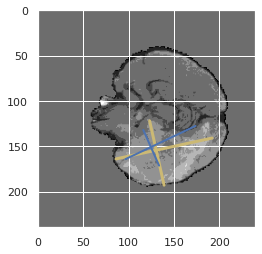

prediction [159.64293   97.08849  128.05763  172.35786  172.47874  131.83253
 129.69531  116.395386]


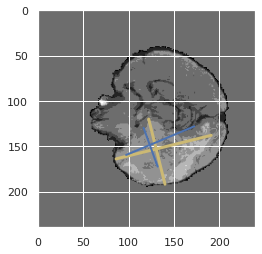

prediction [154.23187   93.884514 123.78292  168.80408  170.53766  125.29034
 128.21591  116.28202 ]


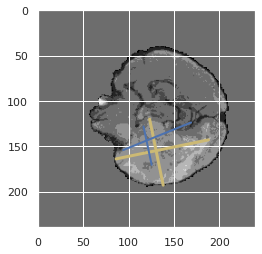

prediction [145.02502   85.045    132.51984  172.29164  182.74881  124.36711
 113.57665  111.896576]


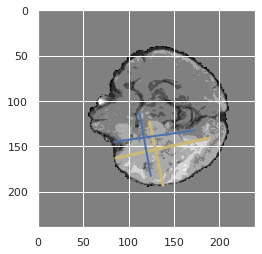

prediction [144.7221    82.63165  132.56192  170.93735  182.4783   124.456764
 115.57156  110.27761 ]


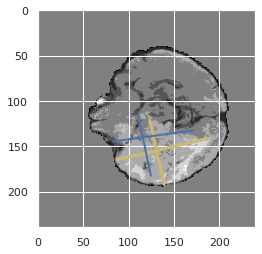

prediction [143.70274   78.258224 136.13913  172.11958  185.94954  121.04679
 110.65418  106.39193 ]


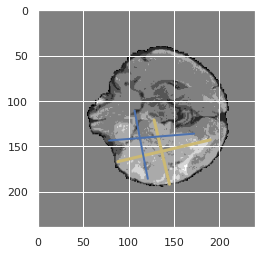

prediction [139.47705  75.77636 137.62807 176.60616 187.83098 122.41113 109.41702
 108.42782]


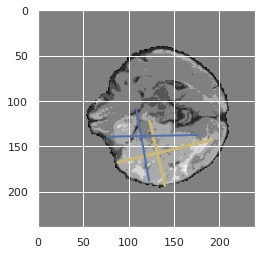

[0.5856795624873405, 0.6022105615719548, 0.5836540638442381, 0.4536352258504949, 0.3899130434782609, 0.44863883847549907, 0.4550688360450563, 0.4183879093198992, 0.5194412986032465, 0.44290527892175213, 0.3779478948018274, 0.37721549932771054, 0.4325677986806743, 0.4488099735549679, 0.5220551996057171, 0.45329737680804116]
prediction [142.07948   74.086136 136.98944  177.53217  178.71147  120.13333
 115.03611  109.118614]


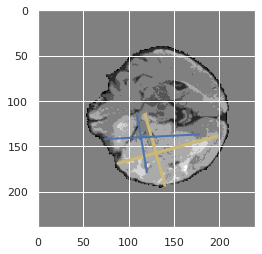

prediction [144.68875   78.597015 137.5181   175.04266  176.36655  120.97103
 118.968735 116.75044 ]


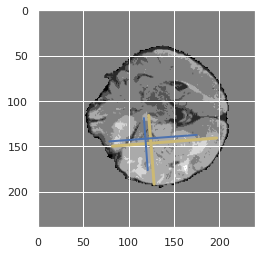

prediction [146.79082  79.63657 136.54099 173.8773  177.19836 117.66593 121.60642
 114.59184]


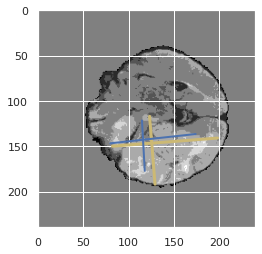

prediction [144.06714   78.30152  134.87396  168.3238   170.84642  112.857445
 124.66285  113.47977 ]


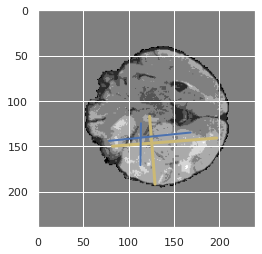

prediction [137.62495   74.761566 138.77919  161.65462  167.31839  104.73199
 124.777565 112.50561 ]


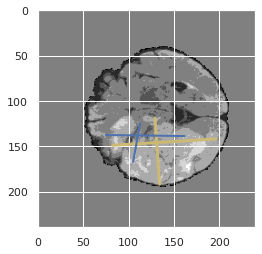

prediction [131.97577   74.40079  141.6097   158.97543  167.19794  102.749405
 119.25145  111.1144  ]


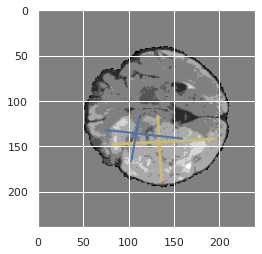

prediction [130.46738   74.16494  137.24138  160.94241  163.67819  101.48522
 119.710396 110.60689 ]


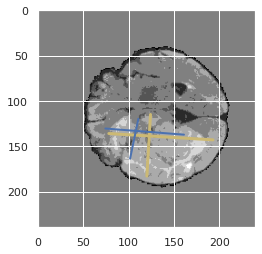

prediction [132.55258  76.63443 137.1164  167.30476 161.66118 106.26248 124.18023
 112.69123]


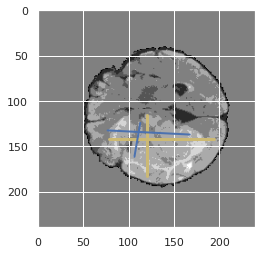

prediction [135.04497  78.09708 138.37228 172.37839 167.37239 111.37195 123.54943
 114.81869]


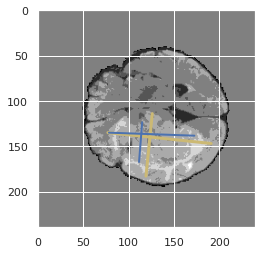

prediction [138.77966  80.0431  142.16866 177.69853 166.48146 120.77766 130.08626
 120.77   ]


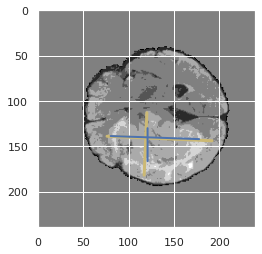

prediction [141.35223   80.29551  138.27576  177.76216  162.59433  123.15257
 131.18948  122.862656]


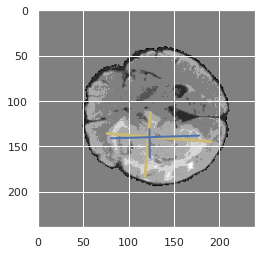

prediction [149.04237   79.7988   134.11778  178.7      163.5274   129.20079
 133.13683  123.905334]


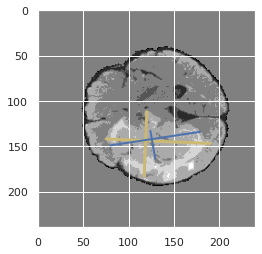

prediction [151.73907   77.25739  134.80696  178.41945  166.92319  134.33784
 133.09541  127.246124]


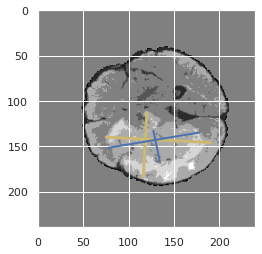

prediction [151.96892  75.56736 136.8839  179.43983 167.66008 134.52498 134.3096
 127.69698]


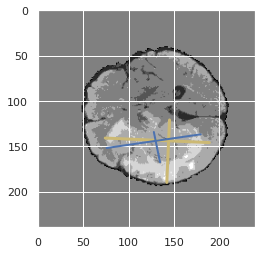

prediction [148.77615  69.92313 134.84854 178.99455 169.84268 135.73148 131.23947
 124.94561]


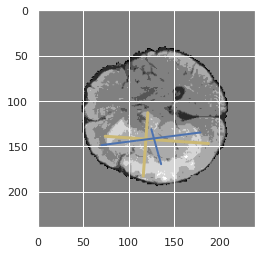

prediction [149.14471  66.90511 131.04962 175.01917 164.6755  134.1445  130.87236
 121.31783]


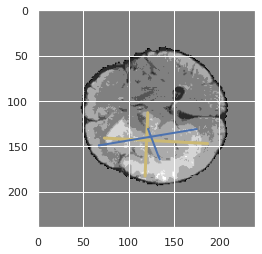

[0.4517976843388178, 0.47953913388955105, 0.3831402317219337, 0.4855004677268475, 0.46641231775446246, 0.2680529839054266, 0.1891121561921049, 0.19991570665917394, 0.23577352016013725, 0.34201568743525235, 0.30303907380607814, 0.3297779076563413, 0.41603401153962954, 0.26900763358778623, 0.41290215035839306, 0.5105946684894054]
prediction [148.24832   60.630795 127.90093  173.2783   162.79427  131.15659
 128.67932  116.395226]


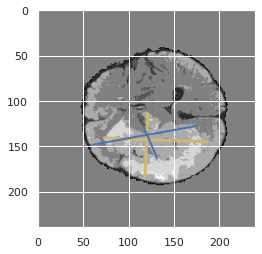

prediction [148.89253  71.03022 140.51947 177.99306 168.55003 132.16682 135.00182
 121.86121]


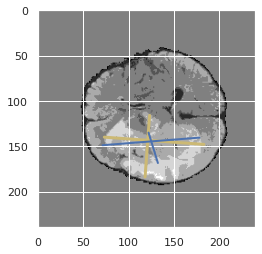

prediction [149.82349  72.4123  138.43181 175.59108 164.71638 129.09552 137.46484
 122.68095]


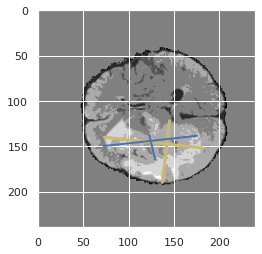

prediction [148.36566   71.24659  138.2602   174.89752  168.33813  125.88412
 133.68063  119.810165]


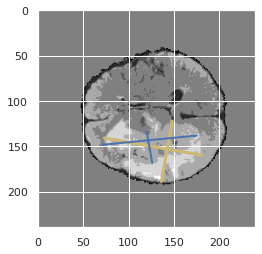

prediction [145.37146  72.35669 136.59258 175.37793 165.94102 121.44403 132.58386
 120.93875]


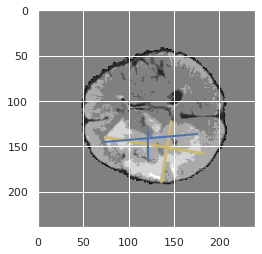

prediction [144.65295   78.17659  135.03694  171.00003  158.31258  119.913704
 137.21358  125.83459 ]


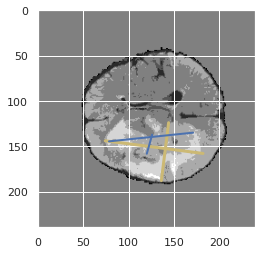

prediction [147.29135  78.43347 135.93474 168.16777 156.27304 117.62089 140.52214
 123.81935]


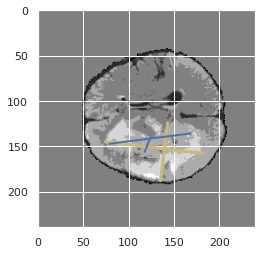

prediction [146.95761   80.791954 131.38217  168.62831  156.024    114.73955
 138.5523   122.6208  ]


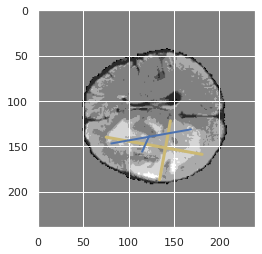

prediction [145.21017   78.99239  130.47232  169.66377  156.43492  114.911026
 138.63399  120.79318 ]


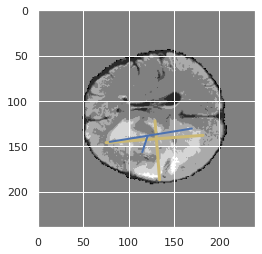

prediction [142.31007   79.131096 129.68471  169.68869  158.17302  114.07446
 131.78433  117.43713 ]


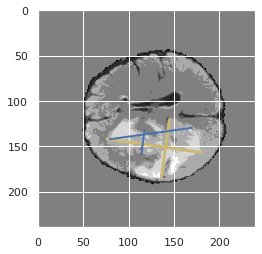

prediction [140.24379   82.68614  131.58563  170.08351  157.22699  117.240074
 132.23387  123.41277 ]


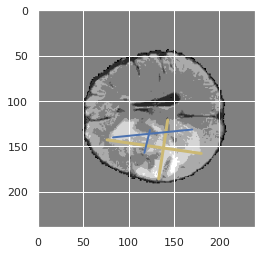

prediction [138.38443  83.78449 132.76187 168.96739 157.97855 116.62695 130.59117
 122.80949]


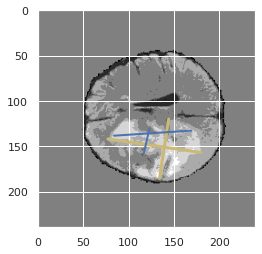

prediction [139.07578   82.25931  134.7958   169.65811  160.89145  119.995766
 129.26622  122.61527 ]


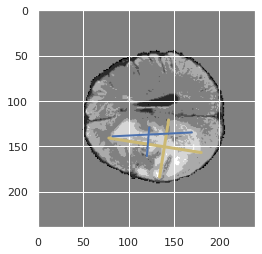

prediction [143.65565  89.40013 136.87733 173.6644  160.46744 130.45056 139.98955
 137.21918]


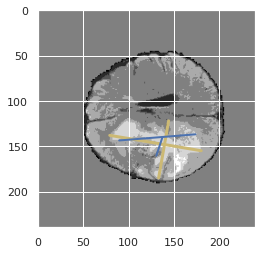

prediction [140.49042  91.3435  147.07504 174.61699 165.42296 134.86871 136.2077
 143.62967]


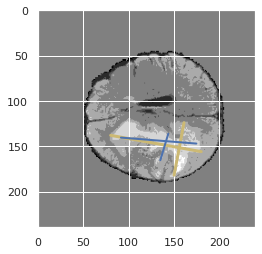

prediction [138.31096  95.29445 145.50098 170.2019  168.3994  131.66809 128.87047
 144.68977]


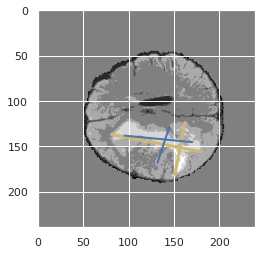

[0.7474801061007957, 0.38409172339663206, 0.2485160269093787, 0.1912677304964539, 0.15218522372528617, 0.1188430698739977, 0.042367788461538464, 0.061839154117270104, 0.039676425269645606, 0.09507042253521127, 0.4635416666666667, 0.0, 0.05343511450381679, 0, 0.0, 0.0]
prediction [140.72069  93.21042 150.41815 173.47966 176.3833  135.54793 124.64493
 143.51804]


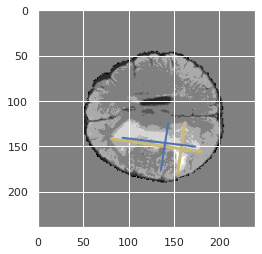

prediction [153.00607  96.55655 141.76294 158.53534 171.68059 127.79249 126.55311
 136.96988]


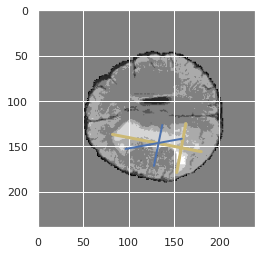

prediction [160.99872  99.76477 138.56796 156.01086 167.04156 127.41398 134.59969
 139.15298]


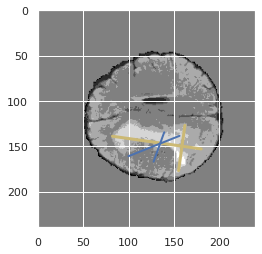

prediction [160.49152   98.780136 138.03897  152.11806  161.843    125.973
 138.71234  137.02841 ]


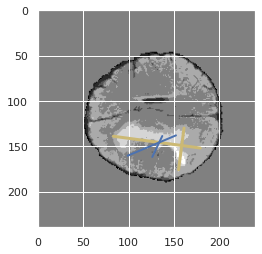

prediction [159.23776 101.46416 137.75398 149.65492 158.23065 125.92212 138.98529
 138.50533]


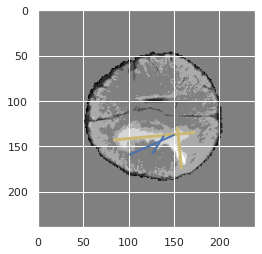

prediction [157.86093 101.05321 135.95355 149.44542 152.67636 127.10804 139.92323
 135.36362]


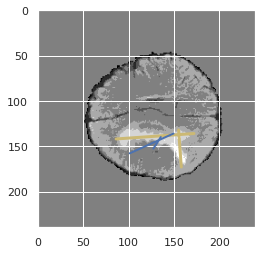

prediction [158.81252   98.144775 133.74442  146.0871   146.6085   126.65263
 141.7075   133.56157 ]


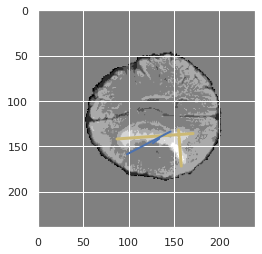

prediction [155.82483  95.54508 132.8556  147.06392 142.27896 126.9236  142.97849
 132.14374]


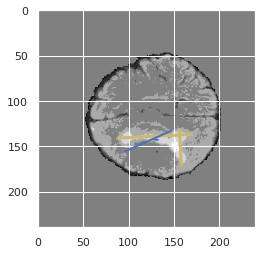

prediction [152.03477  96.38488 134.57614 157.53754 140.6795  133.30255 142.81973
 131.87831]


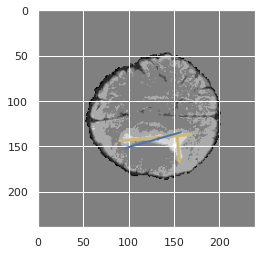

prediction [155.71683 115.82138 141.39644 175.20836 146.65338 142.4575  149.83044
 147.89008]


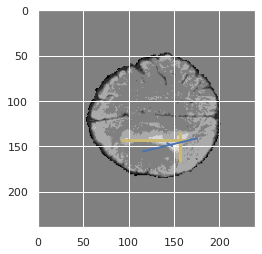

prediction [146.85107 117.04075 137.1424  165.2346  149.66573 145.62405 137.65361
 142.52798]


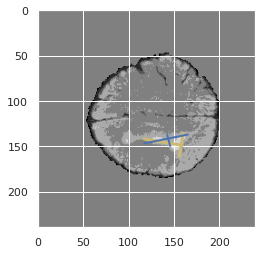

prediction [141.86586 132.95123 141.38493 147.98962 151.02809 138.07787 134.65988
 139.88066]


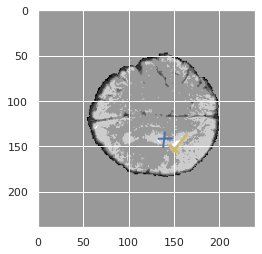

prediction [136.98868 145.32195 131.25285 157.4686  144.43971 147.35059 126.12779
 146.96466]


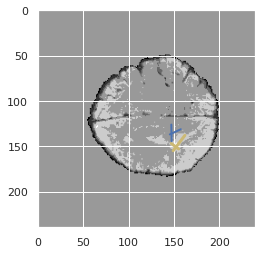

prediction [0.44891518 1.9077215  1.6138103  1.9097955  2.5210376  3.1093078
 0.28052074 1.7937509 ]


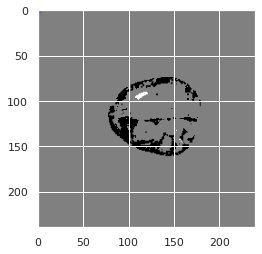

prediction [112.541115  61.467297 131.02629  117.91665  136.2026    86.21206
  96.79128  101.46935 ]


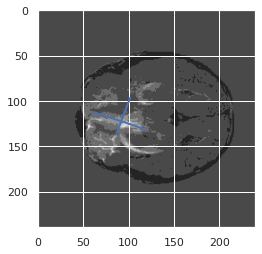

prediction [108.08769   56.404316 135.33017  120.01718  132.4267    86.45154
 103.15943   97.75043 ]


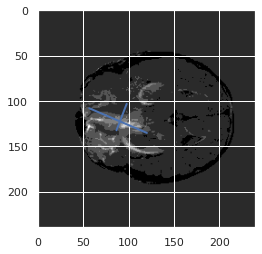

[0.0, 0.0, 0.1031434184675835, 0.0, 0.0, 0.21933085501858737, 0.34049586776859503, 0.174512987012987, 0.15889029003783103, 0.13614311704063067, 0.16007140731925024, 0.1762152777777778, 0.15594660194174756, 0.2561675272518646, 0.3075634942785375, 0.26389584376564845]
prediction [108.89223   61.311405 134.442    126.62744  130.54521   94.632774
 106.15546  100.04336 ]


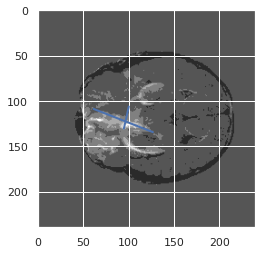

prediction [ 95.44606   59.641197 119.233665 123.905495 116.08287   87.530655
  91.08806   97.16498 ]


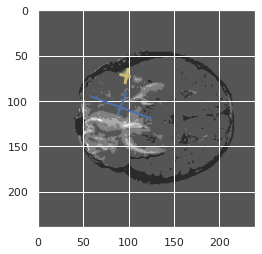

prediction [ 94.80958   61.179974 115.46814  119.08131  108.90765   86.16366
  98.21644  104.34015 ]


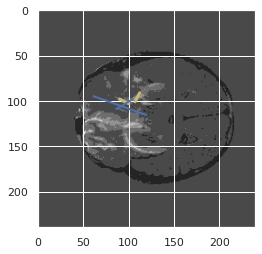

prediction [ 94.068344  59.458668 115.79274  114.42338  109.76642   82.667984
  93.07463  102.47778 ]


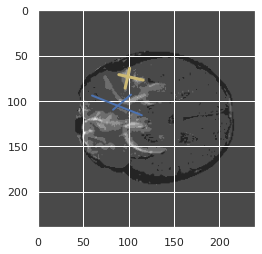

prediction [102.68775   62.400555 113.6604   115.299225 113.29215   81.94476
  96.37784   97.77636 ]


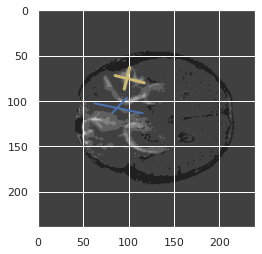

prediction [ 92.651024  64.549515 100.115456 109.98133  106.473976  74.296425
  91.026184  93.30434 ]


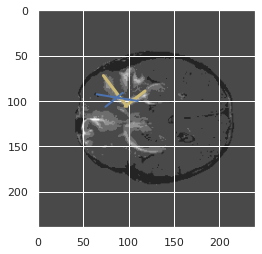

prediction [ 92.41137   68.71837   90.53005  112.37693  109.74724   78.808266
  83.86773   94.12096 ]


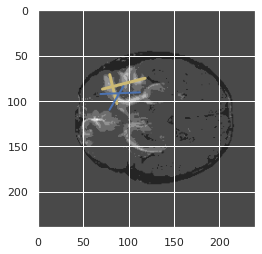

prediction [ 90.75539   74.694374  85.54801  113.94112  100.222786  82.236595
  87.63096  101.95477 ]


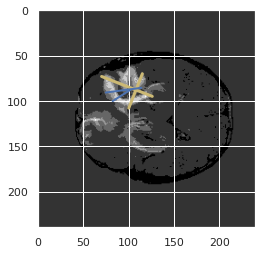

prediction [ 89.21078   81.88359   76.79772  117.67283   87.45797   83.130196
  93.049    106.56705 ]


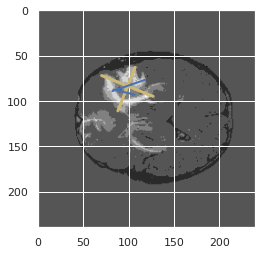

prediction [ 92.87997   83.39948   79.01227  124.15109  101.899864  88.937515
  81.30192  106.05521 ]


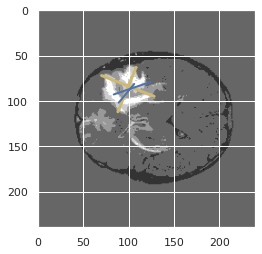

prediction [ 97.563614  83.37432   78.568375 123.03541  105.61104   84.56956
  80.22281  101.47039 ]


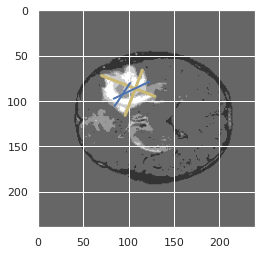

prediction [ 98.76787   79.39257   76.94174  121.04292  105.87519   79.62548
  80.21024   95.715805]


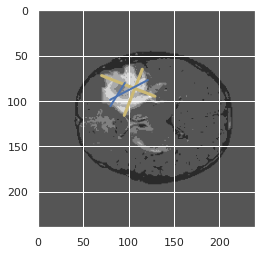

prediction [102.55404   78.58025   77.45994  120.30088  106.91833   80.31883
  82.944534  95.66298 ]


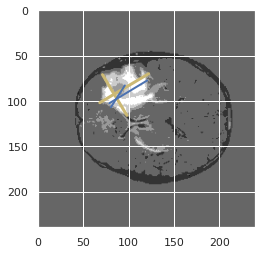

prediction [101.44774  76.64259  80.69735 125.3729  109.80163  83.15574  83.48492
  94.42822]


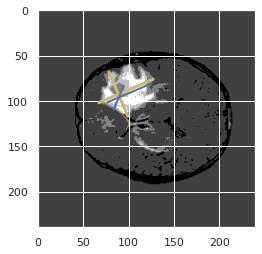

prediction [102.048134  75.14431   81.57884  129.43129  111.07251   87.21045
  85.11743   95.741875]


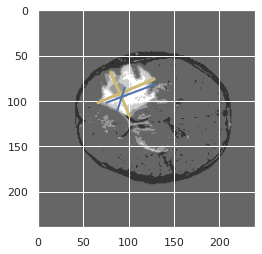

prediction [102.56234  76.14163  81.85976 131.13235 110.71732  89.25291  86.18003
  97.69674]


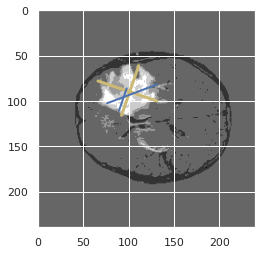

[0.1362862010221465, 0.2605932203389831, 0.3432343234323432, 0.364344746162928, 0.34830699774266366, 0.2655295851758265, 0.25376832541812927, 0.24551638837353124, 0.2811461794019934, 0.20797011207970112, 0.19185923256306975, 0.24326059050064186, 0.2606304209858261, 0.35604770017035775, 0.41887031944150627, 0.3969385615433005]
prediction [105.03623   77.80742   75.22287  129.20074  106.85787   89.749855
  88.127945 101.19772 ]


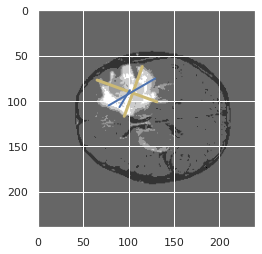

prediction [102.148094  75.81857   74.69793  128.32466  115.28864   89.553925
  80.96516  101.7101  ]


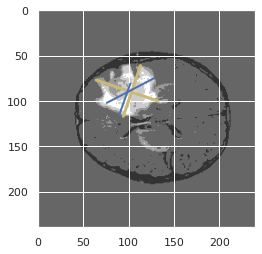

prediction [100.16727   73.40583   74.08833  129.02888  117.70396   90.56406
  79.747505 100.98325 ]


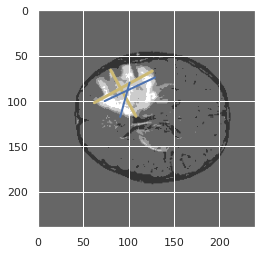

prediction [100.97786   72.325195  75.00873  130.02081  119.228905  89.96002
  80.4318   101.343864]


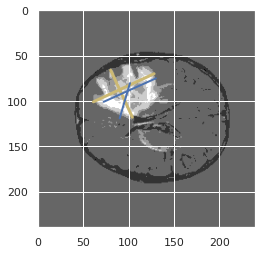

prediction [100.878746  70.49938   71.689766 131.20341  116.84087   88.86462
  79.58356  100.67186 ]


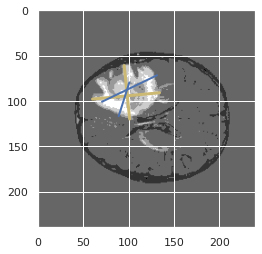

prediction [101.62838   70.16862   71.03378  132.09805  111.100525  89.75765
  82.36566  102.119194]


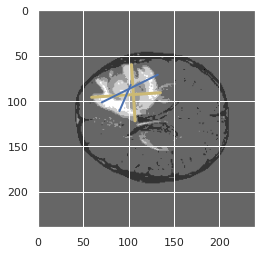

prediction [103.84468   70.624954  71.697075 131.91153  110.91358   92.60737
  82.82945  104.442444]


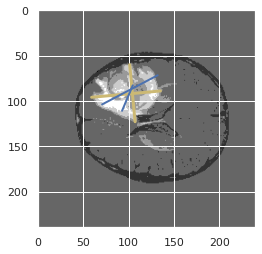

prediction [107.632385  70.99755   70.354095 133.73434  112.24717   93.26867
  84.547325 104.832565]


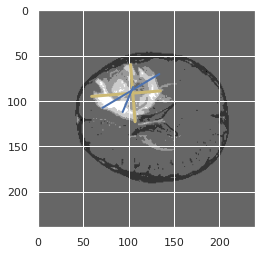

prediction [107.553535  69.78303   73.01737  130.83942  115.554306  91.82112
  84.25922  102.088875]


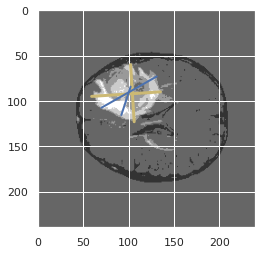

prediction [110.87109   71.120636  70.08156  126.93199  115.727486  87.48004
  85.287125  99.92213 ]


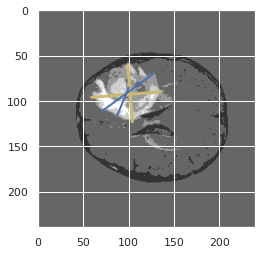

prediction [114.96166   72.30704   74.05214  125.212845 117.801796  83.61556
  86.87791   96.82358 ]


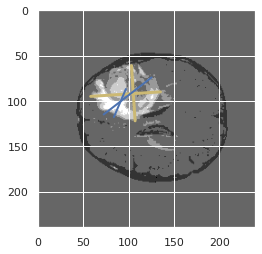

prediction [116.94071   75.41768   78.18534  125.951164 126.10704   86.21907
  83.706665  99.763855]


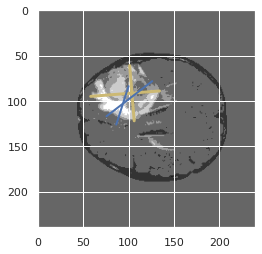

prediction [115.39531   75.66887   80.216736 126.8507   127.322525  85.821335
  83.18808   99.659874]


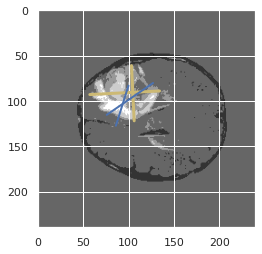

prediction [110.53365   72.725044  83.14197  127.20679  129.8139    84.33541
  79.74595   95.19939 ]


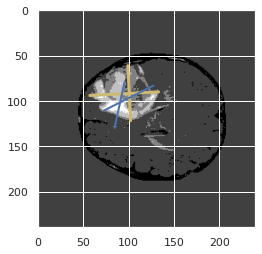

prediction [110.053986  71.890915  84.00401  128.508    134.33614   84.513405
  74.986565  94.1931  ]


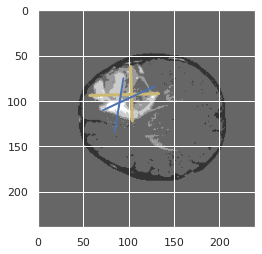

prediction [110.01161   73.81143   82.043724 128.77357  136.30869   85.21348
  72.31402   97.46251 ]


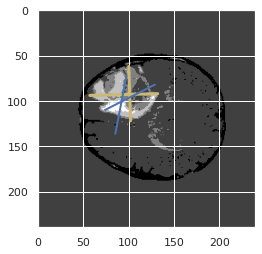

[0.36152535151256926, 0.351423487544484, 0.3452513966480447, 0.37566489361702127, 0.3893321176202416, 0.40832123850991775, 0.3416260579635804, 0.21899736147757257, 0.10965986394557824, 0.10287610619469026, 0.09055447199777096, 0.12557736720554272, 0.16151603498542275, 0.22715173025732033, 0.27663061291379876, 0.43633333333333335]
prediction [108.79427   76.27752   81.29909  127.21259  137.90887   86.557205
  68.15433  100.19907 ]


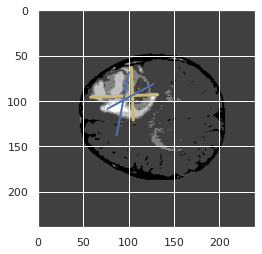

prediction [107.29651   75.545975  78.37552  123.52868  134.57886   86.398186
  65.91322  102.34508 ]


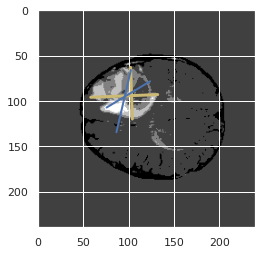

prediction [106.441536  76.01883   83.05305  122.01311  132.97807   85.05436
  66.63471  104.1394  ]


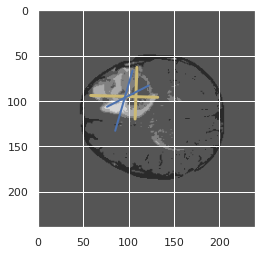

prediction [105.1915    75.343124  87.52626  123.159256 133.69673   85.19096
  68.13178  104.80087 ]


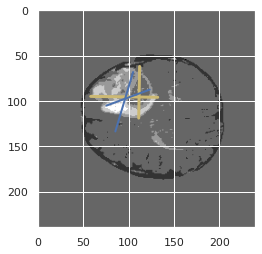

prediction [104.323715  74.966896  89.05503  123.164734 133.36264   86.82949
  69.40932  106.97985 ]


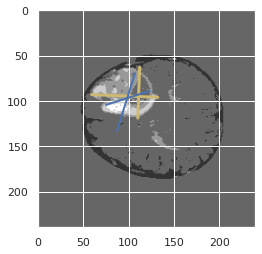

prediction [101.84484   70.9967    89.431435 123.13428  129.87851   87.0903
  71.01406  106.54451 ]


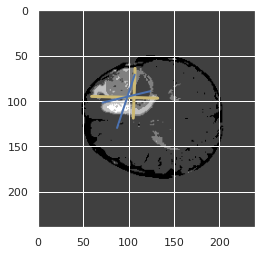

prediction [101.22533   71.51951   87.44634  123.599434 121.18421   90.23146
  75.62813  109.34243 ]


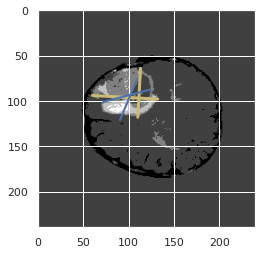

prediction [103.64763   69.32399   86.05716  126.453026 108.53237   88.03357
  86.71685  104.231125]


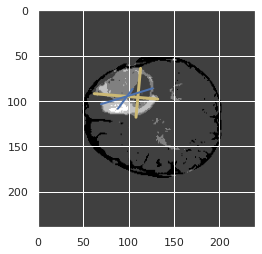

prediction [104.520645  70.61621   82.73506  126.19017  104.09163   88.047325
  89.32316  104.65305 ]


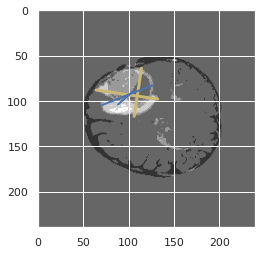

prediction [106.25925   73.11865   82.14004  125.46575   98.49689   85.952896
  97.309814 105.32907 ]


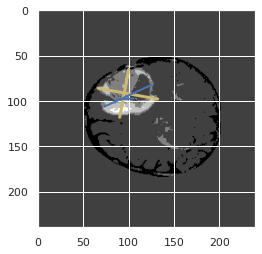

prediction [105.3789    72.03984   82.91508  127.945526 101.44697   86.676414
  98.21367  104.05695 ]


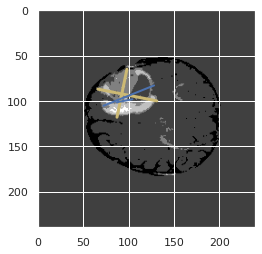

prediction [102.86072   71.721886  85.351425 127.22961  105.03442   87.64719
  93.17919  103.20042 ]


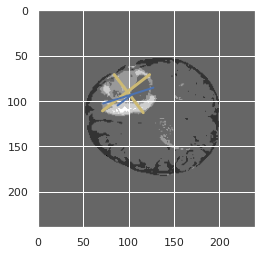

prediction [104.16043   72.87986   85.14461  127.0976   107.659454  87.89047
  90.63177  103.003265]


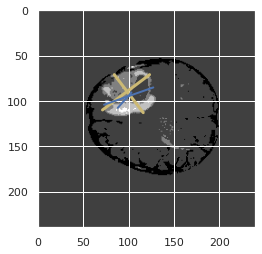

prediction [105.22081   74.14058   84.983505 126.97167  110.69012   88.12741
  86.916664 104.2207  ]


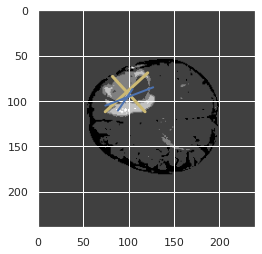

prediction [106.43112   72.59018   86.77747  125.711754 112.70371   87.03429
  86.51048  104.27267 ]


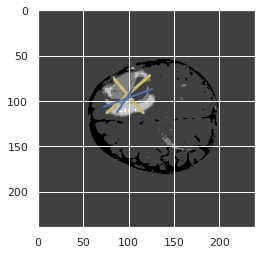

prediction [104.42477   71.86006   90.8724   126.55253  117.19092   88.58694
  81.32089  104.296776]


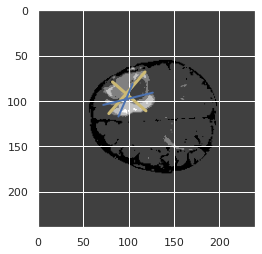

[0.5410863509749304, 0.5787965616045845, 0.6802230239422762, 0.7193468884781269, 0.658323852863102, 0.634083364072298, 0.6044511886697016, 0.366436203645506, 0.3870307167235495, 0.43130990415335463, 0.41300813008130083, 0.4506517690875233, 0.3486547085201794, 0.7690763052208835, 0.6614173228346457, 0.4573643410852713]
prediction [103.3218    71.797195  94.271126 126.61006  122.880714  91.15859
  76.74569  104.37569 ]


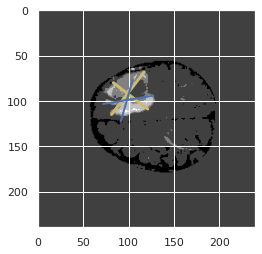

prediction [103.10073   72.05747   99.05576  126.68954  124.36898   93.354805
  76.55607  104.74934 ]


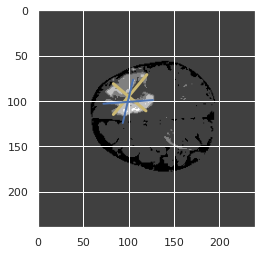

prediction [100.230576  72.63154  106.325356 127.35972  127.283485  93.45386
  75.74219  102.05844 ]


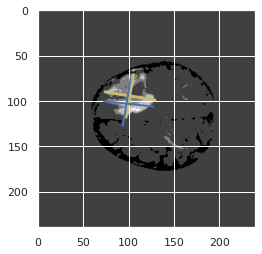

prediction [ 98.95508   74.18355  104.53293  126.28195  130.21663   93.60361
  69.945206 101.39942 ]


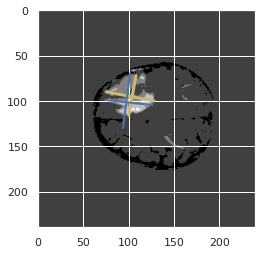

prediction [101.19002   75.59607  102.52189  128.16483  123.09092   97.66155
  81.480156 104.950676]


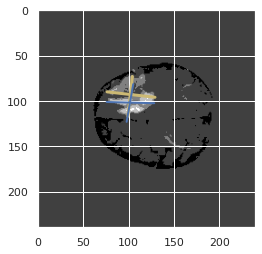

prediction [ 98.48878  77.04141  99.92078 127.85382 125.91715 101.06733  80.09106
 104.43235]


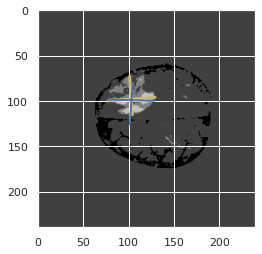

prediction [ 99.7604    80.099884  97.825905 128.47322  115.67511  104.87311
  88.15741  113.09469 ]


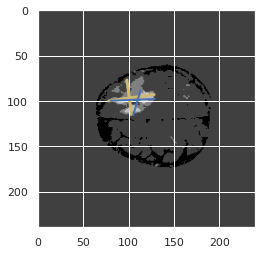

prediction [ 97.65189  83.11793  98.71594 131.21967 107.54696 109.37282  93.68255
 119.65017]


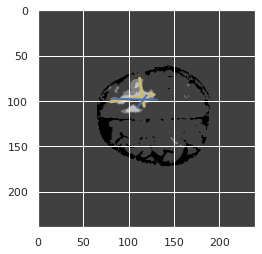

prediction [ 92.74912   83.66996   97.641136 132.73572  100.62915  111.43395
  88.62309  117.708206]


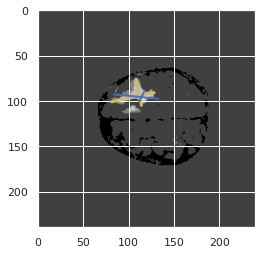

prediction [ 90.75757   86.71273   98.476456 131.58412   96.86323  111.55341
  84.363815 117.093155]


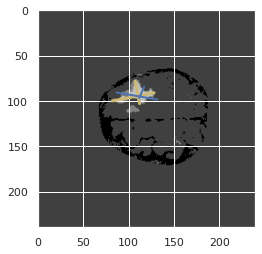

prediction [ 90.33704   91.21598   98.98094  129.08478   96.77102  113.49162
  84.18385  122.047134]


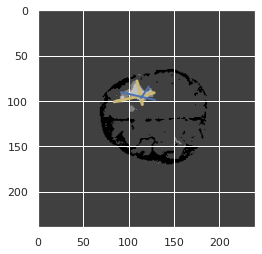

prediction [ 88.43805   97.38455   96.800545 121.90783   99.93982  112.07913
  79.797745 124.48643 ]


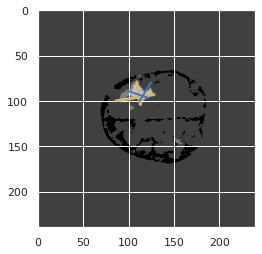

prediction [ 90.16291  100.997505  91.06065  121.696655  99.990746 109.267914
  77.9396   121.178024]


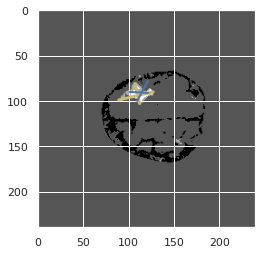

prediction [ 91.0053    98.2681    92.24879  126.044785  99.01344  106.98373
  80.34369  116.56167 ]


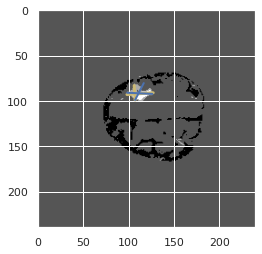

prediction [ 92.173775  96.726776  95.23893  125.54874   98.9824   108.40558
  84.45361  115.81009 ]


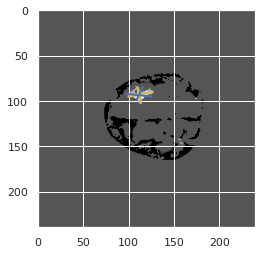

prediction [ 95.52393  100.54669   91.43614  125.08622   95.50965  111.751015
  88.88242  117.68601 ]


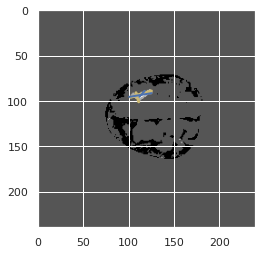

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.3662551440329218, 0.4360020397756247, 0.48064637354378054, 0.2763963963963964, 0.26666666666666666, 0.12828438948995363, 0.17334049986562752, 0.20639857809375695, 0.2921842155551309]
prediction [ 94.93488  109.89141   86.87993  122.531845  95.137474 114.68889
  87.16959  118.721466]


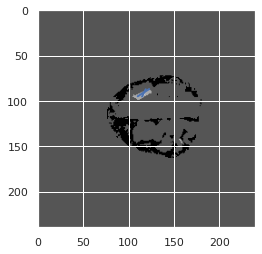

prediction [10.672645 17.507896 11.821322 13.688872 15.187771 12.248289  8.69871
 15.999208]


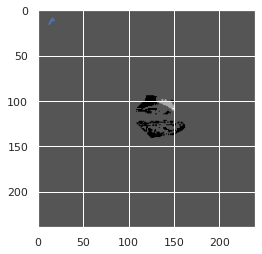

prediction [153.44627 148.80618 145.18044 190.77824 161.32706 170.88535 144.25893
 174.07376]


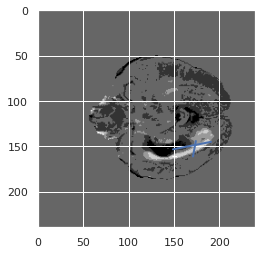

prediction [151.77632 151.1633  145.3118  189.71205 156.72156 168.84755 144.35909
 172.53772]


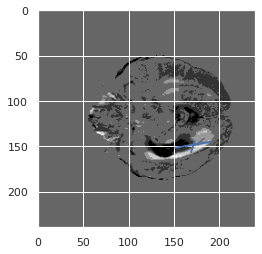

prediction [143.6818  158.32341 122.11083 180.83981 132.36642 162.5686  136.18062
 173.26994]


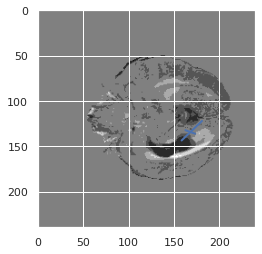

prediction [127.1091   148.33638  100.64373  178.56029  118.598076 163.8099
 114.909485 165.14067 ]


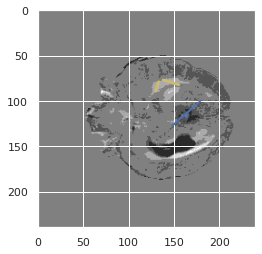

prediction [102.608215 136.97408   91.72078  166.62463  100.78286  148.1793
  97.24383  153.90253 ]


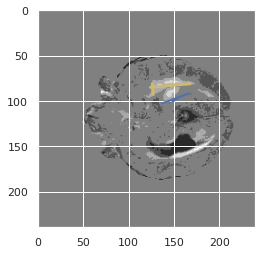

prediction [ 85.62327 130.38318  97.25123 158.53308 104.88716 148.31088  77.39061
 152.37233]


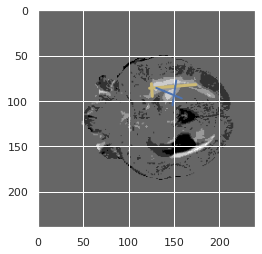

prediction [ 82.28509  125.02381   94.996475 162.27744  100.67143  141.59895
  74.4326   141.95735 ]


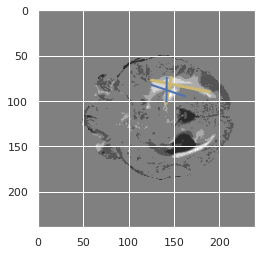

prediction [ 84.082565 120.04436   97.85566  173.86678  101.220634 140.24367
  73.96883  140.52008 ]


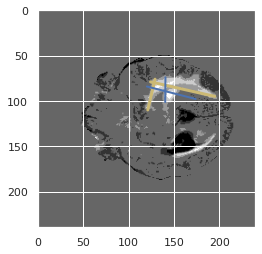

prediction [ 84.86105  118.60265   93.9835   175.10359   93.39513  137.87007
  79.722786 146.66838 ]


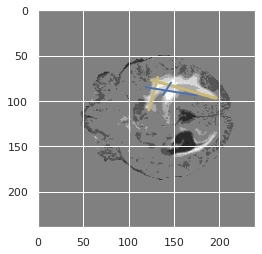

prediction [ 81.97345  113.950294  99.050995 178.85815   92.81592  134.98068
  81.02517  147.12785 ]


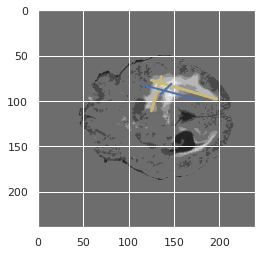

prediction [ 83.175224 109.5204   101.48013  183.46767   85.42242  137.95583
  86.37343  149.14626 ]


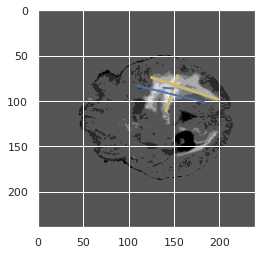

prediction [ 87.00913  113.35058  100.07597  185.35663   82.555435 142.59334
  90.50675  156.15663 ]


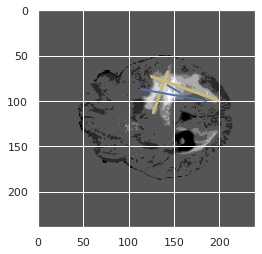

prediction [ 90.09981  114.29694  103.994896 186.49641   82.738754 146.31413
  92.509315 159.09712 ]


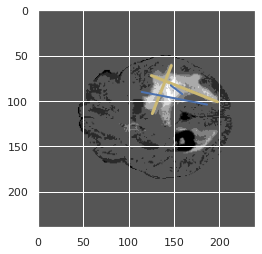

prediction [ 88.76426  113.46008  106.61128  190.64505   78.388336 152.23378
  94.36432  166.2071  ]


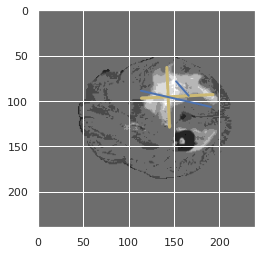

[0.19181265641759027, 0.2548143053645117, 0.2416765252661822, 0.18445968005223637, 0.16467970116038785, 0.15204224258425222, 0.16099258586775608, 0.21497730711043872, 0.3521336914353924, 0.3387239047339018, 0.3028304479252542, 0.09003086005635315, 0.09663641217298452, 0.1723952015096374, 0.1252441088399948, 0.07027235354573484]
prediction [ 93.799904 116.5991   111.21817  191.27773   90.596924 158.12318
  93.91706  173.48828 ]


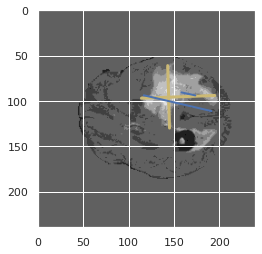

prediction [ 95.363914 115.837944 113.355316 194.00989   97.50414  160.81346
  91.22047  174.35527 ]


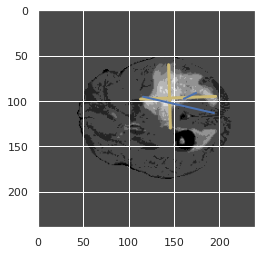

prediction [ 91.90183  116.42622  114.1172   193.00368  101.97786  161.82266
  90.220795 171.13066 ]


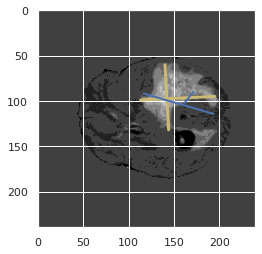

prediction [ 91.34511  120.500755 115.25446  188.9978    98.14834  160.2978
  93.992134 172.03973 ]


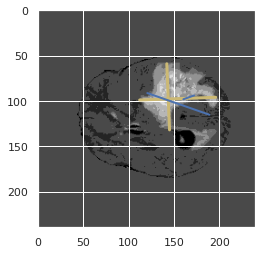

prediction [ 87.42874  119.510475 115.440575 187.57086   93.2128   159.97147
  93.46819  168.78854 ]


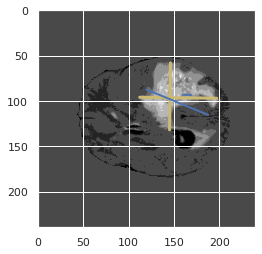

prediction [ 84.86937 115.88883 116.73609 189.75696  90.75297 157.98509  93.82309
 165.95657]


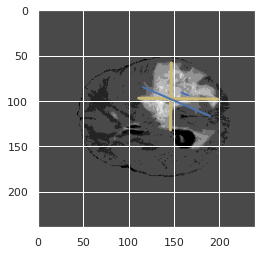

prediction [ 81.407455 113.04431  113.33947  187.22781   96.41836  150.34863
  86.81649  158.05566 ]


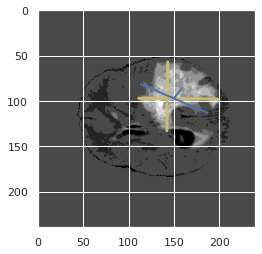

prediction [ 82.49445  111.86792  112.87367  186.73581  100.47906  147.9679
  84.220726 154.72762 ]


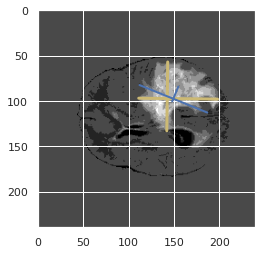

prediction [ 84.955826 110.957825 113.60609  196.82857  107.93417  143.27068
  83.96348  154.45958 ]


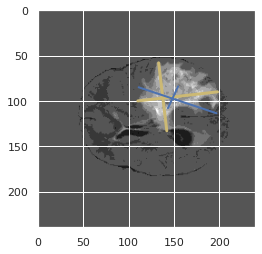

prediction [ 84.68677  107.850945 113.48587  198.06514  107.20255  140.29332
  84.20492  150.086   ]


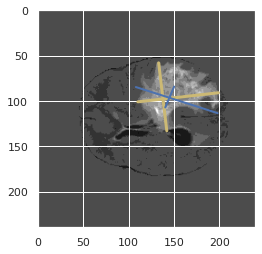

prediction [ 84.31897 109.20051 112.87048 202.3474  108.67664 139.92555  87.14659
 150.8109 ]


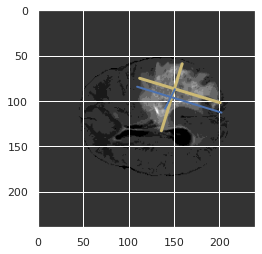

prediction [ 83.81477 110.13453 110.0683  201.1384   98.78422 137.69223  95.97772
 151.64256]


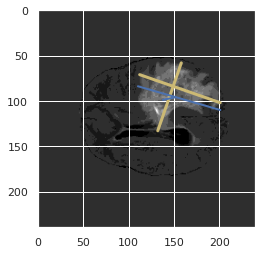

prediction [ 86.70769 112.51798 108.97907 200.89995  91.10201 136.74841 104.00086
 153.83006]


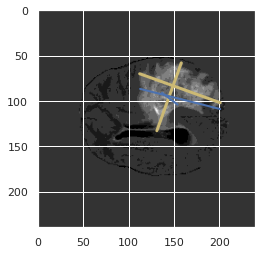

prediction [ 85.02121  113.33184  108.933815 201.8524    85.852806 134.06287
 107.567566 155.62749 ]


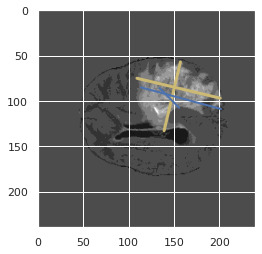

prediction [ 83.269936 110.98301  108.106026 198.6649    85.462685 130.4442
 104.33261  155.17805 ]


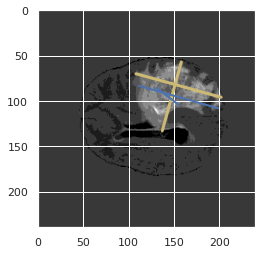

prediction [ 77.03723 110.66851 109.39103 198.64351  89.83836 129.88197  93.49522
 153.67674]


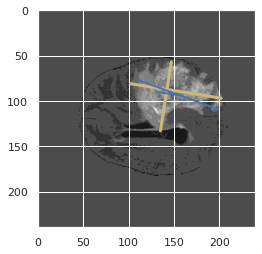

[0.16275679257786613, 0.184472834479854, 0.16398090122351536, 0.0935483870967742, 0.10297305667389285, 0.14079520697167755, 0.10391046013541523, 0.12908564335953662, 0.14115814809571003, 0.18396554119772127, 0.21086085394500484, 0.24134948096885814, 0.3191366072722005, 0.42822198440605413, 0.5077584882470425, 0.668056018672891]
prediction [ 73.32437 114.06709 112.05903 203.50047  93.55814 133.6009   88.34316
 156.13919]


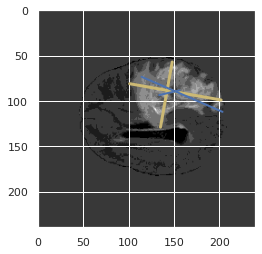

prediction [ 72.39406  115.345634 110.80014  207.54292   93.94456  133.70158
  85.76494  155.1687  ]


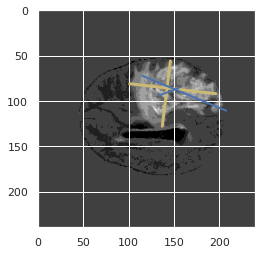

prediction [ 73.68657  109.717964 111.219635 205.88768   90.80149  131.73373
  84.84637  150.17212 ]


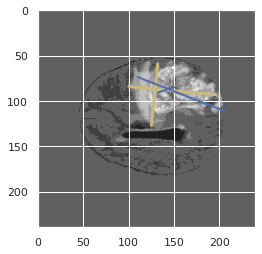

prediction [ 80.08828 103.63321 107.68339 202.3397   87.55476 129.57643  84.16168
 143.91548]


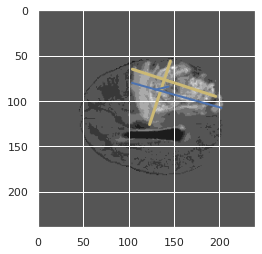

prediction [ 85.03389  104.02331  106.27139  200.41408   84.584694 130.80293
  87.42973  144.48393 ]


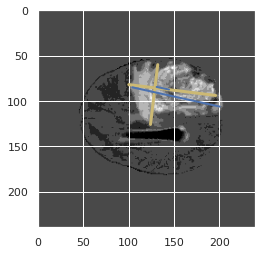

prediction [ 86.822914 104.18902  105.0666   200.82074   91.90373  131.6007
  83.00305  142.9221  ]


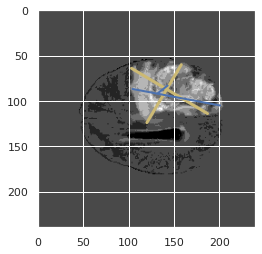

prediction [ 88.59706 103.84398 100.20148 201.61098  89.00864 135.07716  85.83278
 144.36078]


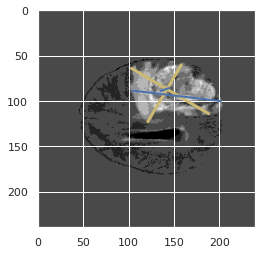

prediction [ 93.17133  103.248375  96.927124 200.03862   88.47447  137.03139
  85.74886  143.71373 ]


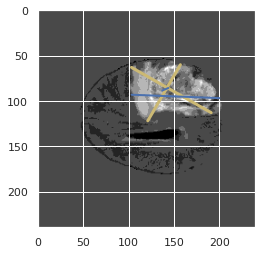

prediction [ 96.10509 104.74452  98.30711 199.26248  89.26461 138.37312  87.24847
 146.22159]


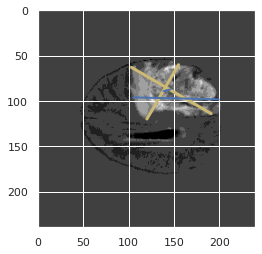

prediction [ 96.85026  105.63869   99.66598  200.06989   91.327286 136.97392
  84.83637  144.34856 ]


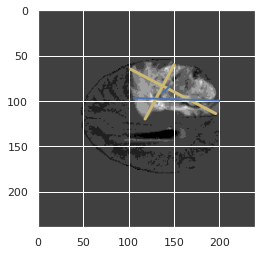

prediction [ 94.712204 105.93661  104.78168  195.66498   93.65956  135.48584
  82.73309  144.70378 ]


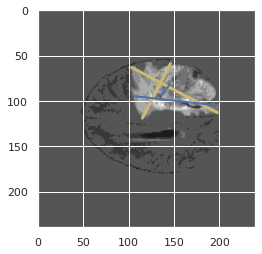

prediction [ 90.50536 106.78025 108.23203 193.29897  96.3267  133.38145  79.35382
 144.45757]


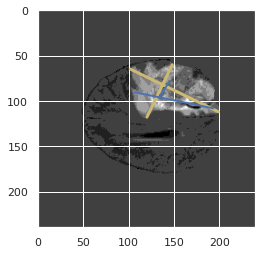

prediction [ 89.00944 107.19571 109.86509 192.26373  99.8052  131.70763  77.06639
 144.42328]


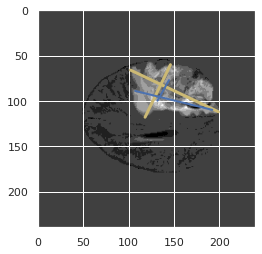

prediction [ 89.86244 106.73253 111.55232 191.53645 102.27926 129.19035  71.82482
 139.17004]


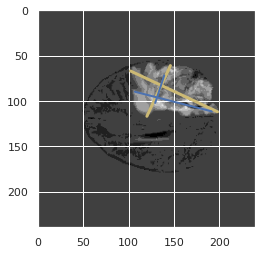

prediction [ 91.132935 107.19843  112.145226 191.4647   105.87437  130.28802
  68.2611   137.95377 ]


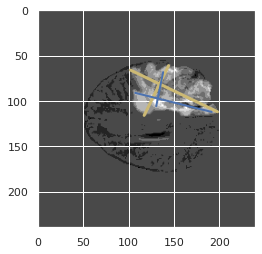

prediction [ 90.27462  108.483215 111.0342   191.67152  110.64201  132.77785
  64.41953  141.6112  ]


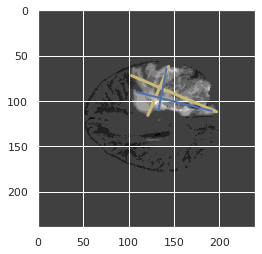

[0.7530864197530864, 0.5697808535178778, 0.48674893789196844, 0.31916568280204644, 0.25055973946672094, 0.16299212598425197, 0.12955812955812956, 0.07983761840324763, 0.16048502139800286, 0.191096901131333, 0.2784313725490196, 0.19086621990568378, 0.13821771888802287, 0.09013785790031813, 0.14886642993717564, 0.16485714285714287]
prediction [ 90.35601  107.894615 113.222084 195.14055  110.858665 134.99895
  66.85159  144.49007 ]


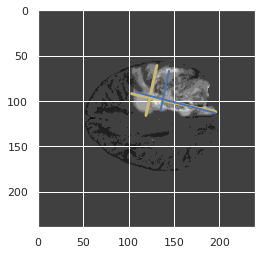

prediction [ 93.32436  105.46536  112.94499  194.40257  104.13661  132.60709
  73.089096 142.88554 ]


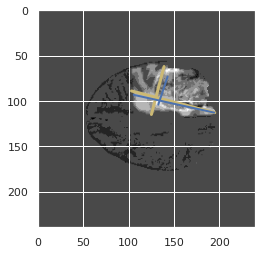

prediction [ 94.984634 103.71292  110.87575  192.7955   100.94544  131.42369
  76.097496 142.91214 ]


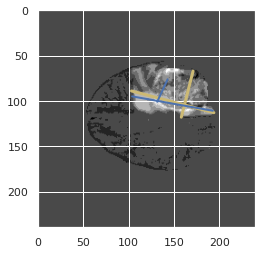

prediction [ 94.74458 104.69743 107.39834 185.62659  98.29257 131.37968  81.89005
 146.99442]


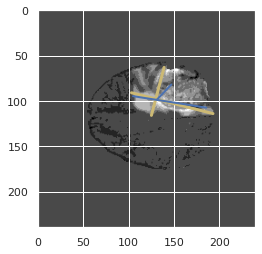

prediction [ 98.18636 106.62316 108.56775 178.17229  97.58513 131.13542  88.00758
 149.58763]


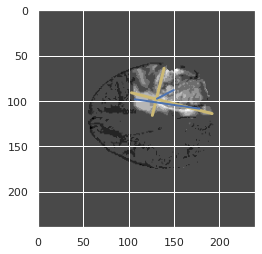

prediction [104.44689  108.34839  107.052925 176.57004   96.007416 132.74394
  93.93656  150.07877 ]


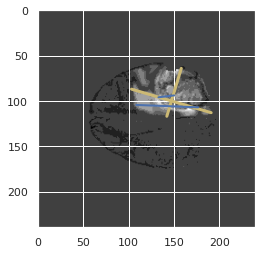

prediction [102.33109  110.178856 103.029854 171.24011   93.25895  135.48592
 100.636826 151.49939 ]


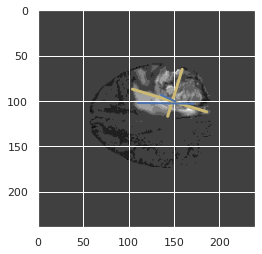

prediction [ 98.85543  109.55319  105.320885 176.92273   96.36359  138.07118
  97.99581  150.37218 ]


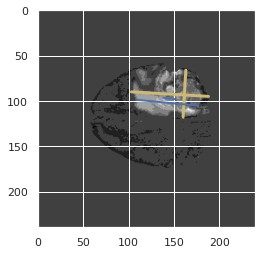

prediction [100.34716 110.14182 108.2585  182.0051   94.59337 138.84872 101.88889
 148.6963 ]


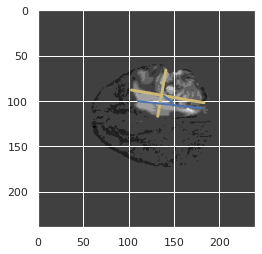

prediction [101.17784  108.90627  105.268814 177.84726   92.18531  136.12466
 101.24172  147.15602 ]


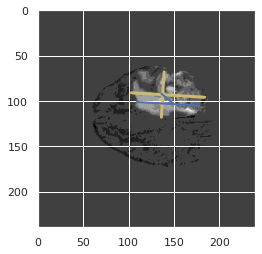

prediction [105.04086  112.18303  107.255646 179.82132   90.31245  136.35117
 105.81479  148.09189 ]


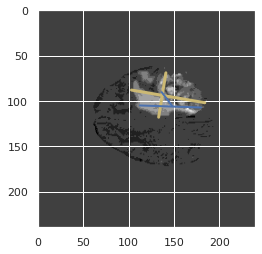

prediction [102.08983  111.273056 107.9991   181.35422   93.89492  135.64206
  97.16331  144.061   ]


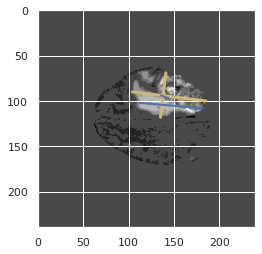

prediction [ 99.59585 111.27052 107.90037 183.65456  95.75462 137.93037  97.00011
 142.3769 ]


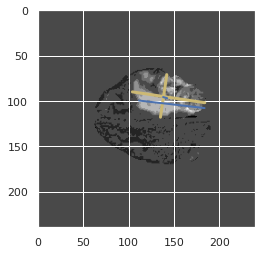

prediction [ 98.634415 107.9559   108.19473  184.84277   97.74328  135.63255
 100.7627   140.5682  ]


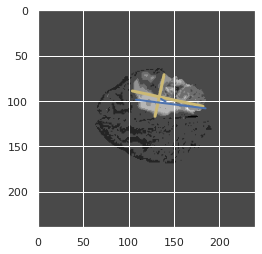

prediction [ 97.835236 107.96053  109.35923  187.46854   95.363686 138.33716
 102.14116  145.3334  ]


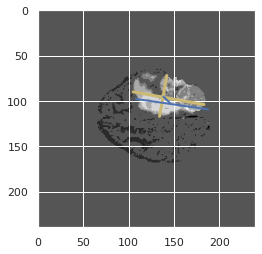

prediction [ 97.230995 104.77716  109.60571  187.67386   95.135475 138.28336
 100.49871  145.1296  ]


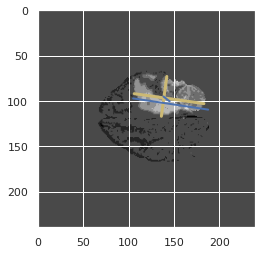

[0.1379632513235752, 0.21040424121935056, 0.36268343815513626, 0.37147811009969656, 0.3537477148080439, 0.1979421852033317, 0.22399527186761228, 0.1396125584502338, 0.7098692033293698, 0.39312267657992567, 0.3925619834710744, 0.5437352245862884, 0.2, 0.1391941391941392, 0.27335640138408307, 0.1518987341772152]
prediction [ 97.572945 103.37801  109.404    187.11678   97.08816  139.9119
  98.45192  146.18092 ]


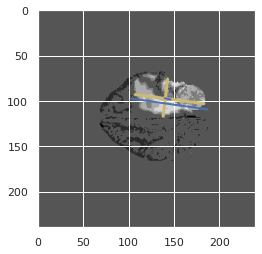

prediction [ 97.26449  100.99439  107.95592  182.81909  100.754585 141.41447
  94.79348  145.72647 ]


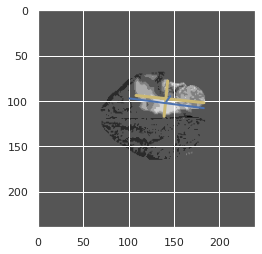

prediction [ 93.81677  101.8627   106.02921  175.89656  104.07471  144.99167
  89.140884 148.24828 ]


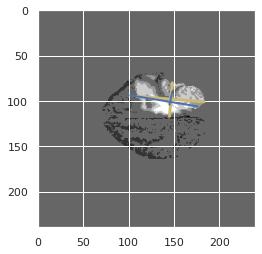

prediction [ 95.809235 104.337364 101.36027  175.11644  101.33325  148.19048
  88.71236  150.19995 ]


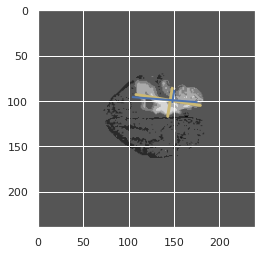

prediction [ 97.68722  104.548645 101.345345 174.5568   101.75836  147.85037
  90.20503  147.69196 ]


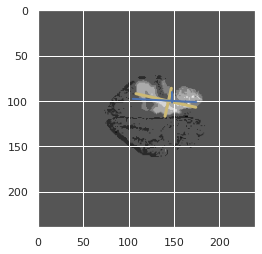

prediction [100.963524 106.09948   98.1402   170.13776  100.16478  146.56401
  93.875145 146.72125 ]


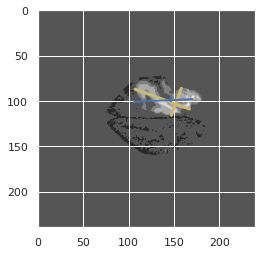

prediction [ 98.83826  109.60108   96.070145 166.28789   99.90668  144.09595
  92.84646  147.14503 ]


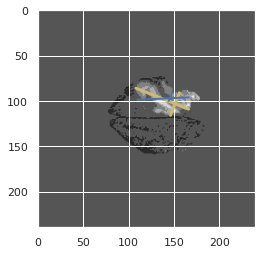

prediction [ 91.85535  114.41546  105.325905 154.59537  101.42456  135.03922
  99.01995  143.85776 ]


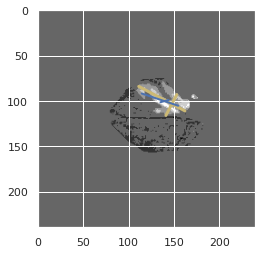

prediction [ 82.89821  118.79885  113.641304 153.98256  109.073456 133.08743
  96.69974  145.88382 ]


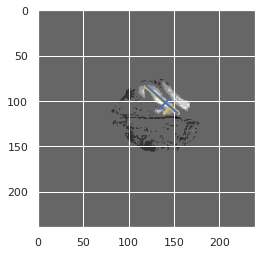

prediction [ 84.10042 131.24373 116.00186 154.14037 113.80199 136.00732  94.16211
 154.79494]


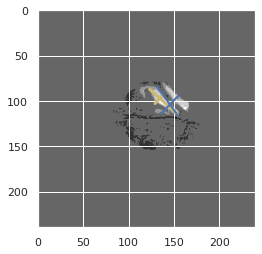

prediction [ 88.677666 134.11053  110.271904 146.3584   107.43969  132.07596
  96.35924  152.56415 ]


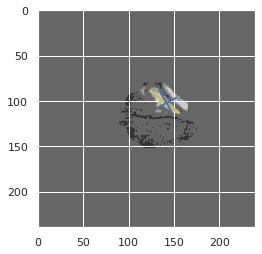

prediction [ 91.31161  128.14536  109.17098  142.18784  103.00315  131.95184
 101.421074 147.12741 ]


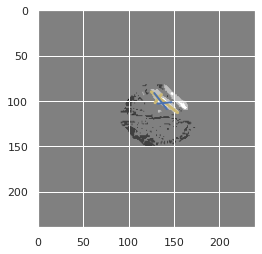

prediction [ 96.888405 128.28822  106.64035  140.01941  100.421364 132.55687
 104.81217  143.98805 ]


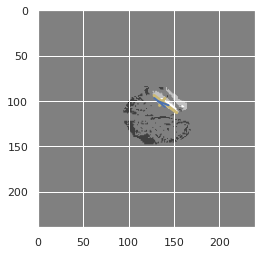

prediction [102.19637 133.16016 103.88365 140.48459 106.82666 134.89847 104.33151
 143.90373]


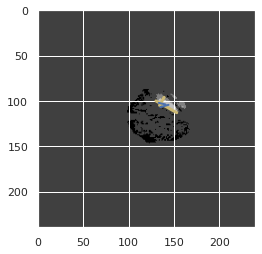

prediction [101.27759  129.18312  104.118935 143.67233  107.59129  136.8046
  99.9056   142.9591  ]


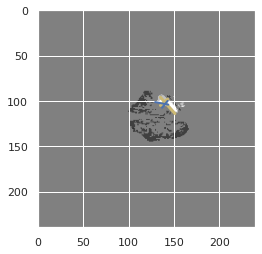

prediction [104.44044 130.96248  99.78941 133.68333 106.89165 134.80223  96.79476
 139.62885]


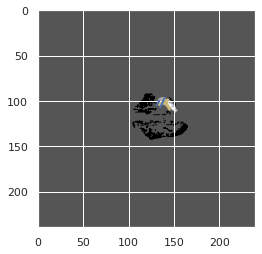

[0, 0.0, 0.0, 0.0, 0.0, 0.00911854103343465, 0.43474714518760194, 0.4889589905362776, 0.4782939832444783, 0.48134044173648133, 0.547317436661699, 0.5378955114054452, 0.4551804423748545, 0.33971068595426973, 0.33629825889477666, 0.4442036836403034]
prediction [2.0542583  1.7112923  1.358079   0.11091496 1.471175   1.9218374
 1.7688246  1.5178839 ]


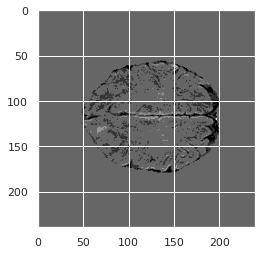

prediction [ 7.3575187  9.752817   4.0447097  8.644854   6.3685865 10.431024
  4.4792147  9.492216 ]


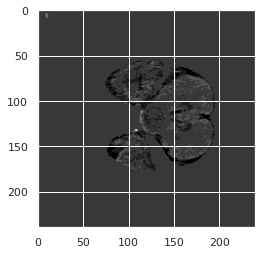

prediction [ 8.619236  11.832255   4.2393117 10.044159   5.752172  12.057758
  6.232357  12.40179  ]


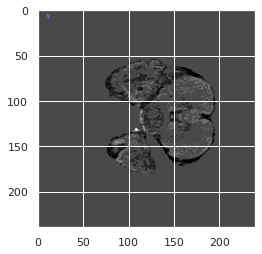

prediction [ 9.257552  11.676311   3.575679  10.316638   4.014175  11.41644
  6.0578313 12.8810215]


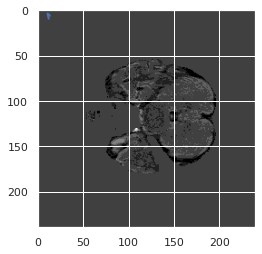

prediction [41.020344 37.004726 31.421583 43.189983 38.484417 38.124226 31.89216
 41.471107]


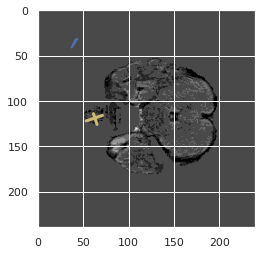

prediction [119.84702  76.45665 103.06448  92.12017 114.15727  81.17937 105.52859
  86.59631]


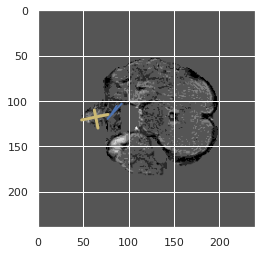

prediction [113.56562   60.99469  122.40135   88.757645 134.15302   70.352844
 115.54631   83.464134]


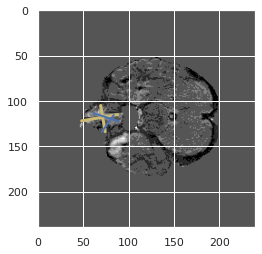

prediction [104.98765   56.978897 141.7958   101.92465  143.03735   70.8697
 113.91159   90.028244]


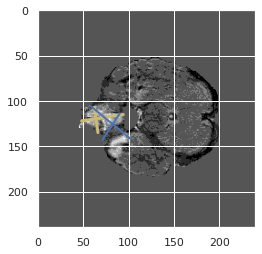

prediction [ 99.489456  53.235172 145.29932  102.29574  149.77478   70.67224
 102.00259   82.98813 ]


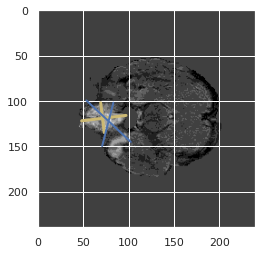

prediction [ 97.87549   53.154663 137.66228  105.970665 146.32344   72.186005
  93.60054   80.293304]


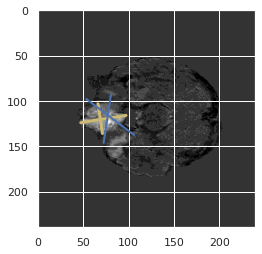

prediction [104.25729   53.948013 138.94005  106.78842  150.75058   71.472725
  89.41529   78.0274  ]


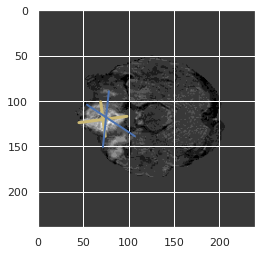

prediction [109.193726  54.16332  140.4901   107.097275 154.74986   74.06242
  89.8337    78.47711 ]


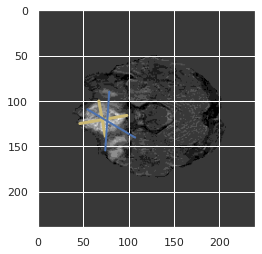

prediction [113.13824   59.093296 138.95116  106.7488   158.03809   75.704735
  86.940475  82.90634 ]


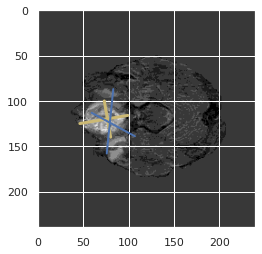

prediction [111.602776  62.790478 140.5973   108.00204  163.54048   77.19962
  80.15019   83.91781 ]


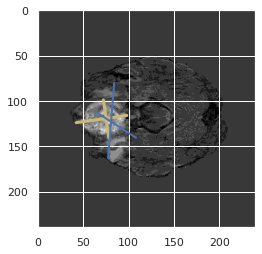

prediction [110.99215   64.60004  143.66852  110.840004 172.25235   78.33126
  75.73602   84.10902 ]


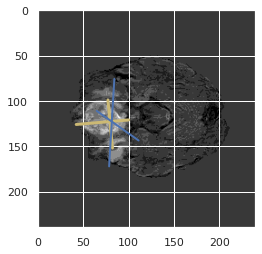

prediction [121.53214   65.025116 152.24716  111.45484  183.41629   74.51528
  81.97193   85.44431 ]


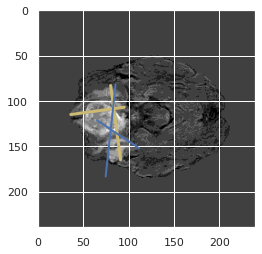

[0.5073035349108969, 0.5827509085826111, 0.5634178905206942, 0.28796959508843734, 0.09748566387295986, 0.03317048084340447, 0.12511159290906773, 0.18768362909860148, 0.20172370721958532, 0.2450993831391364, 0.2335111226746455, 0.19062167906482466, 0.16522747776775357, 0.15432969852469533, 0.11679955238494895, 0.2043785107302319]
prediction [122.261215  63.343655 154.45146  109.69559  187.00706   73.43216
  79.47959   83.839264]


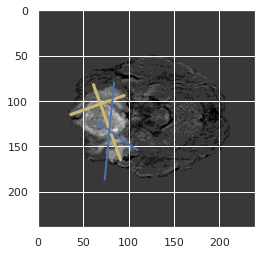

prediction [125.05244   56.68041  153.63637  108.3507   189.62096   71.949646
  73.69644   76.68994 ]


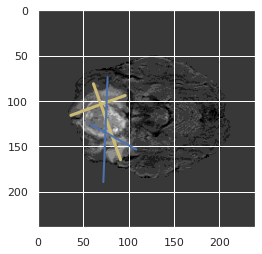

prediction [131.28061  57.92434 149.773   107.45432 185.55925  72.13572  84.26159
  79.96729]


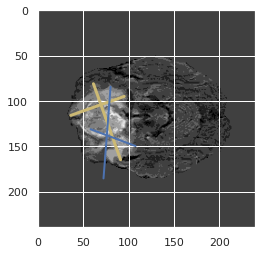

prediction [144.39139   57.991974 132.65524  100.51142  166.01915   67.95896
 103.83786   85.036835]


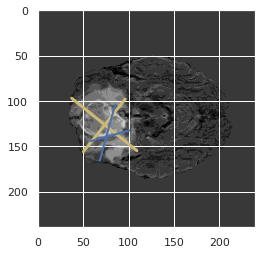

prediction [153.6157    64.43978  125.63005   98.41342  156.30354   67.33967
 112.609955  91.59935 ]


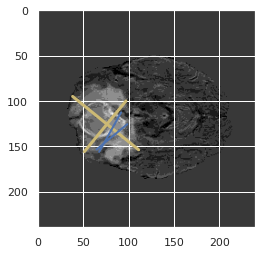

prediction [153.90462   65.910995 116.695526  96.46949  146.9533    65.33728
 111.336395  96.96295 ]


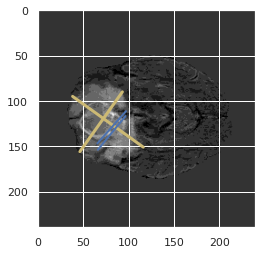

prediction [156.33789   66.47483  106.95973   94.41813  135.02324   61.466663
 115.919716  98.68884 ]


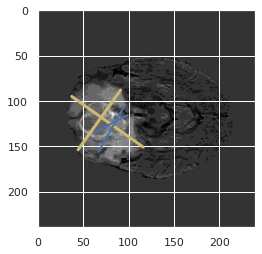

prediction [157.4783    66.06439  106.78217   98.40815  126.31989   61.546627
 126.63871   97.987495]


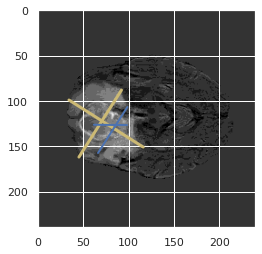

prediction [155.89952   64.74406  111.41874  102.40369  123.250374  63.0959
 130.71152   98.57177 ]


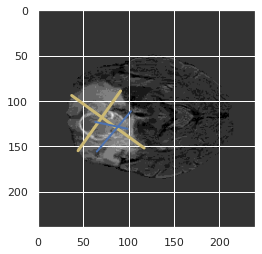

prediction [156.04077   66.21026  112.974495 103.52264  122.31031   61.689213
 135.38951   99.96862 ]


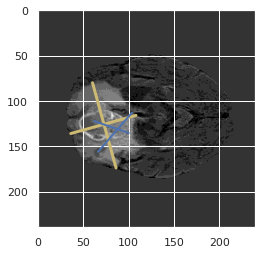

prediction [155.53564   69.9633   113.0551   102.60727  120.90628   61.890957
 136.35011  100.5165  ]


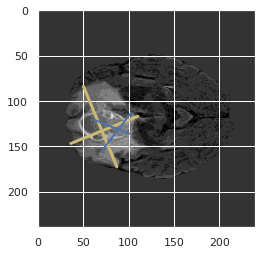

prediction [153.00461   74.63506  114.59496   99.92878  122.38853   58.310158
 135.19759  100.842   ]


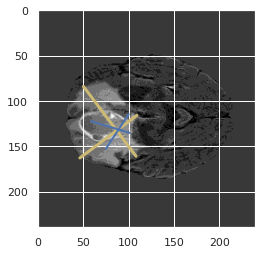

prediction [152.44884   76.430855 115.86647   98.14011  126.20211   57.90482
 134.04457   99.86124 ]


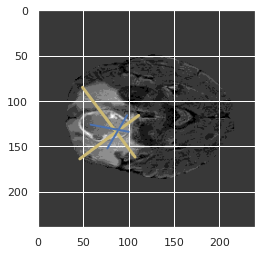

prediction [150.76038   79.32595  115.19691   96.81204  131.08618   56.248177
 127.61076   98.97116 ]


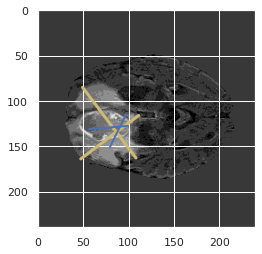

prediction [143.80176   79.340965 117.06687   98.26445  133.34795   56.839664
 123.46309   98.62914 ]


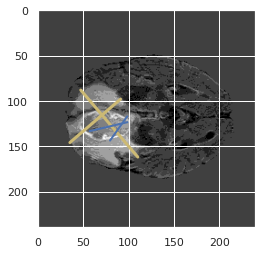

prediction [147.65114   82.83844  111.496765  92.42937  130.8967    53.732334
 126.96981  101.46583 ]


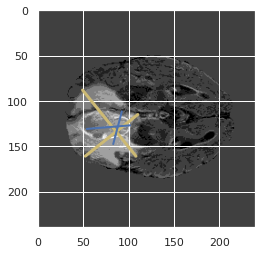

[0.26674065852756196, 0.27113267400634444, 0.1970958030812821, 0.1983235241662208, 0.21254171789917442, 0.100438098328736, 0.27364438839848676, 0.445141545524101, 0.4595839288550103, 0.47971323978035385, 0.4863278453829635, 0.5454824830977258, 0.5817195972114639, 0.5587967183226983, 0.5717159213987313, 0.5229904068805822]
prediction [153.89616   83.537704 111.86436   92.519615 131.21268   56.27526
 133.073    101.71339 ]


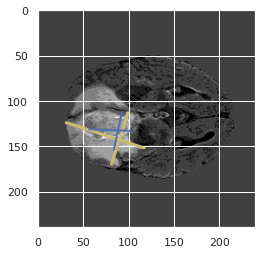

prediction [154.06493   84.653305 112.638245  91.92646  129.73158   58.38768
 134.9631   100.02147 ]


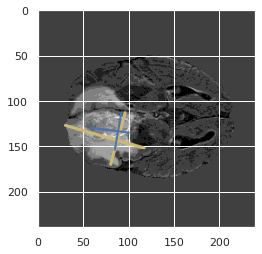

prediction [154.0002    84.13611  116.741615  93.201904 137.14615   59.49058
 135.46362  100.68407 ]


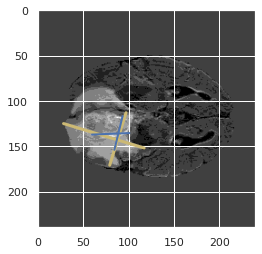

prediction [154.45198   83.0248   116.037636  94.1189   138.14697   59.64088
 132.91212   98.32229 ]


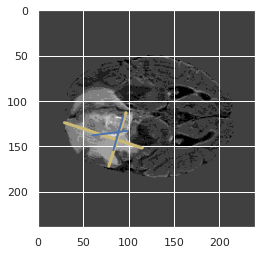

prediction [154.65434   88.09704  116.709404  92.93217  146.47775   58.42326
 124.11967   99.79581 ]


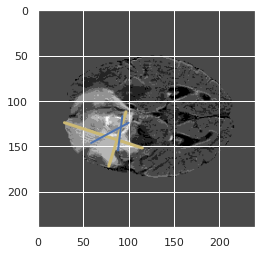

prediction [150.5182    79.65499  126.09381   94.312004 150.65234   59.317116
 122.07352   94.8863  ]


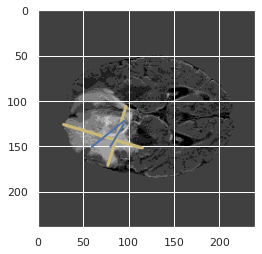

prediction [145.45467   64.42899  139.43817  102.37603  165.38622   65.936874
 110.24444   83.04031 ]


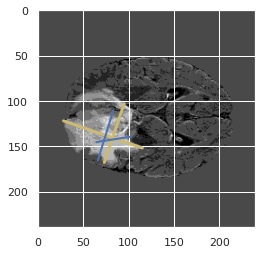

prediction [145.02367  61.8554  150.18417 107.85035 178.38858  70.7045  107.21474
  81.22865]


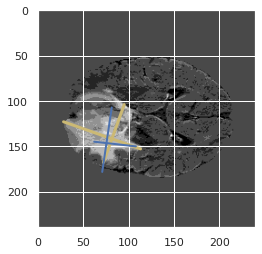

prediction [136.8896    51.573193 163.67793  114.92194  181.62639   74.313324
 106.21414   80.1241  ]


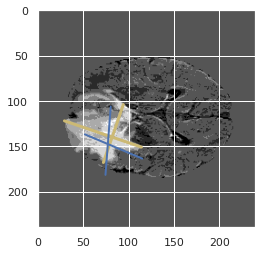

prediction [132.03745   42.760967 166.78836  118.643074 178.0414    77.906456
 111.01491   78.10473 ]


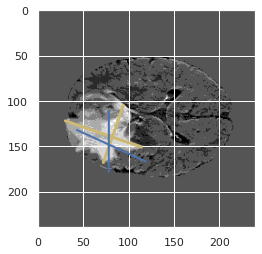

prediction [129.80849   40.893154 169.71925  122.99208  175.93748   78.225784
 115.08731   81.96705 ]


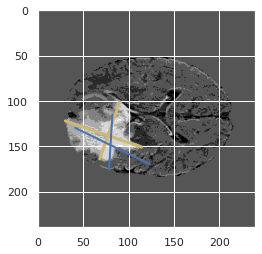

prediction [128.86154   39.69017  166.02473  120.543236 171.0622    76.17106
 114.64183   80.10254 ]


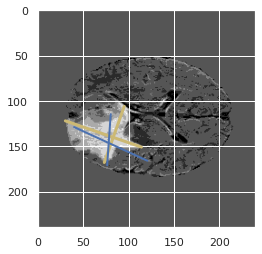

prediction [125.68654   37.884773 165.1261   120.32052  173.45209   75.14763
 107.549484  78.09307 ]


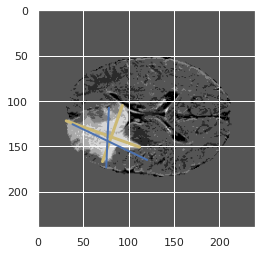

prediction [127.62211   38.74598  167.47289  120.7023   178.2974    75.432945
 106.24508   79.83907 ]


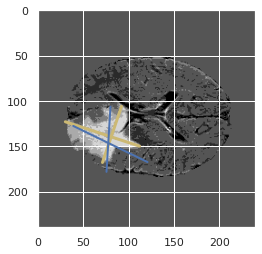

prediction [126.2058    38.346012 167.14078  120.907394 180.40182   75.91621
 104.11608   81.46986 ]


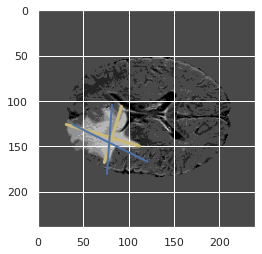

prediction [127.23476   40.700066 169.55078  117.50028  183.54292   74.95863
 105.14678   81.3612  ]


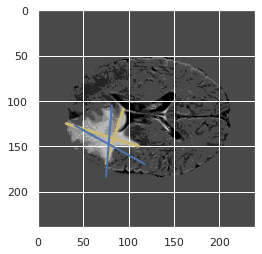

[0.523355754857997, 0.5162826128356504, 0.5022772818364001, 0.5068546807677242, 0.521695460024106, 0.5055477103086544, 0.5167294482605805, 0.4816336394393427, 0.5458190148911798, 0.4531355360755226, 0.3123388581952118, 0.3244406196213425, 0.19961612284069097, 0.1865373645179692, 0.0625, 0.08141447368421052]
prediction [120.478035  40.838856 173.72604  116.02175  185.27985   76.3735
 100.99072   81.08934 ]


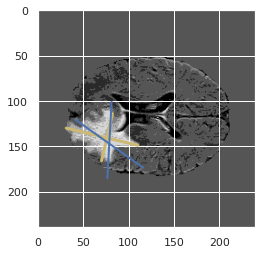

prediction [117.69161   40.955566 172.33205  113.77112  184.0881    76.00168
 100.65008   82.79801 ]


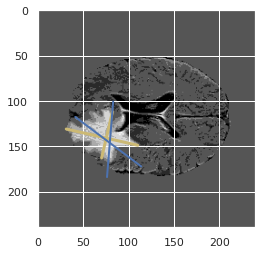

prediction [113.20846   40.192642 174.63577  115.767845 185.06226   77.63245
  97.11531   83.23842 ]


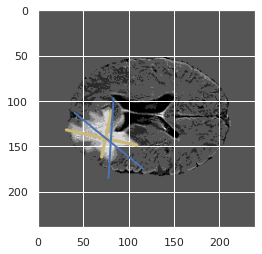

prediction [110.36329   40.78915  173.67477  115.15781  184.40329   75.780495
  93.80657   81.41249 ]


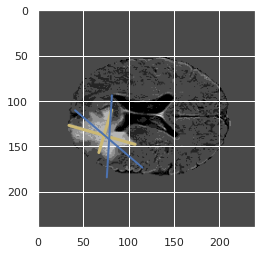

prediction [108.24249   43.031887 170.98631  114.47914  180.76016   74.81087
  93.505035  83.841606]


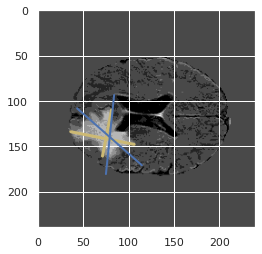

prediction [105.22304   41.664856 170.49759  115.56864  175.07146   77.91067
  97.669426  82.440544]


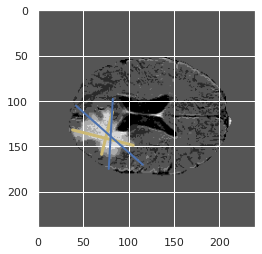

prediction [104.86067   45.042614 166.77696  112.42984  169.7146    76.9123
 102.39677   84.52914 ]


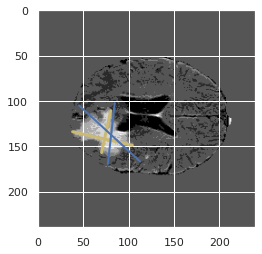

prediction [103.521255  42.816578 161.29506  110.409775 166.08746   77.80224
 100.931145  82.85529 ]


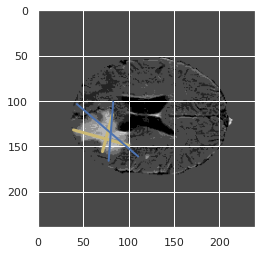

prediction [105.09455   43.317505 148.06874  106.175285 149.75829   74.65498
 108.66703   80.98759 ]


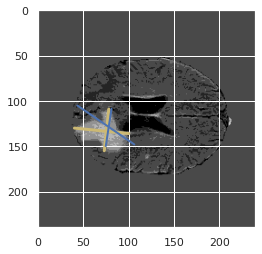

prediction [107.83998   45.72346  140.85315  105.552414 136.70221   72.86832
 117.286896  84.06488 ]


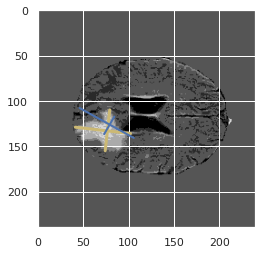

prediction [107.66637   46.583466 139.39647  105.844734 131.34706   73.90966
 120.485214  83.847275]


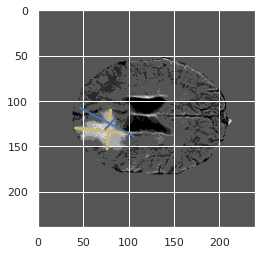

prediction [110.23772   46.98885  140.46266  105.932335 133.21748   76.66841
 121.723     85.21097 ]


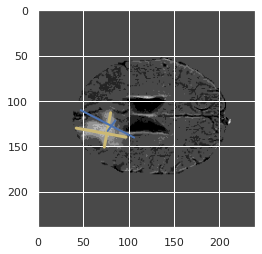

prediction [109.96414   42.775482 130.78928   95.24279  131.85895   71.76338
 111.49989   74.44348 ]


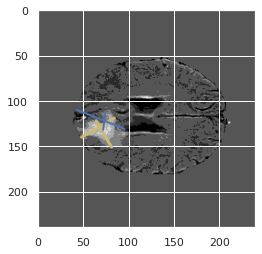

prediction [112.00234   48.508636 124.83112   91.3117   128.54037   71.327
 109.15142   75.23819 ]


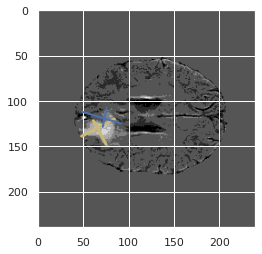

prediction [111.4925    49.389275 123.11143   88.950485 126.606995  68.58909
 108.29291   72.96827 ]


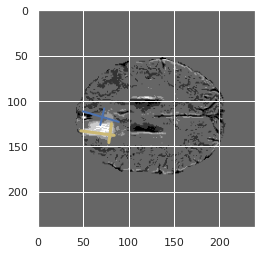

prediction [111.93288   49.765038 119.89669   86.071335 125.9686    69.07346
 107.962776  70.9299  ]


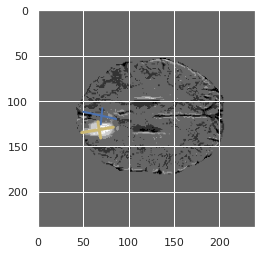

[0.04030710172744722, 0.21472937000887313, 0.10707635009310987, 0.050742574257425746, 0.0, 0.0, 0.0, 0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.03668261562998405, 0.09777015437392796, 0.37201907790143085]
prediction [113.36499   51.863747 118.1749    84.6415   128.23293   71.01195
 107.22723   71.95522 ]


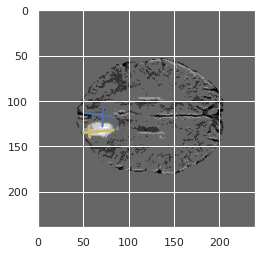

prediction [116.73098   55.916348 121.4905    88.83514  133.90968   75.716675
 107.98997   76.4941  ]


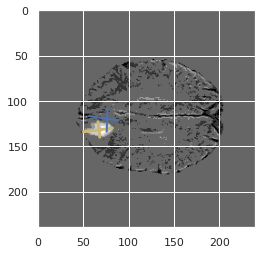

prediction [115.87982   57.163025 120.70227   88.47384  132.69392   76.92603
 107.965744  76.40403 ]


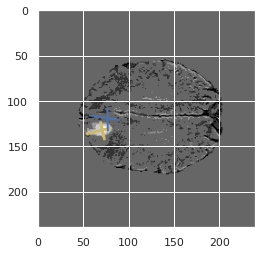

prediction [116.122154  60.075466 116.76497   87.97545  128.75826   79.79612
 110.639824  78.64355 ]


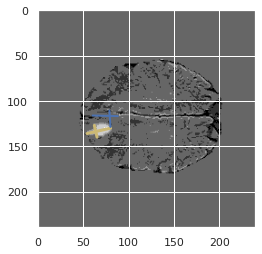

prediction [ 98.633575  54.983154  94.98981   71.71713  106.74952   66.943474
  95.33165   67.65851 ]


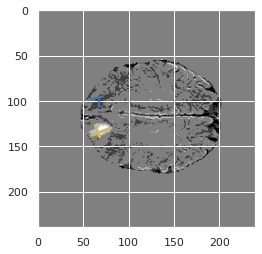

prediction [94.635796 59.361156 76.65579  66.98004  88.51392  65.81803  88.4872
 67.142105]


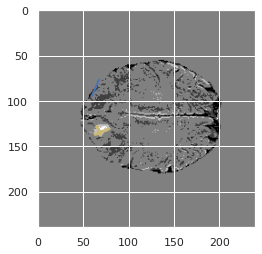

prediction [23.301449 18.534046 16.521328 20.000242 18.630692 19.58491  20.732424
 15.014922]


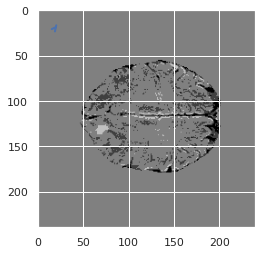

prediction [3.3321433 3.2996225 1.7223092 3.3502047 2.6490166 2.699031  2.4230318
 2.4333854]


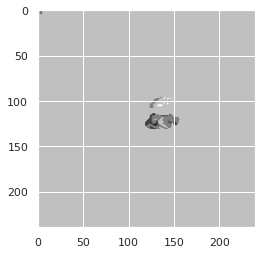

prediction [17.195604 24.8149   19.612217 32.389133 18.606245 29.14799  18.003002
 32.685635]


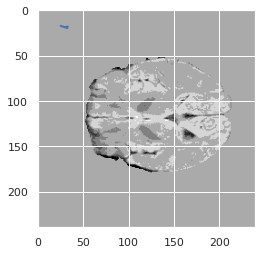

prediction [15.431692 24.865082 16.95681  27.851984 17.286007 25.265923 14.587746
 30.730356]


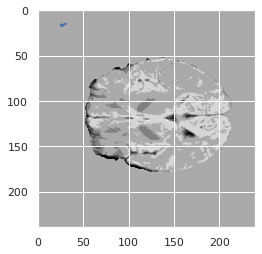

prediction [ 6.014127   7.491106   5.505751   6.904248   4.9210525  6.449312
  5.8725333 10.263662 ]


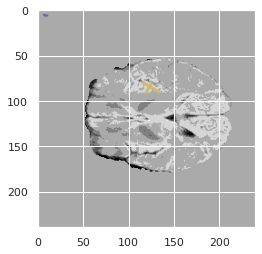

prediction [4.172841   1.6920232  2.2168543  1.352913   4.836537   2.6732402
 0.82998025 2.7726765 ]


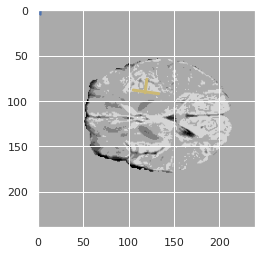

prediction [13.670521  16.086922  10.2534    19.796577  11.848429  17.338436
 10.8921385 20.439142 ]


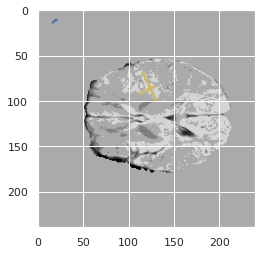

prediction [ 84.136536  99.3283    86.01563  118.16918   85.7387   114.48418
  83.281395 119.28444 ]


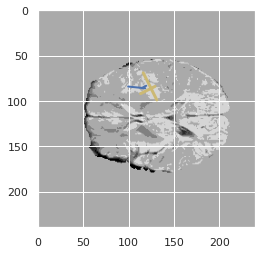

prediction [ 82.886955  96.91577   79.58611  118.08896   86.24718  112.39305
  78.87705  119.188995]


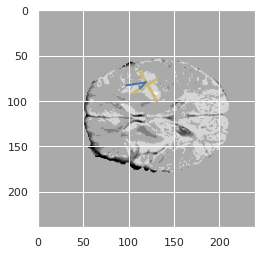

prediction [ 76.54471  105.73334   85.50918  131.14597   89.720055 120.27456
  72.416084 131.07841 ]


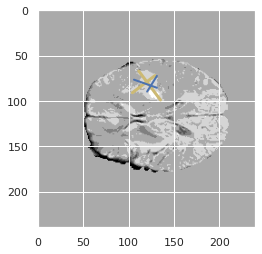

[0.49263038548752835, 0.5148279952550415, 0.6129234629861983, 0.43236409608091025, 0.3534830166954519, 0.18629671574178935, 0.1470708725931995, 0.12985685071574643, 0.08795934323690383, 0.12960062646828505, 0.252014652014652, 0.15870683321087437, 0.3734652114597544, 0.2586908863138115, 0.20749018423437027, 0.10407918416316736]
prediction [ 71.384155 109.58788   90.75552  145.49364   97.170555 126.53378
  67.57308  138.32463 ]


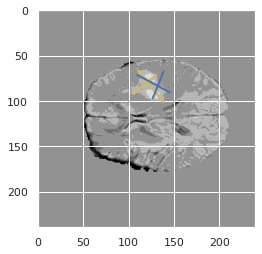

prediction [ 75.01424  112.44141   92.931816 146.75108   98.12371  126.45748
  71.594765 139.36983 ]


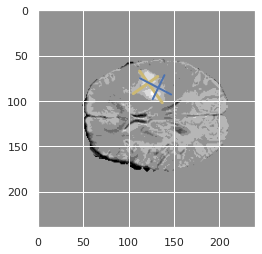

prediction [ 70.00436 109.02443  92.45376 144.28125  93.21706 122.12239  69.07052
 133.57315]


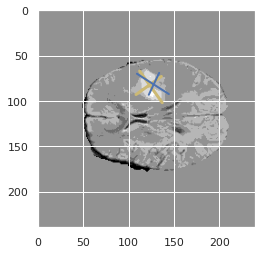

prediction [ 69.20625 106.22137  88.2841  143.38449  86.35215 123.5957   68.96638
 130.96616]


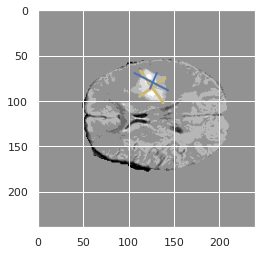

prediction [ 75.87626  104.09638   89.81545  147.39668   86.543175 128.95805
  72.10513  135.34013 ]


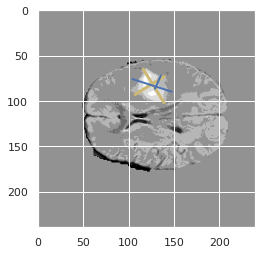

prediction [ 73.130905 106.27783   92.46017  147.27579   83.769135 129.05473
  79.255066 135.68648 ]


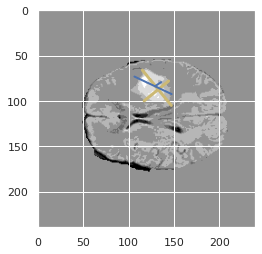

prediction [ 75.182625 105.813446  96.184166 156.79008   84.02869  135.99033
  81.144875 138.88663 ]


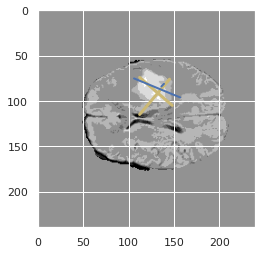

prediction [ 80.74379  109.260506  94.140625 156.53285   81.92121  135.70021
  87.383484 143.69275 ]


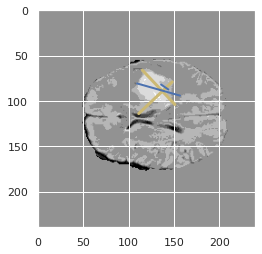

prediction [ 87.52855  111.23769   93.890526 159.22377   85.19716  134.46912
  90.92222  146.92023 ]


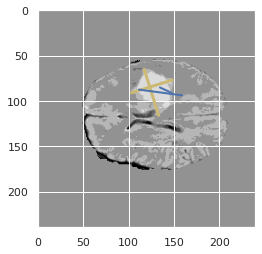

prediction [ 93.04213 110.20725  90.08237 155.17438  84.48376 127.12258  90.86071
 144.33408]


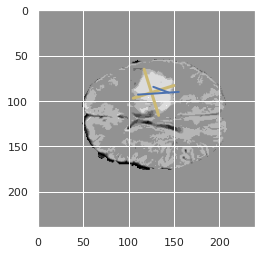

prediction [102.01922 110.55613  89.31348 154.25375  83.83844 123.8264   97.02869
 142.03618]


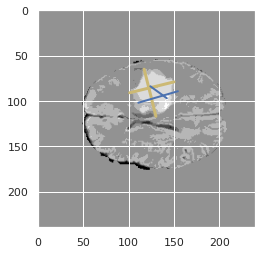

prediction [103.29696  112.766846  90.64886  154.01126   90.70363  122.51823
  93.606514 141.42612 ]


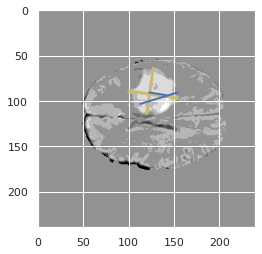

prediction [107.15242  109.521545  90.0645   155.26807   83.71787  117.38424
 103.48308  137.25871 ]


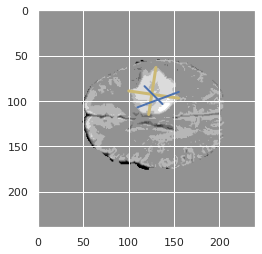

prediction [101.64443 103.0815   92.47149 154.87688  84.98789 114.37109  97.67732
 128.47389]


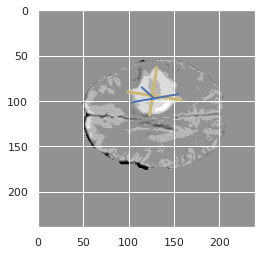

prediction [ 99.48917   98.5682    92.160095 154.63686   86.04466  114.10615
  93.63102  127.51906 ]


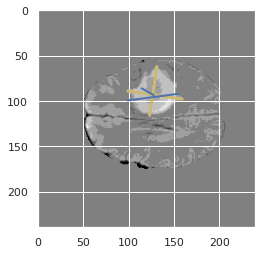

prediction [ 94.466385  97.55441   92.34737  156.94023   88.11655  116.835365
  88.08069  127.84268 ]


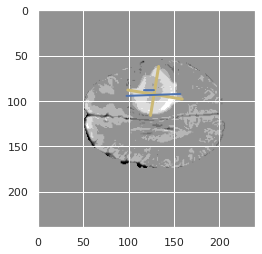

[0.18427947598253275, 0.1874656404617922, 0.19800646551724138, 0.15074309978768577, 0.16290661070304302, 0.19952241973998408, 0.3177377892030848, 0.3249872253449157, 0.22688655672163918, 0.3183500793231095, 0.4265770423991727, 0.45265888456549935, 0.4547575836142079, 0.4811737211113996, 0.6390745501285348, 0.7479899497487437]
prediction [ 92.99324   94.89378   92.05964  156.71545   82.28635  118.46911
  92.35786  127.250786]


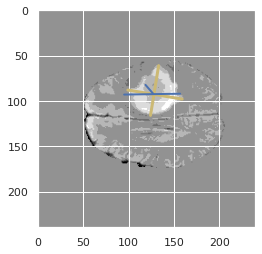

prediction [ 92.47618  89.44832  96.37585 157.74435  83.2702  118.89625  91.33096
 125.98865]


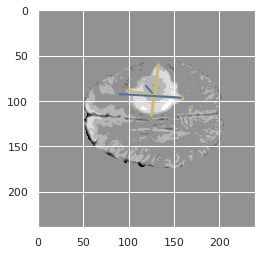

prediction [ 92.85459   85.056435  95.52417  158.57698   82.3121   121.268715
  91.14849  123.391426]


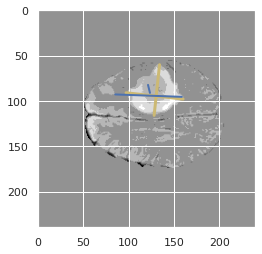

prediction [ 91.83064   85.06349   94.02845  158.67459   83.74872  120.192245
  86.50018  122.06865 ]


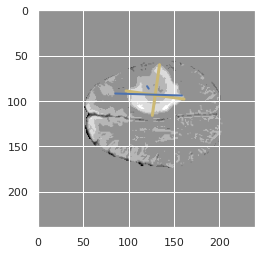

prediction [ 95.55544  88.66426  93.45738 159.25664  87.02177 119.95191  84.71247
 124.47844]


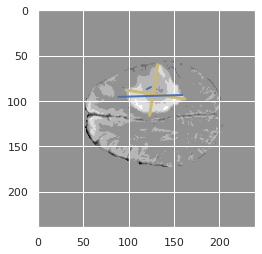

prediction [ 96.12668  92.73299  94.82417 160.44574  91.54242 122.67917  83.97253
 127.789  ]


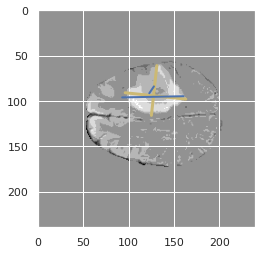

prediction [ 93.77868   92.04788   96.45306  162.23618   98.91649  122.20966
  80.43537  124.582634]


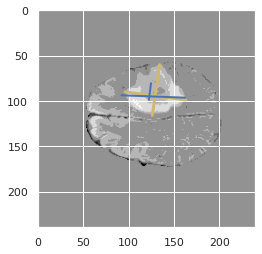

prediction [ 94.21169   92.1578    95.90211  162.14613   99.84514  123.35089
  80.506065 124.40456 ]


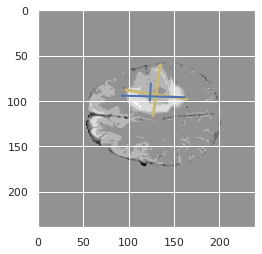

prediction [ 98.2155    90.09098   96.57539  162.18861   97.69375  121.047966
  83.95351  122.006645]


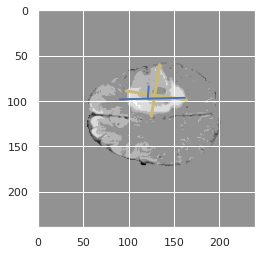

prediction [ 93.59076   88.211754 101.36995  164.47426   98.10363  125.66366
  80.595215 125.65221 ]


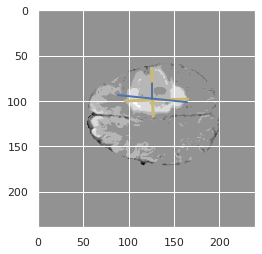

prediction [ 92.89307   86.12217  102.82868  166.81587  101.763855 126.90757
  78.16651  127.00102 ]


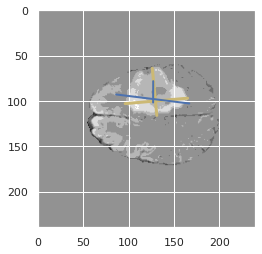

prediction [ 93.17822  87.57907 103.14878 168.03421 103.62477 129.02145  79.27931
 129.85718]


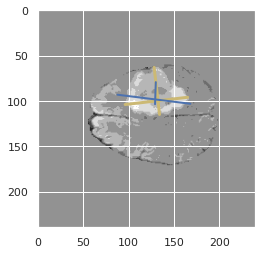

prediction [ 96.642845  88.20176   98.91914  162.58058  104.36724  121.30635
  78.71065  126.11382 ]


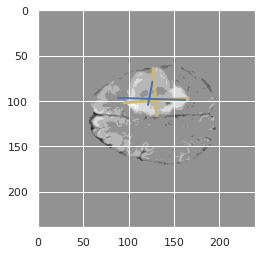

prediction [ 96.05664   87.809044  99.20781  161.52208  104.827736 119.92134
  77.434586 123.99748 ]


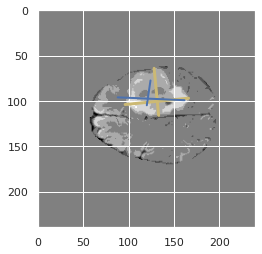

prediction [ 97.71848  88.19142 101.47358 163.11543 109.42198 116.22598  73.78872
 120.17725]


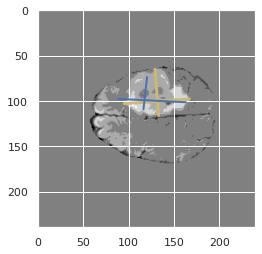

prediction [ 96.48084   88.65032  103.10189  163.34718  114.087326 114.625206
  70.6435   117.59241 ]


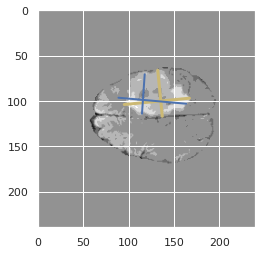

[0.7020785219399538, 0.6837341608482027, 0.7552893193984196, 0.7589662447257384, 0.6719131614654003, 0.35817242317106335, 0.45940537449971414, 0.3135491606714628, 0.25929311395490556, 0.2849445324881141, 0.2629578438147892, 0.20956256358087488, 0.2209181912323093, 0.2979362101313321, 0.2876923076923077, 0.15555555555555556]
prediction [ 94.79953   89.36341  102.0417   161.61655  114.38557  113.92514
  73.082184 115.98699 ]


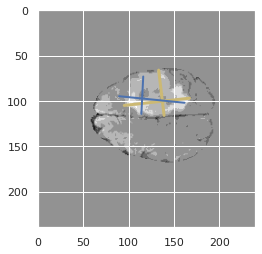

prediction [ 96.26108   89.75284  100.78246  160.79288  115.74281  115.21617
  76.077034 118.16432 ]


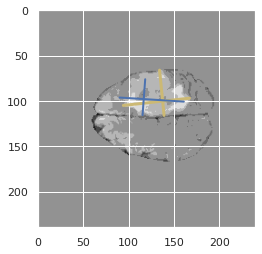

prediction [ 95.11109  89.75616  99.16386 160.19339 118.58298 114.25882  72.22499
 116.95493]


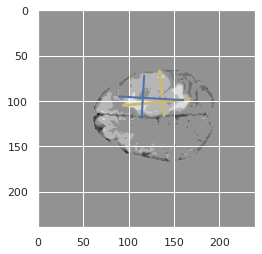

prediction [ 92.66111   89.08147   98.1167   158.51741  115.071754 113.032974
  71.00452  115.70889 ]


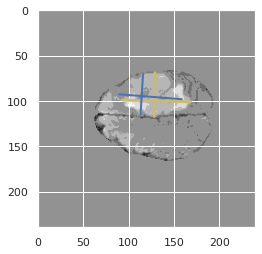

prediction [ 90.3227    89.08104   99.41919  159.66605  109.40335  113.33095
  73.184265 117.02414 ]


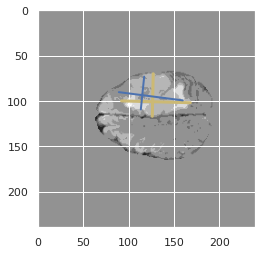

prediction [ 91.915634  83.02367   98.84698  160.4688    99.58329  115.01103
  80.38791  116.78866 ]


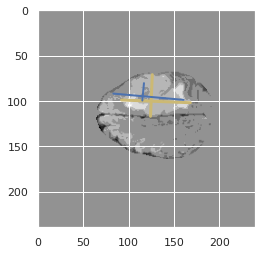

prediction [ 91.567406  85.71594   97.80213  159.63133  101.37648  113.59211
  77.814545 115.985214]


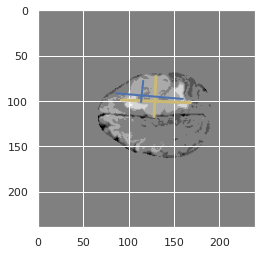

prediction [ 95.16493   86.12513   96.086296 157.21977   99.36816  115.518715
  83.14892  119.45526 ]


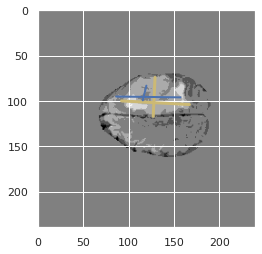

prediction [ 95.80051  86.94303  95.36629 157.33066  99.6557  116.88603  86.287
 121.88631]


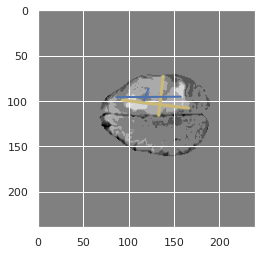

prediction [ 95.95034   88.21588   97.104195 156.88084  101.100876 116.80012
  86.90447  121.381004]


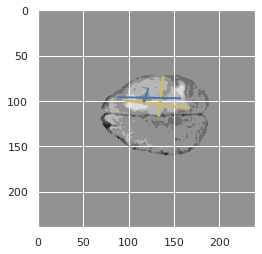

prediction [ 95.00902   87.983475  98.91782  157.5542   100.27243  116.60138
  88.427795 121.07296 ]


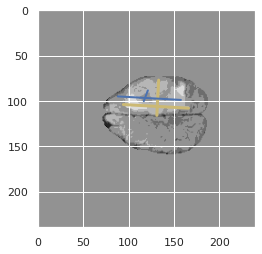

prediction [ 95.37047   88.1757    99.730286 156.96996   98.73236  116.760925
  89.87362  121.85582 ]


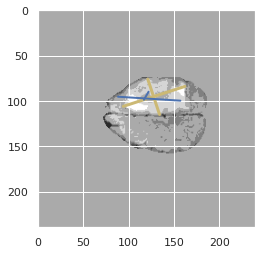

prediction [ 95.02995  88.95769  96.84327 150.31339  97.98544 113.61306  87.52411
 122.72542]


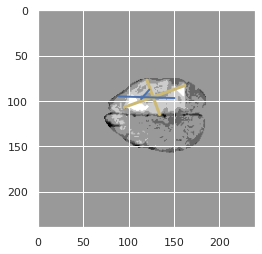

prediction [ 95.34411   90.837845  93.815605 147.58328   99.66176  110.18577
  84.44571  120.85311 ]


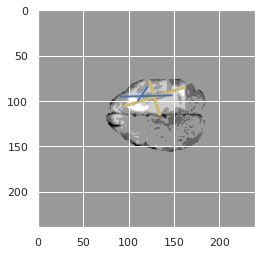

prediction [ 96.187126  91.9691    92.005066 140.96281  100.85245  107.141106
  82.730225 119.062225]


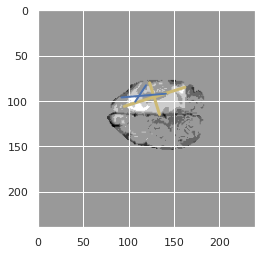

prediction [ 97.550545  95.0526    89.88005  138.58554   98.85938  105.18083
  85.80716  121.49126 ]


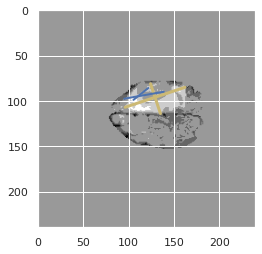

[0.23926940639269406, 0.3616366036075671, 0.5070967741935484, 0.3424479166666667, 0.202803738317757, 0.15575396825396826, 0.10986267166042447, 0.06334841628959276, 0.012658227848101266, 0.0, 0, 0, 0.0, 0.0, 0.0, 0.0]
prediction [ 99.82503   94.53989   92.250916 138.5839   101.92959  105.99729
  85.58094  120.47167 ]


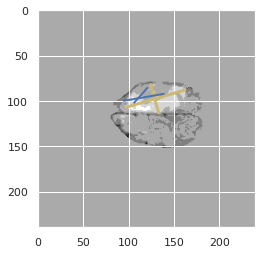

prediction [ 99.440575  92.38916   94.98332  141.13412  103.99513  106.87939
  84.26116  114.93793 ]


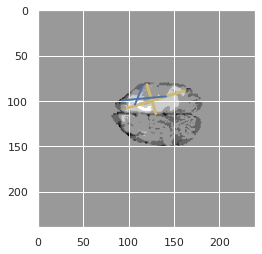

prediction [102.46329   95.71023   96.64665  143.91699  106.125725 109.26704
  87.740074 115.92261 ]


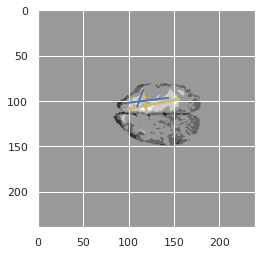

prediction [103.4971    99.482185  96.0287   147.80226  103.16148  115.05953
  91.375984 120.09009 ]


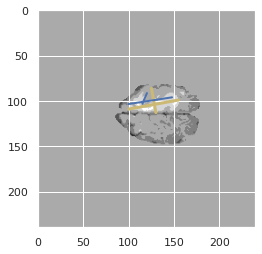

prediction [102.95999  102.8888    95.292465 148.23434   98.75984  119.165016
  94.80094  122.240715]


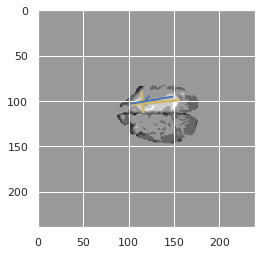

prediction [102.25745  103.34627   95.355804 149.51245   95.87945  123.676
  96.848694 124.05238 ]


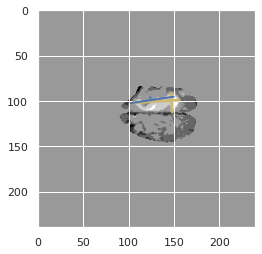

prediction [ 88.45388   98.329636 101.41417  147.771     92.91053  124.62785
  92.86871  124.67848 ]


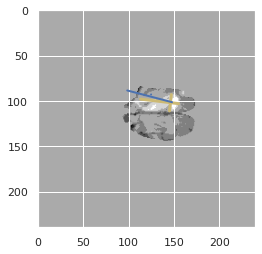

prediction [ 89.69099  100.87487   98.469925 142.26778   92.02973  122.17284
  94.14447  123.88828 ]


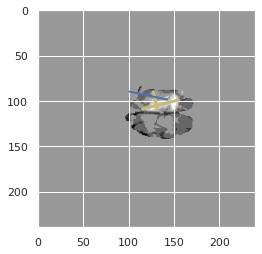

prediction [ 96.25367  105.18648   99.519684 135.89513   92.78129  121.20763
  99.823166 127.33341 ]


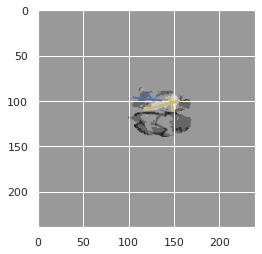

prediction [ 87.95586  101.91582   76.37967  116.16145   74.51031  105.05248
  86.54693  114.543816]


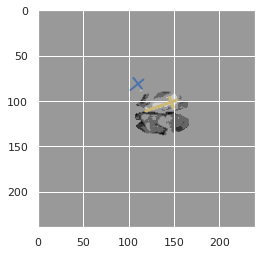

prediction [0.95637494 2.6039457  0.6307813  0.8703854  1.7680799  0.63444924
 0.43010533 1.8116978 ]


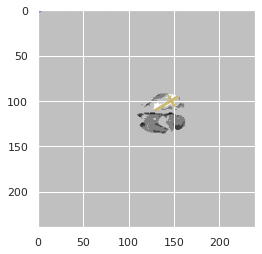

prediction [1.7457737  1.9622271  0.51561534 1.7531444  1.577616   1.3913648
 0.5760755  1.0522517 ]


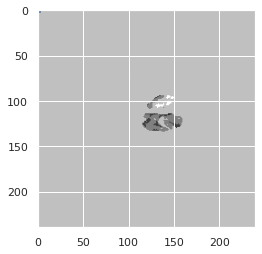

prediction [49.440083 42.576862 46.604645 46.472225 53.05134  47.867176 40.637444
 46.09172 ]


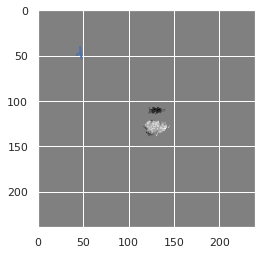

prediction [6.519118  4.378614  4.5183825 2.0021033 5.451486  3.518413  4.178952
 3.223234 ]


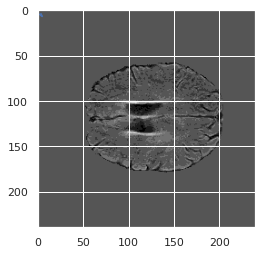

prediction [4.1547537 4.706763  2.9891539 1.1248238 2.7109942 3.7923596 2.9344923
 3.7689917]


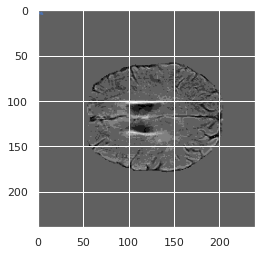

prediction [7.1752386 7.786567  5.890259  4.126318  7.723451  6.10512   3.937377
 5.3885174]


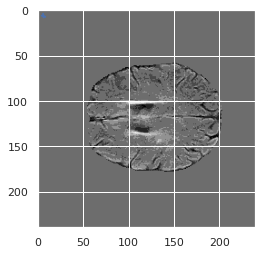

[0.0, 0.0, 0.0, 0.4376731301939058, 0.5933609958506224, 0.594272076372315, 0.47186932849364793, 0.3401015228426396, 0.48366701791359323, 0.5, 0.5265374894692502, 0.4592760180995475, 0.4853754940711462, 0.6239113222486145, 0.656758669497523, 0.7322475570032573]
prediction [39.04107  46.31567  37.567787 46.055775 41.063564 48.54784  34.559628
 48.246296]


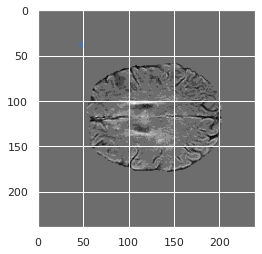

prediction [30.71681  30.425926 29.420025 27.766457 26.606068 33.820126 31.00779
 30.156988]


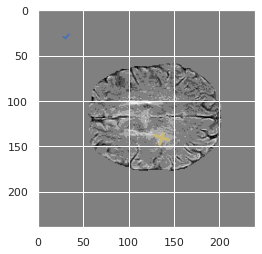

prediction [28.60447  33.962345 24.18613  32.412064 28.161526 32.68391  23.80316
 33.702244]


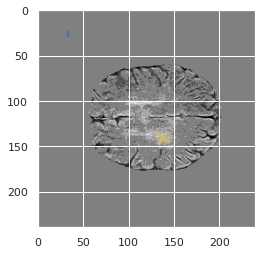

prediction [138.75433 124.21544 132.35553 154.65434 141.759   137.61533 133.25114
 138.32571]


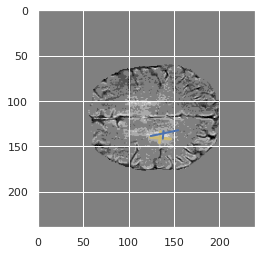

prediction [140.99248 122.53503 135.37001 152.7341  146.8295  136.36676 132.65213
 135.39012]


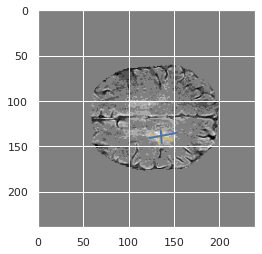

prediction [141.16008 122.38634 132.9944  149.67284 144.22331 133.88976 132.29912
 134.111  ]


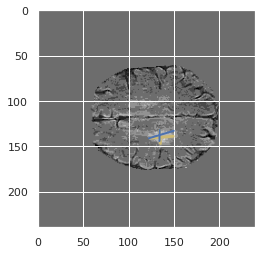

prediction [140.8603  123.51164 130.85681 149.8367  144.36972 136.58646 127.09186
 138.24422]


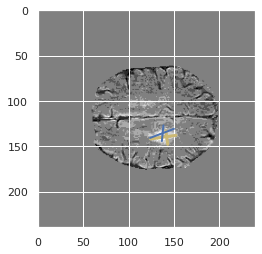

prediction [138.41916 120.27707 131.53458 148.08817 147.6295  134.24559 119.60238
 134.28331]


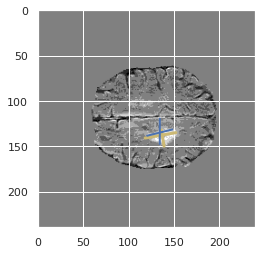

prediction [136.9263   119.16059  131.35588  149.98508  149.70892  132.19241
 115.606346 132.12077 ]


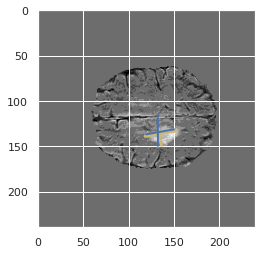

prediction [135.79391 119.07881 129.47786 152.87366 149.48033 131.27731 114.22447
 130.77151]


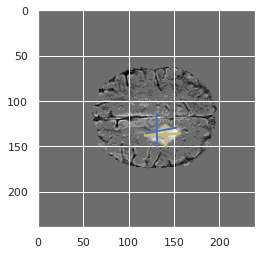

prediction [138.24985  120.81423  130.4641   157.55151  150.37625  133.36569
 117.905464 133.37195 ]


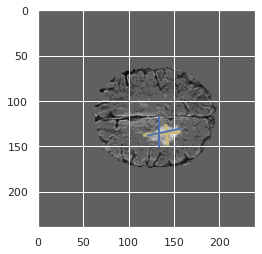

prediction [135.64818 120.2938  128.37349 155.9171  148.34668 131.40315 117.5149
 131.63208]


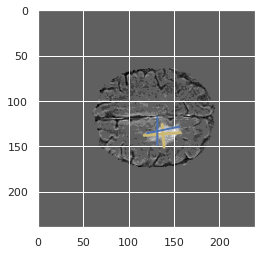

prediction [135.35466 118.58325 130.10774 155.7168  152.35245 131.32018 115.47922
 130.45137]


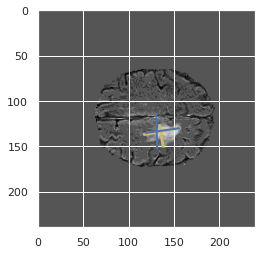

prediction [135.30121  117.566284 130.48236  156.17429  152.7659   131.44102
 117.6609   132.70497 ]


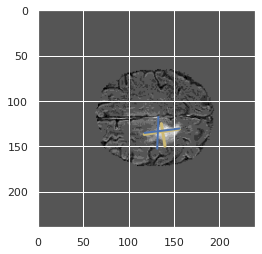

prediction [133.12279 117.99588 132.03596 159.04724 154.35475 132.53325 118.25027
 133.86058]


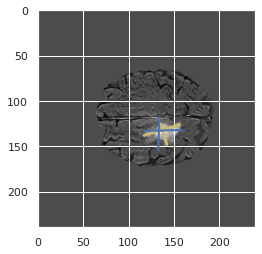

prediction [133.43259 116.64523 132.44872 159.79054 154.23914 134.08203 118.66698
 133.73921]


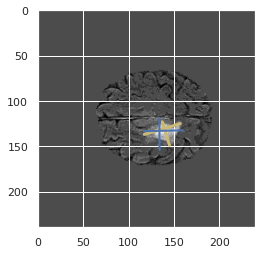

[0.7114285714285714, 0.6399769585253456, 0.3861671469740634, 0.3452054794520548, 0.3429355281207133, 0.4021978021978022, 0.5062992125984253, 0.4806138933764136, 0.42845849802371544, 0.38257575757575757, 0.3895910780669145, 0.4898813677599442, 0.50920245398773, 0.5698610095098756, 0.4724099099099099, 0.5399654974123059]
prediction [134.17802 118.45964 133.0913  159.08672 154.73187 133.78062 118.26482
 135.15022]


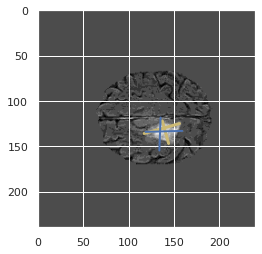

prediction [138.9052   118.23081  137.21632  161.31073  163.27444  139.65135
 123.077675 138.69426 ]


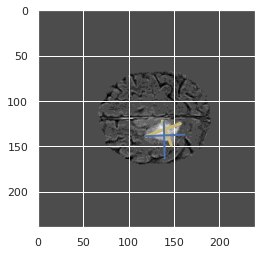

prediction [145.16801 122.40218 137.9066  157.35089 162.6202  140.41116 130.90567
 142.87906]


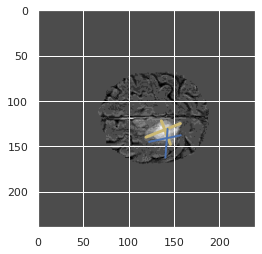

prediction [149.5208  125.75402 134.37207 160.98653 156.08214 143.71445 134.72768
 144.5674 ]


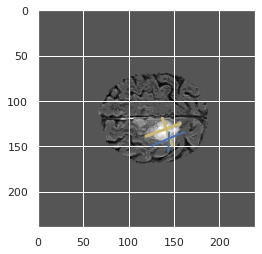

prediction [145.76752 124.50998 136.32718 160.4806  160.52707 141.11583 131.23532
 146.50737]


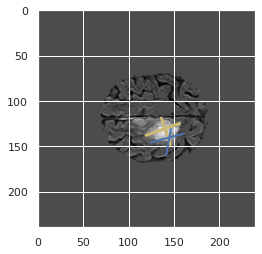

prediction [144.7057  123.52426 135.95618 159.727   159.62389 139.57336 130.12073
 146.18349]


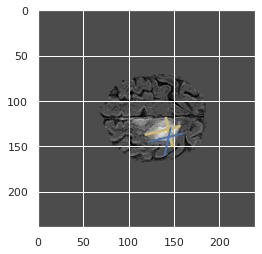

prediction [140.89995 120.85465 135.36176 155.57674 159.14207 134.48305 127.05808
 145.1281 ]


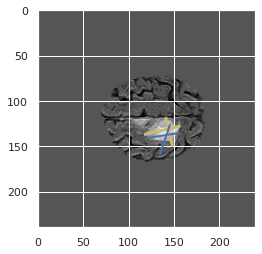

prediction [140.80605 120.40529 133.70795 156.25351 156.56927 134.23787 127.39767
 144.10857]


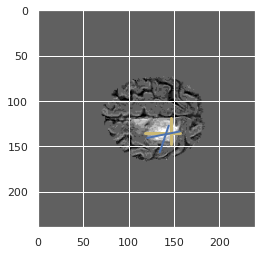

prediction [142.78847  120.525696 132.63264  157.53696  153.84358  136.24202
 129.33464  141.95206 ]


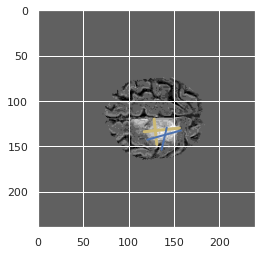

prediction [143.78252  121.105194 133.0096   158.19977  154.03653  137.39786
 130.91116  142.87332 ]


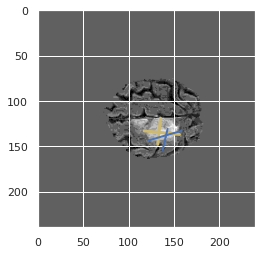

prediction [143.41408 120.14495 134.07594 160.54735 153.34776 139.07144 131.48695
 142.73055]


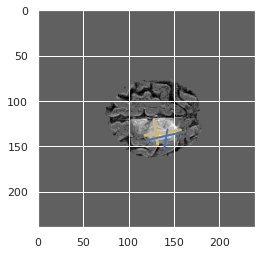

prediction [139.8796   117.192764 134.6083   159.26138  154.39914  136.97566
 128.28285  142.87042 ]


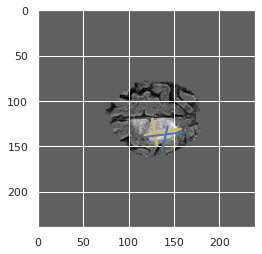

prediction [140.83086 116.18152 133.48897 159.74834 154.59149 136.2673  127.41703
 140.9612 ]


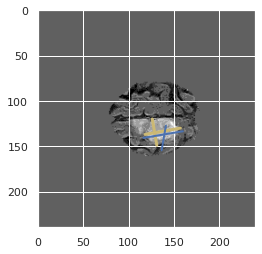

prediction [141.56354 115.08943 132.23761 160.00351 151.93102 135.37247 128.42812
 139.73929]


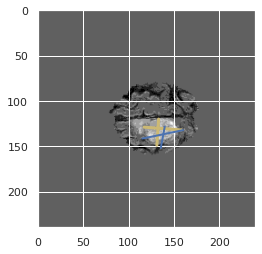

prediction [140.11899  113.914375 130.79301  158.68877  150.58696  133.8638
 127.298996 138.58063 ]


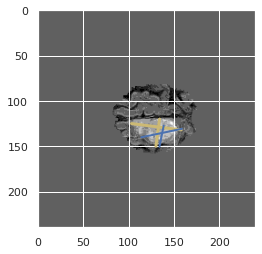

prediction [138.83374 111.68026 129.73146 156.96346 151.12569 132.48453 124.64806
 135.74512]


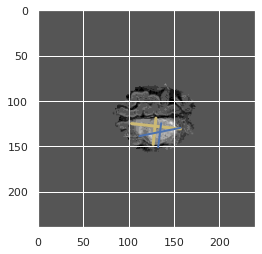

[0.3896523848019402, 0.4283783783783784, 0.3522149600580973, 0.3739193083573487, 0.37824897400820795, 0.39900249376558605, 0.5016722408026756, 0.5584756898817346, 0.5367316341829086, 0.4142857142857143, 0.0, 0.0, 0.0, 0.0, 0.0, 0.3732876712328767]
prediction [140.34258  115.11386  127.100395 157.76004  146.39362  133.48488
 127.9125   135.53778 ]


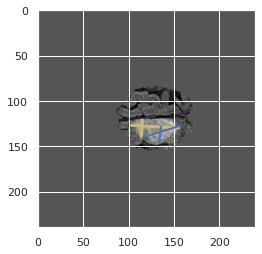

prediction [140.71713 113.68195 128.30101 156.74936 146.89026 132.25879 129.866
 135.30028]


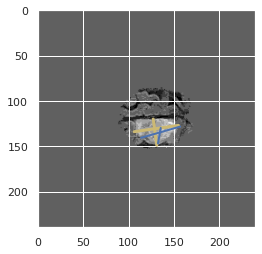

prediction [141.7077  115.3337  129.3315  156.78278 149.76547 131.5463  130.79509
 136.45883]


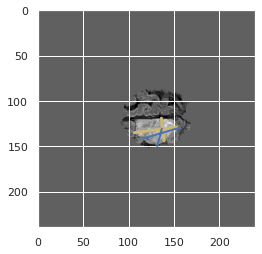

prediction [141.1431  114.60721 129.1765  155.52637 147.91107 131.52122 131.02449
 137.08589]


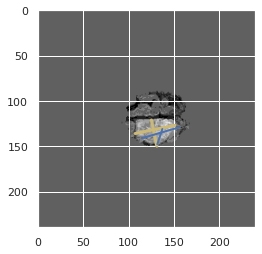

prediction [140.42708  114.290405 131.38406  156.20448  150.48988  132.00659
 130.63313  135.7953  ]


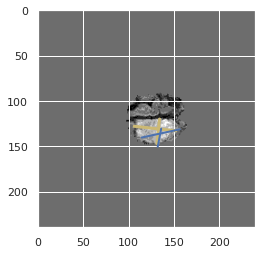

prediction [138.91916 113.51925 129.92337 156.50964 149.56526 129.84177 130.14099
 132.77277]


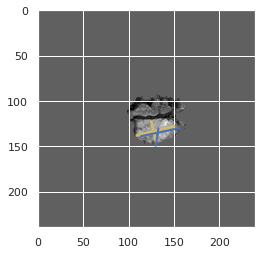

prediction [134.47319  109.602264 128.3017   154.24097  143.5427   126.620514
 131.13974  132.78256 ]


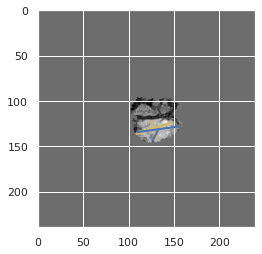

prediction [127.42884 107.08965 126.74666 146.20341 138.74294 120.65301 128.68164
 129.89438]


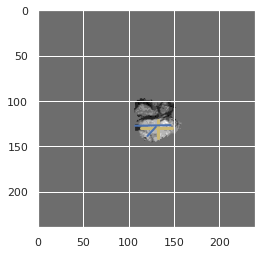

prediction [122.452255 104.94269  124.22001  139.98444  137.20134  117.25867
 121.09896  128.60495 ]


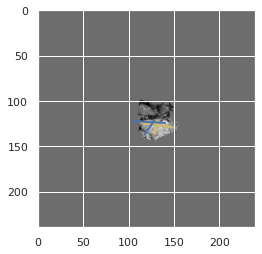

prediction [123.67396  103.84803  126.31071  136.84537  140.14146  118.633705
 119.01179  125.78701 ]


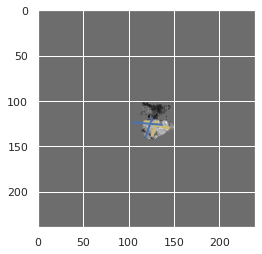

prediction [113.26361  100.89755  120.060936 118.83098  132.03372  110.22849
 106.54468  111.98386 ]


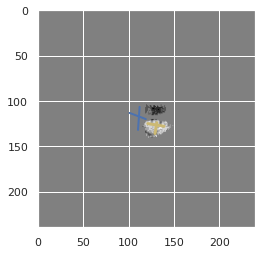

prediction [117.75396  134.61696  114.79431  147.88074  118.423584 144.18675
 115.39846  141.60144 ]


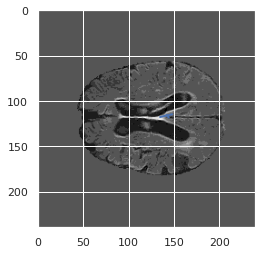

prediction [ 92.327034  94.80835   80.68197  105.87855   91.440384  99.204704
  81.071266 108.13432 ]


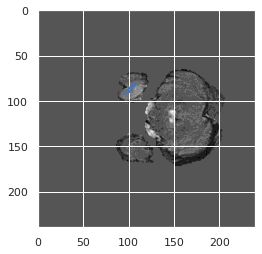

prediction [ 85.22345  87.38175  78.086   102.75609  85.93092  93.43176  75.43902
 100.73853]


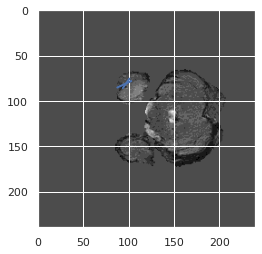

prediction [ 96.22033   95.55453   84.46516  112.499306  95.66294  101.50557
  84.22264  107.092354]


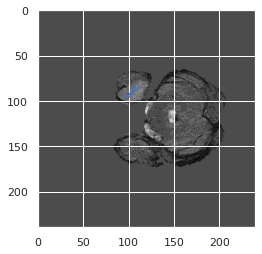

prediction [ 96.75212   98.533035  90.53394  122.2689    99.23351  106.61572
  87.64925  114.13802 ]


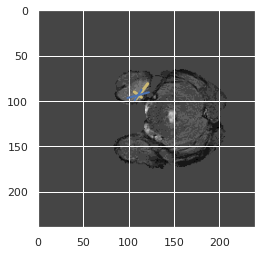

[0.25316455696202533, 0.0, 0.23049001814882034, 0.18450704225352113, 0.2920634920634921, 0.24465558194774348, 0.19155844155844157, 0.3151862464183381, 0.46357615894039733, 0.1781132075471698, 0.530359355638166, 0.6416510318949343, 0.5926724137931034, 0.5169699950811608, 0.544822256568779, 0.5883472962680883]
prediction [101.19697  100.76962   94.138794 117.82869  104.40824  106.560455
  86.68916  112.129295]


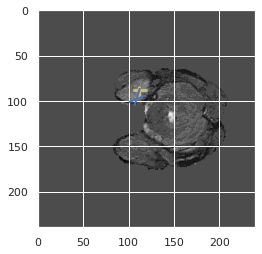

prediction [110.25228  107.32668   97.15099  126.19935  106.01762  118.131996
  98.078156 120.58385 ]


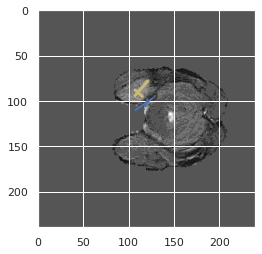

prediction [ 99.89388  94.67311  92.03845 124.52285  97.12097 112.91468  92.15378
 110.54219]


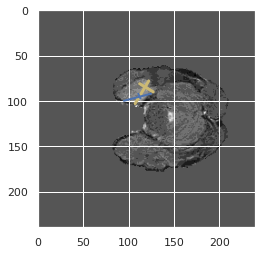

prediction [ 88.66915   84.443     86.306694 124.69975   94.01096  106.29528
  79.721275 102.14036 ]


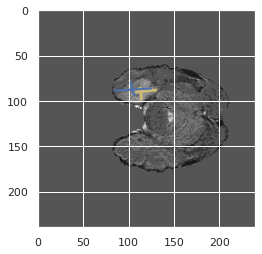

prediction [ 85.95689   88.45781   92.78549  133.98497   95.29655  111.912025
  82.63868  110.81514 ]


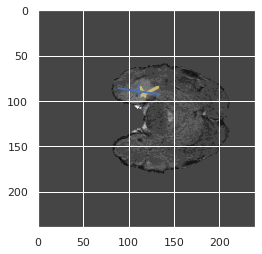

prediction [ 87.55673   91.32357   93.50575  140.22571   94.38507  113.16133
  88.000565 114.87107 ]


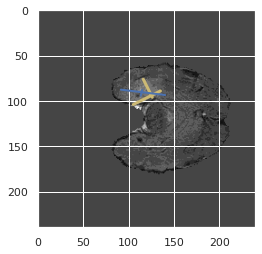

prediction [ 90.48052   89.525635  90.117744 144.09816   87.32734  114.65701
  92.91907  118.31095 ]


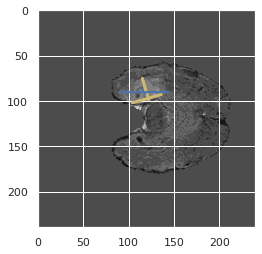

prediction [ 89.99571  87.61126  91.40633 148.554    83.69879 118.28448  94.69927
 120.89433]


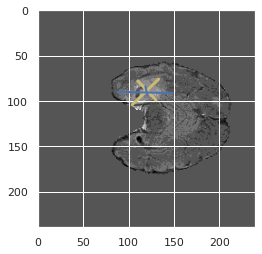

prediction [ 93.38439   90.26895   96.34733  154.523     82.9729   123.42839
  98.60832  126.246124]


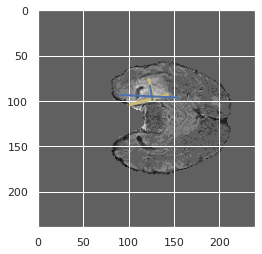

prediction [ 93.8789    91.17016   95.09104  154.00179   89.676445 120.72303
  92.3151   125.64617 ]


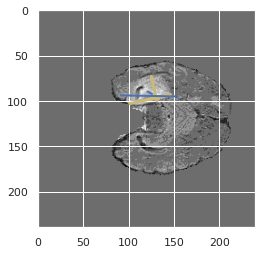

prediction [ 92.9875    92.67487   95.37057  152.58572   99.853195 118.39815
  81.86763  124.783455]


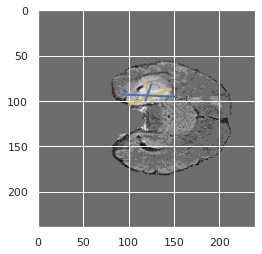

prediction [ 90.37943   96.11521   97.26647  151.68042  101.71951  121.763145
  81.44427  130.19186 ]


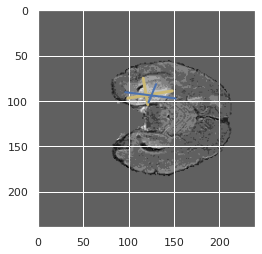

prediction [ 89.61886   96.61953   98.186584 154.03851  105.12596  123.92121
  81.0639   133.09514 ]


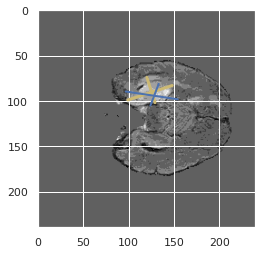

prediction [ 91.670876  93.02507   96.50662  165.41513   99.93476  128.09
  82.34179  134.5228  ]


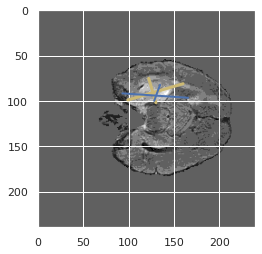

prediction [ 91.39386   94.837654 100.344894 177.50317  100.67714  134.28387
  76.123985 137.91585 ]


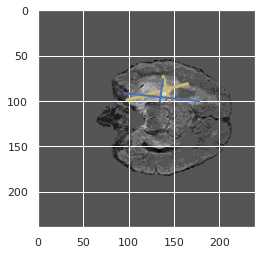

prediction [ 90.53847   97.66216  101.58766  183.52968   96.83897  139.0913
  71.194046 140.92155 ]


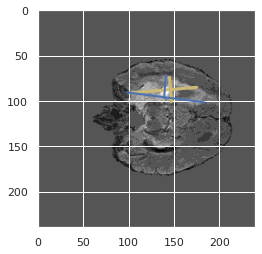

[0.6952587766920014, 0.5740740740740741, 0.4694226170140075, 0.4110912343470483, 0.4455187802156936, 0.6004540295119183, 0.5380855397148676, 0.6086330935251798, 0.3996101364522417, 0.6052219321148825, 0.5403659849300323, 0.27598566308243727, 0.2988505747126437, 0.03134110787172012, 0.1596958174904943, 0.10963244613434728]
prediction [ 92.36536 102.70435 101.12065 188.29387  97.73166 140.86911  73.36183
 144.13007]


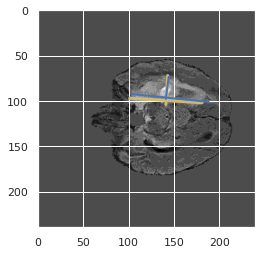

prediction [ 90.18159 101.224    99.31925 186.45695  93.72662 140.71564  75.64629
 142.63042]


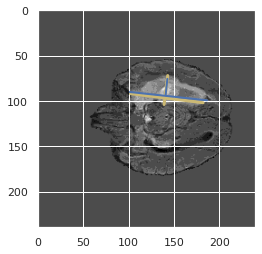

prediction [ 92.0777   102.55781   99.419624 186.88748   90.86979  144.17244
  79.6943   142.75877 ]


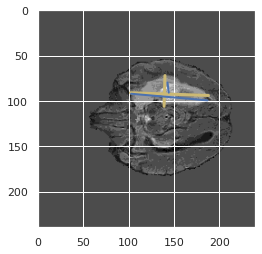

prediction [ 96.72873  104.382545 101.82502  187.36208   90.142136 143.68443
  85.22197  143.80246 ]


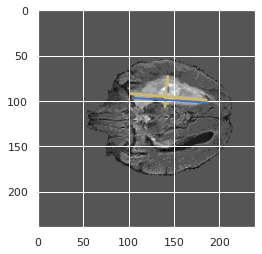

prediction [100.68272 106.39697 103.21154 188.4629   86.60804 145.00774  89.03124
 145.54045]


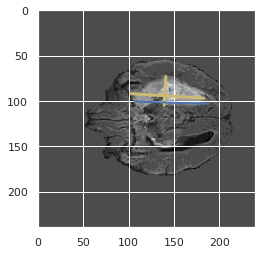

prediction [ 98.15571  107.27489  104.315155 184.19194   80.31547  145.17717
  91.90246  149.91039 ]


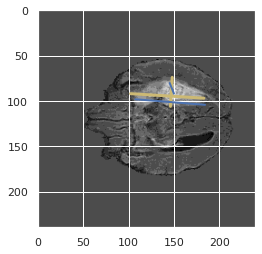

prediction [ 96.4045  107.9148  101.7643  183.31235  81.53796 148.59421  91.98385
 152.66417]


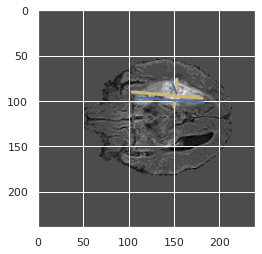

prediction [ 97.444916 109.88743  104.25871  182.47725   80.7383   153.33972
  99.01151  156.3536  ]


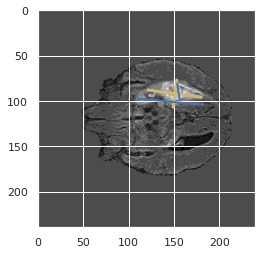

prediction [ 95.41132  106.493286 101.1814   182.35364   86.4775   154.75514
  94.2953   154.53934 ]


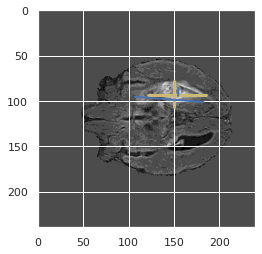

prediction [100.43056 112.42411 104.10108 179.99919  84.72296 156.48975 106.55231
 155.24884]


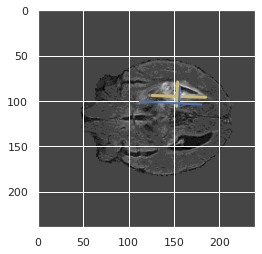

prediction [ 97.99617 114.05689 103.40301 176.4374   81.57876 151.72743 106.88118
 151.29234]


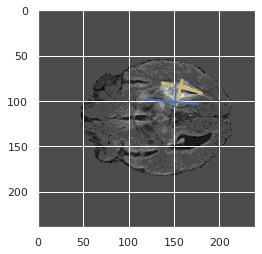

prediction [ 99.333176 119.53417   96.83086  175.82706   90.19312  150.78227
  96.94962  151.35376 ]


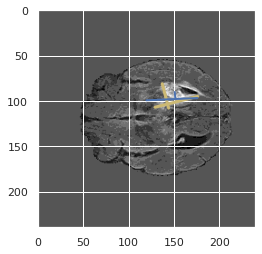

prediction [102.339775 128.8457    93.41221  178.0434    91.253075 154.05162
 100.759674 159.35014 ]


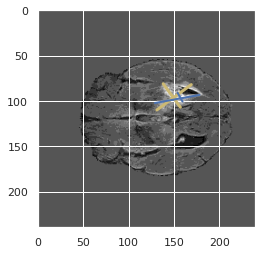

prediction [101.28378  131.92328   90.370155 176.79349   96.09587  154.41608
  96.2406   156.71632 ]


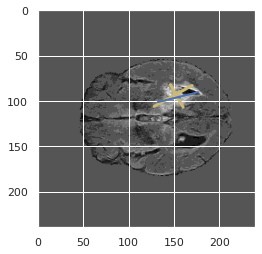

prediction [101.79315  130.89734   92.78088  176.00755   93.72474  151.79346
  99.412445 151.38991 ]


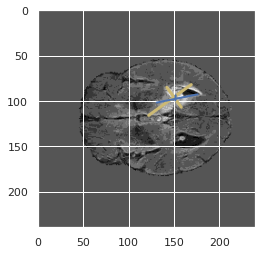

prediction [100.17182  128.51204   92.4476   168.26805   98.033966 146.10764
  93.23121  148.66522 ]


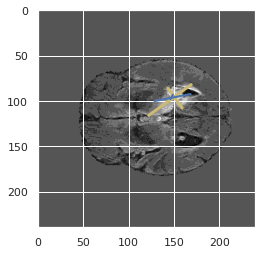

[0.06760374832663989, 0.20827858081471748, 0.3658759124087591, 0.45640074211502785, 0.2631578947368421, 0.12637362637362637, 0.09329221279876639, 0.3851132686084142, 0.6036363636363636, 0.5582278481012658, 0.49838187702265374, 0.32156368221941994, 0.4385150812064965, 0.1731266149870801, 0.0, 0.0]
prediction [100.180405 122.71712   93.87675  169.4599    95.90308  141.60027
  94.931725 144.21906 ]


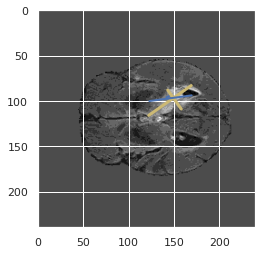

prediction [101.7326   120.9849    95.77728  170.86537  100.88971  142.09003
  93.594055 142.5     ]


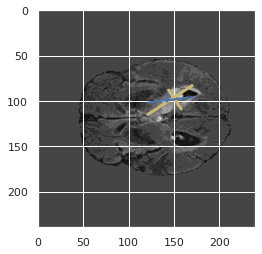

prediction [109.26532  118.28123   94.71352  166.94263  104.26618  138.53864
  95.429245 136.68132 ]


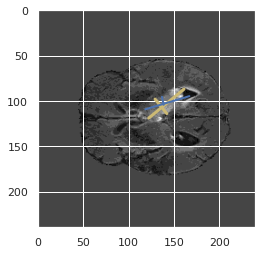

prediction [113.01488  117.43266   93.81149  164.02257  105.928825 137.67686
  95.35372  135.70479 ]


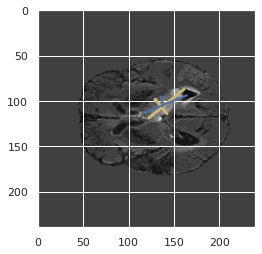

prediction [112.13371  114.70194   88.81297  157.39317   99.9957   133.29065
  94.539375 131.18965 ]


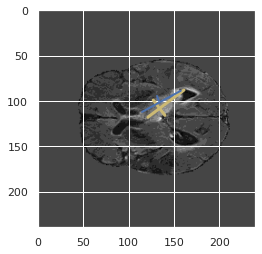

prediction [109.51039  112.869194  88.07596  151.69414   99.03331  127.26862
  93.5958   127.90848 ]


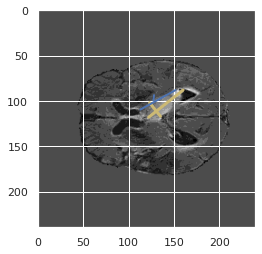

prediction [109.20124 111.79132  89.94628 150.51912 101.6554  125.39141  93.77667
 125.3709 ]


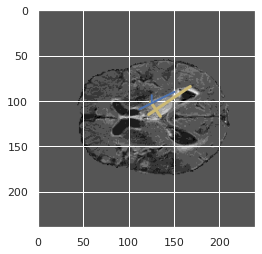

prediction [107.3483  113.73493  94.46578 151.44493 109.48147 130.40053  91.45966
 128.75874]


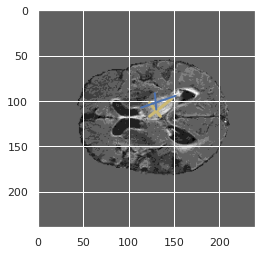

prediction [109.988335 115.18996   97.2255   151.69849  113.503    130.9405
  94.924644 129.81491 ]


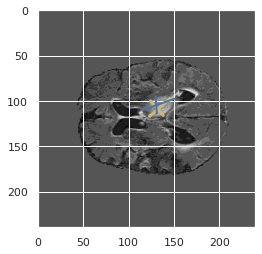

prediction [110.1658   116.94491  101.83867  153.6931   116.90388  132.49612
  96.975075 131.2196  ]


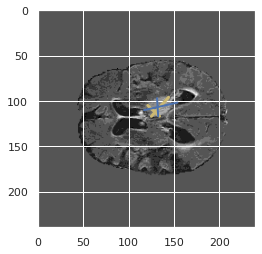

prediction [ 99.508675 117.27992  101.78206  153.91533  113.54302  136.11325
  89.11853  131.75244 ]


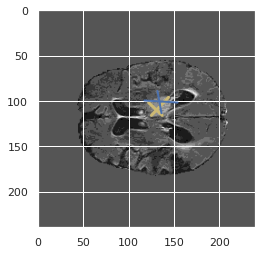

prediction [ 97.45687  113.143105  99.79581  152.2346   106.57391  131.66133
  90.6937   129.13292 ]


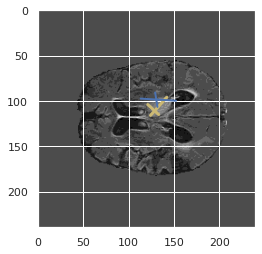

prediction [110.19962  117.75235   99.818794 144.54088  107.387314 134.39516
 101.42469  127.82248 ]


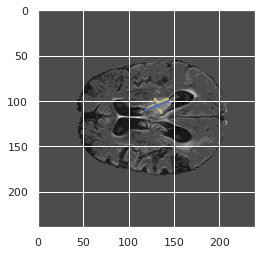

prediction [118.726295 122.54206  106.387535 136.26817  113.728584 132.28038
 108.06319  130.31595 ]


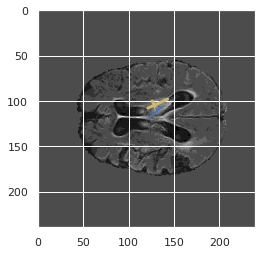

prediction [129.52002  133.43373  116.87931  145.02432  126.259285 138.50626
 119.30052  141.60402 ]


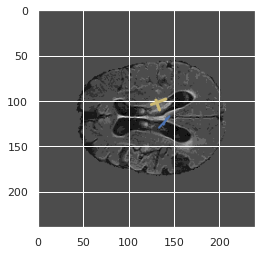

prediction [130.40562  144.51715  121.15676  153.5138   130.12589  148.03976
 122.716896 150.24986 ]


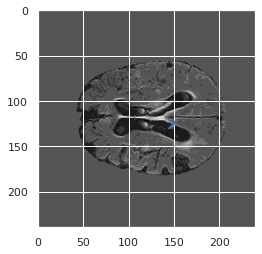

[0.0, 0, 0.0, 0.0, 0.0, 0.3970149253731343, 0.5651041666666666, 0.6612339930151339, 0.25718015665796345, 0.1791713325867861, 0.2944214876033058, 0.41285296981499514, 0.6014551333872271, 0.621900826446281, 0.5981932443047918, 0.5894780447390223]
prediction [125.83916 141.12462 121.13532 152.90433 126.4193  148.8935  122.06656
 147.55408]


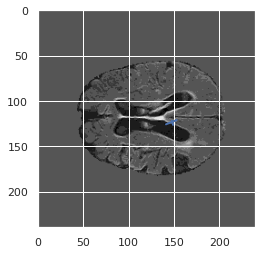

prediction [-0.45084682  0.9346951  -0.7832507  -0.60524344 -0.6609386   1.1989838
 -0.83436495  0.7349634 ]


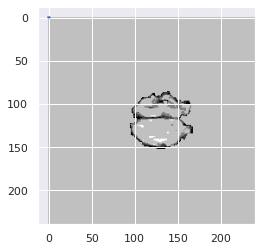

prediction [75.82378  72.75878  69.90972  72.08006  78.94537  73.031586 65.99996
 70.52499 ]


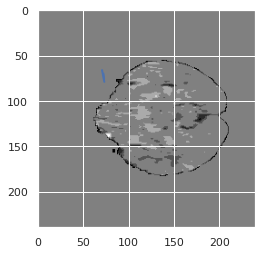

prediction [66.1496   66.662384 58.418713 62.829384 64.352905 65.84332  57.865364
 65.5914  ]


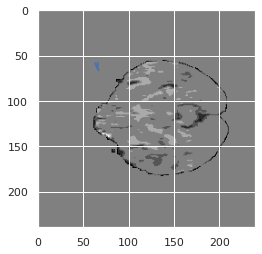

prediction [68.32088  53.12926  67.34341  60.058136 75.68779  55.70012  59.6763
 53.4285  ]


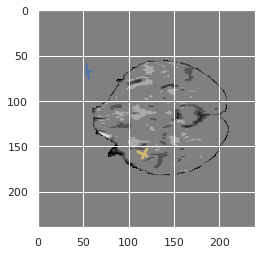

prediction [156.85559 114.10804 154.54648 119.31919 167.98128 119.39393 151.20836
 124.26797]


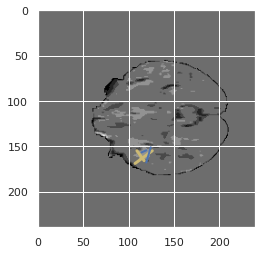

prediction [152.35982  101.254005 162.70517  122.2032   170.24602  113.64492
 151.31668  124.89616 ]


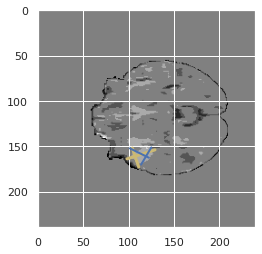

prediction [152.78528  95.68882 159.99794 125.93141 171.5929  106.16767 147.25114
 120.27985]


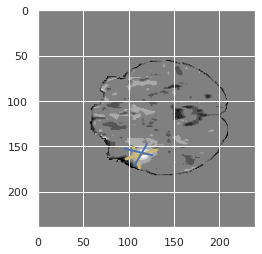

prediction [158.22392   97.980385 155.5195   127.20099  170.48328  105.61665
 149.81439  122.494484]


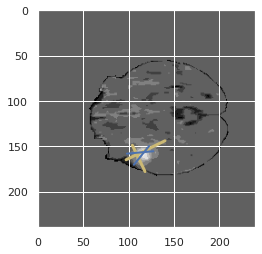

prediction [158.53705  98.50449 152.28886 124.50924 168.7539  105.98339 148.6598
 121.76342]


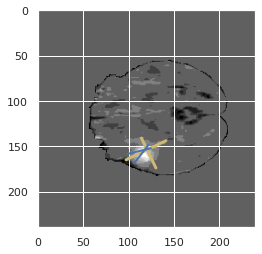

prediction [158.2702    96.40725  155.03358  128.45728  172.11885  111.060234
 147.57979  119.69569 ]


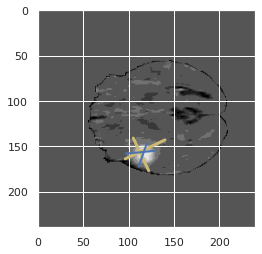

prediction [159.45721   96.58573  159.53914  134.78424  180.00027  114.318924
 143.57559  120.436966]


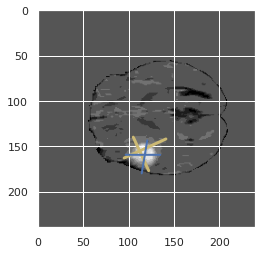

prediction [158.0084   97.28743 166.3183  137.50566 185.2132  114.10863 141.5173
 124.53821]


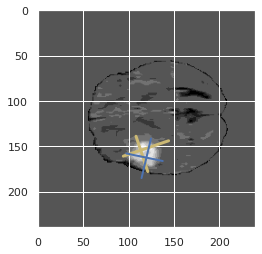

prediction [155.6895    95.06294  167.98827  138.17097  183.3155   115.283646
 140.17097  126.437416]


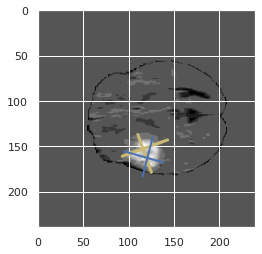

prediction [157.73993   98.702896 172.78444  142.2325   183.96681  121.140785
 143.73738  131.15723 ]


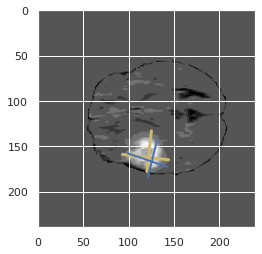

prediction [159.52275  98.59747 168.31793 145.14137 176.88919 122.82222 146.58905
 130.85799]


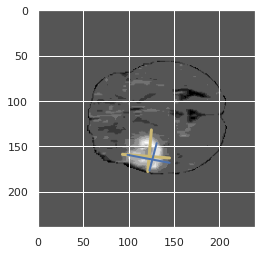

[0.6316993464052287, 0.6254623921085081, 0.6120619396903015, 0.6714285714285714, 0.7010130246020261, 0.7766990291262136, 0.7670387081453337, 0.6922898819171105, 0.7402298850574712, 0.7375988497483824, 0.6590336615525533, 0.6350699469368065, 0.6880424300867888, 0.6452442159383034, 0.6073806881243063, 0.7789731051344744]
prediction [158.63449   94.394775 170.6853   149.1579   182.29568  123.17641
 140.79669  129.51306 ]


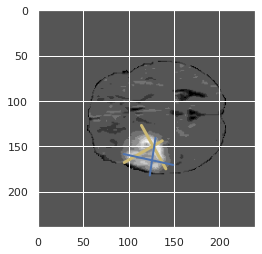

prediction [158.49724  92.28696 169.98901 152.05779 179.95903 123.1229  138.59422
 128.50691]


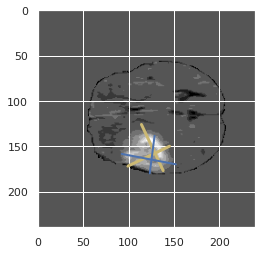

prediction [162.84445  90.69392 168.63101 157.71489 180.15755 123.82364 140.15776
 129.10512]


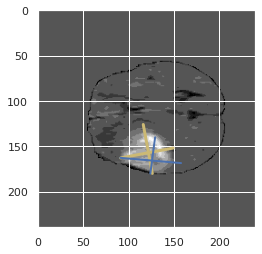

prediction [162.07227   88.1181   168.66335  156.45927  180.401    123.09329
 138.9485   127.744965]


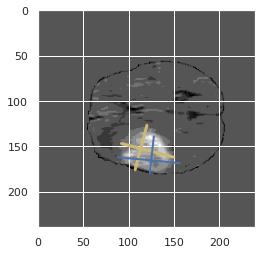

prediction [161.70348   86.444305 166.7784   152.14963  179.33447  120.17924
 136.64372  127.167694]


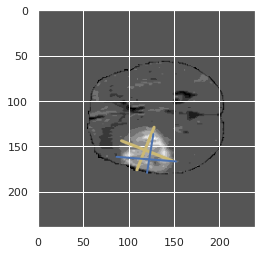

prediction [158.33269  87.58053 168.23871 155.37517 181.66153 121.72271 132.00285
 127.92506]


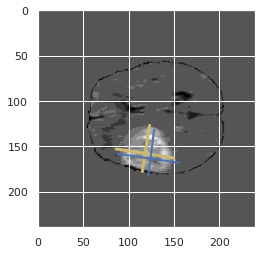

prediction [156.99054  88.84208 167.0704  155.5104  184.99667 120.85222 126.34196
 128.00014]


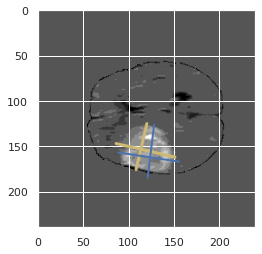

prediction [155.81348  90.12635 166.16162 154.94186 186.16539 120.01562 123.0335
 129.06252]


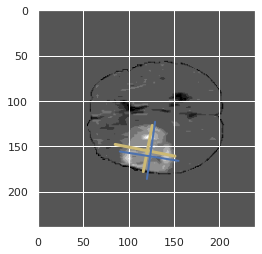

prediction [155.98238  90.67068 165.07574 154.79572 184.42392 121.78586 123.04111
 130.12003]


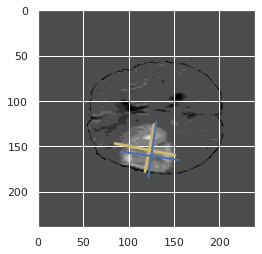

prediction [153.86815  92.84309 167.30319 154.89363 182.98251 119.78955 123.31019
 133.19937]


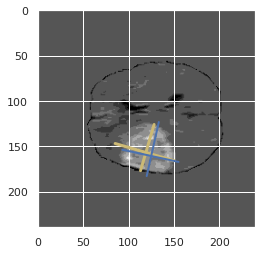

prediction [154.3519    94.180565 167.83313  155.46553  184.07982  120.14283
 122.12321  135.1905  ]


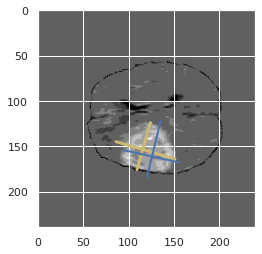

prediction [152.68272  94.13487 164.4942  154.49046 181.54265 119.02159 120.19522
 134.54805]


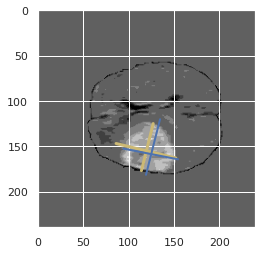

prediction [152.22208  94.35273 163.2463  153.6085  181.02422 119.33625 119.0562
 134.82895]


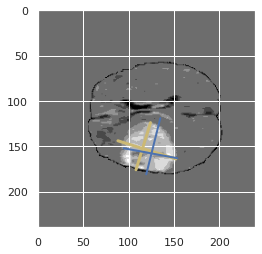

prediction [153.63954   94.312836 163.92317  154.7667   181.203    119.397964
 120.26635  134.50626 ]


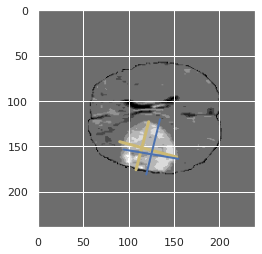

prediction [155.36365   94.14848  163.32288  154.93181  180.03464  119.65302
 122.795204 132.84776 ]


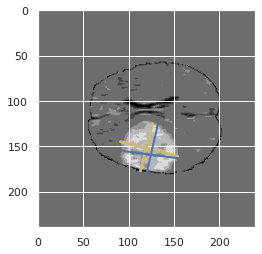

prediction [155.15608  93.62174 164.4704  157.80664 181.43542 123.06475 123.71779
 133.25   ]


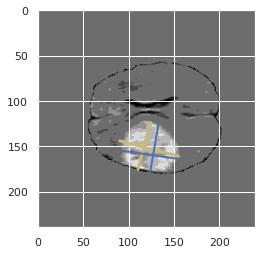

[0.8012108980827447, 0.7606541129831517, 0.7580160320641283, 0.7496950475725787, 0.7756329907244923, 0.7800678952473327, 0.7421001458434614, 0.7398705346439702, 0.7378761502113902, 0.7916233090530698, 0.8045797553994275, 0.7544363256784968, 0.7021651560926485, 0.6803713527851459, 0.7603960396039604, 0.7074047447879224]
prediction [152.54926  94.55741 163.87988 157.83289 177.93832 123.56604 123.79589
 134.96782]


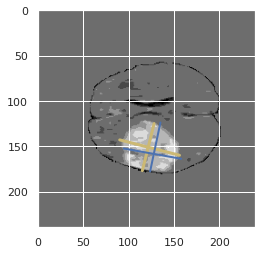

prediction [152.05032  96.21592 165.76176 158.94106 176.79192 124.471   125.32772
 138.00314]


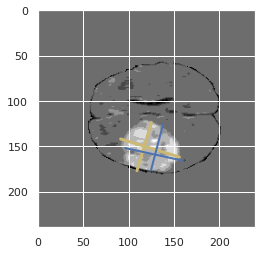

prediction [151.40195   95.6156   164.78658  158.9532   175.39832  123.49553
 125.496445 136.50168 ]


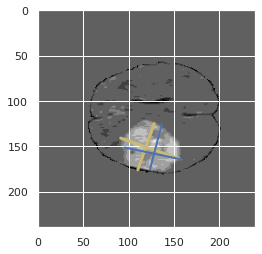

prediction [148.88074   96.211075 166.55464  159.8982   175.48608  124.21246
 124.863174 136.92247 ]


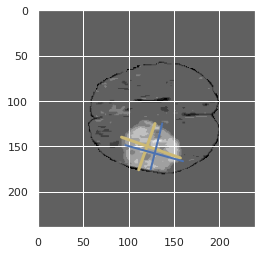

prediction [148.5959   96.20924 165.79881 160.2385  175.1871  124.05734 125.71851
 136.0939 ]


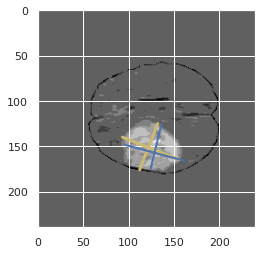

prediction [148.76396  96.07714 164.57988 160.68782 175.5659  124.65867 124.66716
 136.38728]


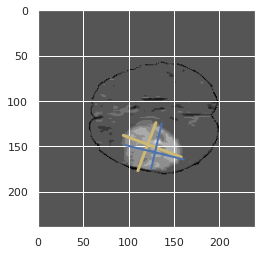

prediction [147.55338   96.804924 164.24854  162.50856  175.15329  126.290245
 124.85941  137.20676 ]


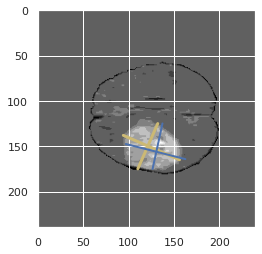

prediction [146.04451   95.29223  162.7523   160.31418  176.12675  125.855415
 121.65438  134.85735 ]


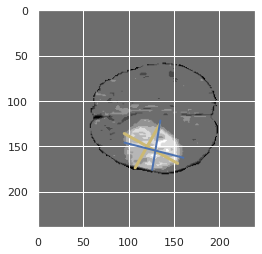

prediction [146.65651   96.277985 160.66237  158.87424  173.79613  124.59207
 124.10551  135.31615 ]


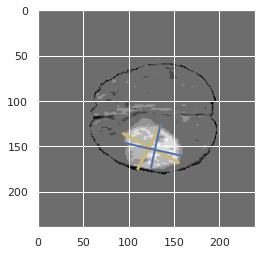

prediction [148.60075  96.41914 161.71802 157.63802 175.29883 125.63232 124.01643
 135.12369]


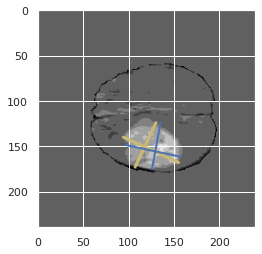

prediction [148.97739  95.93388 160.5779  157.3245  176.4004  125.67364 122.88827
 133.6462 ]


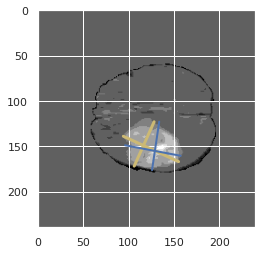

prediction [150.06297  95.86882 158.17014 156.4752  177.99979 129.14    121.46713
 132.87605]


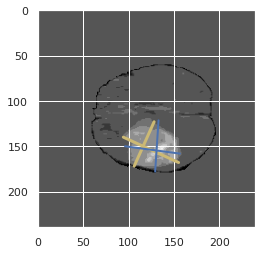

prediction [150.0661    95.56852  153.77478  156.40373  176.55887  127.071976
 121.626526 130.39053 ]


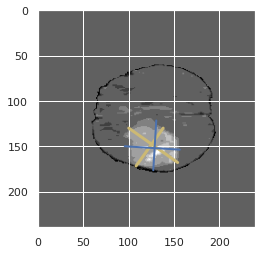

prediction [151.95078   96.28112  152.3668   155.03723  177.01126  127.771904
 120.120544 129.49391 ]


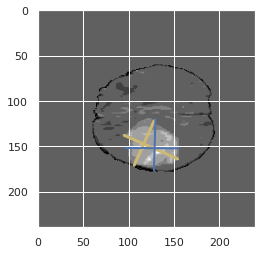

prediction [155.61655  97.80785 150.3962  156.4938  181.84306 128.04749 119.06642
 128.53609]


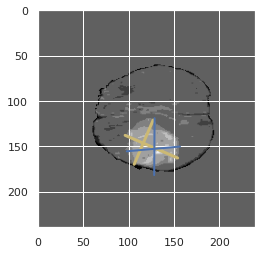

prediction [152.81273  98.71938 148.6315  155.98999 184.59412 127.0607  116.25408
 126.04412]


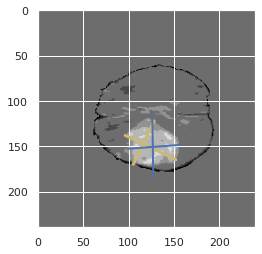

[0.6876310272536688, 0.6062480668110114, 0.5540192926045016, 0.48125633232016213, 0.4420116318850496, 0.49576868829337095, 0.5139949109414759, 0.48761742100768574, 0.3919694072657744, 0.4753623188405797, 0.4230769230769231, 0.5410187667560322, 0.45617070357554784, 0.28792912513842744, 0.20083184789067143, 0.22262996941896024]
prediction [151.1056    98.880714 144.76793  154.10838  178.41837  120.95177
 118.1162   122.72757 ]


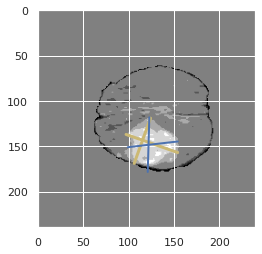

prediction [155.42958  100.665985 143.78773  157.70657  178.61482  120.6868
 123.098724 122.3212  ]


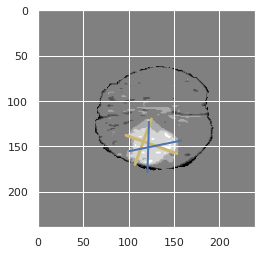

prediction [158.62828 104.14562 142.96246 158.52405 174.50436 122.2723  129.57814
 127.36199]


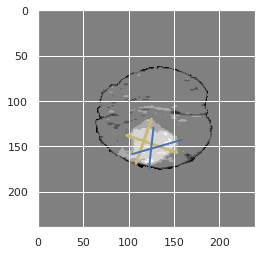

prediction [157.3156  105.82539 139.9063  155.56215 172.2681  125.04066 128.20378
 129.7977 ]


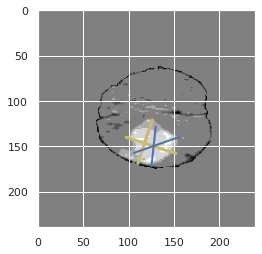

prediction [156.94122 106.83251 139.46875 153.59618 171.1595  126.19032 127.81227
 129.91588]


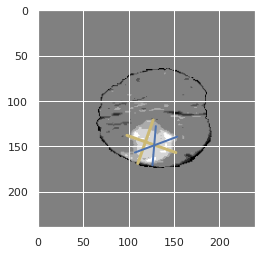

prediction [156.44873  106.12985  139.9226   153.09451  169.52751  127.13255
 129.18446  127.995674]


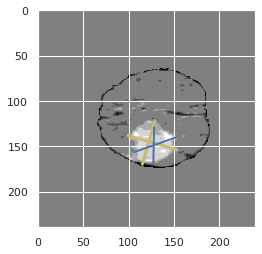

prediction [155.34981 106.36085 142.71045 152.90944 170.02678 129.18172 129.60297
 129.44064]


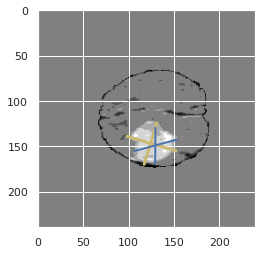

prediction [157.43811  107.376656 143.44101  151.21016  172.91321  133.01279
 129.89565  131.13934 ]


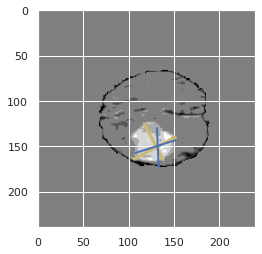

prediction [155.02307 110.51519 143.82962 147.80702 169.34677 130.90173 131.77701
 134.38739]


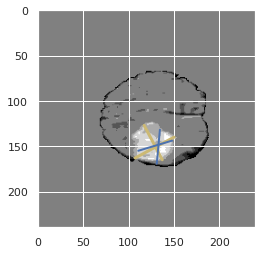

prediction [155.04274 112.01744 147.41025 147.5656  173.31573 130.99086 132.42314
 134.56572]


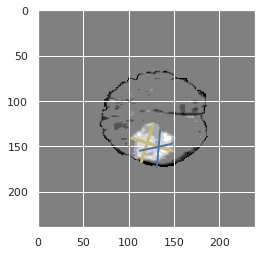

prediction [155.93533 110.43056 148.97055 148.61348 173.29991 131.3683  134.07848
 132.05986]


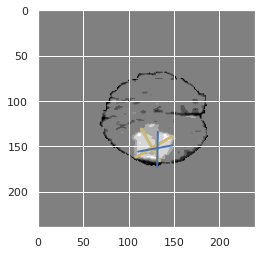

prediction [159.3747  108.51848 148.15604 149.06348 169.18074 131.57338 141.01257
 128.85245]


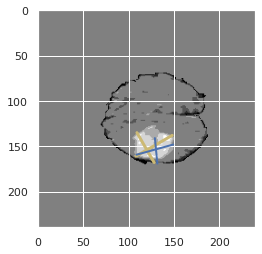

prediction [160.92267 111.36656 148.29254 148.12646 166.90549 129.50664 144.05618
 129.20236]


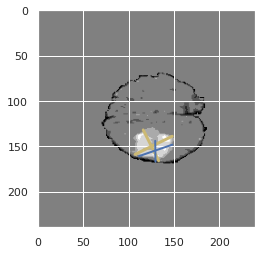

prediction [159.98592 113.13188 146.47612 144.6595  164.15932 126.94501 144.61226
 128.94214]


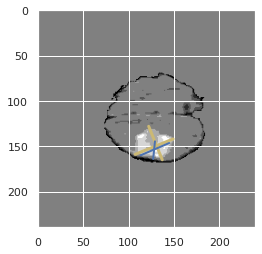

prediction [155.78844 112.46586 145.57149 141.93181 159.7673  124.32065 144.32889
 130.26001]


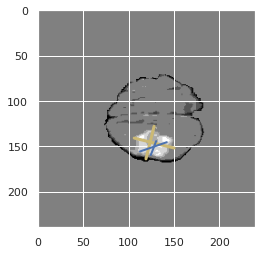

prediction [150.62024  110.38543  142.03772  138.94821  156.10117  123.463066
 139.52118  128.25095 ]


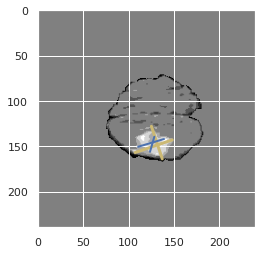

[0.14908256880733944, 0.2873362445414847, 0.32112970711297073, 0.29753265602322204, 0.18962722852512157, 0.14505119453924914, 0.30685920577617326, 0.40082644628099173, 0.2108843537414966, 0.0, 0, 0, 0, 0.0, 0.0, 0.22939560439560439]
prediction [152.19014 115.35077 145.21164 140.91347 154.98291 129.40613 144.37654
 137.68733]


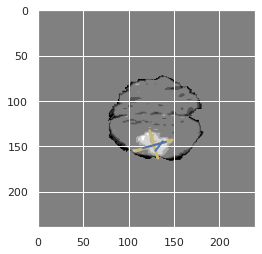

prediction [152.9771   115.351135 147.07704  142.09398  159.78577  130.28629
 143.272    137.88724 ]


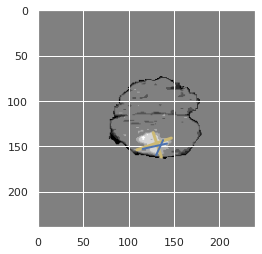

prediction [148.28929 114.21227 144.5008  136.26466 157.91898 126.95811 139.85294
 133.48077]


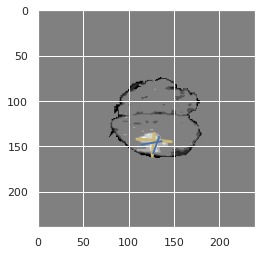

prediction [146.33948  117.02565  145.34926  133.14009  155.71085  127.181725
 142.04271  133.19983 ]


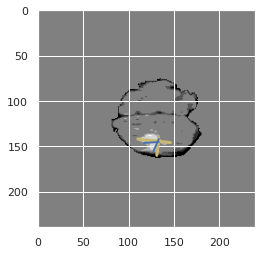

prediction [148.4978  118.82542 146.13539 133.22278 154.0435  126.65249 146.11487
 134.42296]


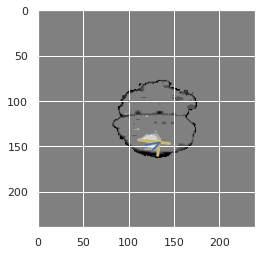

prediction [144.31213 117.94914 145.39552 134.81961 148.71873 126.01538 142.96082
 134.44933]


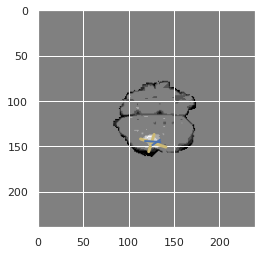

prediction [147.36485 116.44391 143.05293 134.817   151.97708 125.65311 143.19376
 129.83243]


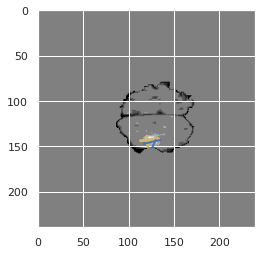

prediction [142.07874 116.18928 142.19649 132.06404 145.04057 124.31921 137.00946
 130.19994]


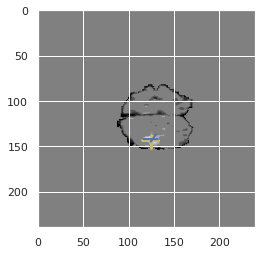

prediction [147.25192 114.93268 140.14178 129.28815 146.95009 121.41314 140.71626
 127.02118]


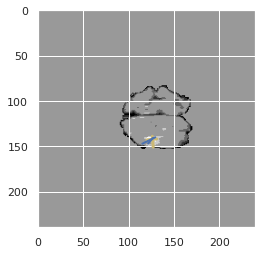

prediction [144.216   118.40826 132.08005 130.11957 139.40816 123.32683 136.40512
 129.1439 ]


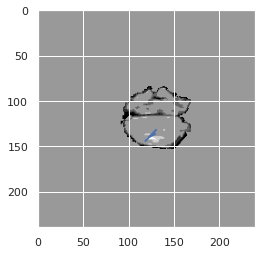

prediction [5.6625724 5.6029687 4.2730365 5.234413  5.180985  4.696433  4.686988
 5.1624837]


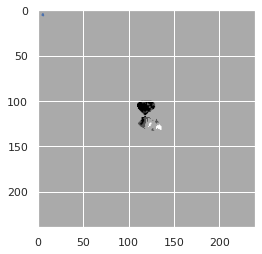

prediction [-1.7783784  -0.6795727  -2.9992533  -4.624588   -0.78447485 -1.4748169
 -4.0460863  -1.5888709 ]


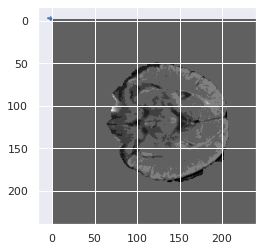

prediction [-1.5030805  -0.6864823  -2.0897992  -4.186       0.8026523  -1.0441645
 -4.4889483  -0.96149325]


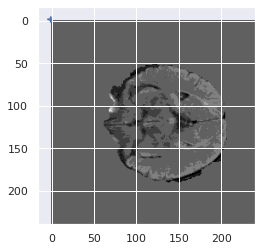

prediction [ 0.7154124  1.0688621  5.7473607  2.321455   8.695913   2.787537
 -3.263948   1.5926074]


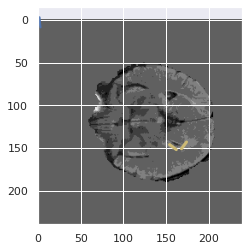

prediction [107.237656 133.15459  116.73933  148.33585  121.93045  140.72542
 104.646904 139.51984 ]


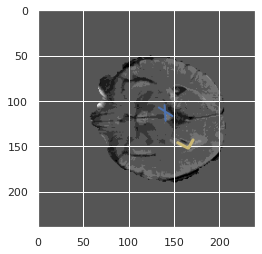

prediction [136.21782 169.26831 154.72008 196.84343 158.12856 175.54033 134.30034
 169.3719 ]


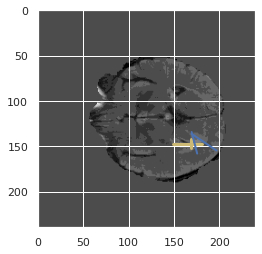

[0.2986425339366516, 0.4178302900107411, 0.4930555555555556, 0.3802739726027397, 0.35782108945527236, 0.34389561975768873, 0.4962825278810409, 0.3360337005832793, 0.261045426260112, 0.2390184792487125, 0.2818892900120337, 0.16363636363636364, 0.2533972821742606, 0.4098444274419791, 0.38227416605794984, 0.3066601610148817]
prediction [141.65755 150.30653 133.60968 189.08418 151.00266 164.25015 135.34341
 158.24751]


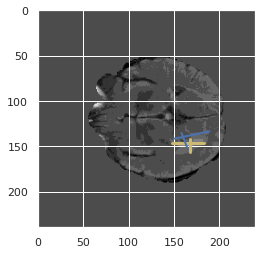

prediction [152.06421 145.98772 135.03395 188.66956 158.14159 164.01062 140.6581
 153.13426]


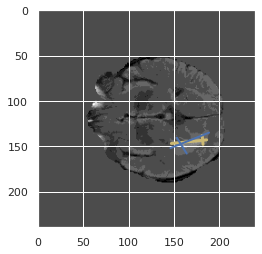

prediction [155.27335 146.96466 140.1335  192.66489 163.27377 165.18762 143.22226
 153.41667]


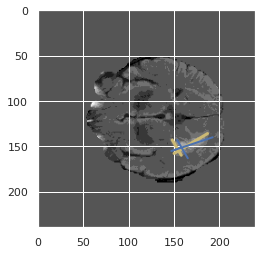

prediction [156.0758  148.85155 141.18076 197.04651 167.2501  167.6899  142.67358
 154.96263]


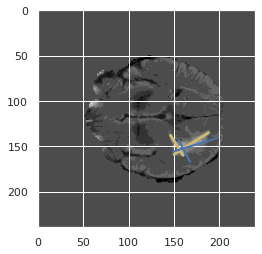

prediction [156.94363 148.68423 139.47986 197.91092 166.97571 169.47182 144.40579
 156.2038 ]


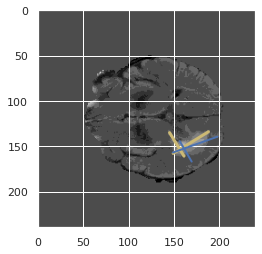

prediction [154.58983 147.38242 140.68913 199.51367 167.14868 171.86769 143.78548
 158.47543]


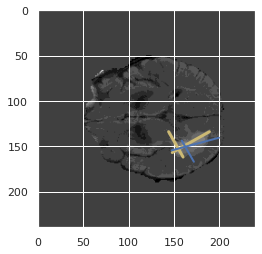

prediction [148.58015 141.22556 138.81633 199.24779 164.31418 172.31091 141.31604
 158.29211]


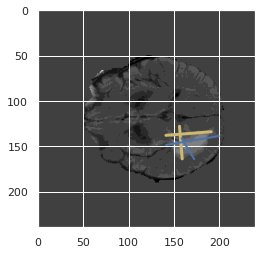

prediction [144.40546 125.82234 129.20778 195.01721 151.90176 161.93025 141.26492
 152.50107]


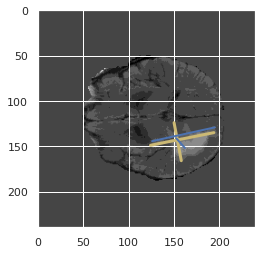

prediction [147.62381 128.85745 129.98396 195.72772 151.49152 162.9     141.77281
 155.43636]


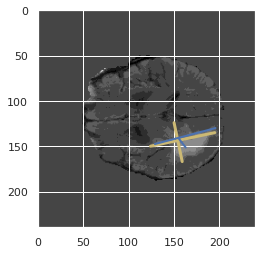

prediction [148.03847 128.19287 129.1823  193.35983 150.4993  160.59248 141.81926
 155.80264]


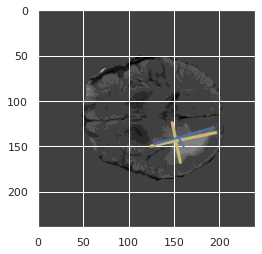

prediction [152.46169  125.492035 125.25664  192.40413  152.06696  160.23083
 141.29318  152.29068 ]


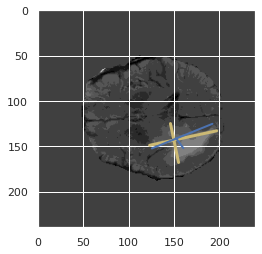

prediction [155.47932  126.792885 125.61387  194.20349  145.59291  157.80435
 150.38986  157.47302 ]


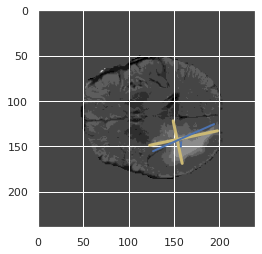

prediction [157.30986  127.09707  123.876976 193.18907  141.19699  153.6965
 153.20808  158.4536  ]


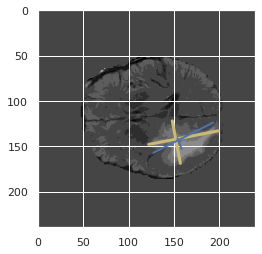

prediction [157.45412  125.469475 124.48953  191.90822  136.22607  151.88818
 155.97476  160.69905 ]


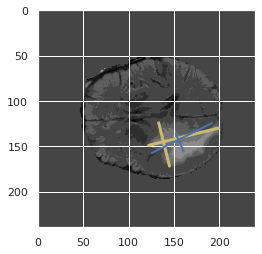

prediction [158.83322 127.26712 123.23211 191.74835 138.41405 150.17719 156.21349
 162.03375]


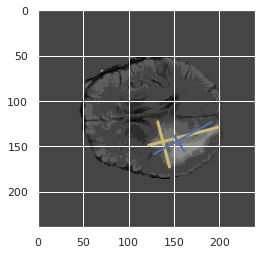

prediction [157.63345  127.78498  124.808586 192.5559   141.47604  147.92975
 154.24489  161.14374 ]


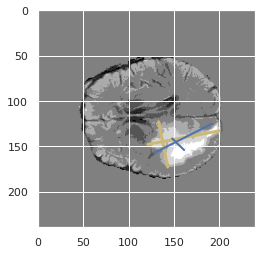

[0.13958810068649885, 0.1321485532011848, 0.19346347883307743, 0.18019142738243862, 0.22581284694686757, 0.2373864295379857, 0.26449548192771083, 0.2981614708233413, 0.2225524800297232, 0.20646910710827038, 0.2381970079658053, 0.1684730937440578, 0.09272278168345051, 0.16818700114025084, 0.22852266262089893, 0.23254043767840152]
prediction [152.67079  125.906975 123.65951  189.05424  145.03291  145.68663
 147.80164  157.13406 ]


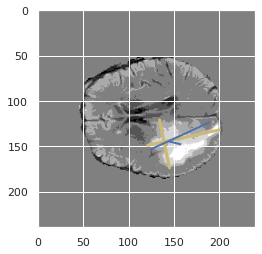

prediction [150.96838  126.352196 125.59892  188.81508  151.19862  147.08289
 143.42632  157.35963 ]


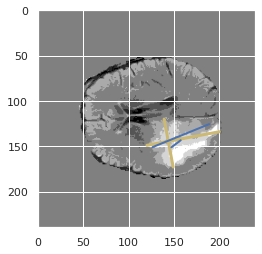

prediction [146.58034 124.34725 126.25096 186.45634 152.96783 144.95154 138.37755
 154.93059]


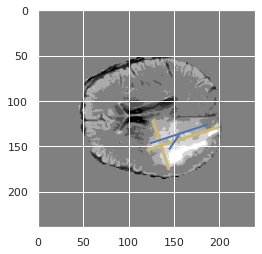

prediction [145.06647 122.82055 123.42208 185.42044 151.4163  141.55391 136.02985
 152.3172 ]


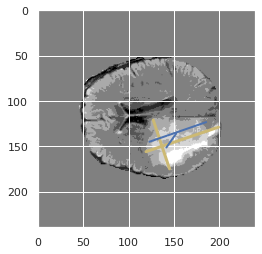

prediction [145.38937 123.1344  123.35482 188.10802 154.82779 143.19313 133.94156
 151.95613]


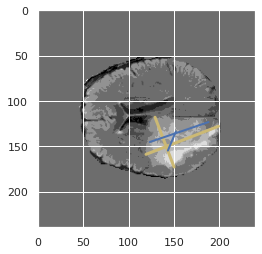

prediction [147.29146 123.25687 124.84643 194.34888 155.1902  145.06631 134.31679
 153.17589]


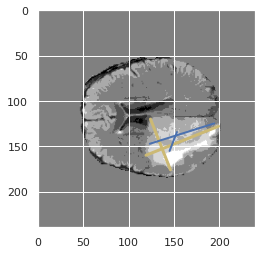

prediction [148.66885  122.587685 124.38176  194.74706  156.86162  144.76845
 133.2942   153.20166 ]


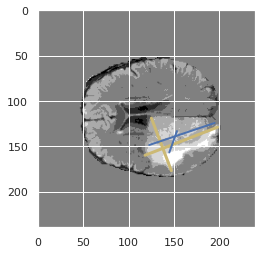

prediction [149.18758  122.13786  126.037926 194.02727  157.95837  144.76807
 133.52136  152.36711 ]


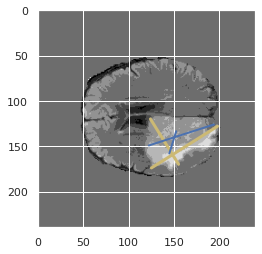

prediction [150.01163 122.52275 126.05599 195.72968 155.513   145.34488 135.27979
 154.3459 ]


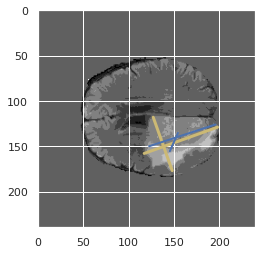

prediction [147.14137  122.662224 126.485985 193.93697  153.33786  145.25337
 134.82307  154.62767 ]


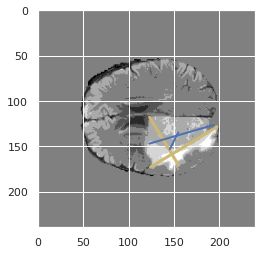

prediction [144.61725 119.94758 126.36476 191.5078  152.87012 144.43315 133.0459
 152.0406 ]


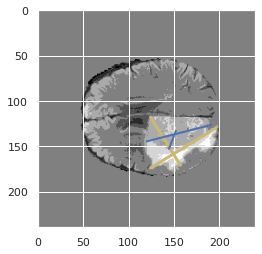

prediction [144.76244  117.601845 126.053925 189.94337  149.72789  142.21822
 135.04314  150.80988 ]


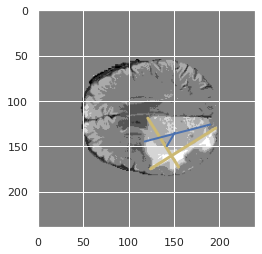

prediction [146.50833 117.79536 125.26202 189.10448 146.50758 139.08325 137.22829
 150.15103]


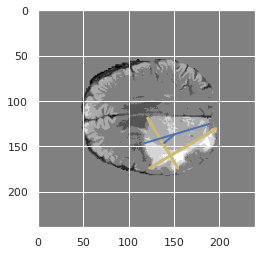

prediction [146.6423  119.51702 128.03331 191.01062 152.03348 140.94716 135.8437
 152.53912]


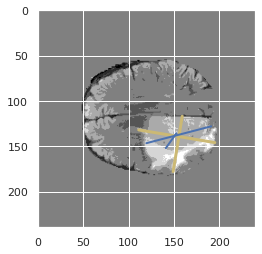

prediction [145.99596 120.40628 130.1727  191.50594 155.74193 143.14487 135.50381
 153.26675]


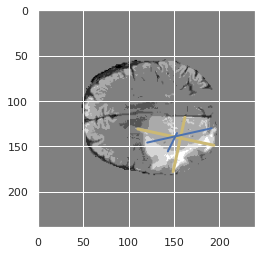

prediction [145.10678 117.92493 127.80502 189.32239 154.95793 142.43884 135.74129
 150.83559]


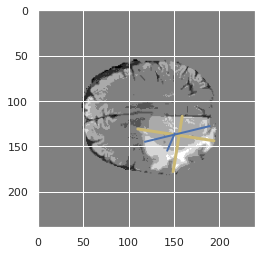

[0.270644744134491, 0.24506079027355623, 0.31711440916776257, 0.29083895853423336, 0.23789200222675821, 0.3007047768206735, 0.3156858886046054, 0.25359138068635273, 0.26247987117552335, 0.25748015469163443, 0.2517511330861145, 0.2219477043442454, 0.2615286080273271, 0.2875498449268941, 0.24744897959183673, 0.19170207448137966]
prediction [143.64188 117.94148 129.47888 189.28838 157.39055 144.1025  136.36273
 152.77393]


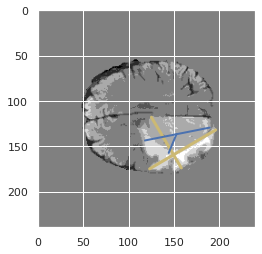

prediction [151.58176 117.10326 128.42812 197.17247 157.63972 151.86572 144.16121
 154.38237]


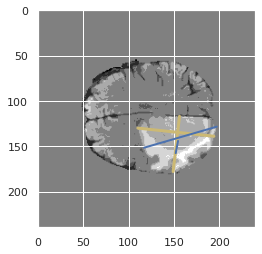

prediction [148.80936  111.886765 130.56966  199.20848  159.951    158.4785
 141.95     154.70157 ]


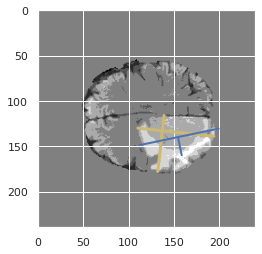

prediction [146.22939 110.99218 131.08974 198.21562 155.82666 160.98027 146.15602
 159.70308]


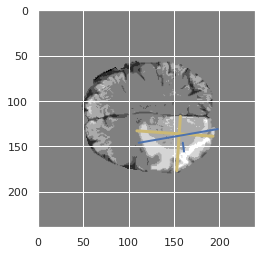

prediction [147.51575 111.51311 132.02542 196.78888 150.58969 160.89009 152.7244
 162.05847]


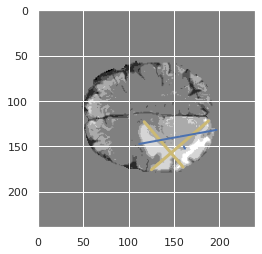

prediction [150.79437 112.12859 130.28    192.63869 146.52151 159.1366  157.0789
 162.87923]


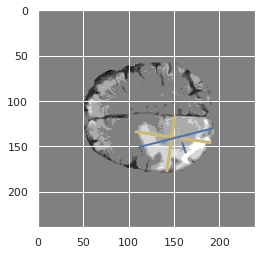

prediction [149.07199  111.036606 129.69435  189.77847  146.36676  158.91875
 156.12575  162.39005 ]


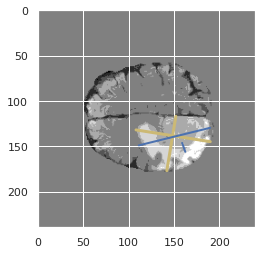

prediction [149.78171 111.15021 130.47696 190.04268 149.95673 160.65034 153.18048
 160.91664]


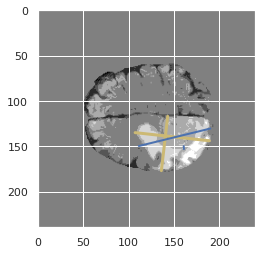

prediction [151.2097  110.90227 130.3168  186.46193 148.54117 160.5985  154.30849
 158.55011]


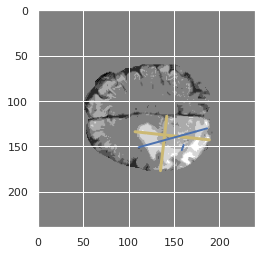

prediction [150.87819 109.11793 130.57333 186.9043  152.49863 161.60039 151.3471
 154.85677]


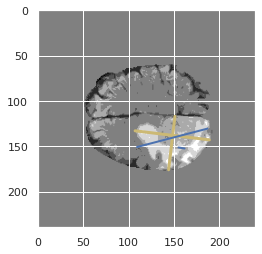

prediction [153.4      109.356895 129.43234  187.47745  152.64484  160.697
 152.3111   152.6575  ]


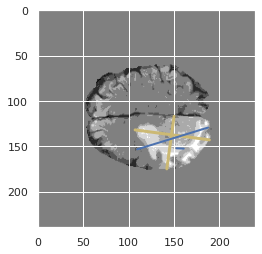

prediction [155.52632 110.93108 132.19087 187.91806 154.7148  158.56358 153.59883
 153.48407]


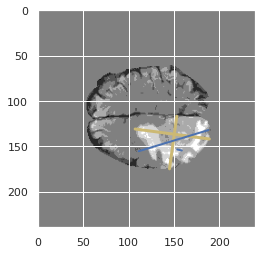

prediction [155.69841 110.98551 133.27176 189.68599 157.902   158.88904 151.81718
 151.31407]


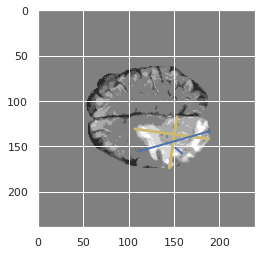

prediction [156.25836 111.85053 130.09981 189.86156 159.0289  155.02724 148.33817
 147.97668]


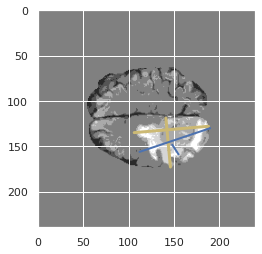

prediction [156.99095 115.85367 129.75322 190.76047 158.20555 152.90582 149.9213
 148.69681]


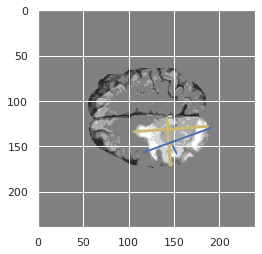

prediction [158.27576 118.54046 130.08728 191.43991 156.61005 150.61577 150.16144
 147.77995]


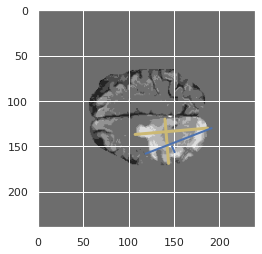

[0.16449885233358838, 0.1430456584850884, 0.14535367545076283, 0.18598156939402402, 0.20557880055788005, 0.23475699558173785, 0.22829088677508438, 0.2492630199803472, 0.1780631725095453, 0.22209779768570362, 0.32652210175145957, 0.443336355394379, 0.5312984997413347, 0.7252824858757062, 0.6286127167630058, 0.4029275808936826]
prediction [157.12677 117.87458 129.98236 189.31282 154.3315  149.05568 150.43983
 146.75977]


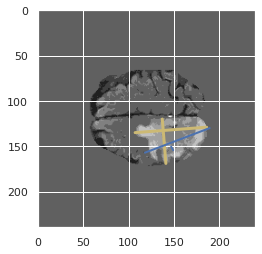

prediction [155.76767  118.425644 130.04077  188.25305  152.0904   149.34982
 149.61035  149.0241  ]


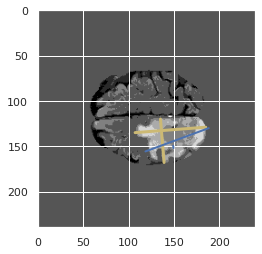

prediction [154.08952  118.275185 131.7413   188.24687  150.87723  152.30759
 148.11293  152.8092  ]


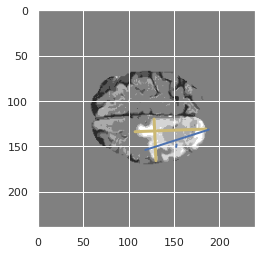

prediction [150.9318  114.87304 130.76888 186.04463 150.30338 151.14346 144.01364
 151.58585]


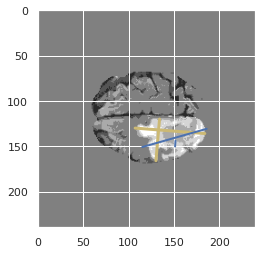

prediction [148.39404  114.245155 128.20903  185.69588  148.38104  152.62401
 140.9831   151.99207 ]


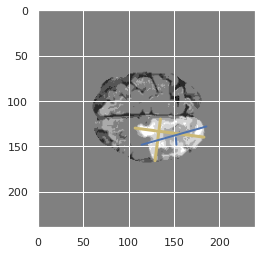

prediction [144.79933 112.54641 128.26031 182.68471 146.5942  152.77129 138.70264
 152.44327]


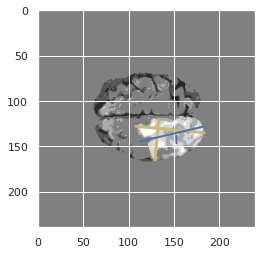

prediction [143.95691  114.9051   127.994644 181.85745  146.34186  152.05072
 137.5369   151.31615 ]


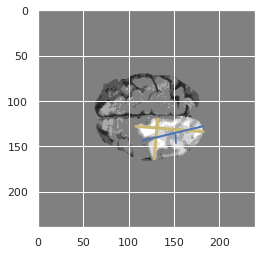

prediction [136.55182  115.207756 130.72731  175.33789  144.62152  145.90869
 131.87228  146.59647 ]


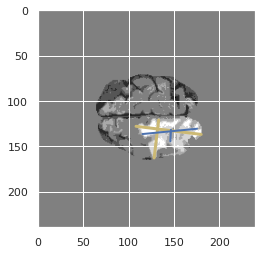

prediction [136.294   114.73602 127.81824 171.20607 140.90654 143.54695 132.02165
 144.67162]


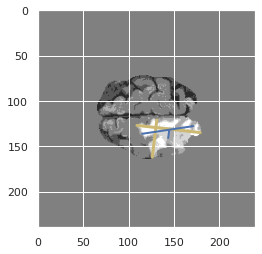

prediction [135.10057 113.88054 128.5834  168.9976  141.32558 142.64758 130.6083
 142.38257]


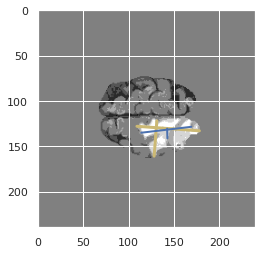

prediction [137.6759  115.2706  126.70452 167.20381 143.63948 144.72545 128.93826
 142.9675 ]


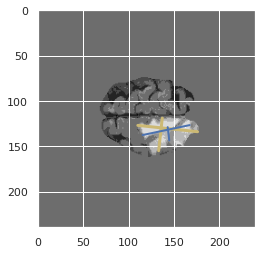

prediction [131.24022 115.97892 129.71967 166.3413  150.52013 137.35524 123.13509
 135.98593]


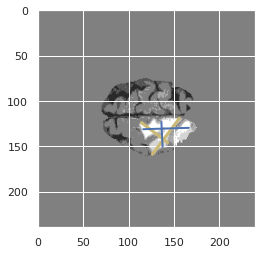

prediction [129.83334  115.876625 129.22478  163.99966  148.53998  133.86562
 122.32388  133.13712 ]


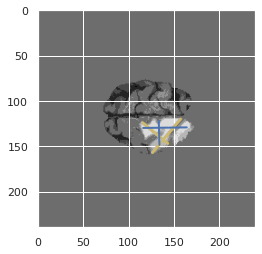

prediction [126.13433  114.703636 129.58813  162.30367  146.02373  132.97635
 122.82117  132.49522 ]


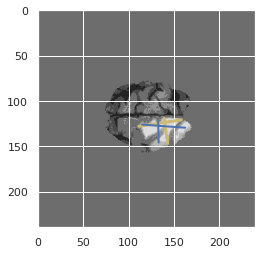

prediction [125.32166  114.13087  131.62593  161.60112  144.91084  132.10712
 126.067825 132.9224  ]


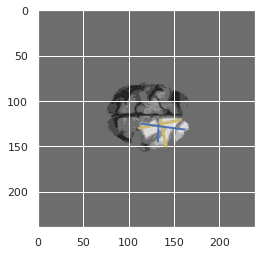

prediction [127.95129 115.08304 128.35712 154.30806 140.73268 128.94424 128.20099
 129.26227]


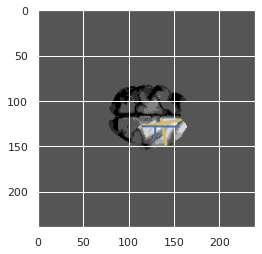

[0.22410865874363328, 0.38461538461538464, 0.3830734966592428, 0.32463768115942027, 0.09606986899563319, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
prediction [128.44063 112.91912 118.70892 146.5156  130.51633 124.66893 131.45222
 128.1817 ]


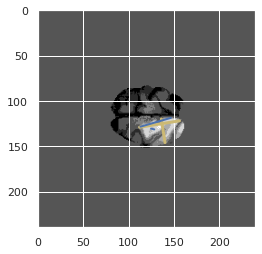

prediction [129.91928  112.60414  117.72224  146.60216  128.05403  124.532684
 135.65065  127.73374 ]


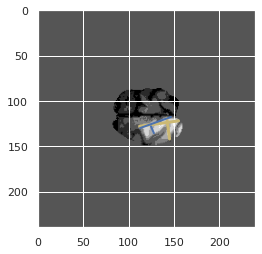

prediction [131.42767  113.79821  118.973785 149.25833  129.99184  128.13586
 134.6756   130.50671 ]


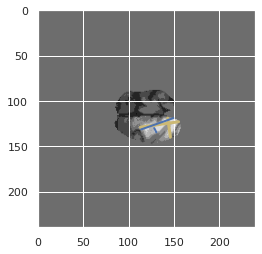

prediction [126.71064 113.33762 120.13704 144.5247  130.64983 127.38039 129.86989
 131.58754]


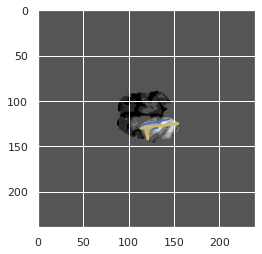

prediction [124.32378 107.53707 118.15615 137.607   131.17685 119.75268 124.07295
 126.36076]


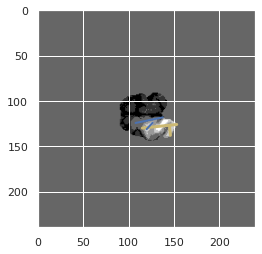

prediction [124.85912  110.50415  118.08491  131.5787   132.67395  119.5275
 117.005226 121.8106  ]


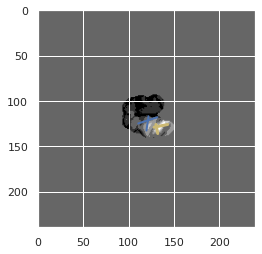

prediction [119.71398  120.559944 110.210304 126.02672  120.13721  121.11597
 110.71734  125.42085 ]


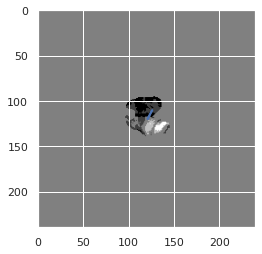

prediction [26.963997 28.52872  20.880041 26.086895 23.70544  27.4852   22.450726
 30.644047]


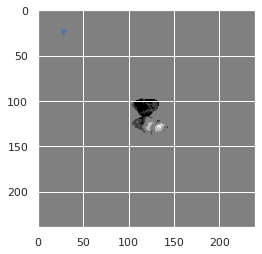

prediction [1.6168684  2.6120343  1.7315061  0.7121393  2.164736   2.1947224
 0.47269106 2.3679209 ]


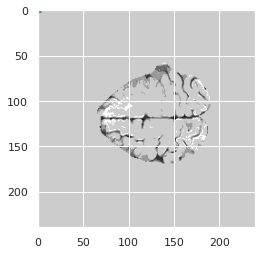

prediction [-0.4061867  1.2783355  3.0468748  2.1455307  5.354347   0.6876832
 -3.2697964 -1.1489955]


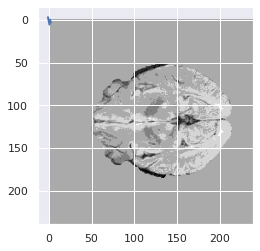

prediction [3.269362   3.1831229  6.5785785  3.7652411  7.3130994  2.1850817
 2.2104049  0.07252759]


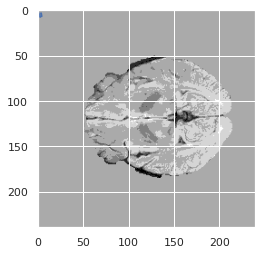

prediction [3.8709722  2.420423   4.874143   5.227075   5.11479    1.9280516
 3.6062126  0.11156512]


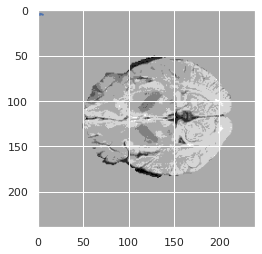

prediction [81.2358   87.034355 77.07358  97.89268  80.20962  88.81941  78.4285
 87.52025 ]


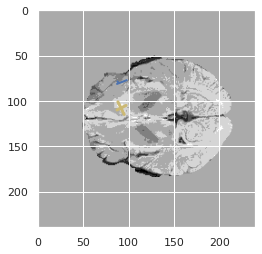

prediction [114.38011  124.85799  101.99165  146.14578  101.649574 125.936516
 111.93527  126.34869 ]


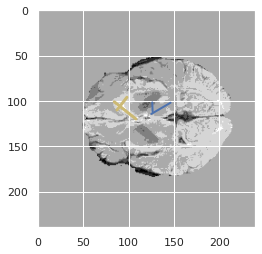

prediction [128.41145  126.743126 110.84663  150.58208  116.374825 127.95557
 126.25891  131.48341 ]


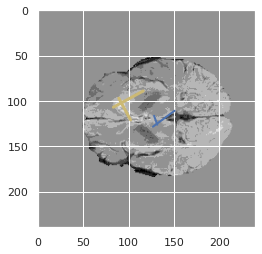

prediction [131.51299  119.420944 107.43603  142.72911  116.144485 118.59854
 126.348595 127.682976]


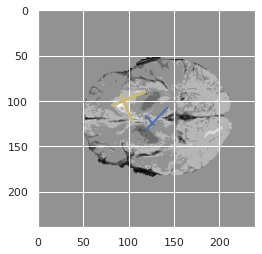

[0.0, 0.19959404600811909, 0.26891220320265047, 0.6124905944319037, 0.647912885662432, 0.5688311688311688, 0.6601170568561873, 0.618568665377176, 0.6370602577499129, 0.6075040783034258, 0.6809125964010283, 0.7140300644237653, 0.7108649035025018, 0.606038017144987, 0.48057713651498335, 0.5199409158050221]
prediction [141.79189  130.14505  109.951195 149.87123  126.122986 129.27003
 129.53665  140.09663 ]


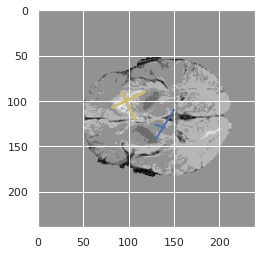

prediction [ 98.604515  85.14196   88.37841  109.003044 107.68747   92.72341
  88.42669   96.562645]


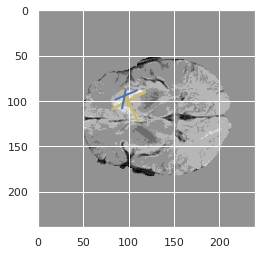

prediction [ 97.1152    84.2384    95.52138  111.866005 113.135315  95.586044
  84.5255   100.213394]


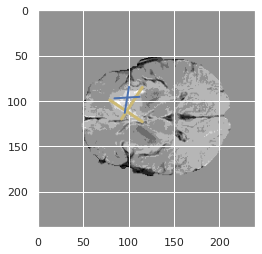

prediction [ 96.44836   84.3865    99.99216  116.52346  117.100494 101.26026
  85.61281  106.2385  ]


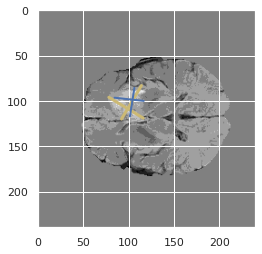

prediction [ 97.57501   82.880325 105.24606  122.93178  127.405655 104.28708
  81.46732  108.92066 ]


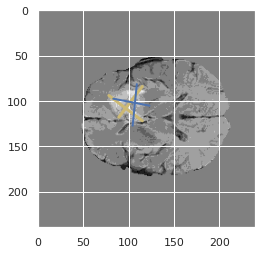

prediction [102.227745  68.57639  105.33766  119.96251  135.89795  103.44343
  73.27673   97.62068 ]


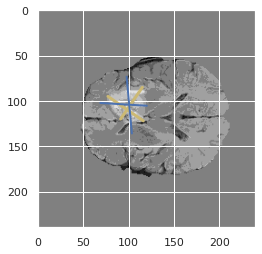

prediction [100.20519  71.27512 106.27667 118.80299 130.65337 101.80469  77.97523
 102.60414]


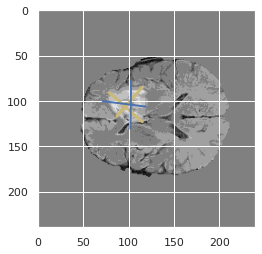

prediction [102.20946   72.63321  106.41295  118.981636 130.46931  102.7137
  79.78625  104.49692 ]


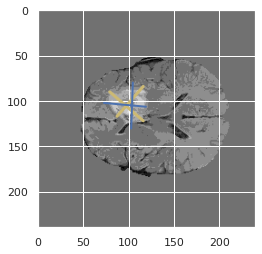

prediction [104.080864  72.53603  104.56382  120.5002   131.31047  103.473755
  78.731285 104.142914]


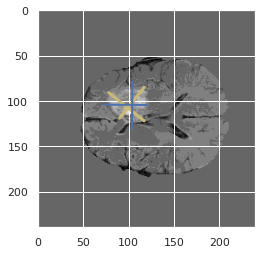

prediction [107.282585  72.68936  106.281784 123.91101  133.75146  106.26469
  80.071945 104.9172  ]


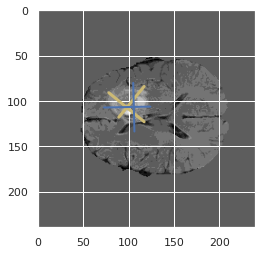

prediction [113.02094   72.96652  107.15658  127.808495 138.91496  107.80239
  80.64795  103.87579 ]


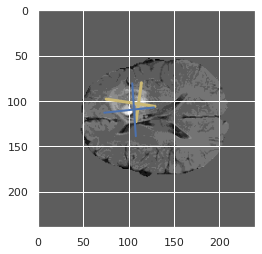

prediction [104.71986   70.232956 105.68974  124.742676 126.5245    98.29356
  83.00314  101.260666]


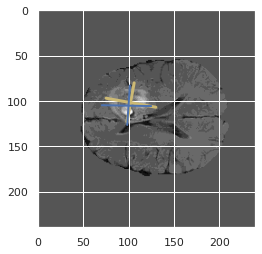

prediction [ 98.67977   71.387505 108.73775  124.24858  120.46741   96.60893
  81.70312  103.464745]


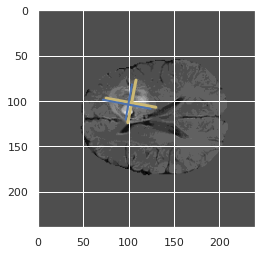

prediction [ 98.60107   73.180084 110.14859  126.31951  114.00355   95.36968
  84.33696  104.762596]


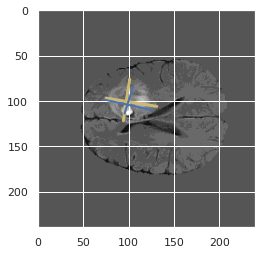

prediction [ 99.18226  75.3832  108.69757 130.01495 109.12243  94.77155  86.76356
 106.20187]


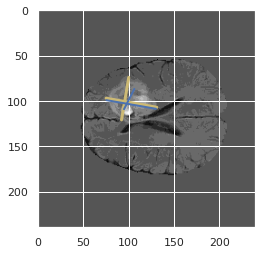

prediction [ 99.783035  77.37545  108.43764  131.65317  111.208916  96.60386
  86.29593  107.91508 ]


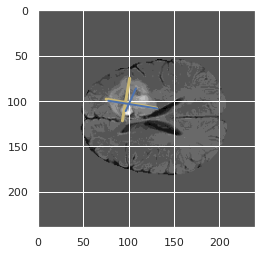

[0.38669512628957664, 0.4727272727272727, 0.5381831342743395, 0.5873821609862219, 0.5167262098083794, 0.41151594014313597, 0.4900470503076366, 0.25692253767963547, 0.1594308646479387, 0.2565918929555293, 0.470873786407767, 0.6538011695906433, 0.8609451385116784, 0.795729948066936, 0.7873817034700316, 0.6561969439728353]
prediction [102.56124   80.40362  105.82523  129.80185  109.794464  97.49023
  87.238815 108.88305 ]


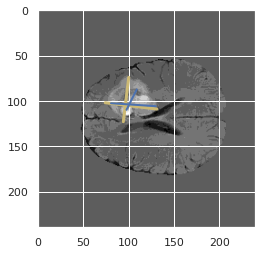

prediction [103.26203   78.339096 105.53578  131.46153  110.36309   99.95759
  84.67609  106.42419 ]


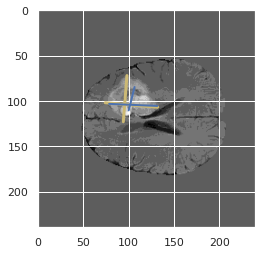

prediction [104.10553  77.83303 106.73087 132.87923 111.21745 101.99818  84.03151
 107.71178]


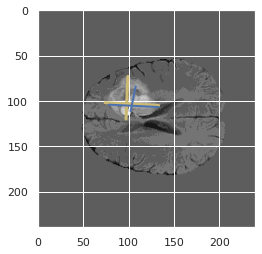

prediction [103.94785   78.074844 107.571625 132.50569  112.557175 102.926704
  82.92196  109.22859 ]


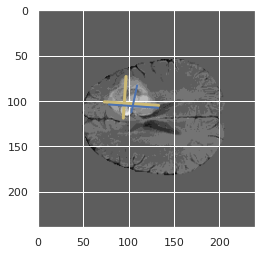

prediction [103.341034  78.4499   107.95904  131.11133  113.443535 101.28395
  83.06568  109.540794]


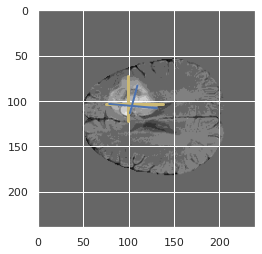

prediction [105.53303   79.683975 107.35244  131.25356  112.81874  101.02929
  87.12577  111.30616 ]


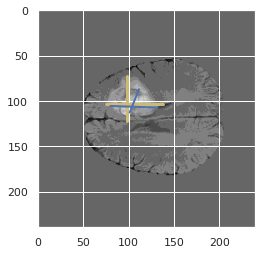

prediction [104.63668   79.76173  107.91311  131.08308  113.857124 100.60271
  86.5784   111.256645]


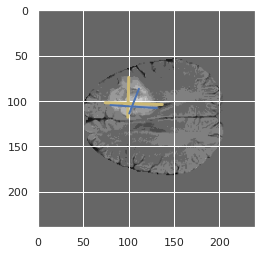

prediction [103.47563   80.517105 104.997025 130.48575  105.00821  100.0381
  91.06432  112.07333 ]


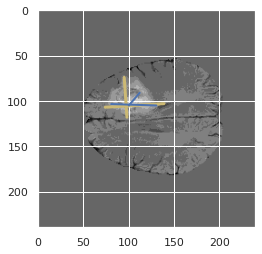

prediction [102.07116  79.26543 105.20991 128.76262 101.60135 101.89439  95.94773
 113.16868]


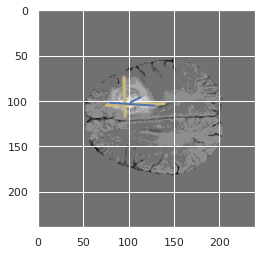

prediction [ 97.79655  79.28754 104.95819 125.68702 104.63384 102.25978  91.47128
 112.61749]


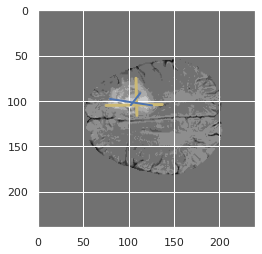

prediction [ 96.331184  79.05744  103.29188  127.11111  109.90669  102.789024
  88.480095 111.07955 ]


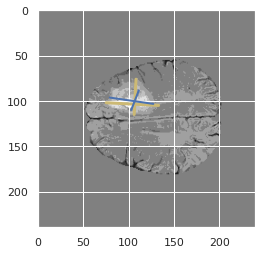

prediction [ 97.21004   78.13707  100.33059  125.3839   111.22389  101.03448
  87.38091  108.756454]


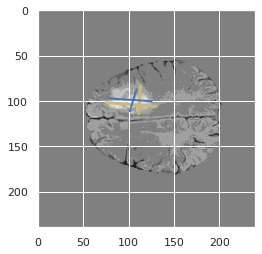

prediction [ 97.13137   75.60498  102.51332  123.202644 116.963684 101.069115
  81.12203  106.32845 ]


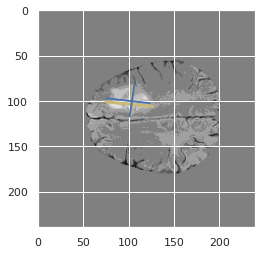

prediction [ 95.97265  74.96187  99.2355  120.76851 114.29052 100.10249  80.66529
 106.18074]


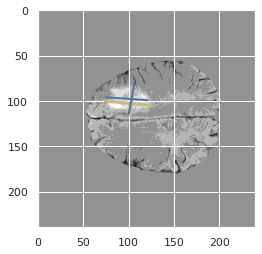

prediction [ 94.93607   74.64367   99.29345  120.16763  111.8902    98.83449
  82.720894 104.94173 ]


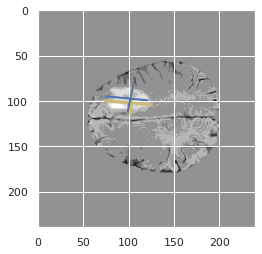

prediction [ 94.742676  74.7067    98.44091  120.232635 107.06287   98.98648
  87.0304   106.16238 ]


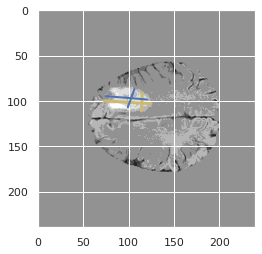

[0.3701923076923077, 0.16920731707317074, 0.15485074626865672, 0.1913767019667171, 0.1636675235646958, 0.164804469273743, 0.31993156544054746, 0.4726148409893993, 0.21375661375661376, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
prediction [ 98.3541    77.9462    96.90582  121.614944 104.861275  99.22006
  91.55899  108.379944]


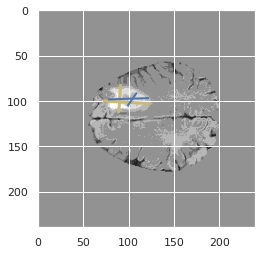

prediction [ 98.2738    74.45555   91.83542  112.68603   99.03741   94.079636
  90.85958  105.206436]


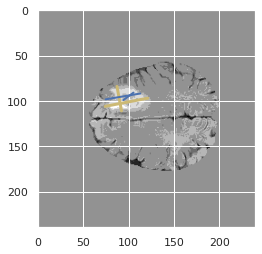

prediction [ 96.88314   72.77371   88.92311  106.64767   96.70954   90.304665
  88.06331  103.33973 ]


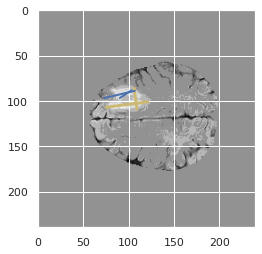

prediction [101.3275    76.509705  85.45107  103.94619   92.896     87.3261
  95.05383  102.177345]


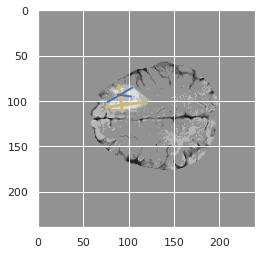

prediction [ 96.41706   77.11172   85.52868  104.162     92.76998   86.82251
  93.91028   99.318504]


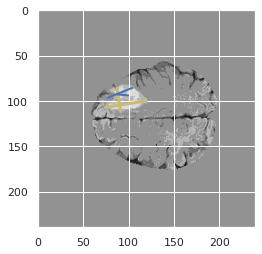

prediction [ 90.80304   77.26143   85.05324  105.899796  94.04003   90.33686
  87.83014   96.950966]


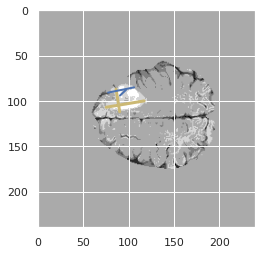

prediction [ 90.00426   73.558655  87.35219  106.615135  98.073555  88.65755
  86.41173   91.38565 ]


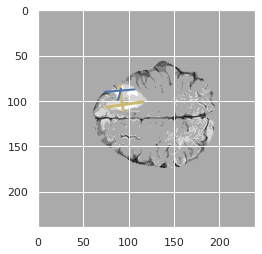

prediction [ 95.33258   80.268616 106.42385  111.66491  115.39087   91.48025
  94.68019   96.79849 ]


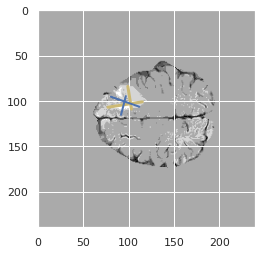

prediction [ 83.92089   79.55196   96.04683  101.65431  102.73203   90.87709
  83.540474  92.25098 ]


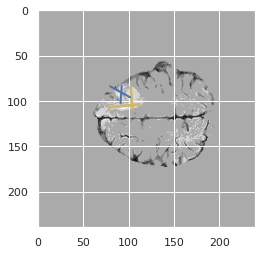

prediction [65.33132  64.61936  74.45851  81.32553  76.25235  76.818214 66.50503
 79.3426  ]


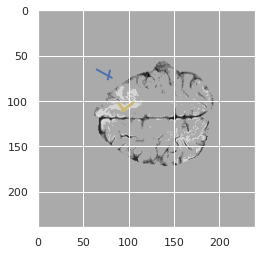

prediction [38.442524 33.836773 47.467316 45.894375 46.059406 43.100246 40.263752
 44.975483]


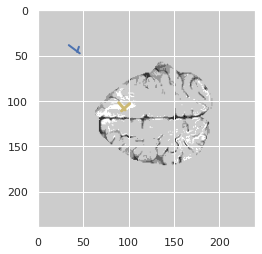

prediction [ 0.27181664  2.2537682   0.7198808  -0.19778652  1.8951287   0.66302323
 -0.8158972   0.76513755]


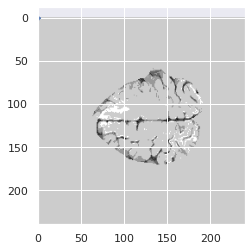

prediction [114.13398 123.00195 112.65776 136.36354 123.53512 126.133   112.22904
 127.99738]


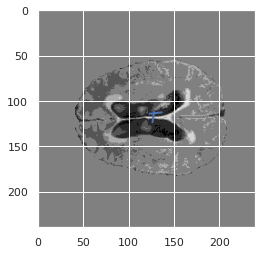

prediction [ 7.8363686 21.994717  10.133355  22.134323  15.464085  24.931295
  1.9147562 19.568264 ]


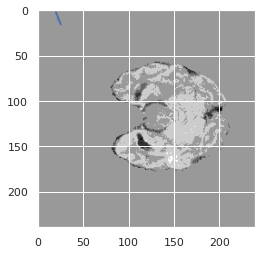

prediction [47.780888 60.008053 35.451252 57.329105 45.140064 56.815292 38.826538
 56.112896]


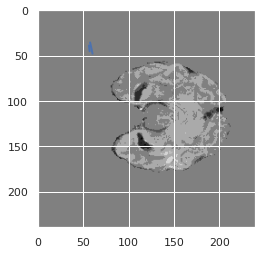

prediction [58.00352  85.22344  50.87458  81.85484  64.363    82.613075 50.33025
 80.42416 ]


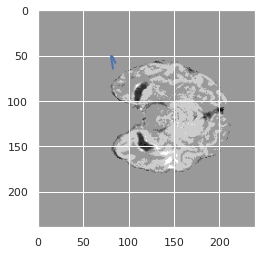

[0.0, 0.0, 0.0, 0.0, 0.03944773175542406, 0.0, 0.0, 0.0, 0.010186757215619695, 0.0, 0.007608695652173913, 0.009228187919463088, 0.032454361054766734, 0.09609120521172639, 0.18976897689768976, 0.2377898371978293]
prediction [19.844313 34.225666 24.539436 33.212887 28.47105  29.683878 15.554394
 29.655804]


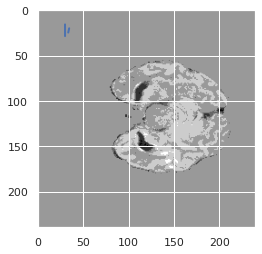

prediction [10.476671 16.831306 21.78824  13.057316 24.149689  9.578303 11.950471
 13.456676]


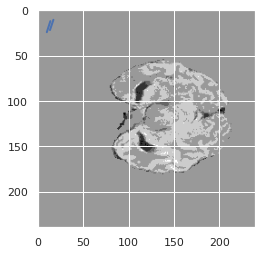

prediction [ 5.383106   6.6674113 13.083727   7.776044  19.579699   0.4466596
  2.0970335  5.133077 ]


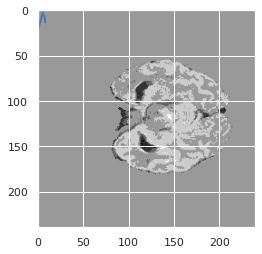

prediction [13.463605 23.179882 26.108175 18.200943 25.08182  12.97895  13.195517
 21.596401]


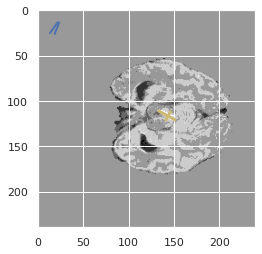

prediction [106.60036 127.21762  99.67081 152.38962  97.47137 132.41147 109.31228
 148.49397]


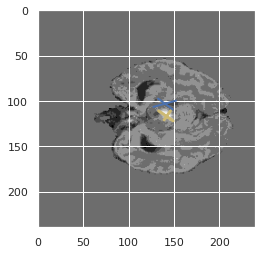

prediction [136.54343  140.45515  117.668465 173.8851   129.33284  158.31851
 128.97688  163.60085 ]


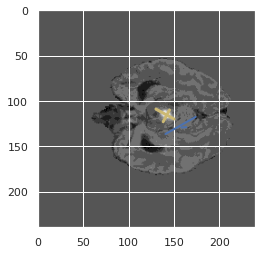

prediction [136.3643  138.24931 121.73346 168.63745 134.29437 152.99599 125.73432
 159.47057]


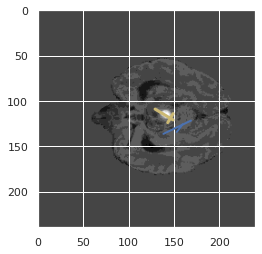

prediction [139.33652 139.74307 124.84776 170.87508 133.43892 155.38786 129.11057
 157.03506]


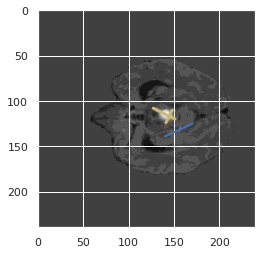

prediction [128.57416  136.76256  122.27414  174.15552  126.260056 162.15848
 123.70705  166.03413 ]


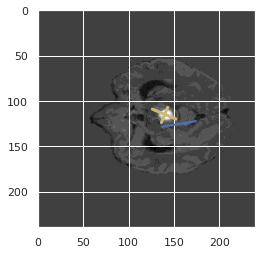

prediction [129.49417 139.44241 130.05284 184.56662 133.34602 166.68333 130.71465
 175.13084]


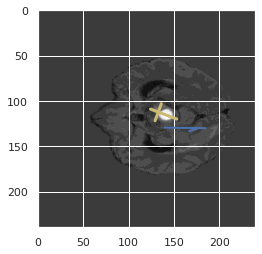

prediction [131.22191 137.24916 121.59318 186.58447 130.01895 165.56183 127.76545
 172.40398]


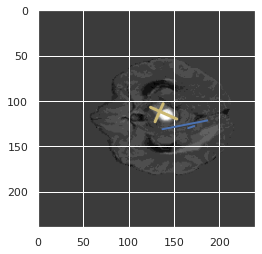

prediction [131.8168   138.79514  116.441956 186.08533  126.1581   170.21729
 128.05406  177.06786 ]


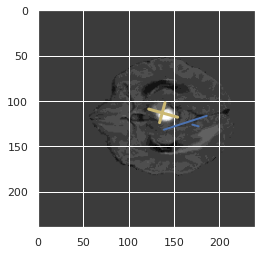

prediction [130.80022 142.50684 116.27549 189.89311 123.1157  171.57213 130.85616
 184.37892]


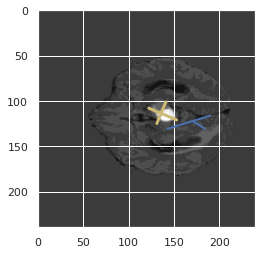

prediction [132.52937 128.4963  110.88091 181.46848 116.18034 156.81969 133.71017
 170.58315]


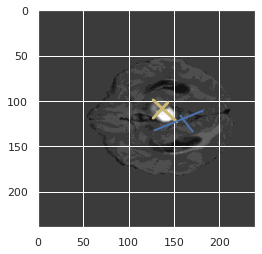

prediction [125.28558 130.8338  104.51583 187.61905 102.9911  160.22327 132.2828
 177.6399 ]


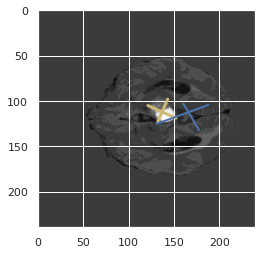

prediction [123.22613  133.39165  109.206825 184.24533  102.835434 160.67088
 129.9716   174.53319 ]


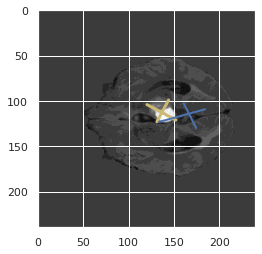

[0.24601686972820994, 0.28508042151968943, 0.18101822752985544, 0.12147887323943662, 0.2417503586800574, 0.217854763491006, 0.21294615849969753, 0.22164948453608246, 0.32050431320504313, 0.1650422352176738, 0.2676604018146468, 0.14670255720053835, 0.100472016183412, 0.09475119291070211, 0.07754442649434572, 0.07377049180327869]
prediction [121.83812  135.32776  110.770256 183.68456   97.93083  158.25385
 135.35785  177.7213  ]


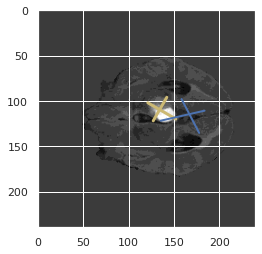

prediction [122.300125 134.67755  108.04019  174.10983  100.14629  160.30318
 128.91211  175.9904  ]


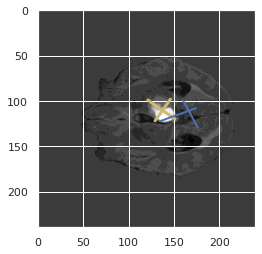

prediction [119.805435 138.82228  113.05816  181.52281  105.92782  160.51494
 123.58555  179.61195 ]


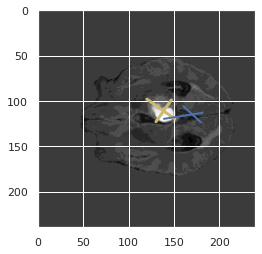

prediction [120.12102  140.37244  119.744774 181.0262   103.62891  156.54703
 129.28812  179.93466 ]


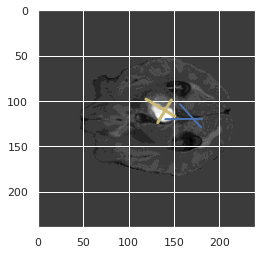

prediction [120.44613 132.60857 116.36255 165.96213 106.78073 153.42043 121.29879
 169.26349]


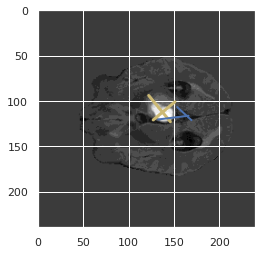

prediction [120.097374 135.20583  117.32049  171.26837  105.1349   155.81738
 123.993805 172.90007 ]


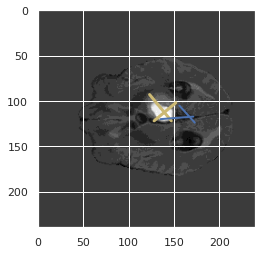

prediction [117.543434 132.20798  120.74371  171.47757  103.41974  151.60092
 127.483826 170.98468 ]


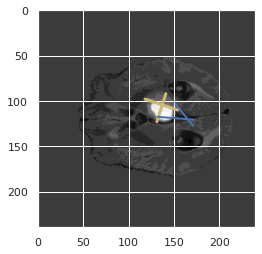

prediction [119.54014  131.9223   121.171715 170.79164  102.35065  150.49413
 130.68146  170.71373 ]


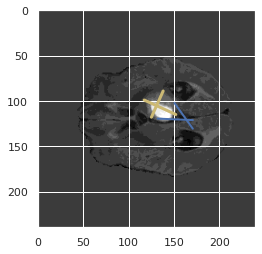

prediction [117.09938  129.41972  118.300026 167.85143  100.50816  148.68558
 125.88285  166.79282 ]


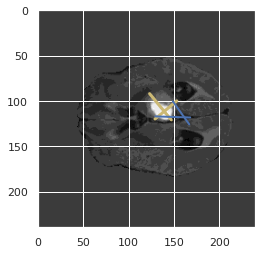

prediction [121.771996 134.09741  118.83356  167.25739  107.60314  151.67915
 125.42445  168.4836  ]


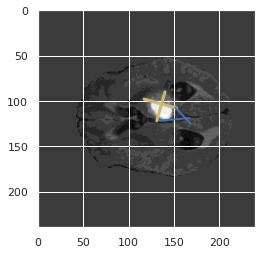

prediction [117.58227 128.85603 118.81309 166.00272 103.55746 149.90623 125.44337
 164.02599]


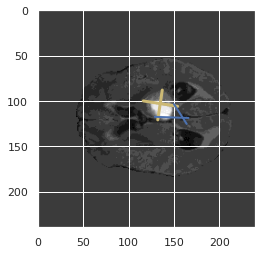

prediction [121.28134  136.00916  119.99149  162.74823  107.600464 150.016
 126.233406 166.5637  ]


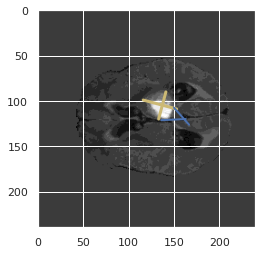

prediction [122.697105 138.08405  121.046265 162.09106  109.79834  150.49141
 127.51817  167.22733 ]


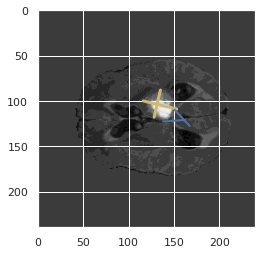

prediction [122.82188 138.53242 122.62147 155.67271 112.68435 149.6636  126.08078
 163.99547]


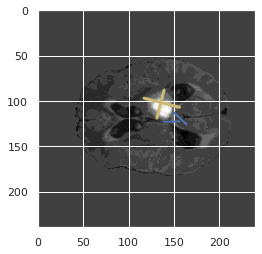

prediction [122.184044 139.49606  122.338165 155.87592  113.90646  149.69472
 124.99585  164.49573 ]


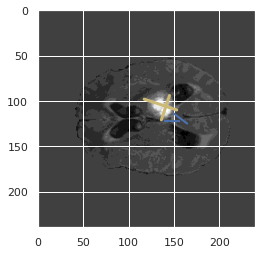

prediction [121.620804 142.44426  117.65052  153.56807  112.6241   148.6349
 122.14343  162.50206 ]


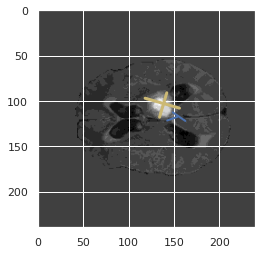

[0.05172413793103448, 0.16422018348623854, 0.14897760467380722, 0.19732937685459942, 0.4211409395973154, 0.2199630314232902, 0.3130841121495327, 0.19703389830508475, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
prediction [117.52321  139.56737  116.497826 158.44508  114.02131  146.23569
 118.929504 156.42474 ]


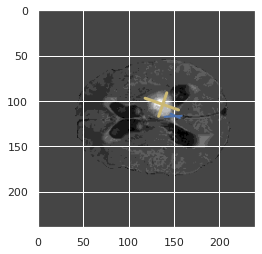

prediction [117.189026 137.33498  113.549515 159.69193  108.201126 146.74336
 120.188965 156.31693 ]


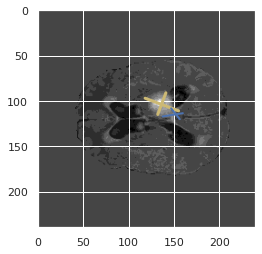

prediction [116.37697  135.45639  108.36739  154.78645  109.255516 141.70537
 116.47005  149.7877  ]


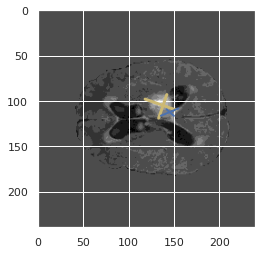

prediction [103.86199 130.14966 107.36218 150.48743 111.72076 131.10425 108.13375
 142.56613]


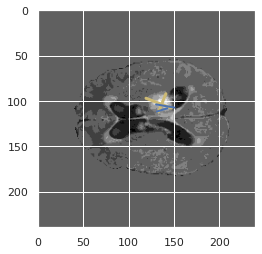

prediction [ 92.80226 129.1655   98.621   145.91019 105.42298 122.04428  97.91216
 134.44325]


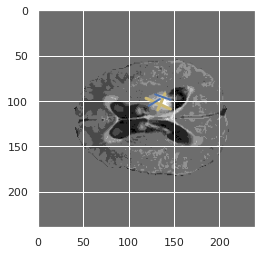

prediction [ 89.9946   128.09674   96.298325 155.11288   93.55081  127.067924
  97.870865 138.17035 ]


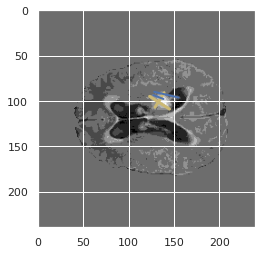

prediction [100.79432 126.43094  94.72209 156.63882  86.57314 131.84645 113.25713
 136.79245]


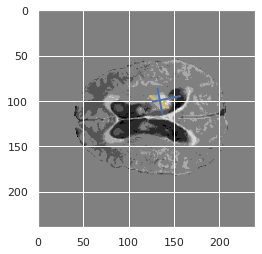

prediction [ 99.22602 121.0435   89.51489 144.16235  89.46459 124.35914 104.77703
 127.36779]


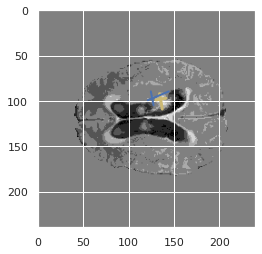

prediction [ 85.43223   96.63602   82.740456 108.330475  92.89418  100.58909
  82.33822   98.98041 ]


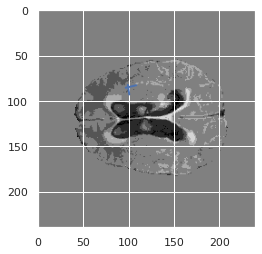

prediction [ 1.6913736   2.0269284  -0.19351287 -0.8012112   0.58415735  0.4498018
 -0.2143147   0.755741  ]


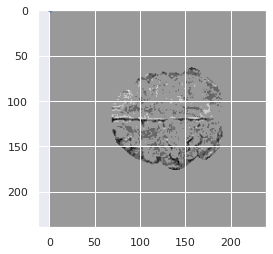

prediction [ 1.033514    1.3565689  -0.77450585  0.9541671   1.0268172   2.8330555
 -1.3897051   2.9281695 ]


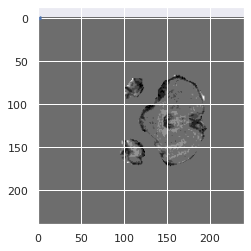

prediction [ 2.0942838  1.6429136 -0.1625003  1.8478355  2.2138937  3.530171
 -1.096155   3.1092663]


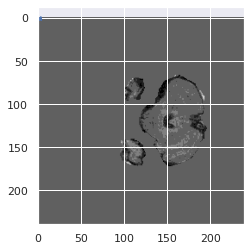

prediction [13.964175 11.293675 10.410612 12.370544 13.011319 12.972414 11.533437
 12.976649]


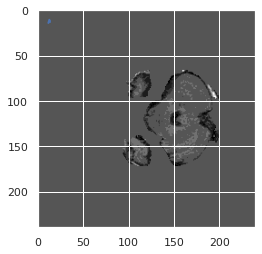

prediction [45.05706  30.445984 40.961437 33.095192 46.147434 31.45633  39.96922
 32.97832 ]


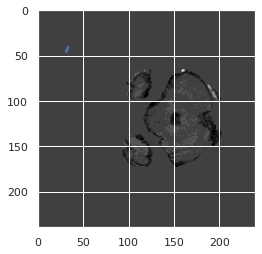

prediction [14.161115  18.857601   9.4494705 20.114796  10.404592  19.071278
 10.926913  21.23555  ]


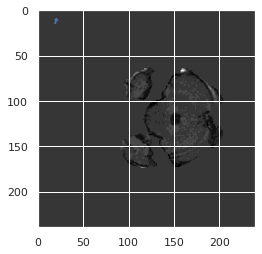

prediction [6.455448  7.1206884 4.2584047 6.998967  8.025136  8.756331  2.967813
 5.91462  ]


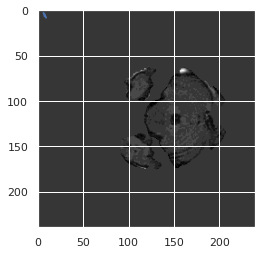

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0, 0.0, 0.0, 0.0, 0.2488619119878604, 0.635223880597015]
prediction [32.965027 34.84989  28.310808 35.864197 33.285934 34.720222 28.296654
 33.110523]


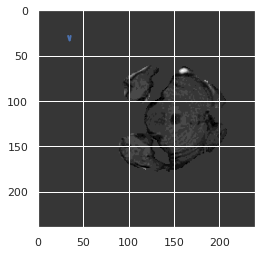

prediction [ 91.563126  97.95962   86.43585  101.63416   97.75759   99.5388
  84.4649   101.65373 ]


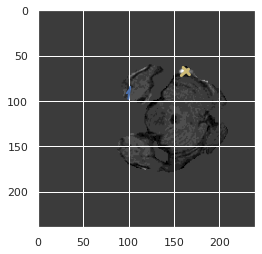

prediction [ 73.09845  118.899315  63.344532 122.79622   70.37975  123.11598
  73.87994  130.07422 ]


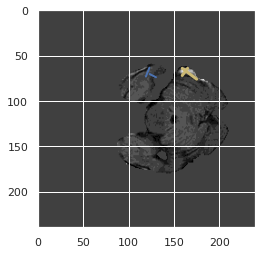

prediction [ 71.91935 117.95564  63.05288 125.30117  65.22803 121.89177  78.16115
 131.61879]


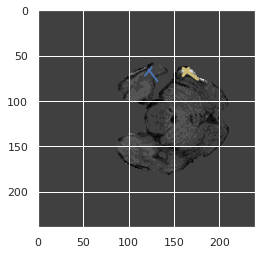

prediction [ 77.802376 128.97008   65.07733  129.88817   73.60051  128.6858
  79.34318  137.92674 ]


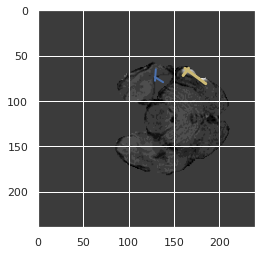

prediction [45.37626  75.71153  39.71478  73.798225 40.82191  74.86564  48.38514
 81.025024]


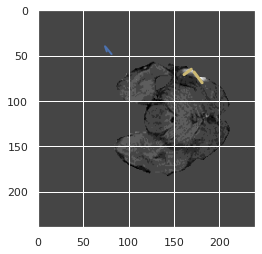

prediction [57.023758 90.18133  53.18872  85.97379  58.18495  86.01633  61.641884
 95.62553 ]


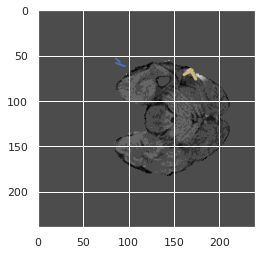

prediction [50.049103 54.47438  53.474365 53.570057 51.675457 47.835217 54.490303
 58.717777]


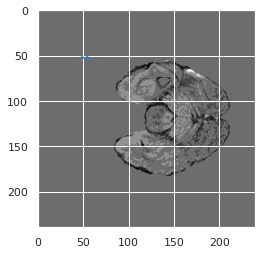

prediction [33.355095 29.371262 28.30572  27.535301 34.27848  28.518616 25.438755
 26.321928]


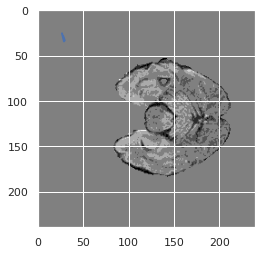

prediction [ 9.825432  10.51595    4.244208   6.5393534 12.536402   8.276479
  1.4958001  6.198224 ]


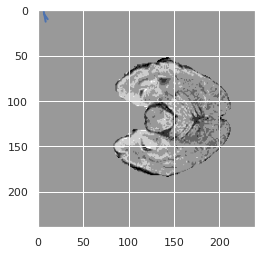

prediction [ 0.24161248  1.0182494  -0.9892701  -2.116466    1.6524223  -1.4408714
 -3.9258506  -2.715185  ]


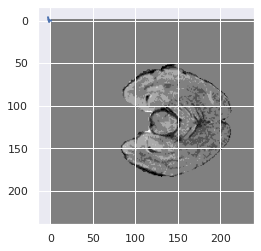

prediction [97.95567  82.22943  88.94612  80.85884  92.77612  78.59365  90.352715
 81.10494 ]


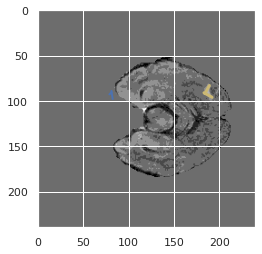

prediction [46.512707 95.026215 45.591568 92.09886  50.8669   90.91981  40.661755
 91.17946 ]


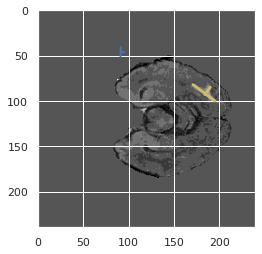

prediction [ 58.949123 129.29506   52.986485 132.74416   60.78231  132.83344
  54.346672 139.19077 ]


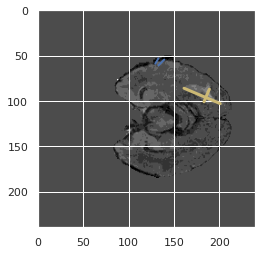

prediction [ 67.29384  153.92882   86.63821  180.22876   93.039764 163.13513
  72.9193   177.73863 ]


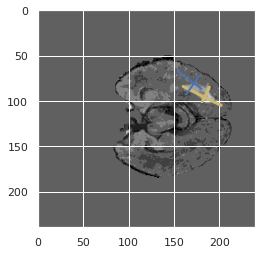

prediction [ 75.7075   148.69946  101.355194 197.53737  107.0554   175.10046
  83.695496 187.10626 ]


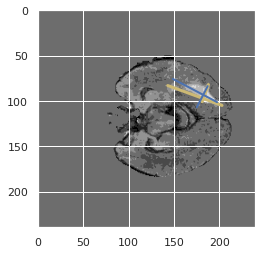

[0.5820433436532507, 0.5160256410256411, 0.6011004126547456, 0.2744865718799368, 0.3470019342359768, 0.3611572996341869, 0.23579277864992151, 0.29949077021005727, 0.45488505747126434, 0.5444146994402531, 0.6272791854132134, 0.7088189588189588, 0.6758586525759577, 0.5741976485541785, 0.5511463844797179, 0.4398200224971879]
prediction [ 80.5721   141.76555  104.511375 206.11629  109.03675  176.02794
  79.973305 188.32016 ]


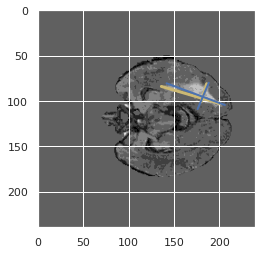

prediction [ 84.197105 140.24911  102.87485  212.35352  108.92214  173.6896
  80.84882  182.55301 ]


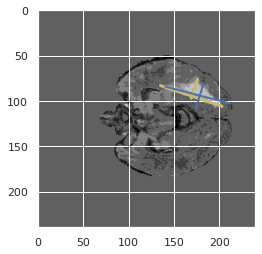

prediction [ 84.005005 128.6161   103.85277  206.36223  101.79431  163.6872
  80.249344 172.31049 ]


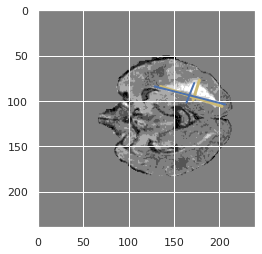

prediction [ 79.74907  106.6156   102.90565  189.2186    89.979744 150.80391
  80.180504 150.6364  ]


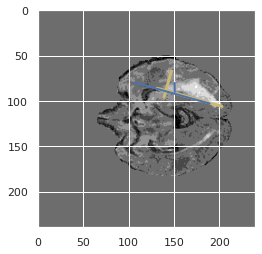

prediction [ 79.86897  109.29595  104.94427  198.47672   86.30394  150.70682
  77.967125 152.55894 ]


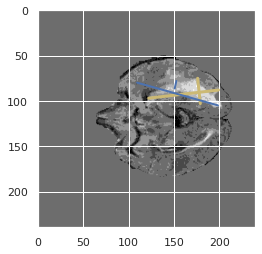

prediction [ 85.26308  115.09297  101.172676 207.41681   89.60612  148.83792
  77.26422  154.96573 ]


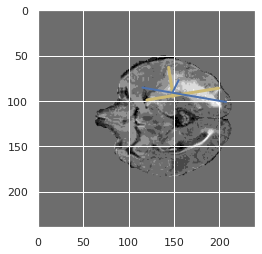

prediction [ 86.86221  122.208046 100.62882  212.55371   81.82244  153.97986
  85.91436  165.285   ]


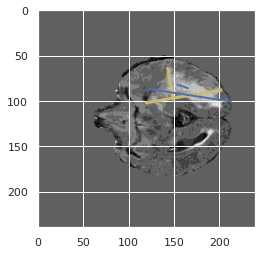

prediction [ 87.66885  125.217674 102.452705 211.99133   81.53598  156.41505
  88.73863  170.09047 ]


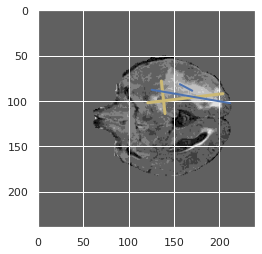

prediction [ 93.422195 127.12811   96.64582  210.37584   75.6761   161.11472
  94.37773  169.58119 ]


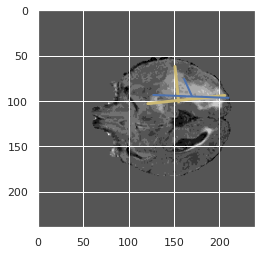

prediction [ 91.13073  121.0149    98.486145 205.70311   69.410126 154.5
  98.48931  163.69144 ]


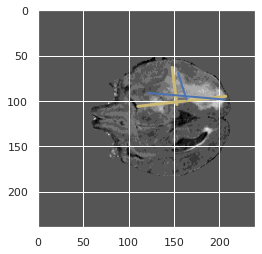

prediction [ 92.38631  114.812065  94.956314 197.87524   65.6606   142.23022
 102.962975 156.51863 ]


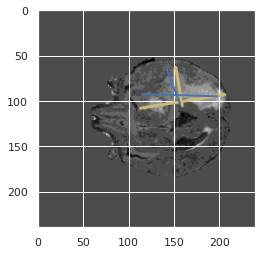

prediction [ 89.08438  104.082855  95.56727  192.8916    56.319798 141.2312
 107.21366  147.08673 ]


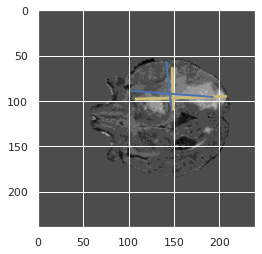

prediction [ 89.92717  102.91712  100.525154 198.47299   58.645027 142.23747
 109.688736 146.46074 ]


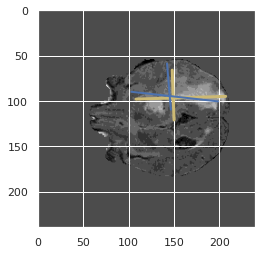

prediction [ 93.03348  103.29352  103.48065  202.00327   60.714954 148.92311
 110.53293  150.08905 ]


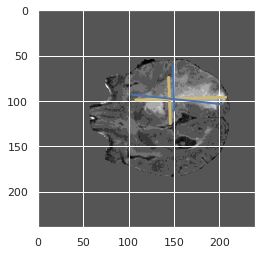

prediction [ 93.65358  105.19212  106.53469  202.86789   69.502975 156.15771
 106.519005 157.1852  ]


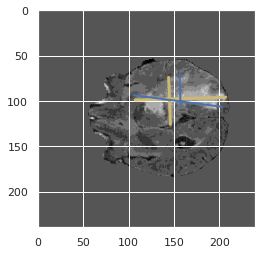

prediction [ 96.11635  107.30643  109.15182  202.36574   79.209236 155.88101
 104.64009  159.05031 ]


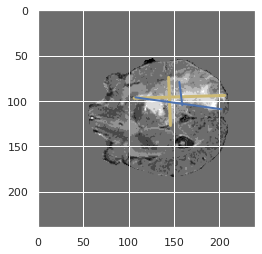

[0.18065099457504522, 0.3401106050748211, 0.3973387232609062, 0.43222003929273084, 0.36534867002156723, 0.5277817866936065, 0.4941194209891435, 0.35245779172269537, 0.3361009101069775, 0.20695336958312738, 0.12422076934772693, 0.12308868501529052, 0.1177340630084307, 0.12247307068024199, 0.15606529693217, 0.12037627551020408]
prediction [ 85.52     106.95134  120.94841  206.08572   92.73654  153.43958
  94.997574 161.83443 ]


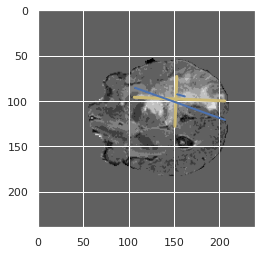

prediction [ 75.44852 104.77391 126.48617 207.0355  102.37787 150.83716  82.27947
 158.33311]


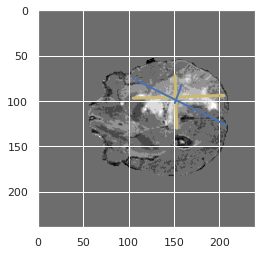

prediction [ 80.509    108.493484 125.325165 204.88934  107.88951  153.03448
  86.265396 165.20935 ]


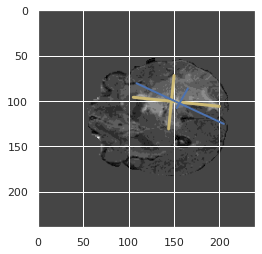

prediction [ 85.0784   108.19608  123.43623  204.22949  114.441574 154.26292
  86.07702  163.83157 ]


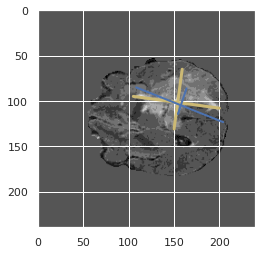

prediction [ 91.89832  101.30277  110.22095  195.23465  110.24747  144.63072
  83.164154 150.14633 ]


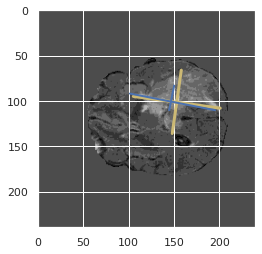

prediction [ 85.74044  108.66252  124.1106   202.29128  120.127075 155.59178
  81.27738  161.72525 ]


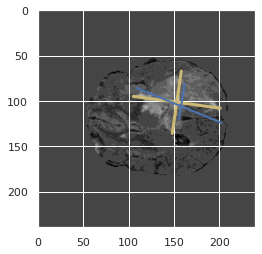

prediction [ 90.71125  106.3164   121.269905 198.09119  117.28774  152.37433
  82.07103  155.97684 ]


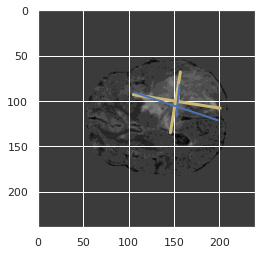

prediction [ 93.35454  105.17034  120.783745 194.92015  112.13785  153.60333
  86.33723  155.46294 ]


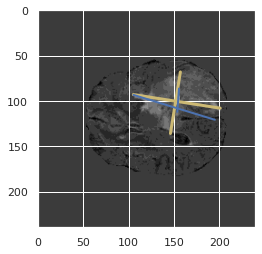

prediction [ 94.39227  106.64044  120.20789  193.85434  111.552505 153.63933
  88.7993   158.30989 ]


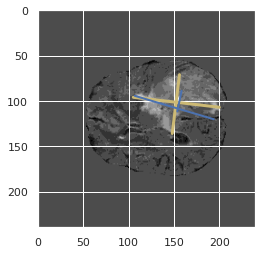

prediction [ 94.143555 109.06521  119.4294   189.45406  106.72568  151.43463
  95.336624 160.20898 ]


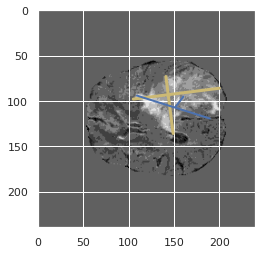

prediction [ 92.58132 106.62673 117.30086 189.19522 102.13125 149.01291  98.56929
 158.12341]


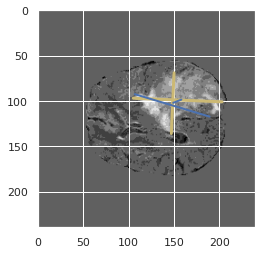

prediction [ 91.267624 106.24238  117.4128   189.17873  101.408905 148.47098
  98.2117   157.65315 ]


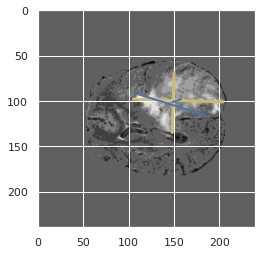

prediction [ 90.260765 104.01963  115.62019  189.07417  101.40895  146.62723
  96.0283   153.83847 ]


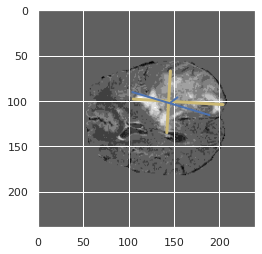

prediction [ 91.83611 103.07505 115.48736 189.07565 102.68772 144.92455  94.93131
 149.84453]


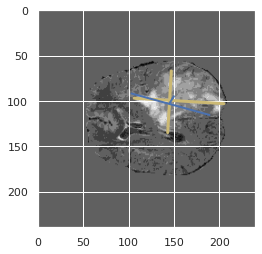

prediction [ 92.210884 102.33766  115.137215 192.92552  105.438866 144.10823
  93.779945 148.20683 ]


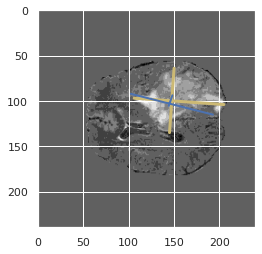

prediction [ 92.332306 104.36363  113.08194  192.429    101.68133  141.70644
  94.89043  149.91934 ]


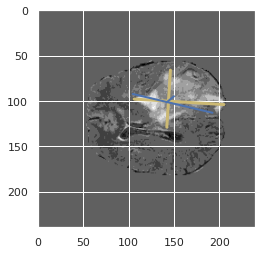

[0.08861538461538461, 0.056856187290969896, 0.06463337547408343, 0.1166204534333714, 0.17923721566615358, 0.24968699695939903, 0.21727447216890594, 0.2719886248222628, 0.221810378462739, 0.21027553345763414, 0.16445796219856615, 0.14206896551724138, 0.19493730778329785, 0.18318756073858114, 0.20614954577218728, 0.2661637931034483]
prediction [ 90.101456 108.42754  110.31737  190.03093   96.75032  140.89806
  94.34346  153.1921  ]


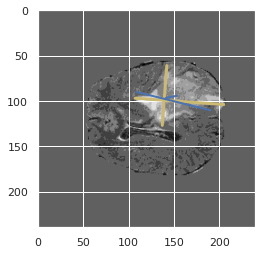

prediction [ 87.9316   108.017044 107.096115 193.33992   90.80057  139.59229
  94.31611  154.87993 ]


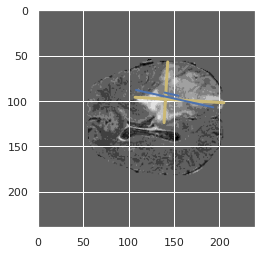

prediction [ 85.32865  110.18836  106.350784 192.8201    89.59274  138.8336
  92.62621  158.28358 ]


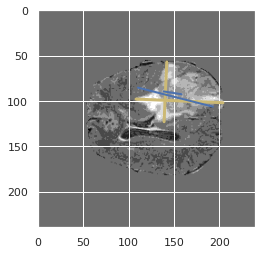

prediction [ 86.53063  112.273796 104.96897  191.81656   91.615036 138.92749
  89.044525 159.60176 ]


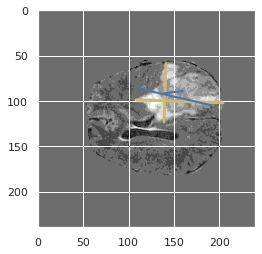

prediction [ 86.54129 113.07697 106.02393 193.32086  94.21607 138.99226  85.47195
 158.5784 ]


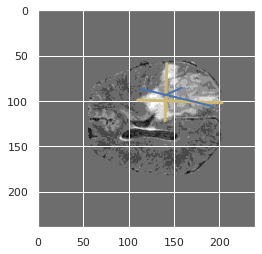

prediction [ 88.96048  113.75092  105.50196  195.14143   97.00148  139.86577
  82.907364 156.35843 ]


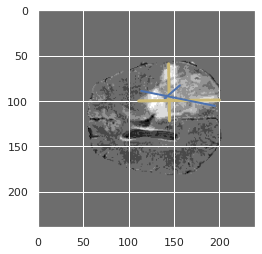

prediction [ 90.96394 114.19511 103.97647 194.6935   96.10152 138.52763  84.14595
 151.9746 ]


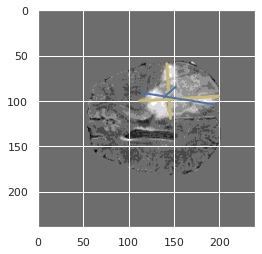

prediction [ 93.14278  112.76663  105.782166 195.55959   97.85321  139.25533
  83.16643  149.56514 ]


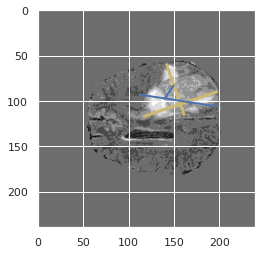

prediction [ 93.339325 111.034935 104.12044  189.1119    96.46323  132.89862
  84.01542  147.62422 ]


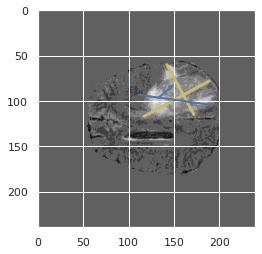

prediction [ 91.24824  111.5764   102.94738  185.62376   94.26407  132.4389
  84.297905 150.37611 ]


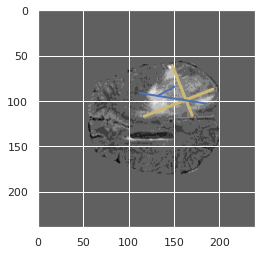

prediction [ 92.04585 115.25093 100.74297 185.1025   89.68522 136.26357  85.94261
 151.55441]


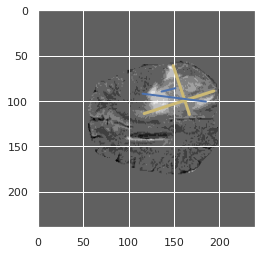

prediction [ 92.36122  118.049194  99.22944  183.42596   85.39775  136.84312
  87.940346 152.00381 ]


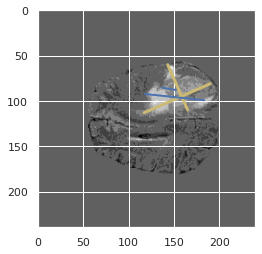

prediction [ 93.656334 120.39298   97.27898  184.88516   82.75786  139.07222
  89.26776  154.79857 ]


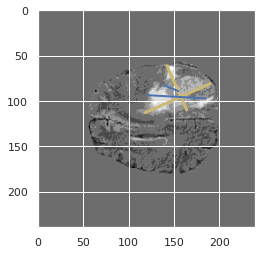

prediction [ 91.65778  121.26302   96.7944   184.59428   81.78726  137.63594
  87.108475 155.97716 ]


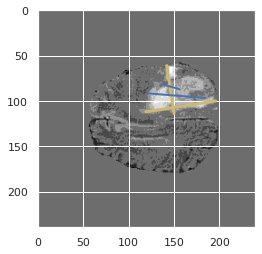

prediction [ 88.01192  120.635445  96.61172  183.17365   80.8927   134.19037
  85.267456 153.56865 ]


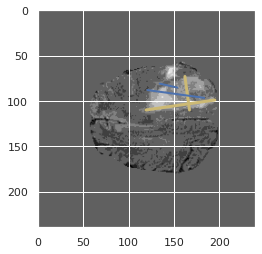

prediction [ 88.3954  124.58814  97.2986  181.1227   76.96581 134.50557  90.35829
 157.93806]


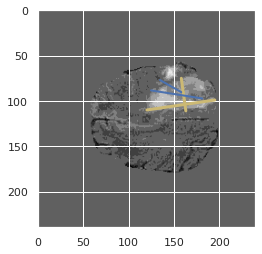

[0.35497237569060774, 0.3155001832172957, 0.5164267257290514, 0.4948306595365419, 0.3943014705882353, 0.46820483961733256, 0.4774774774774775, 0.3657917019475021, 0.19856459330143542, 0.0, 0.0, 0.0, 0, 0, 0, 0]
prediction [ 93.091324 128.12766   95.642136 179.6193    73.108864 135.90096
  96.87902  159.61029 ]


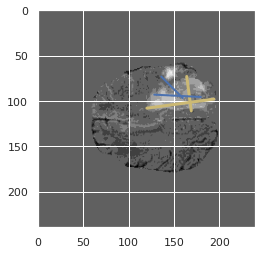

prediction [ 94.45633  130.22073   91.95607  174.71445   71.620384 137.83574
 100.192535 161.17003 ]


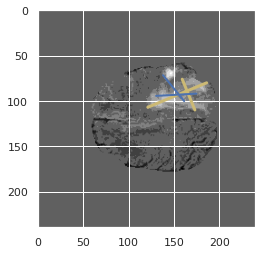

prediction [ 99.32243 129.49026  94.72002 182.74484  69.04655 142.69664 105.51801
 160.53159]


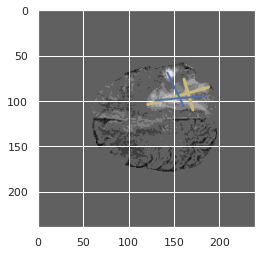

prediction [ 98.874275 124.56489   99.65102  182.65106   71.54861  144.30151
 101.79485  156.77202 ]


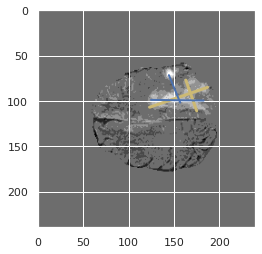

prediction [100.0928  120.35177 104.9164  184.32458  89.96863 146.14047  89.5758
 151.6722 ]


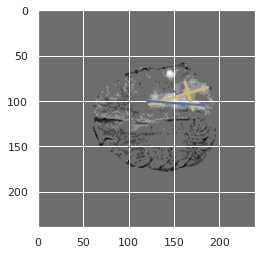

prediction [ 99.653015 122.24641  107.216225 186.75359   98.02078  151.36903
  90.432106 156.29007 ]


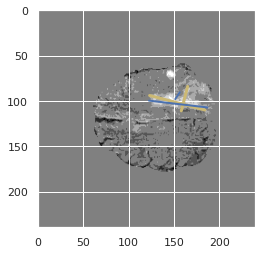

prediction [ 98.133766 126.16796  107.606094 179.13618  103.53745  153.08788
  90.06623  156.23355 ]


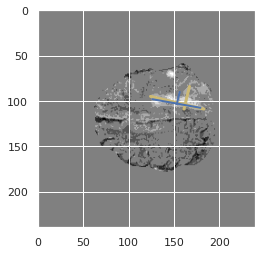

prediction [ 85.100334 134.23412  105.440636 176.3923   105.06211  158.89243
  87.26957  159.36769 ]


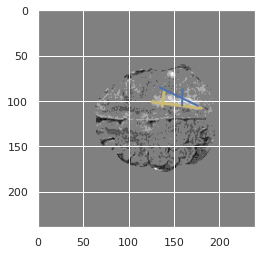

prediction [ 89.761826 138.38283   92.55628  159.352    100.7533   152.06245
  85.98631  154.14316 ]


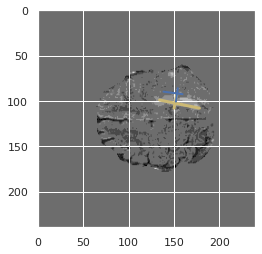

prediction [ 80.801445 111.30323   71.22055  120.470566  74.3964   115.94109
  74.18567  114.862305]


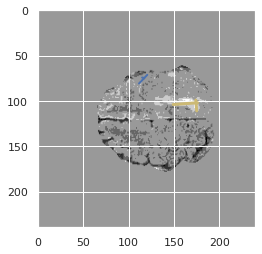

prediction [ 81.72206  122.50446   74.87755  130.89096   79.42494  125.868744
  70.111336 126.2127  ]


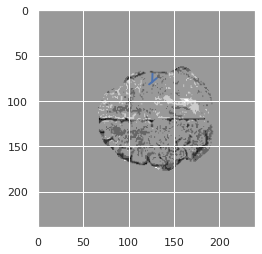

prediction [ 2.369545    3.5254726  -0.30210146 -0.20820941  0.16907197  0.63490623
 -0.2907665   1.8826447 ]


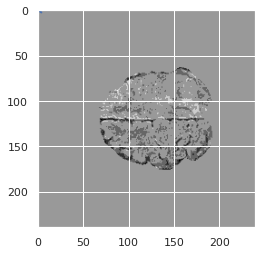

prediction [1.7629035 3.0259204 0.5697082 2.109076  0.8760105 2.6766608 1.2531797
 1.5251831]


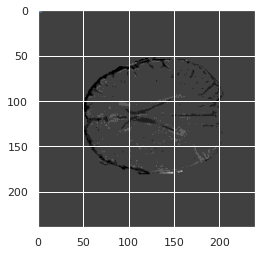

prediction [-0.8087882   2.0426393   0.35206112  1.6227819   1.9302526   1.9099227
 -0.7356025   2.416088  ]


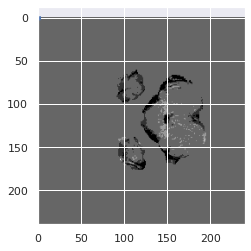

prediction [1.8533381 5.539253  2.1926563 5.13985   3.5460036 4.9819956 1.8409072
 5.632784 ]


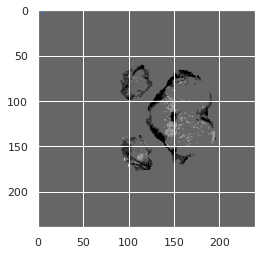

prediction [1.6662104 4.916027  1.2873424 3.470116  1.8636929 3.6318636 1.8877691
 5.1860895]


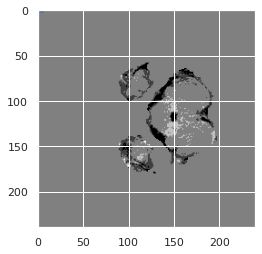

[0, 0.0, 0.0, 0.13134328358208955, 0.23920265780730898, 0.28550074738415543, 0.32432432432432434, 0.08004640371229699, 0.1877853881278539, 0.29461907298881196, 0.39195979899497485, 0.48134991119005327, 0.4308755760368664, 0.3411905713144227, 0.23657587548638132, 0.17106314948041568]
prediction [-0.97597253  1.3411545  -0.6248857  -0.220448   -0.52652436  0.15153615
 -0.07896948  2.192213  ]


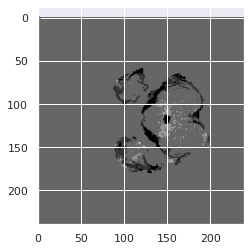

prediction [83.52355  79.719345 88.82185  90.79759  87.41422  92.20812  82.579926
 87.13294 ]


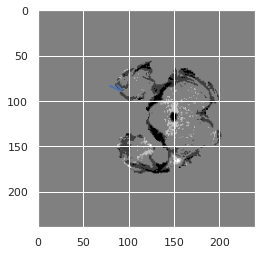

prediction [144.01964 130.29578 141.81703 139.35918 147.80598 138.7348  141.57196
 136.30507]


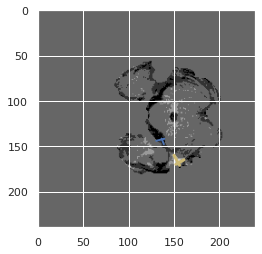

prediction [161.71329 138.3413  154.08318 152.5996  158.46034 148.18365 162.43445
 150.29796]


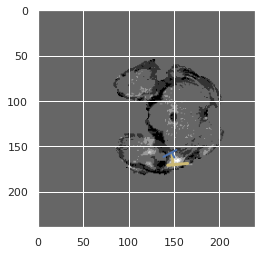

prediction [170.17432 131.53526 156.87093 149.17818 158.46516 146.44484 167.1684
 152.17567]


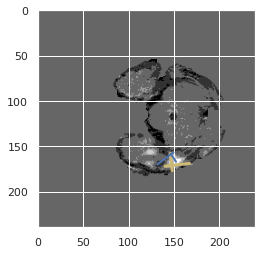

prediction [167.75742 125.9018  162.81874 152.84802 159.28183 140.96783 171.45741
 151.74257]


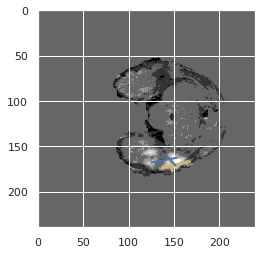

prediction [166.78041  120.004074 169.5736   158.01862  161.80692  136.06682
 174.35948  149.64291 ]


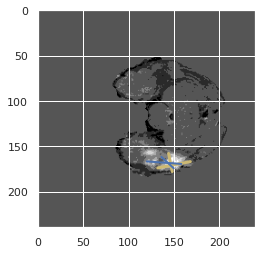

prediction [162.7773  111.87938 166.54262 164.18385 165.86777 133.91394 167.55318
 143.98071]


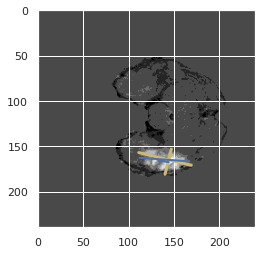

prediction [165.06242 111.04406 164.24518 166.6361  170.41086 134.76202 165.55032
 141.19089]


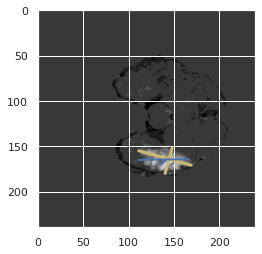

prediction [167.06458 111.25353 163.08861 169.98671 174.37358 137.13406 164.55083
 139.88132]


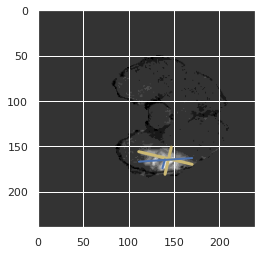

prediction [166.65402 111.496   159.89851 171.37334 175.60101 139.60129 162.2113
 139.1924 ]


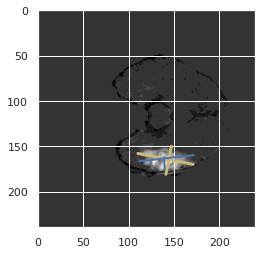

prediction [167.9884  111.03216 156.52776 174.45874 178.27182 144.35048 160.83348
 139.12526]


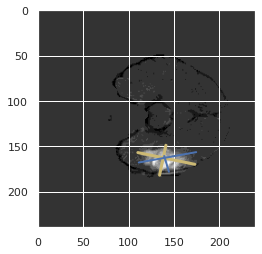

prediction [167.81032 110.04802 156.8388  173.89407 179.52327 143.98186 159.95964
 138.41902]


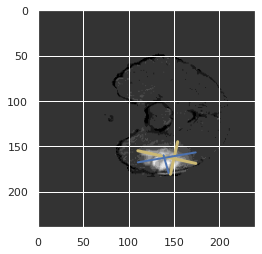

prediction [170.83672 111.72022 159.31195 176.0066  179.00943 145.67859 165.3261
 139.5461 ]


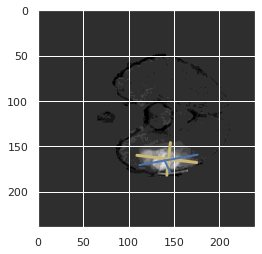

prediction [171.31723 114.28124 162.3296  179.04259 177.42702 147.32098 166.8278
 141.77254]


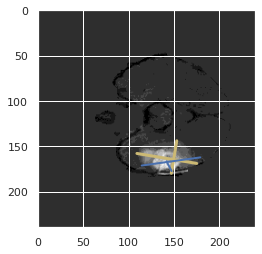

prediction [171.08414 116.07974 162.62648 181.12778 173.73448 148.5061  166.97914
 144.32271]


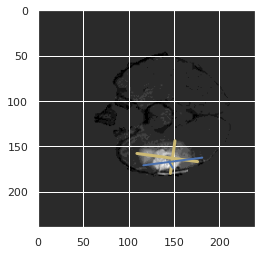

[0.25316455696202533, 0.4030571198712792, 0.4427787934186472, 0.5909576361694553, 0.698645598194131, 0.6670250896057348, 0.6623420962785934, 0.730716723549488, 0.6587248322147651, 0.6735924932975871, 0.6949093444909344, 0.7094691535150646, 0.6212952799121844, 0.6968103750438135, 0.7121834360027378, 0.679163901791639]
prediction [169.32411  117.265755 162.12096  180.98329  174.29887  148.09221
 164.21205  143.5488  ]


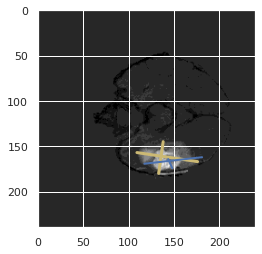

prediction [164.90936 115.93198 160.06134 181.3523  175.43492 148.93924 159.13461
 142.825  ]


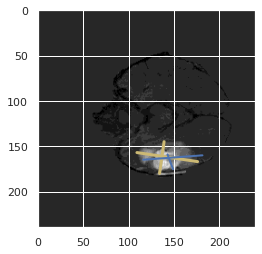

prediction [161.28972  115.296616 159.74948  182.56818  176.08981  149.08788
 156.48518  142.10161 ]


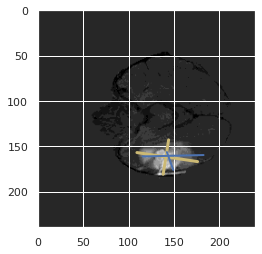

prediction [157.64221 114.02526 159.1241  181.96497 178.39317 147.10081 151.31154
 141.12013]


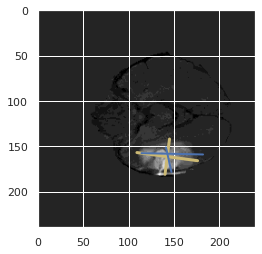

prediction [155.57623 115.15181 158.50119 182.6225  179.43144 146.32097 148.04253
 140.05092]


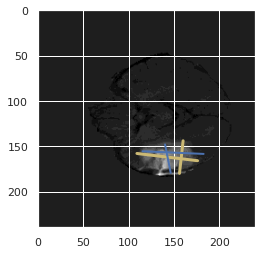

prediction [154.7109  115.57171 157.82422 182.43611 178.47134 145.6138  147.3202
 138.75873]


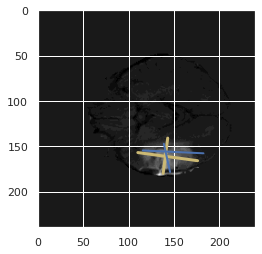

prediction [152.98093  115.537186 157.84195  182.84845  178.55399  144.83607
 146.02328  138.38669 ]


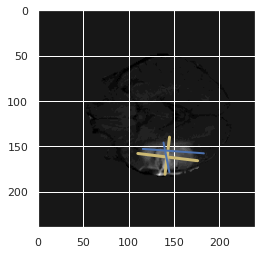

prediction [149.0082  115.30768 157.79156 181.23073 178.36601 144.77858 142.60141
 140.21413]


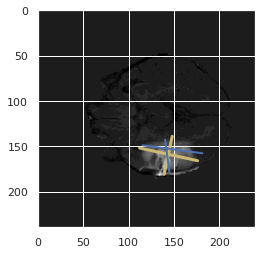

prediction [149.01022 115.90695 157.65009 180.73602 176.28516 144.09239 143.67921
 141.2773 ]


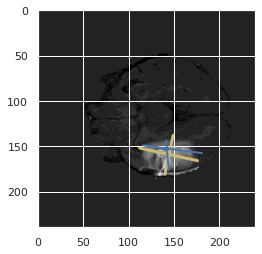

prediction [149.64912  115.955574 158.00793  180.70113  177.77693  145.44296
 144.56194  144.08327 ]


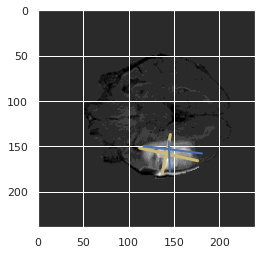

prediction [147.92531 114.30409 161.53166 178.90927 176.56747 145.59018 145.33186
 149.0382 ]


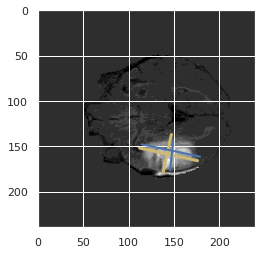

prediction [147.69304 115.42151 164.03769 177.25237 176.68356 144.52777 145.48875
 150.51338]


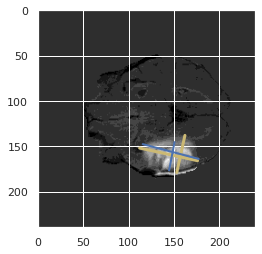

prediction [148.2934  116.57187 164.69705 175.98936 174.51974 144.56061 148.3138
 153.35468]


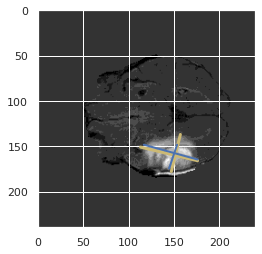

prediction [145.1729  115.60929 166.41847 174.44225 177.6398  144.13492 146.33261
 154.02405]


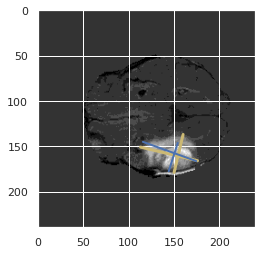

prediction [144.392    114.849594 165.70052  173.10504  178.93665  142.31908
 145.0682   152.83093 ]


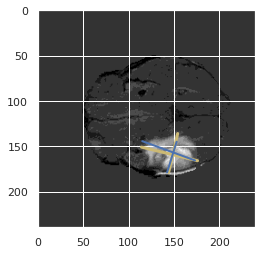

prediction [141.27269  112.300804 163.90514  171.23697  178.10806  141.29994
 143.21332  151.31854 ]


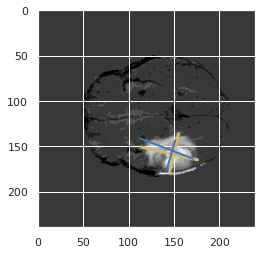

[0.6358112937812723, 0.6255958929226256, 0.6967549421857516, 0.7371016691957512, 0.7091798344620015, 0.5677799607072691, 0.45343330702446727, 0.2887323943661972, 0.45, 0.5541012216404887, 0.5560975609756098, 0.26625766871165646, 0.33386454183266934, 0.04325032765399738, 0.03614457831325301, 0.34108527131782945]
prediction [140.69205 112.61489 161.93478 171.31946 174.22336 143.24199 144.77184
 153.4986 ]


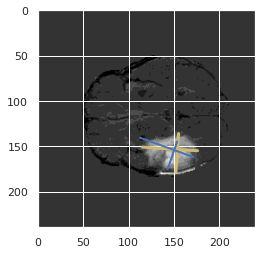

prediction [142.11089 112.26865 160.76566 169.93619 174.5091  142.47623 144.61418
 151.87352]


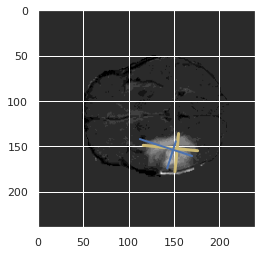

prediction [144.8403  113.79693 160.4303  169.69398 178.91269 144.35692 143.61266
 152.19467]


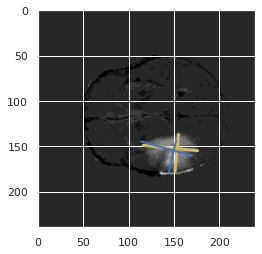

prediction [147.02165 115.96713 159.38596 171.53987 179.62184 144.77693 143.69025
 151.86511]


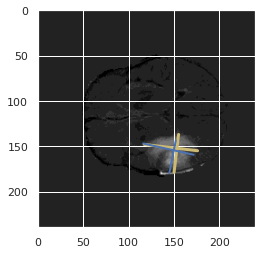

prediction [146.72021 118.58846 160.65327 172.55194 182.20285 146.92021 144.93535
 153.28688]


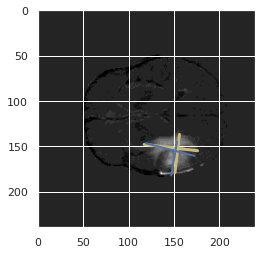

prediction [150.4358  123.92423 160.03629 170.80473 179.76195 147.4551  149.23698
 155.32033]


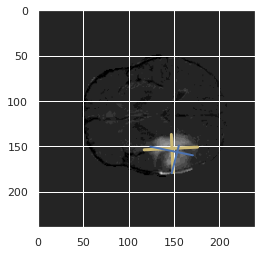

prediction [153.29315  124.383415 157.94496  169.11598  176.56876  146.54555
 151.36205  155.0471  ]


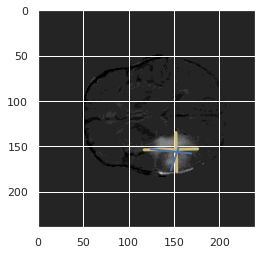

prediction [158.10017 124.14686 151.21695 164.02538 169.86778 142.5868  153.34195
 152.57123]


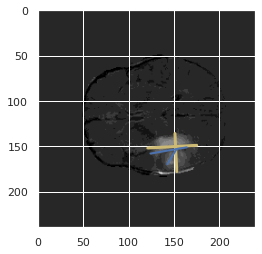

prediction [172.99287 125.75666 143.41527 159.04875 154.04704 135.48273 169.04343
 155.38875]


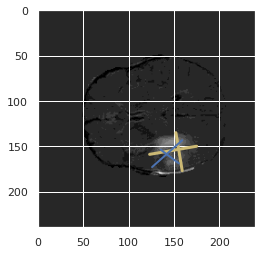

prediction [179.97278 129.51904 137.18654 157.75586 134.88142 133.4103  182.34477
 159.56595]


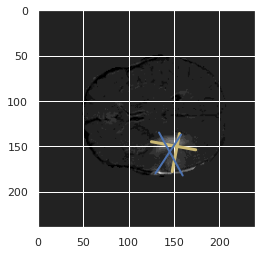

prediction [174.22536  129.48502  137.11778  154.04332  126.636765 133.77151
 179.39952  160.31178 ]


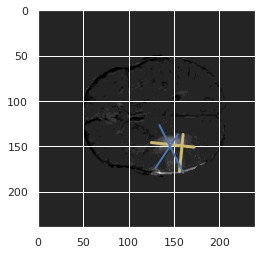

prediction [170.73146 130.91891 138.2725  152.62262 129.95007 131.77751 171.39537
 161.25845]


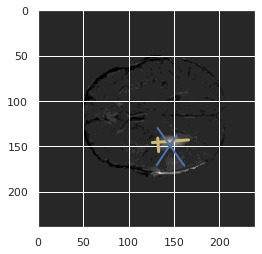

prediction [157.7429   119.347404 131.87952  144.56798  129.40549  129.72672
 152.61305  148.59988 ]


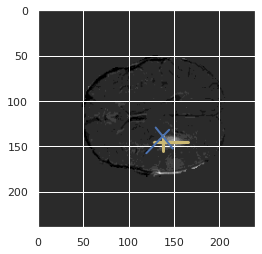

prediction [149.12447  118.680595 126.39915  145.70555  133.97444  132.85938
 139.43108  140.29535 ]


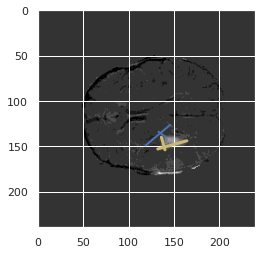

prediction [147.17485 123.75243 129.38995 154.28189 141.24776 139.29233 137.93547
 143.27327]


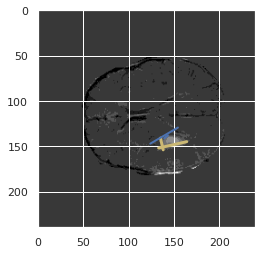

prediction [146.75856 125.43018 133.65347 158.31422 147.71202 141.33186 135.13745
 141.81273]


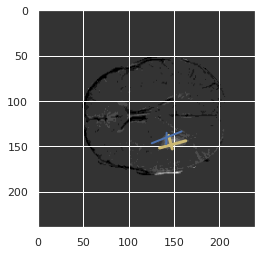

[0.32698961937716264, 0.0, 0, 0, 0, 0.0, 0.12730806608357628, 0.1921921921921922, 0.3545933294324166, 0.46875, 0.416182733255904, 0.453374025093252, 0.47278797996661104, 0.34338138925294887, 0.31773004168002567, 0.3569465648854962]
prediction [144.53937  126.181114 135.57889  156.64528  147.69003  141.10759
 135.67455  139.40062 ]


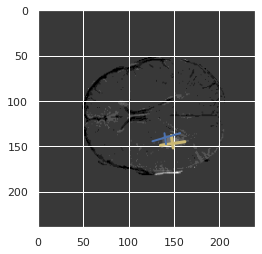

prediction [102.87432  117.2123    95.25128  131.16069  100.93736  124.38367
  97.116295 121.35884 ]


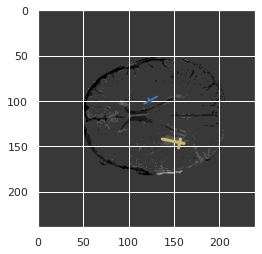

prediction [3.5036573 4.7128773 1.3156041 4.0603576 2.9074848 5.1995025 1.8406148
 3.3130105]


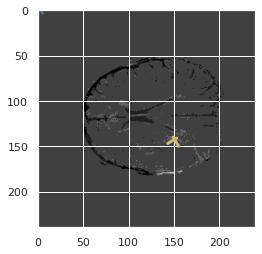

prediction [8.1777    6.574399  7.1001034 6.5890274 8.459615  7.490524  6.64963
 7.4935436]


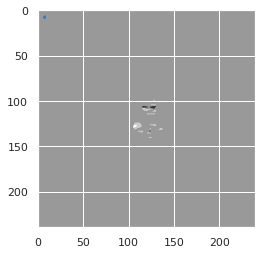

prediction [-1.5538521e-03  9.4985694e-01 -9.9787068e-01  9.2473394e-01
 -2.7773145e-01  1.5717059e+00 -1.2436807e+00 -4.3170977e-01]


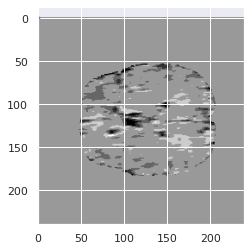

prediction [115.815834  90.39619  109.153114  95.789764 113.187645  88.52854
 113.01038   91.90121 ]


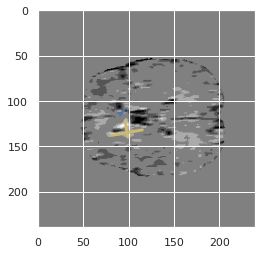

prediction [136.84053   95.5655   122.32975  108.28399  130.22195  101.638664
 131.04785  110.905045]


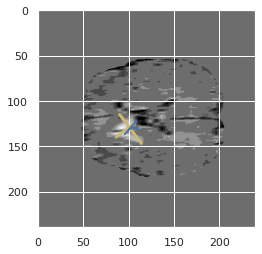

prediction [127.73025   87.23185  131.7768   114.21512  135.51483   92.16687
 122.735535 111.3617  ]


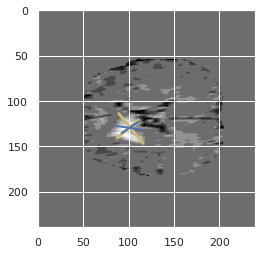

prediction [125.541664  80.68177  132.70117  118.534904 135.0113    92.22961
 119.91928  104.633675]


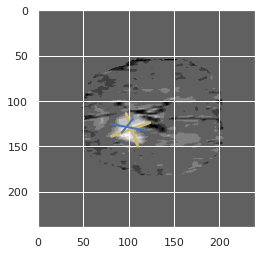

prediction [124.784134  79.94382  137.51764  124.24404  140.71767   94.133354
 119.67244  107.60988 ]


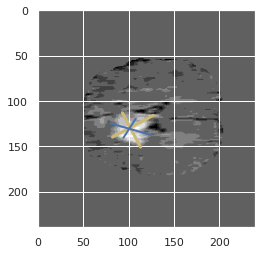

prediction [131.30367   83.124695 135.36562  128.35362  151.60461   97.74073
 119.2955   114.549576]


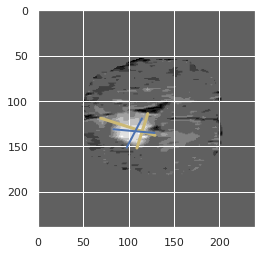

prediction [127.29725   80.96122  134.50206  127.8051   149.78119   98.211555
 115.6742   115.6774  ]


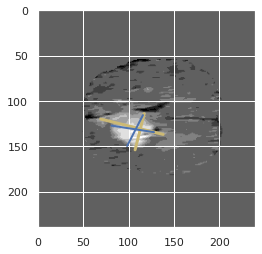

prediction [127.8305    79.700386 132.28694  130.49579  146.32622  101.03214
 115.209946 116.66497 ]


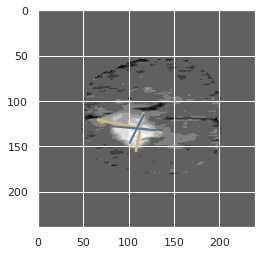

prediction [134.80942   80.48802  125.95408  130.82158  146.66124  101.41479
 117.785034 117.298584]


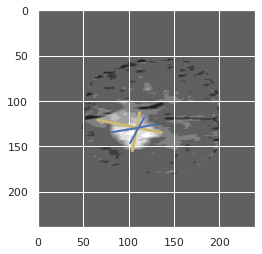

prediction [137.33667   82.29933  124.00716  131.02875  149.1518   104.29026
 120.03765  120.184105]


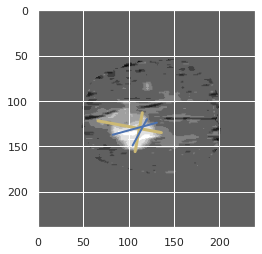

prediction [136.62756   81.3577   126.85709  130.44424  152.36722  105.70197
 118.832726 123.21005 ]


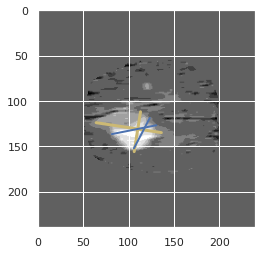

[0.3668763102725367, 0.4031924327519953, 0.4359861591695502, 0.3466327827191868, 0.2115185950413223, 0.1802897051215727, 0.18920335429769392, 0.14198782961460446, 0.17458211727248607, 0.18471337579617833, 0.2773645058448459, 0.19581211092246745, 0.17425742574257425, 0.13447360660572102, 0.11003627569528417, 0.24739845585767037]
prediction [134.2774    80.090294 128.38745  130.39188  151.83504  107.19959
 119.321175 123.12949 ]


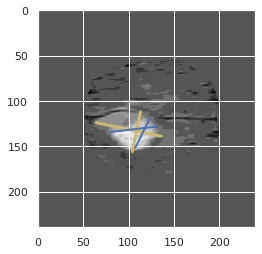

prediction [137.10675  79.42558 129.60695 133.65031 154.01915 110.04487 122.22868
 123.58986]


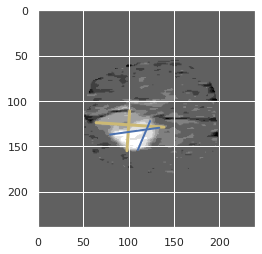

prediction [134.01028   78.783485 130.33618  135.32132  155.13797  110.57509
 118.82304  121.14565 ]


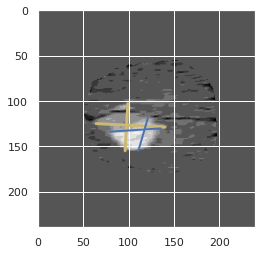

prediction [134.28455   79.532104 131.42273  132.72824  152.82642  100.91518
 118.081635 119.24107 ]


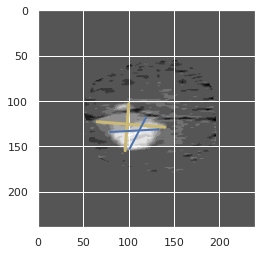

prediction [134.41528   80.365425 129.57643  129.87764  147.52187   94.2298
 121.23062  119.29565 ]


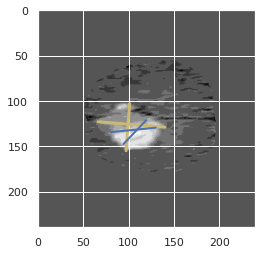

prediction [134.02753  82.16489 128.04211 131.63197 145.2521   93.272   120.77817
 120.99078]


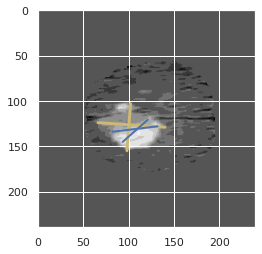

prediction [133.97955  83.21683 126.15017 133.38443 143.88406  95.03185 119.52717
 120.46839]


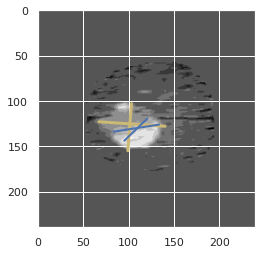

prediction [136.12706   84.812645 127.05595  134.2437   143.66138   94.41747
 122.78604  120.80094 ]


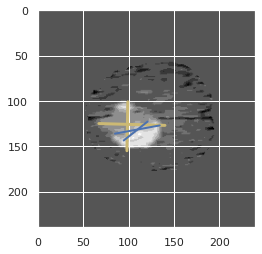

prediction [135.42772   86.47855  130.19667  135.09729  143.48074   96.79259
 122.53808  120.933136]


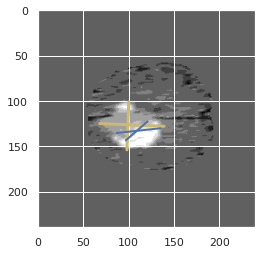

prediction [134.52698   86.695404 129.81856  133.1388   144.69357   94.8376
 119.92353  119.91221 ]


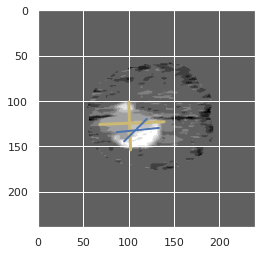

prediction [131.78471   84.1543   132.2639   132.78636  146.70226   95.72049
 116.06232  118.387825]


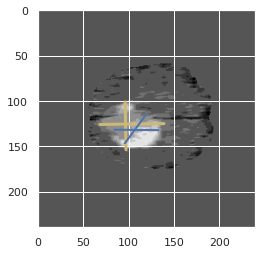

prediction [133.89946  86.179   127.99806 129.38824 146.50012  94.05356 115.40017
 117.88569]


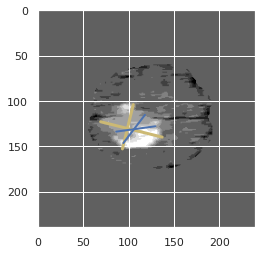

prediction [136.35039   87.802345 124.487404 130.3114   146.14859   97.17612
 117.3066   118.239586]


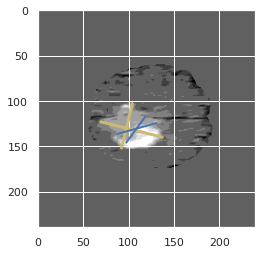

prediction [138.59058   89.62843  123.337074 130.14145  145.72348   98.6822
 123.54412  119.10507 ]


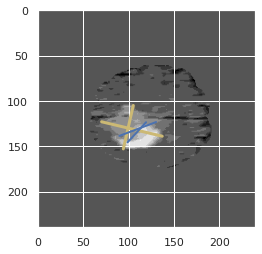

prediction [140.54515   91.62604  126.59938  130.05885  147.9124    96.88512
 127.248375 119.794136]


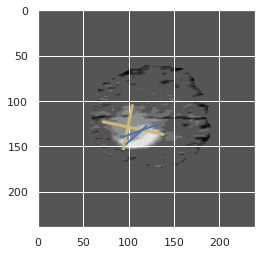

prediction [140.70079   90.31004  129.6314   133.02278  154.24597  101.79305
 123.085    118.744484]


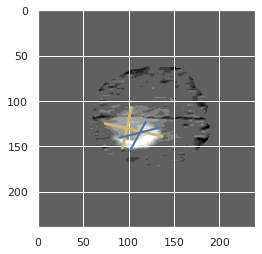

[0.30580357142857145, 0.3810302534750613, 0.4658507698381366, 0.6131914893617021, 0.6484929078014184, 0.6087162482235907, 0.5226814516129032, 0.5147208121827411, 0.46572475143903713, 0.5517441860465117, 0.5787234042553191, 0.5703971119133574, 0.579552715654952, 0.5393939393939394, 0.6756574511126096, 0.6592095451155854]
prediction [143.84187   89.882034 131.58267  134.87428  157.79358  102.17692
 123.30694  119.38993 ]


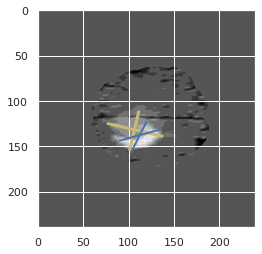

prediction [142.53734   87.50738  131.96414  136.3611   156.00922  101.97721
 124.22782  118.375015]


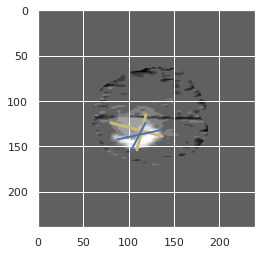

prediction [138.47649   85.74079  131.15501  133.68997  158.85104  103.646324
 119.506134 114.6613  ]


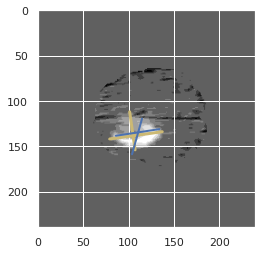

prediction [138.31749   85.115715 133.73944  135.17001  158.50562  104.501564
 118.50159  113.1471  ]


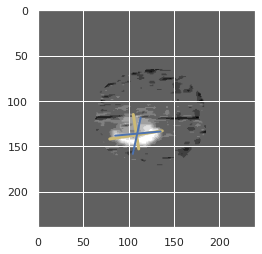

prediction [141.32477  82.48535 132.39806 134.04994 159.56091 103.50275 117.11207
 110.97201]


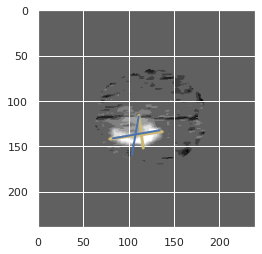

prediction [141.06932   83.216675 129.93184  133.27226  155.17052  101.82834
 119.53377  110.62232 ]


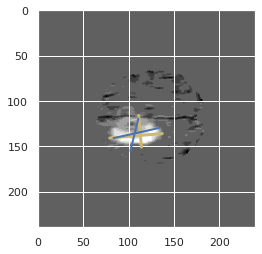

prediction [140.55173  82.87935 129.17105 131.31575 151.47656  99.17779 122.09508
 109.97851]


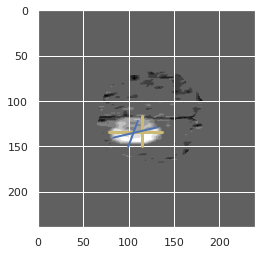

prediction [139.6774    83.146324 130.15843  131.59753  150.34662   99.90146
 122.514534 110.52836 ]


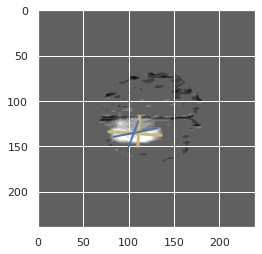

prediction [140.6257    83.54581  132.14891  132.87639  149.48843   99.89692
 126.024445 111.19623 ]


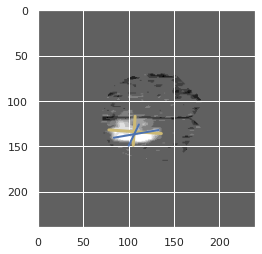

prediction [139.87215   84.315094 132.46428  132.67331  149.83032   99.0307
 125.43632  109.09115 ]


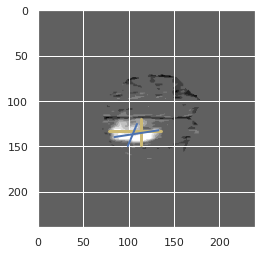

prediction [135.29436   84.3208   131.7756   130.04842  150.68428   96.87028
 122.58741  106.051445]


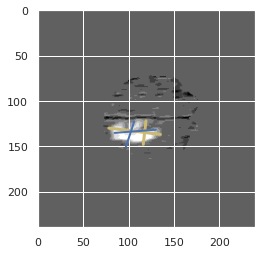

prediction [135.40395  85.51544 135.5277  131.69753 153.02205  98.12924 124.68788
 110.19286]


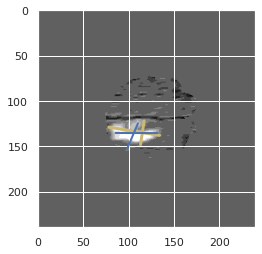

prediction [133.30563  85.66824 133.857   129.90303 149.54677  99.13462 123.415
 111.27486]


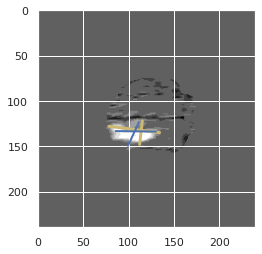

prediction [129.20782   83.98867  131.93707  124.335266 146.17856   97.57892
 121.09022  112.424164]


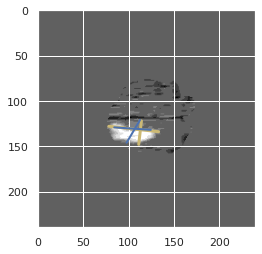

prediction [123.92476  80.42792 133.7311  121.26849 147.91853  95.60429 119.09248
 108.8136 ]


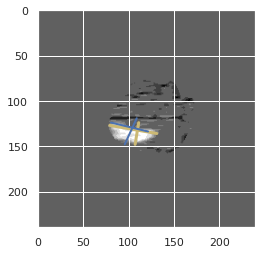

prediction [124.086426  81.56328  134.44672  123.2246   146.66695   97.16041
 120.55348  109.707054]


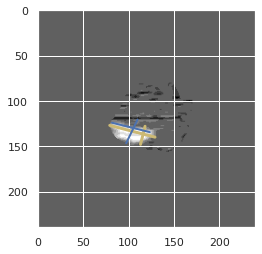

[0.46572475143903713, 0.5517441860465117, 0.5787234042553191, 0.5703971119133574, 0.579552715654952, 0.5393939393939394, 0.6756574511126096, 0.6592095451155854, 0.606239460370995, 0.6558966074313409, 0.7010923535253227, 0.353099730458221, 0.22105263157894736, 0.34977578475336324, 0.3197278911564626, 0.0]
prediction [126.58185   84.10095  133.91365  122.16055  145.49828   96.968636
 122.67392  112.669815]


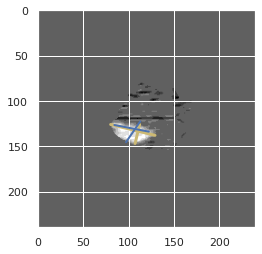

prediction [125.77498   86.7268   136.44804  122.77543  146.06473  101.464424
 121.32291  116.543945]


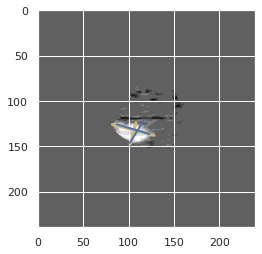

prediction [130.39253   92.54181  141.14017  126.49172  146.16875  107.234436
 127.523155 117.21724 ]


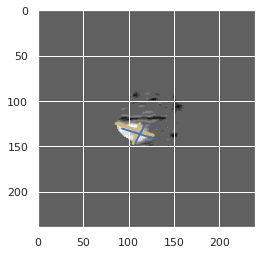

prediction [132.35274  97.97105 133.14635 121.97997 139.364   109.23762 126.97022
 116.04426]


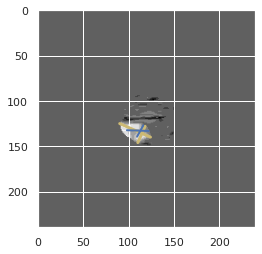

prediction [130.80754  98.86332 126.201   116.38282 134.4783  109.08479 123.79698
 114.34998]


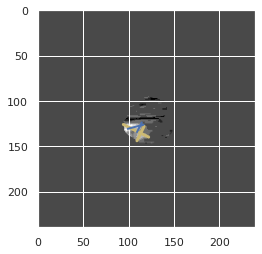

prediction [125.14339   93.6886   128.42229  114.353775 134.5577   106.02462
 119.8566   109.08597 ]


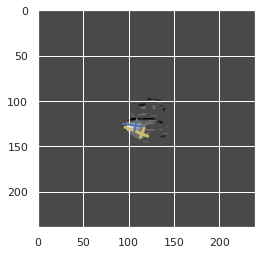

prediction [123.65533  97.16184 121.79023 115.57857 131.70454 106.67752 117.43794
 106.11389]


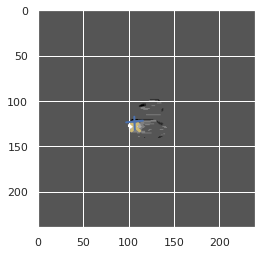

prediction [121.621086 103.6174   117.82374  115.398926 123.71459  107.76466
 114.97543  111.71839 ]


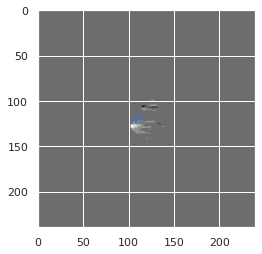

(1832,) (1832,)


<Figure size 640x480 with 0 Axes>

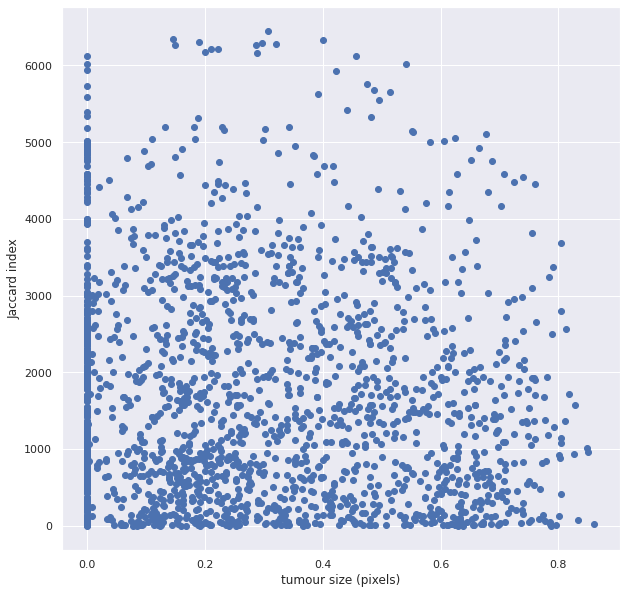

ValueError: Could not interpret input 'Validation'

In [14]:
%run Code_UNet/Test_RANO_2.py

In [ ]:
from matplotlib.pyplot import figure

%run Code_UNet/Test_RANO_2.py

figure(figsize=(8, 6), dpi=80)
figure(figsize=(10,10))

print(np.array(jaccard).shape,np.array(x).shape)
plt.scatter(np.array(jaccard),np.array(x))
plt.xlabel("Slice Number")
plt.ylabel("Jaccard index")
plt.show()

Brats_2018_data_split/ValidationHGG


  0%|          | 0/115 [00:00<?, ?it/s]